## Import Libraries, Data

In [17]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import os


In [18]:
RCMIP = pd.read_csv('RCMIP_ModelOutputs/RCMIP_combined.csv', low_memory=False)
print(f"Shape of RCMIP: {RCMIP.shape}")

FeliX = pd.read_csv('Vensim_Runs/FeliX_Outputs_All.csv', low_memory=False)
print(f"Shape of FeliX: {FeliX.shape}")


# --- Harmonize year columns between RCMIP and FeliX ---
# Find columns in FeliX that are years with .0 (e.g., '2100.0') and convert to string int (e.g., '2100')
felix_year_cols = [col for col in FeliX.columns if (
    isinstance(col, str) and col.replace('.0', '').isdigit() and col.endswith('.0')
)]
# Create a mapping from '2100.0' -> '2100'
felix_col_rename = {col: col.replace('.0', '') for col in felix_year_cols}
FeliX = FeliX.rename(columns=felix_col_rename)

# Optionally, do the same for RCMIP if it has float year columns (e.g., 2100.0)
rcmip_year_cols = [col for col in RCMIP.columns if (
    (isinstance(col, float) or (isinstance(col, str) and col.replace('.', '', 1).isdigit()))
    and str(col).endswith('.0')
)]
rcmip_col_rename = {col: str(int(float(col))) for col in rcmip_year_cols}
RCMIP = RCMIP.rename(columns=rcmip_col_rename)

## print("\nRCMIP dtypes:")
## print(RCMIP.dtypes)
## print("\nFeliX dtypes:")
## print(FeliX.dtypes)

Shape of RCMIP: (10821, 1625)
Shape of FeliX: (550, 208)


### Fix FeliX Dataset

In [19]:
#Standardize FeliX Units
FeliX = FeliX.drop(columns=['FeliX_Unit'], errors='ignore')

#Concat both files
merged_data = pd.concat([FeliX, RCMIP])
merged_data

,Model,Scenario,Region,Variable,Unit,ClimateModel,1900,1901,1902,1903,...,3121,3122,3123,3124,3125,3126,3127,3128,3129,3130
0,AIM,rcp60,World,Atmospheric Concentrations|CH4,ppb,FeliX,925.000000,944.714245,962.784097,979.376280,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,AIM,rcp60,World,Atmospheric Concentrations|CO2,ppm,FeliX,284.700000,285.147481,285.713003,286.289324,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,AIM,rcp60,World,Atmospheric Concentrations|N2O,ppb,FeliX,278.900000,278.956904,279.015973,279.077755,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,AIM,rcp60,World,Net Land to Atmosphere Flux|CH4,Mt CH4/yr,FeliX,58.151991,53.262834,48.868477,44.920623,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,AIM,rcp60,World,Net Land to Atmosphere Flux|CO2,Mt CO2/yr,FeliX,0.000000,-189.644301,-413.166228,-629.037064,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10816,Not_applicable,ssp370,World,Surface Air Ocean Blended Temperature Change,K,"UMD-EMGC,5,DEFAULT",-0.188600,-0.251700,-0.354900,-0.214500,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
10817,Not_applicable,ssp585,World,Atmospheric Concentrations|CO2,ppm,"UMD-EMGC,5,DEFAULT",295.487500,295.841000,296.166000,296.489500,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
10818,Not_applicable,ssp585,World,Atmospheric Concentrations|CH4,ppb,"UMD-EMGC,5,DEFAULT",923.917000,927.176000,930.765500,934.757500,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
10819,Not_applicable,ssp585,World,Heat Content|Ocean,ZJ,"UMD-EMGC,5,DEFAULT",8.048700,8.256100,8.462900,8.663400,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [20]:
unique_scenarios = FeliX['Scenario'].unique()
print(f"Unique Scenarios: {unique_scenarios}")

Unique Scenarios: ['rcp60' 'ssp370' 'ssp370-lowNTCF-aerchemmip' 'ssp370-lowNTCF-gidden'
 'historical' 'ssp434' 'ssp460' 'rcp26' 'ssp119' 'ssp126' 'rcp85' 'ssp245'
 'rcp45' 'ssp534-over' 'ssp585' 'esm-bell-1000PgC' 'esm-bell-2000PgC'
 'esm-bell-750PgC' 'esm-pi-CO2pulse' 'esm-pi-cdr-pulse' 'esm-piControl'
 'historical-cmip5']


## Intergrated Function for Visualizing Graph

In [21]:
def visualize_rcmip_data(df, 
                         variables=None, 
                         scenarios=None, 
                         year_range=(1900, 2100),
                         region='World',
                         exclude_models=None,
                         exclude_scenarios=None,
                         compare_by='ClimateModel+Scenario',
                         plot_title=None,
                         figsize=(12, 6)):
    """
    Visualize RCMIP data with customizable parameters.
    
    Parameters:
    -----------
    df : pandas.DataFrame
        The RCMIP DataFrame
    variables : list or str, optional
        List of variables to include, or single variable string. 
        If None, includes all variables
    scenarios : list or str, optional
        List of scenarios to include, or single scenario string.
        If None, includes all scenarios
    year_range : tuple, optional
        (start_year, end_year) for filtering data. Default (1900, 2100)
    region : str, optional
        Region to filter by. Default 'World'
    exclude_models : list, optional
        List of model names to exclude from visualization
    exclude_scenarios : list, optional
        List of scenario names to exclude from visualization
    compare_by : str, optional
        How to group data for comparison: 'ClimateModel', 'Scenario', or 'ClimateModel+Scenario'
    plot_title : str, optional
        Custom title for the plot. If None, auto-generated
    figsize : tuple, optional
        Figure size (width, height). Default (12, 6)
    
    Returns:
    --------
    fig : matplotlib.figure.Figure
        The figure object of the plot
    df_filtered : pandas.DataFrame
        The filtered DataFrame used for plotting
    """
    
    print(f"Original data shape: {df.shape}")
    
    # Apply variable filter
    if variables is not None:
        if isinstance(variables, str):
            variables = [variables]
        df = df[df['Variable'].isin(variables)]
        print(f"After variable filtering: {df.shape}")
    
    # Apply scenario filter
    if scenarios is not None:
        if isinstance(scenarios, str):
            scenarios = [scenarios]
        df = df[df['Scenario'].isin(scenarios)]
        print(f"After scenario filtering: {df.shape}")
    
    # Apply region filter
    if region is not None:
        df = df[df['Region'] == region]
        print(f"After region filtering: {df.shape}")
    
    # Apply year range filter
    start_year, end_year = year_range
    year_columns = [str(year) for year in range(start_year, end_year + 1)]
    identifier_columns = ['ClimateModel', 'Scenario', 'Region', 'Variable', 'Unit']
    
    # Only keep columns that exist in the DataFrame
    columns_to_keep = [col for col in identifier_columns if col in df.columns] + \
                      [col for col in year_columns if col in df.columns]
    
    df = df[columns_to_keep]
    print(f"After year range filtering: {df.shape}")
    
    # Apply exclusion filters
    if exclude_models is not None:
        df = df[~df['ClimateModel'].isin(exclude_models)]
        print(f"After excluding models: {df.shape}")
    
    if exclude_scenarios is not None:
        df = df[~df['Scenario'].isin(exclude_scenarios)]
        print(f"After excluding scenarios: {df.shape}")
    
    # Create the plot
    fig, ax = plt.subplots(figsize=figsize)
    
    # Get year columns for plotting
    year_cols = [col for col in df.columns if col.isdigit()]
    years = [int(col) for col in year_cols]
    
    # Group by the specified comparison method
    if compare_by == 'ClimateModel+Scenario':
        df['ClimateModel+Scenario'] = df['ClimateModel'] + ' | ' + df['Scenario']
        group_col = 'ClimateModel+Scenario'
    else:
        group_col = compare_by
    
    # Plot each group
    offset = (years[-1] - years[0]) * 0.01
    colors = plt.cm.tab20(np.linspace(0, 1, len(df[group_col].unique())))
    
    for i, (key, grp) in enumerate(df.groupby(group_col)):
        y = grp[year_cols].values.squeeze()
        
        # Check if this group contains FeliX data
        is_felix = grp['ClimateModel'].iloc[0] == 'FeliX'
        
        # Set line properties based on whether it's FeliX
        if is_felix:
            linewidth = 5.0
            alpha = 0.5
            color = 'red'  # Highlight FeliX in red
        else:
            linewidth = 1.5
            alpha = 0.8
            color = colors[i % len(colors)]
        
        if y.ndim == 1:
            mask = ~pd.isna(y)
            if mask.any():
                ax.plot(np.array(years)[mask], y[mask], 
                        color=color, 
                        linewidth=linewidth, alpha=alpha)
                last_valid_idx = np.where(mask)[0][-1]
                ax.text(years[last_valid_idx] + offset, y[last_valid_idx], 
                        str(key), fontsize=8, va='center',
                        weight='bold' if is_felix else 'normal')
        else:
            for row in y:
                mask = ~pd.isna(row)
                if mask.any():
                    ax.plot(np.array(years)[mask], row[mask], 
                            color=color, 
                            linewidth=linewidth, alpha=alpha)
                    last_valid_idx = np.where(mask)[0][-1]
                    ax.text(years[last_valid_idx] + offset, row[last_valid_idx], 
                            str(key), fontsize=8, va='center',
                            weight='bold' if is_felix else 'normal')
    
    # Customize the plot
    ax.set_xlabel('Year', fontsize=12)
    
    # Get variable name for y-label
    if variables is not None and len(variables) == 1:
        ylabel = variables[0]
    else:
        ylabel = "Variable Value"
    
    # Add unit if available
    if 'Unit' in df.columns and not df['Unit'].empty:
        unit = df['Unit'].iloc[0]
        ylabel += f" ({unit})"
    
    ax.set_ylabel(ylabel, fontsize=12)
    
    # Set title
    if plot_title is None:
        plot_title = f"RCMIP Data Visualization\n{compare_by} Comparison"
    ax.set_title(plot_title, fontsize=14, pad=20)
    
    # Add grid and remove spines
    ax.grid(True, which='both', linestyle='--', linewidth=0.5, 
             color='lightgray', alpha=0.7)
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['left'].set_visible(False)
    ax.spines['bottom'].set_visible(False)
    
    # Extend x-axis for labels
    ax.set_xlim(years[0], years[-1] + 5 * offset)
    
    plt.tight_layout()
    plt.show()
    
    return fig, df

## Preparing Scenario Sets and Output Sets

### Organizing List of Scenarios

In [22]:
# Scenario List and Purposes:
#['rcp60' 'ssp370' 'ssp370-lowNTCF-aerchemmip' 'ssp370-lowNTCF-gidden' 'historical' 'ssp434' 'ssp460' 'rcp26' 'ssp119' 'ssp126' 'rcp85' 'ssp245' 'rcp45' 'ssp534-over' 'ssp585' 'esm-bell-1000PgC' 'esm-bell-2000PgC' 'esm-bell-750PgC' 'esm-pi-CO2pulse' 'esm-pi-cdr-pulse' 'esm-piControl' ]
all_experiments = merged_data[merged_data['ClimateModel'] == 'FeliX']['Scenario'].unique()
idealised_experiments = ['esm-bell-1000PgC', 'esm-bell-2000PgC', 'esm-bell-750PgC', 'esm-pi-CO2pulse', 'esm-pi-cdr-pulse', 'esm-piControl']
scenario_experiments = ['historical', 'rcp26', 'rcp45', 'rcp60', 'rcp85', 'ssp119', 'ssp126', 'ssp245', 'ssp370', 'ssp370-lowNTCF-aerchemmip', 'ssp370-lowNTCF-gidden', 'ssp434', 'ssp460', 'ssp534-over', 'ssp585', 'historical-cmip5']


### Organizing List of Output Variables

In [23]:
all_outputs = FeliX['Variable'].unique()

#full_felix_outputs = 
conc_outputs = ['Atmospheric Concentrations|CH4', 'Atmospheric Concentrations|CO2', 'Atmospheric Concentrations|N2O']

### Run: All Variables with All Scenarios

Original data shape: (11371, 1625)
After variable filtering: (767, 1625)
After scenario filtering: (44, 1625)
After region filtering: (44, 1625)
After year range filtering: (44, 206)
After excluding models: (42, 206)


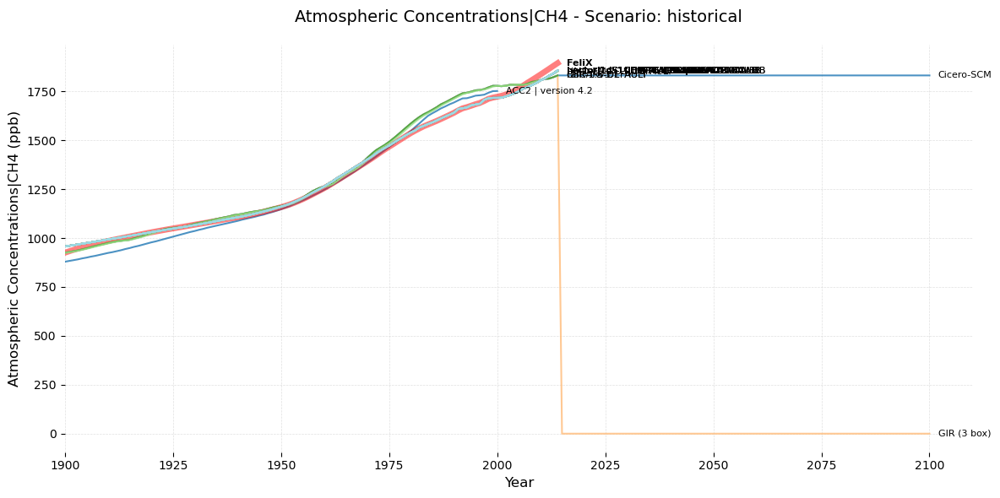

Original data shape: (11371, 1625)
After variable filtering: (767, 1625)
After scenario filtering: (25, 1625)
After region filtering: (25, 1625)
After year range filtering: (25, 206)
After excluding models: (24, 206)


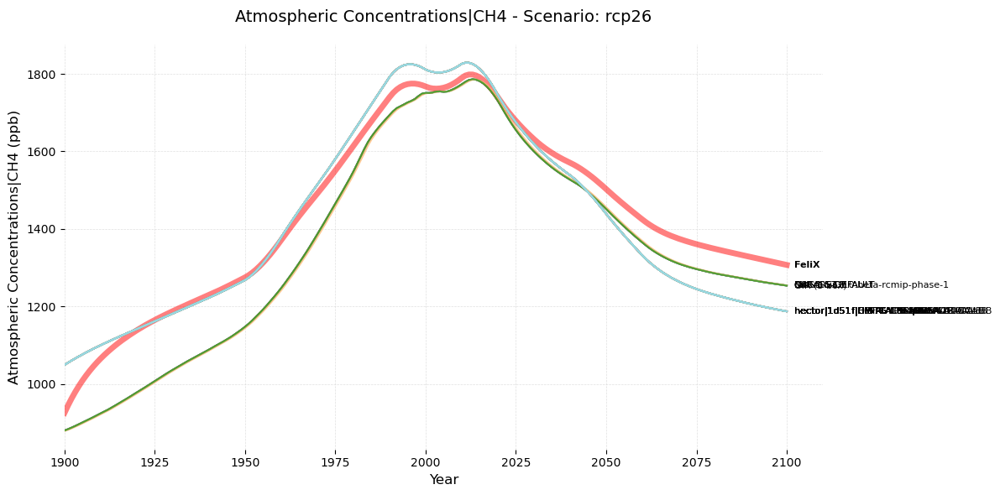

Original data shape: (11371, 1625)
After variable filtering: (767, 1625)
After scenario filtering: (25, 1625)
After region filtering: (25, 1625)
After year range filtering: (25, 206)
After excluding models: (24, 206)


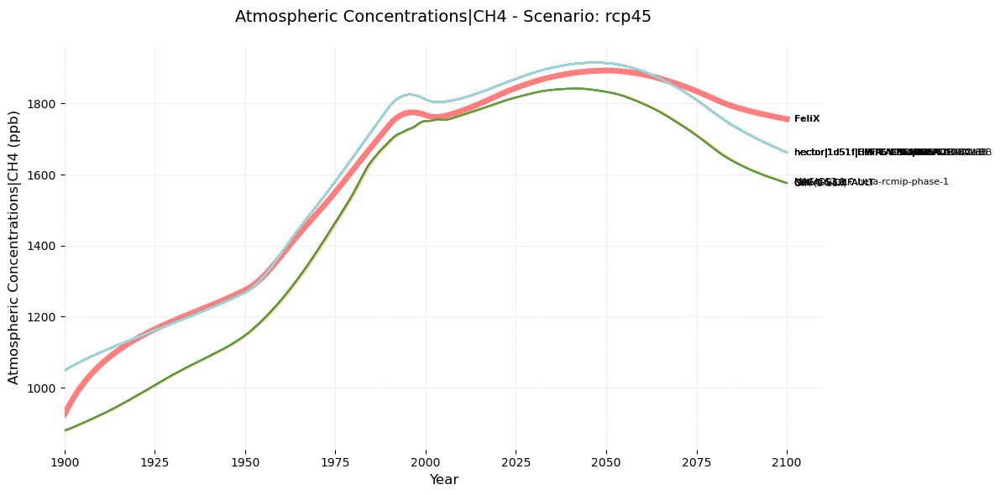

Original data shape: (11371, 1625)
After variable filtering: (767, 1625)
After scenario filtering: (25, 1625)
After region filtering: (25, 1625)
After year range filtering: (25, 206)
After excluding models: (24, 206)


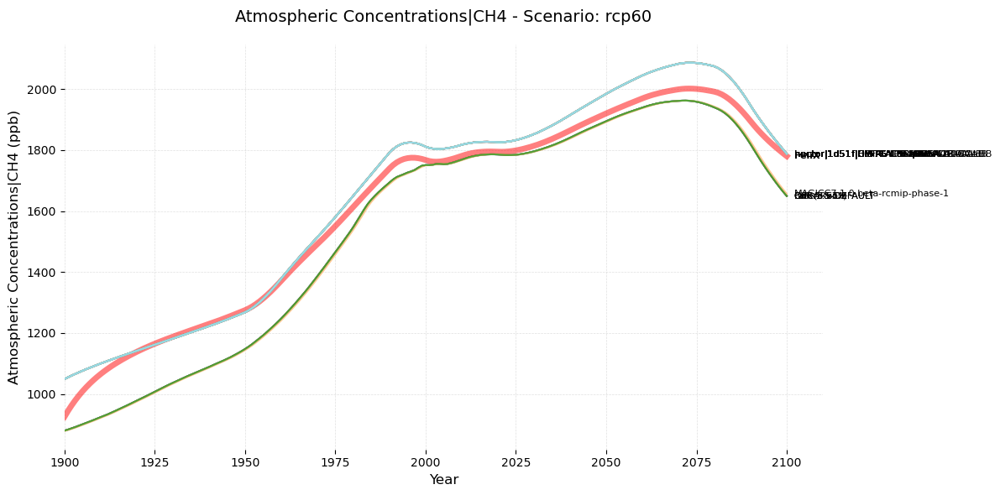

Original data shape: (11371, 1625)
After variable filtering: (767, 1625)
After scenario filtering: (25, 1625)
After region filtering: (25, 1625)
After year range filtering: (25, 206)
After excluding models: (24, 206)


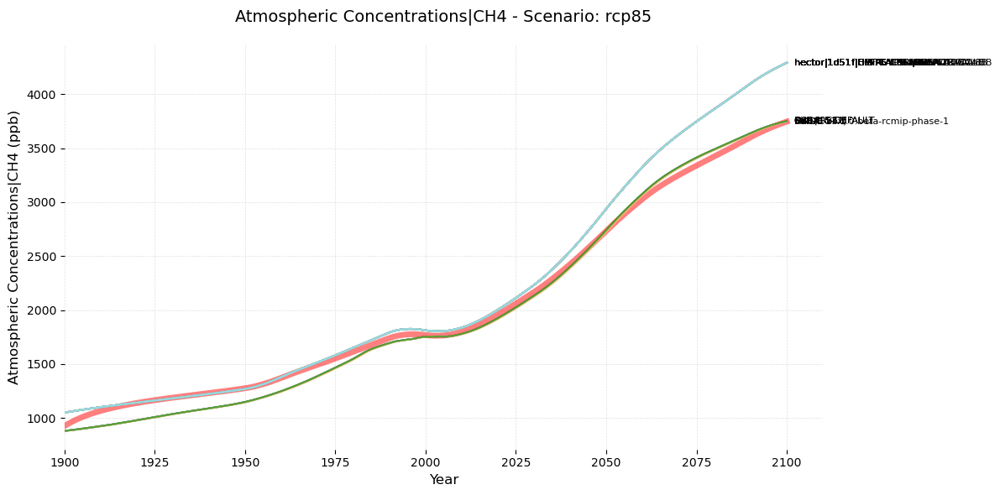

Original data shape: (11371, 1625)
After variable filtering: (767, 1625)
After scenario filtering: (26, 1625)
After region filtering: (26, 1625)
After year range filtering: (26, 206)
After excluding models: (25, 206)


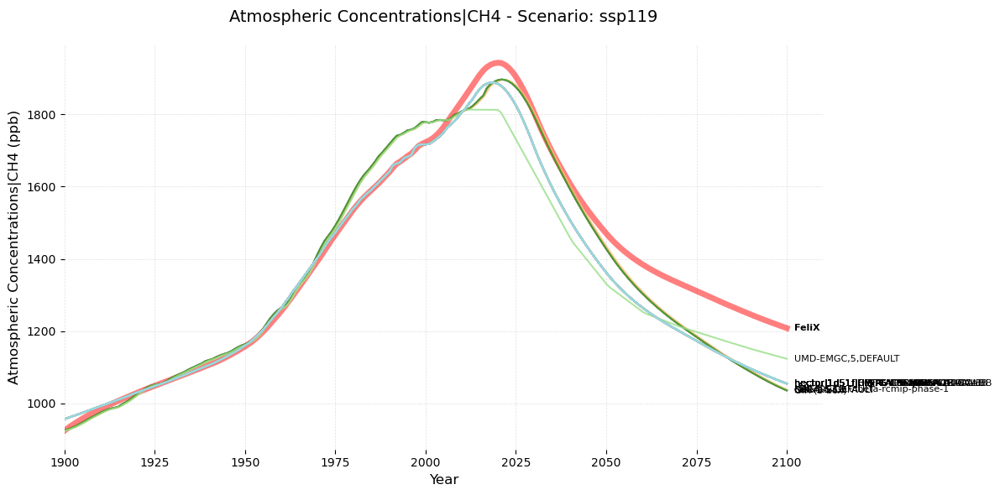

Original data shape: (11371, 1625)
After variable filtering: (767, 1625)
After scenario filtering: (15, 1625)
After region filtering: (15, 1625)
After year range filtering: (15, 206)
After excluding models: (15, 206)


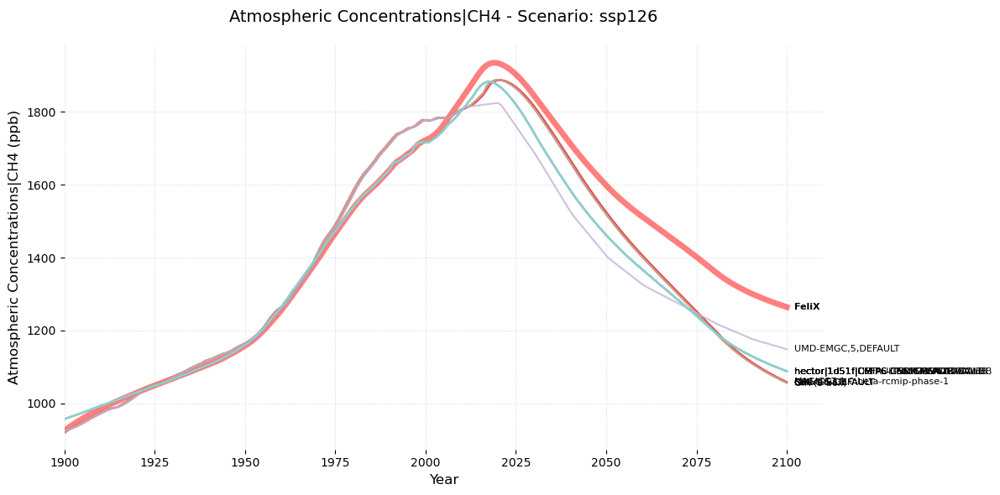

Original data shape: (11371, 1625)
After variable filtering: (767, 1625)
After scenario filtering: (15, 1625)
After region filtering: (15, 1625)
After year range filtering: (15, 206)
After excluding models: (15, 206)


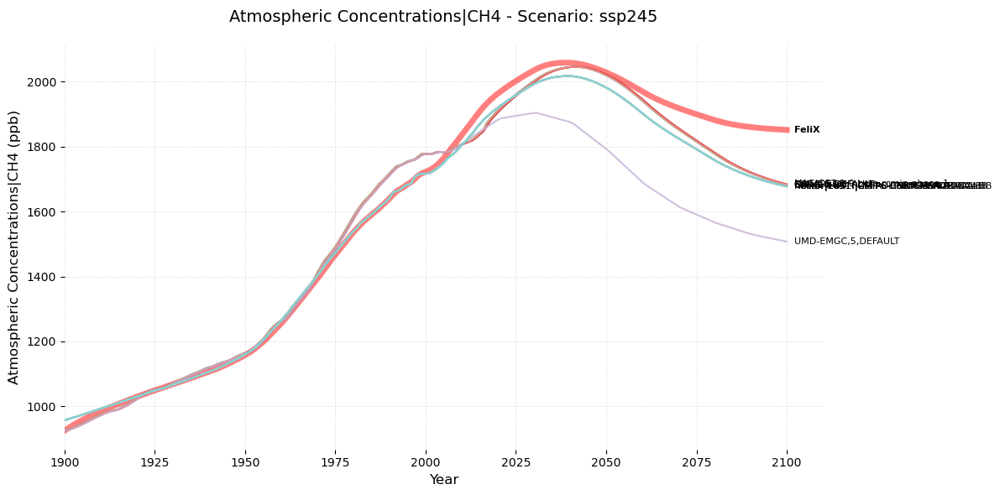

Original data shape: (11371, 1625)
After variable filtering: (767, 1625)
After scenario filtering: (22, 1625)
After region filtering: (22, 1625)
After year range filtering: (22, 206)
After excluding models: (22, 206)


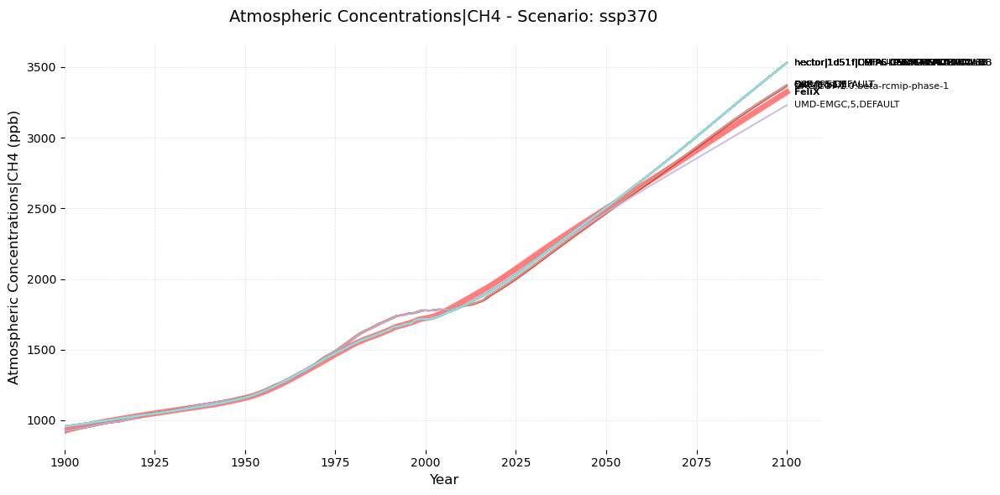

Original data shape: (11371, 1625)
After variable filtering: (767, 1625)
After scenario filtering: (6, 1625)
After region filtering: (6, 1625)
After year range filtering: (6, 206)
After excluding models: (6, 206)


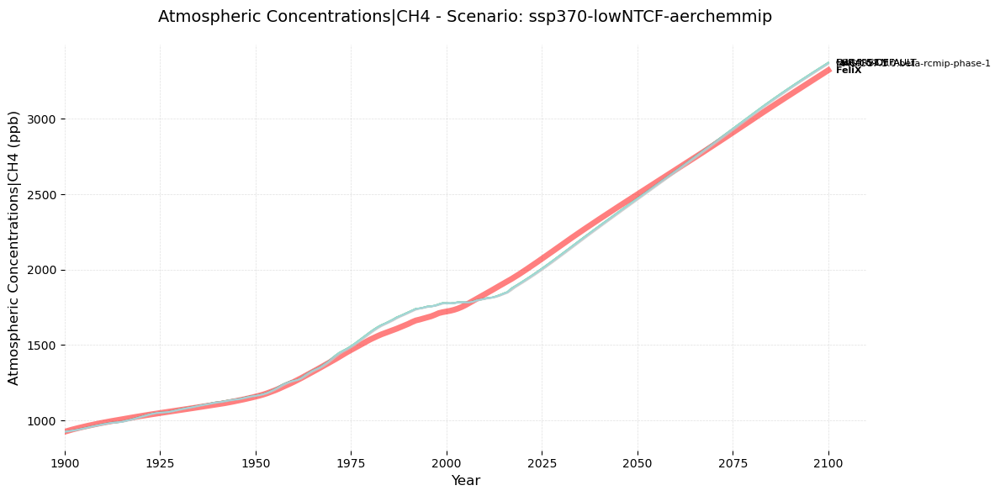

Original data shape: (11371, 1625)
After variable filtering: (767, 1625)
After scenario filtering: (4, 1625)
After region filtering: (4, 1625)
After year range filtering: (4, 206)
After excluding models: (4, 206)


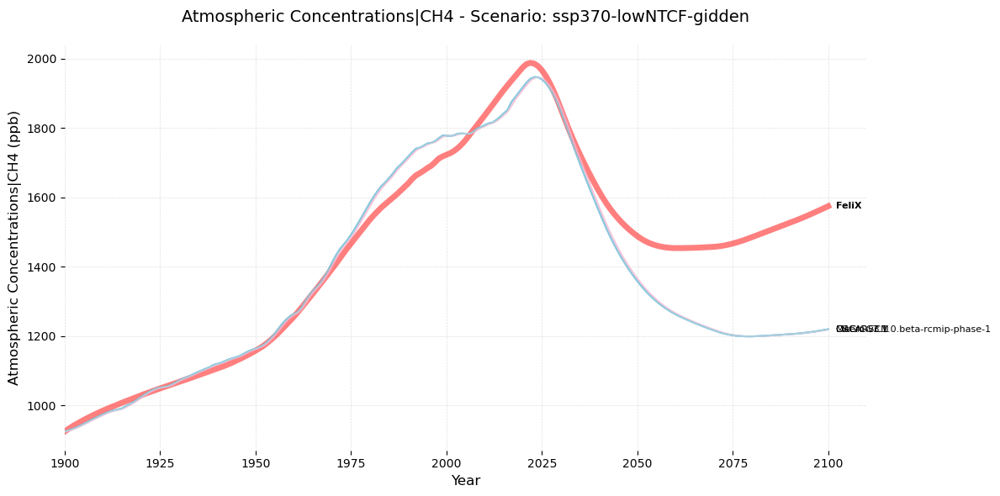

Original data shape: (11371, 1625)
After variable filtering: (767, 1625)
After scenario filtering: (15, 1625)
After region filtering: (15, 1625)
After year range filtering: (15, 206)
After excluding models: (15, 206)


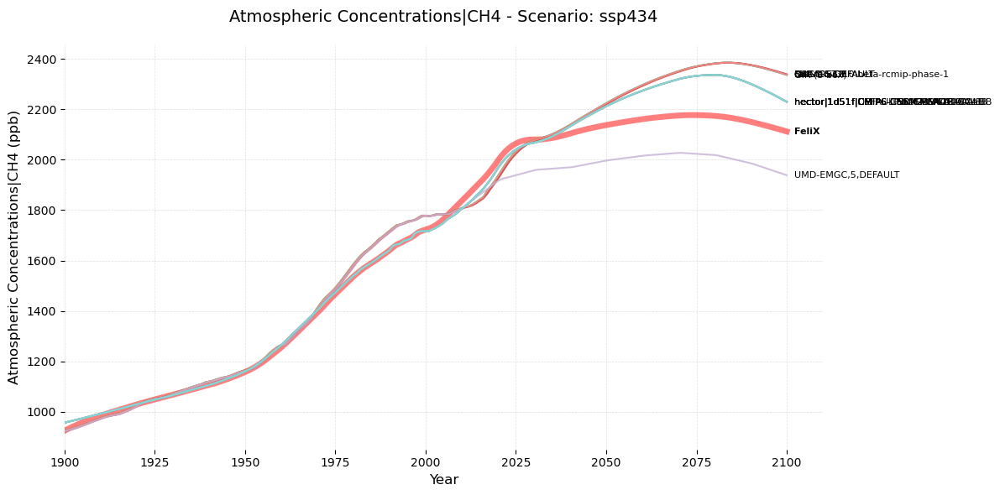

Original data shape: (11371, 1625)
After variable filtering: (767, 1625)
After scenario filtering: (15, 1625)
After region filtering: (15, 1625)
After year range filtering: (15, 206)
After excluding models: (15, 206)


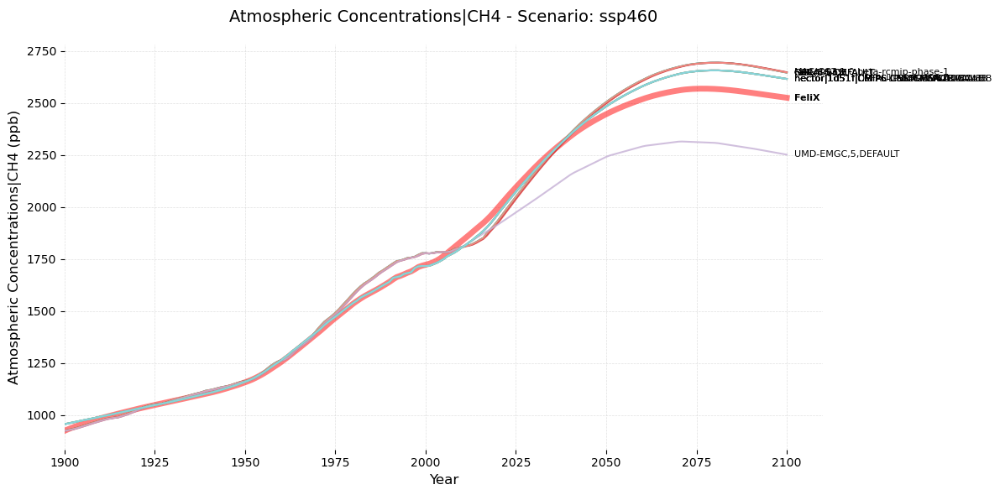

Original data shape: (11371, 1625)
After variable filtering: (767, 1625)
After scenario filtering: (7, 1625)
After region filtering: (7, 1625)
After year range filtering: (7, 206)
After excluding models: (7, 206)


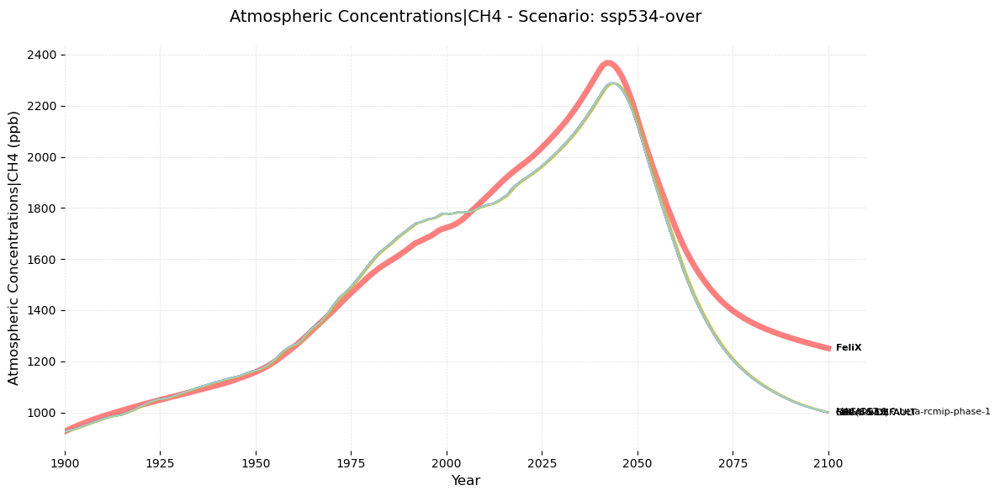

Original data shape: (11371, 1625)
After variable filtering: (767, 1625)
After scenario filtering: (26, 1625)
After region filtering: (26, 1625)
After year range filtering: (26, 206)
After excluding models: (25, 206)


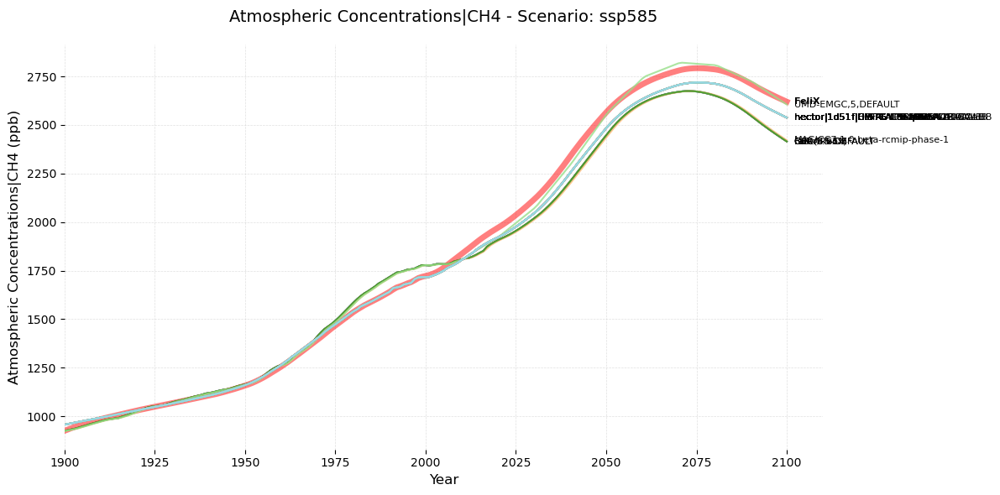

Original data shape: (11371, 1625)
After variable filtering: (767, 1625)
After scenario filtering: (23, 1625)
After region filtering: (23, 1625)
After year range filtering: (23, 206)
After excluding models: (22, 206)


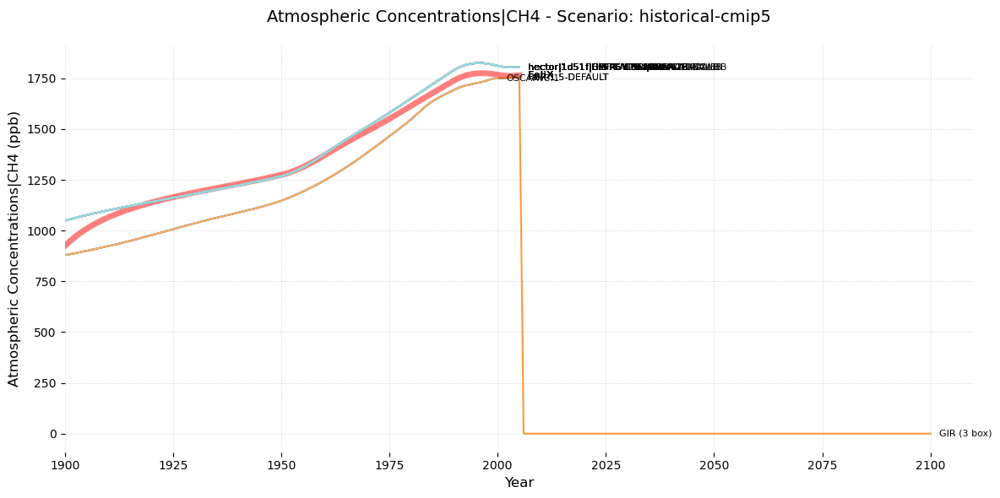

Original data shape: (11371, 1625)
After variable filtering: (1463, 1625)
After scenario filtering: (53, 1625)
After region filtering: (53, 1625)
After year range filtering: (53, 206)
After excluding models: (51, 206)


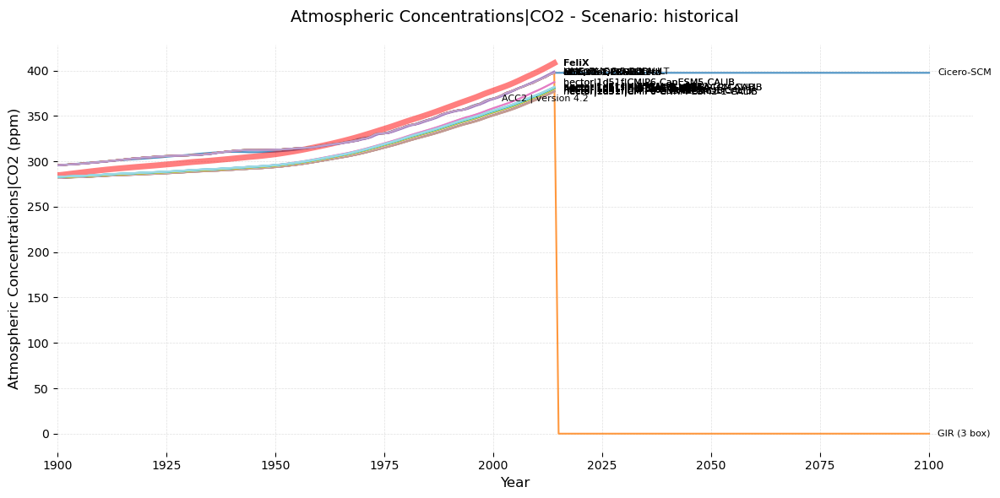

Original data shape: (11371, 1625)
After variable filtering: (1463, 1625)
After scenario filtering: (25, 1625)
After region filtering: (25, 1625)
After year range filtering: (25, 206)
After excluding models: (24, 206)


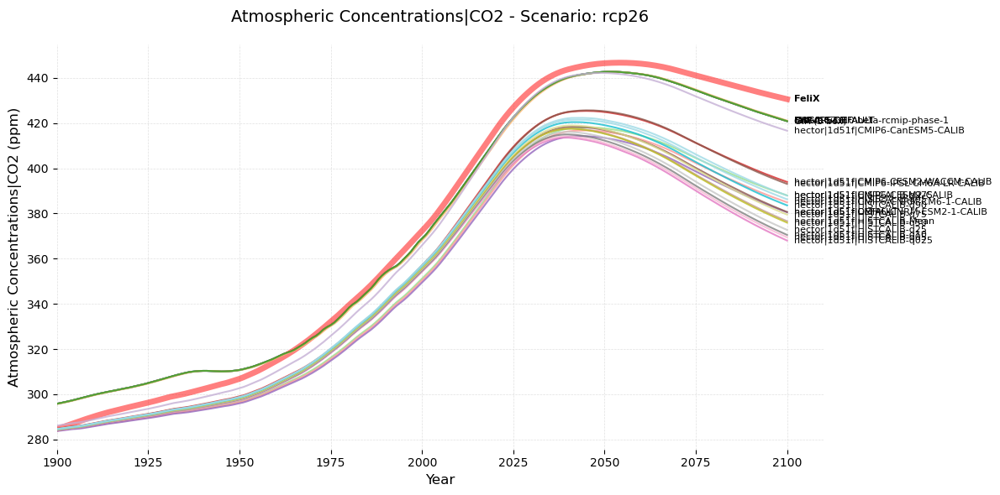

Original data shape: (11371, 1625)
After variable filtering: (1463, 1625)
After scenario filtering: (25, 1625)
After region filtering: (25, 1625)
After year range filtering: (25, 206)
After excluding models: (24, 206)


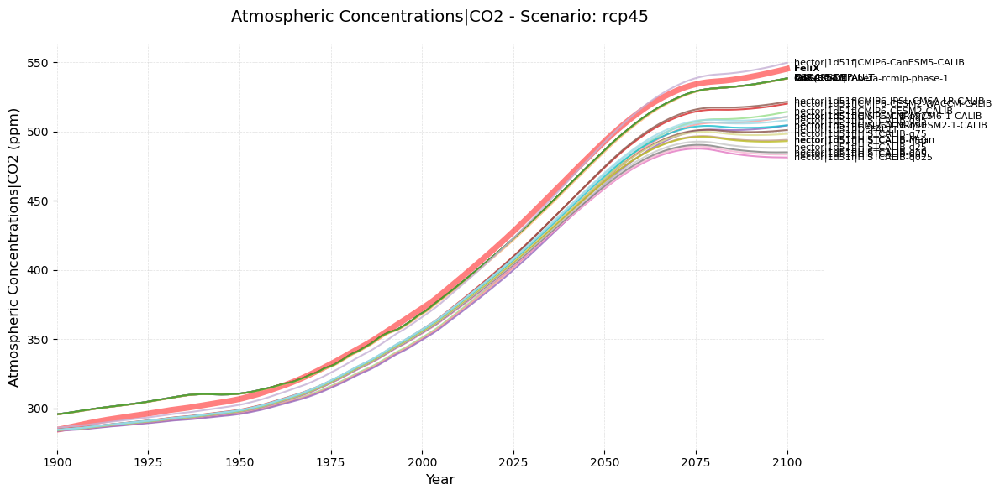

Original data shape: (11371, 1625)
After variable filtering: (1463, 1625)
After scenario filtering: (25, 1625)
After region filtering: (25, 1625)
After year range filtering: (25, 206)
After excluding models: (24, 206)


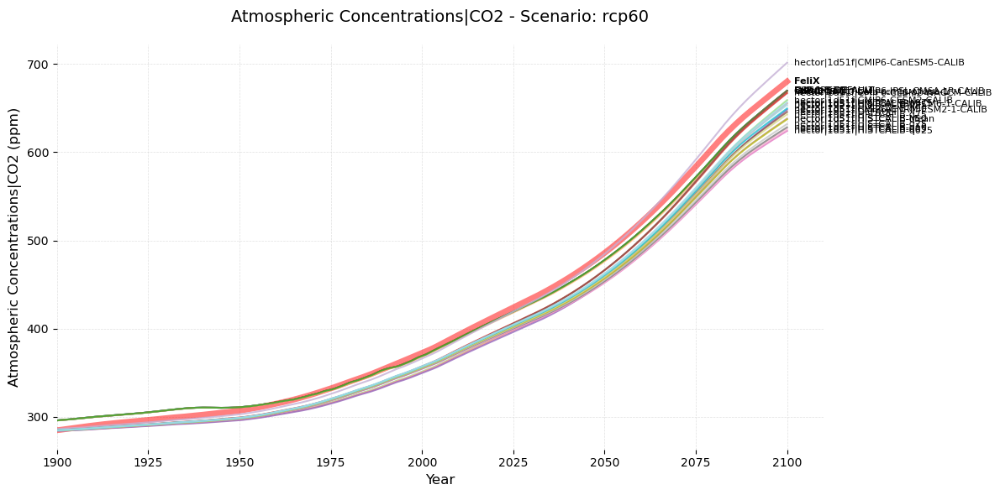

Original data shape: (11371, 1625)
After variable filtering: (1463, 1625)
After scenario filtering: (25, 1625)
After region filtering: (25, 1625)
After year range filtering: (25, 206)
After excluding models: (24, 206)


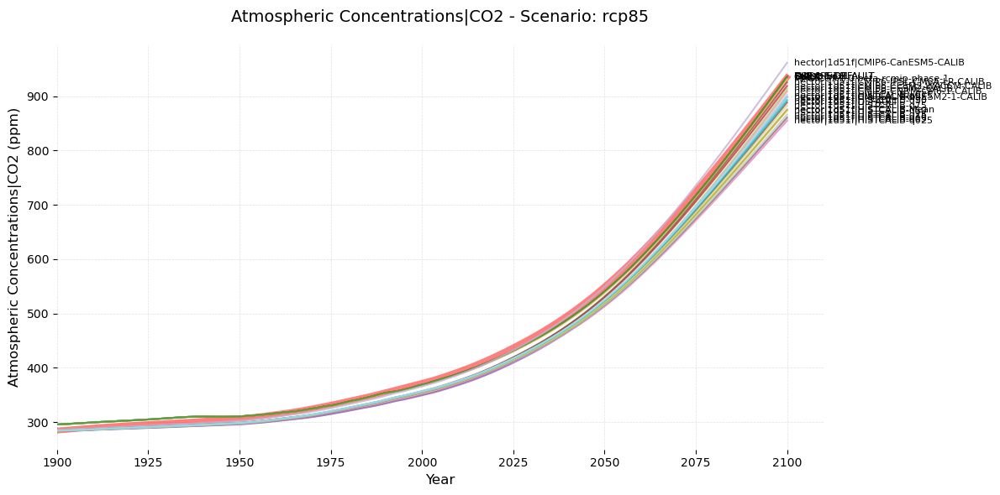

Original data shape: (11371, 1625)
After variable filtering: (1463, 1625)
After scenario filtering: (35, 1625)
After region filtering: (35, 1625)
After year range filtering: (35, 206)
After excluding models: (34, 206)


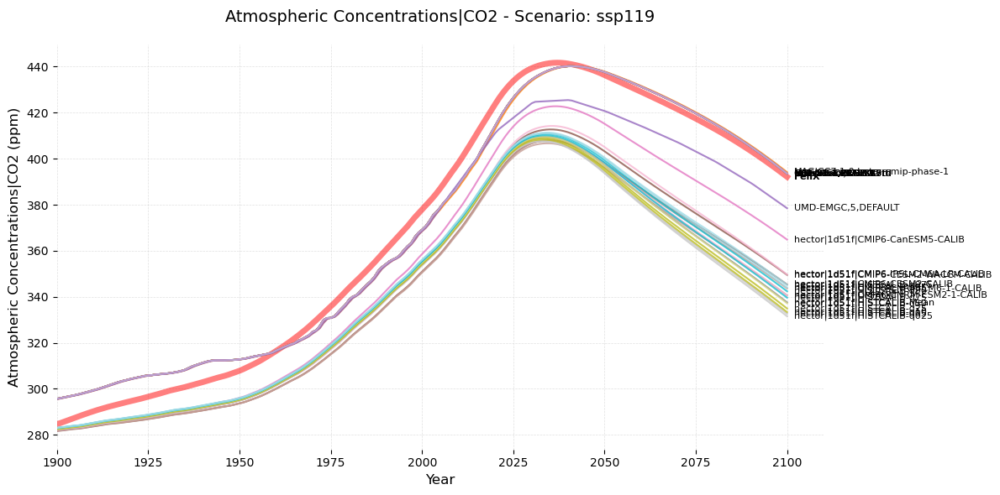

Original data shape: (11371, 1625)
After variable filtering: (1463, 1625)
After scenario filtering: (24, 1625)
After region filtering: (24, 1625)
After year range filtering: (24, 206)
After excluding models: (24, 206)


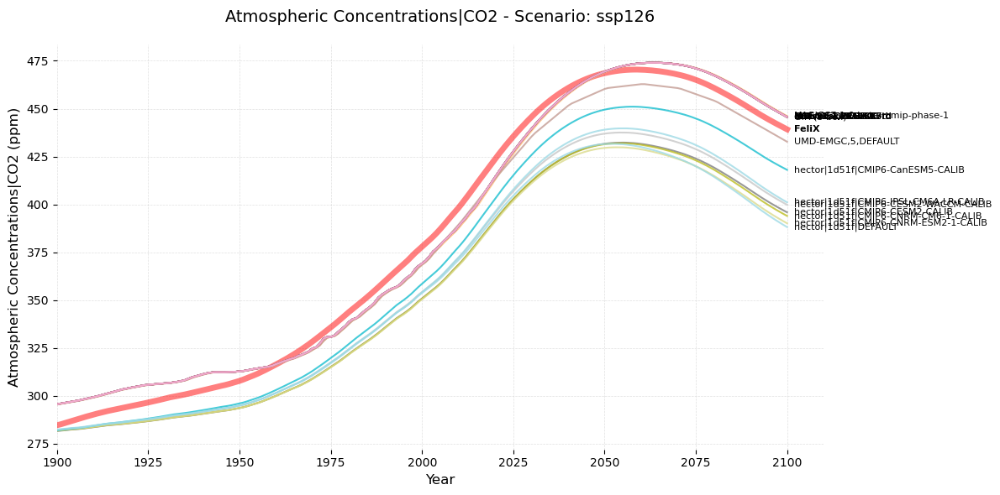

Original data shape: (11371, 1625)
After variable filtering: (1463, 1625)
After scenario filtering: (24, 1625)
After region filtering: (24, 1625)
After year range filtering: (24, 206)
After excluding models: (24, 206)


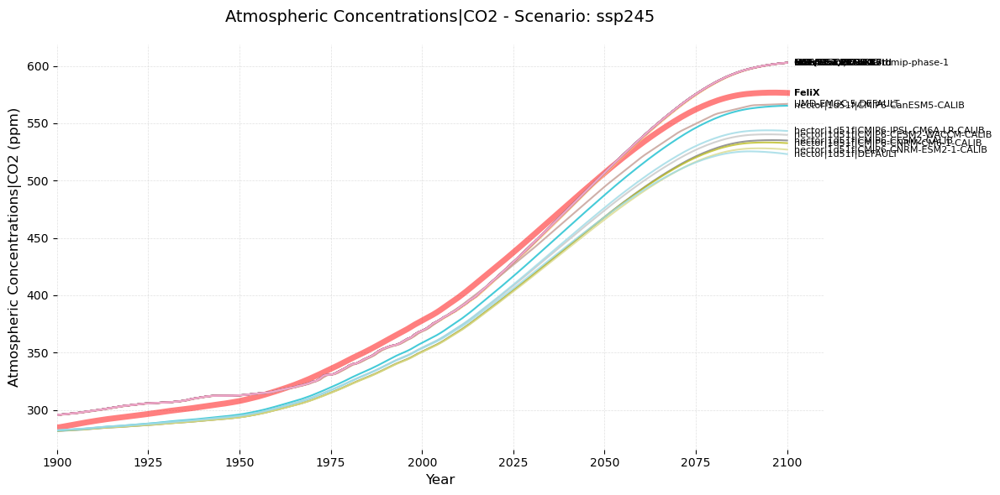

Original data shape: (11371, 1625)
After variable filtering: (1463, 1625)
After scenario filtering: (31, 1625)
After region filtering: (31, 1625)
After year range filtering: (31, 206)
After excluding models: (31, 206)


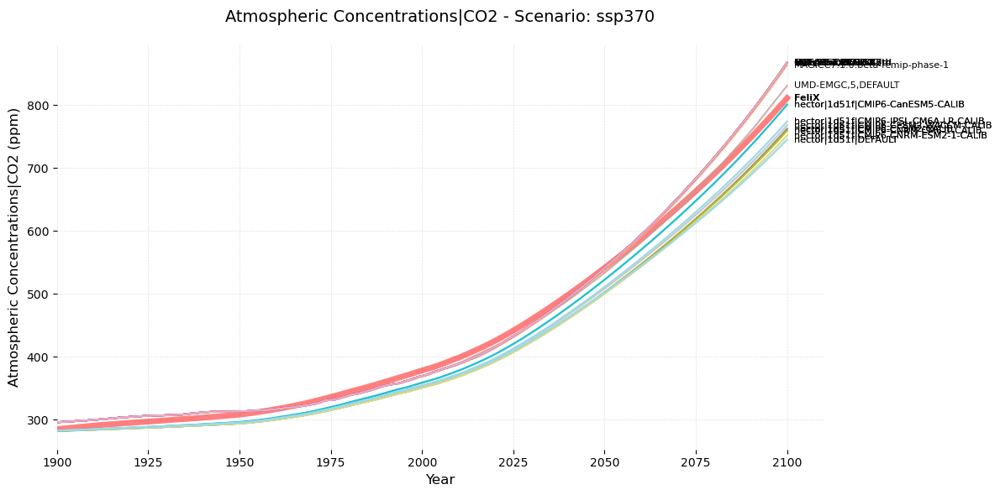

Original data shape: (11371, 1625)
After variable filtering: (1463, 1625)
After scenario filtering: (13, 1625)
After region filtering: (13, 1625)
After year range filtering: (13, 206)
After excluding models: (13, 206)


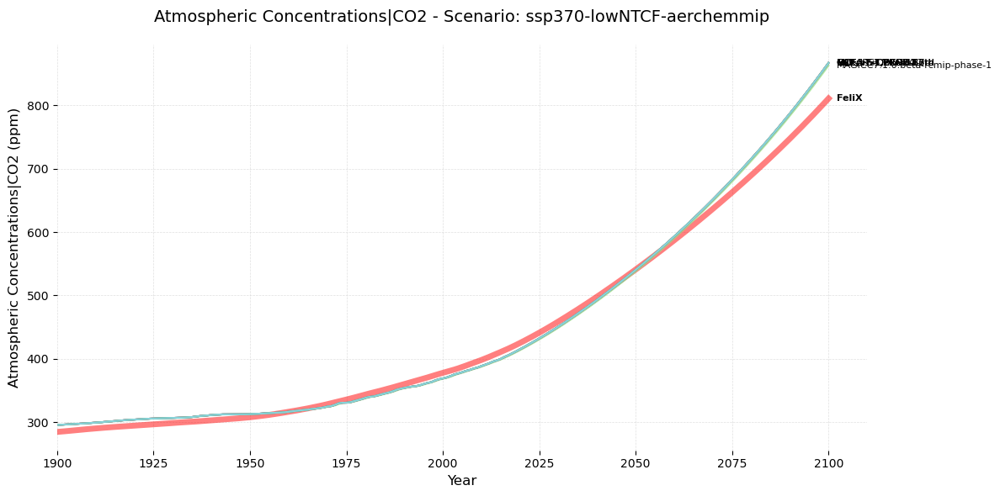

Original data shape: (11371, 1625)
After variable filtering: (1463, 1625)
After scenario filtering: (11, 1625)
After region filtering: (11, 1625)
After year range filtering: (11, 206)
After excluding models: (11, 206)


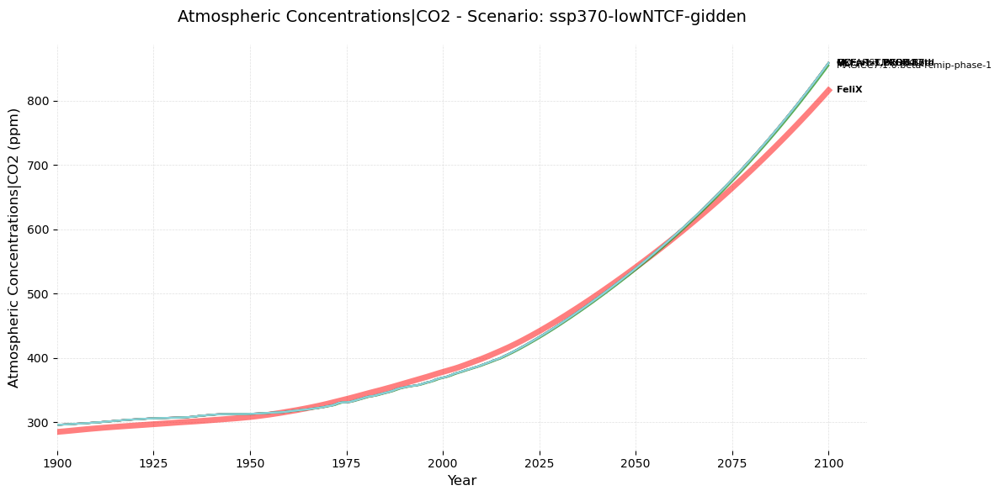

Original data shape: (11371, 1625)
After variable filtering: (1463, 1625)
After scenario filtering: (24, 1625)
After region filtering: (24, 1625)
After year range filtering: (24, 206)
After excluding models: (24, 206)


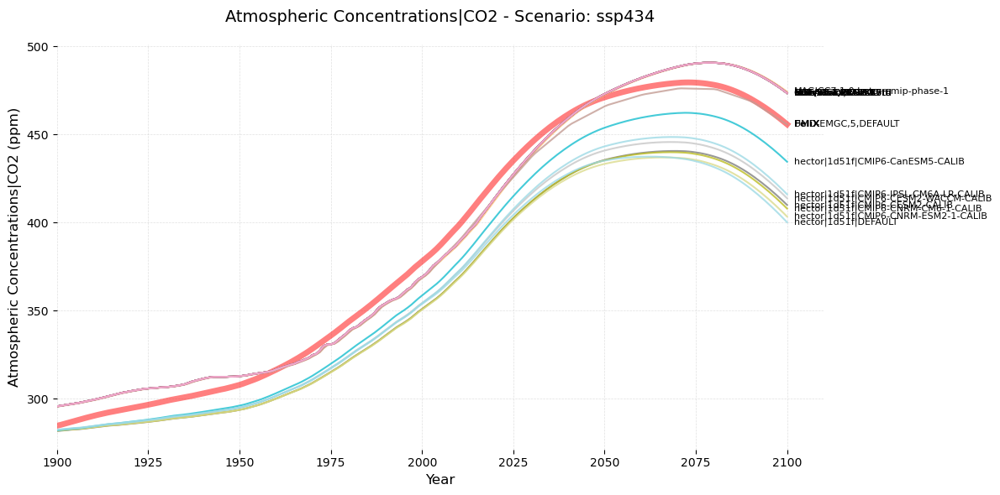

Original data shape: (11371, 1625)
After variable filtering: (1463, 1625)
After scenario filtering: (24, 1625)
After region filtering: (24, 1625)
After year range filtering: (24, 206)
After excluding models: (24, 206)


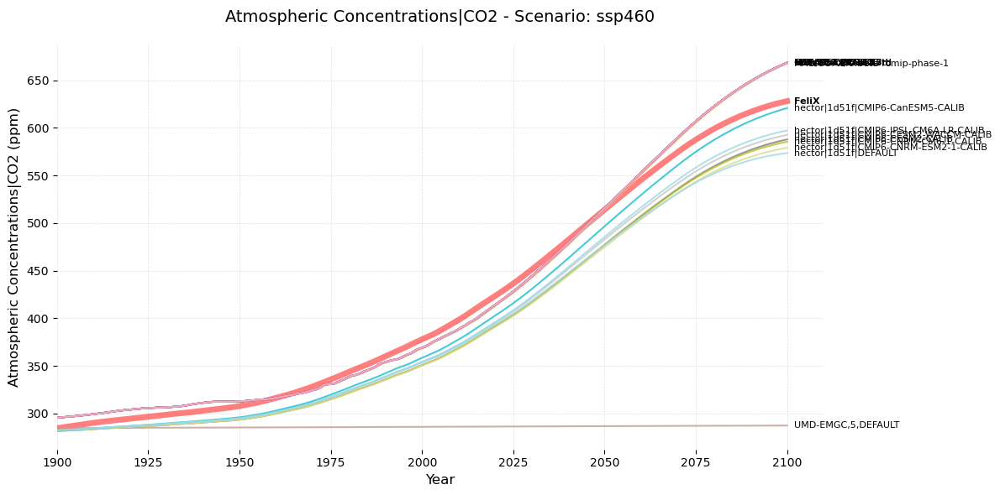

Original data shape: (11371, 1625)
After variable filtering: (1463, 1625)
After scenario filtering: (16, 1625)
After region filtering: (16, 1625)
After year range filtering: (16, 206)
After excluding models: (16, 206)


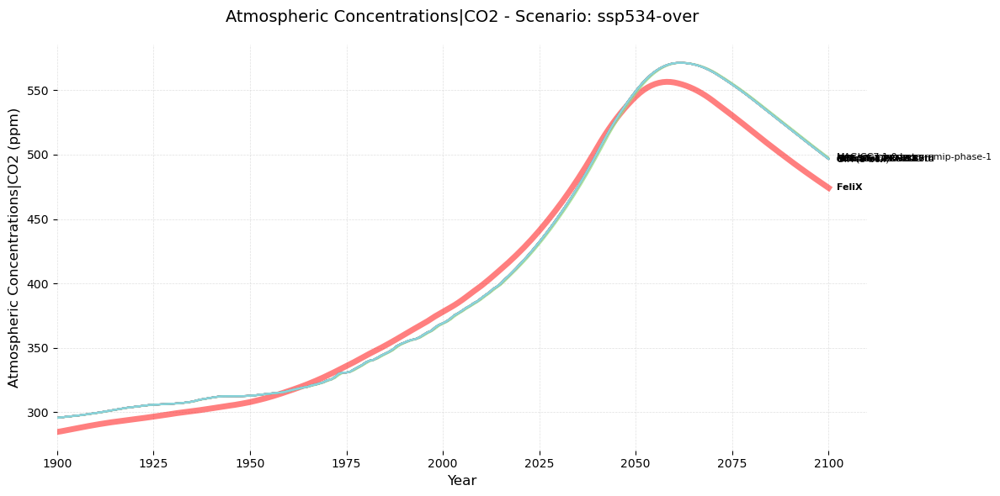

Original data shape: (11371, 1625)
After variable filtering: (1463, 1625)
After scenario filtering: (35, 1625)
After region filtering: (35, 1625)
After year range filtering: (35, 206)
After excluding models: (34, 206)


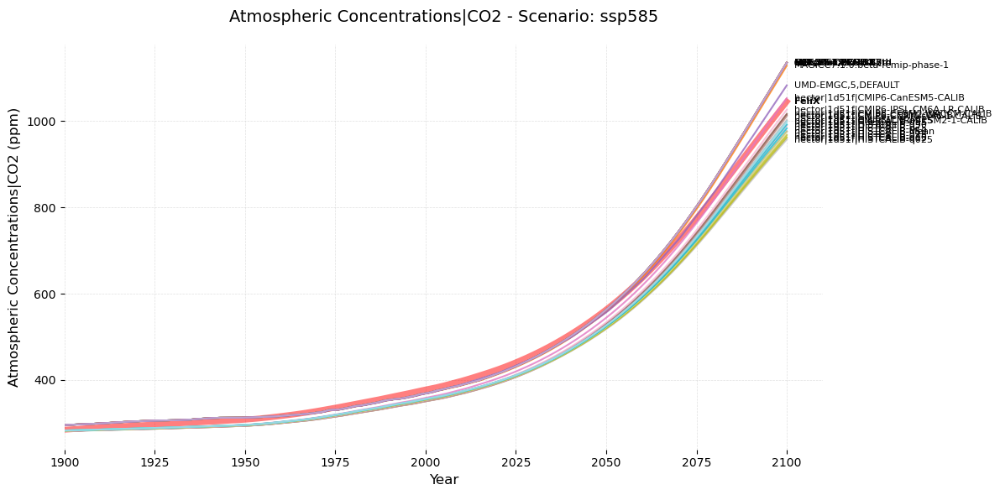

Original data shape: (11371, 1625)
After variable filtering: (1463, 1625)
After scenario filtering: (23, 1625)
After region filtering: (23, 1625)
After year range filtering: (23, 206)
After excluding models: (22, 206)


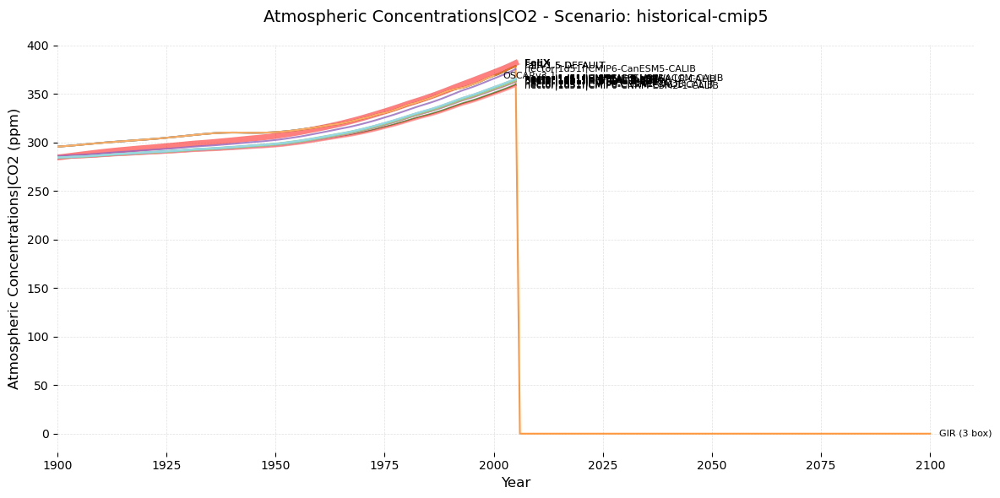

Original data shape: (11371, 1625)
After variable filtering: (430, 1625)
After scenario filtering: (7, 1625)
After region filtering: (7, 1625)
After year range filtering: (7, 206)
After excluding models: (7, 206)


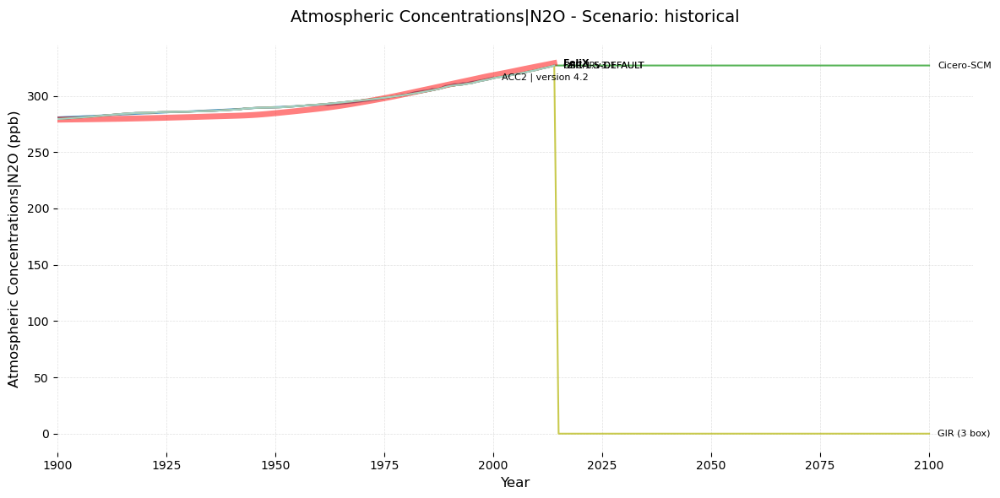

Original data shape: (11371, 1625)
After variable filtering: (430, 1625)
After scenario filtering: (7, 1625)
After region filtering: (7, 1625)
After year range filtering: (7, 206)
After excluding models: (7, 206)


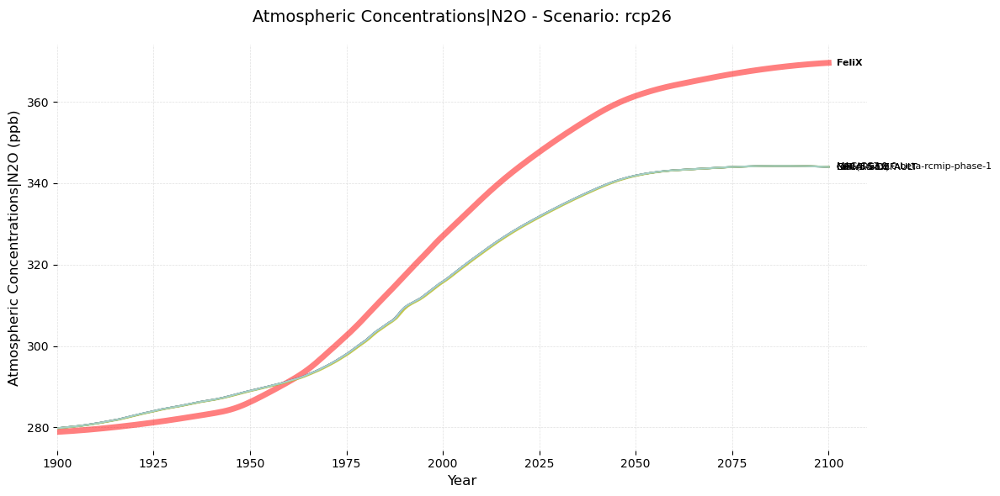

Original data shape: (11371, 1625)
After variable filtering: (430, 1625)
After scenario filtering: (7, 1625)
After region filtering: (7, 1625)
After year range filtering: (7, 206)
After excluding models: (7, 206)


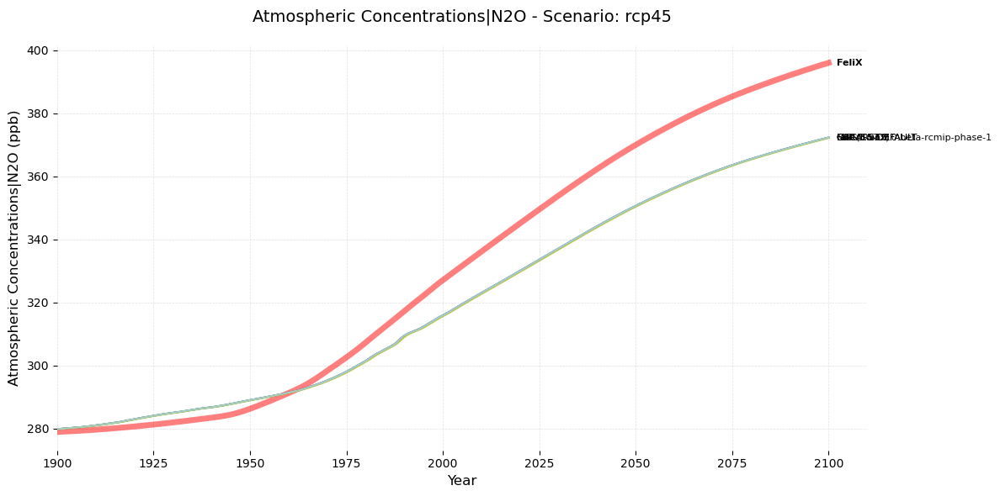

Original data shape: (11371, 1625)
After variable filtering: (430, 1625)
After scenario filtering: (7, 1625)
After region filtering: (7, 1625)
After year range filtering: (7, 206)
After excluding models: (7, 206)


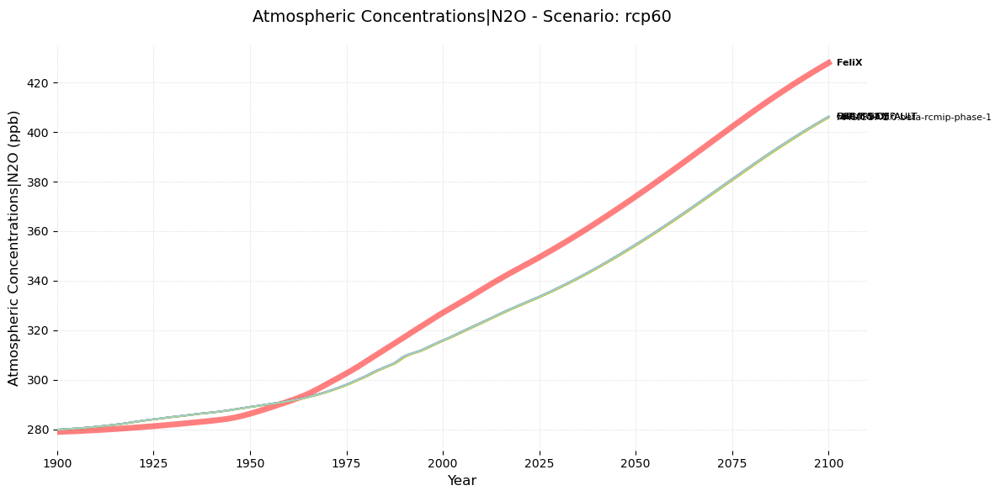

Original data shape: (11371, 1625)
After variable filtering: (430, 1625)
After scenario filtering: (7, 1625)
After region filtering: (7, 1625)
After year range filtering: (7, 206)
After excluding models: (7, 206)


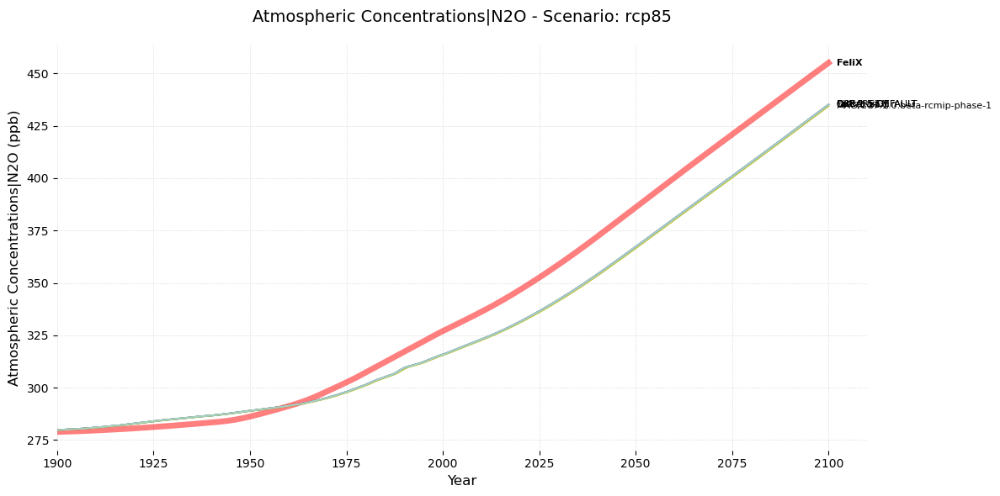

Original data shape: (11371, 1625)
After variable filtering: (430, 1625)
After scenario filtering: (7, 1625)
After region filtering: (7, 1625)
After year range filtering: (7, 206)
After excluding models: (7, 206)


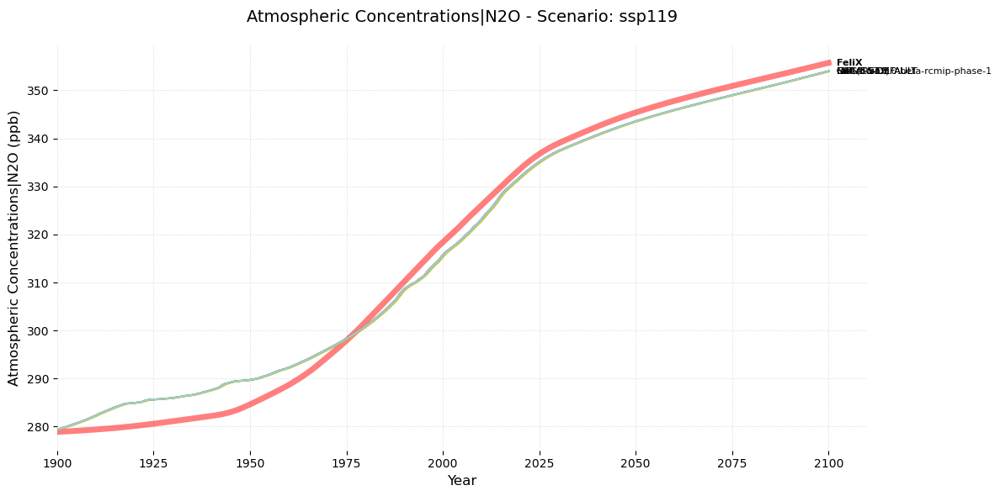

Original data shape: (11371, 1625)
After variable filtering: (430, 1625)
After scenario filtering: (7, 1625)
After region filtering: (7, 1625)
After year range filtering: (7, 206)
After excluding models: (7, 206)


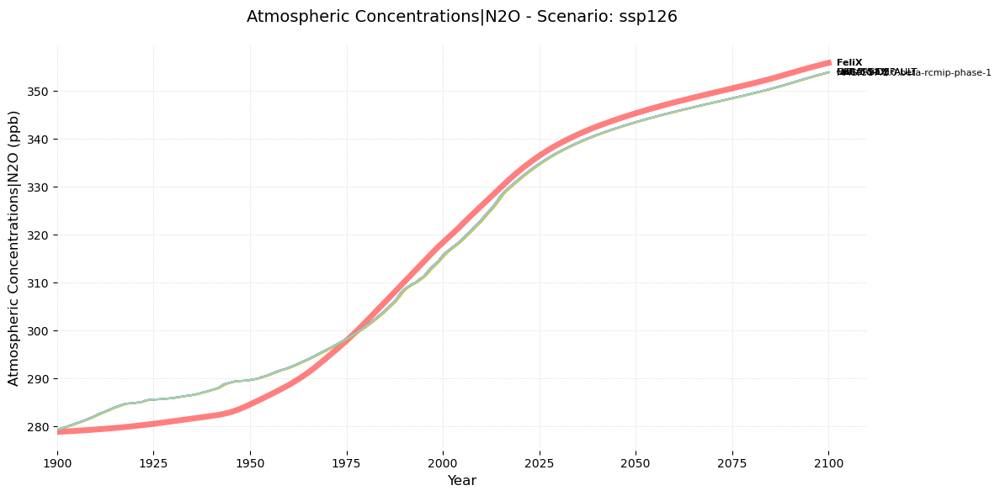

Original data shape: (11371, 1625)
After variable filtering: (430, 1625)
After scenario filtering: (7, 1625)
After region filtering: (7, 1625)
After year range filtering: (7, 206)
After excluding models: (7, 206)


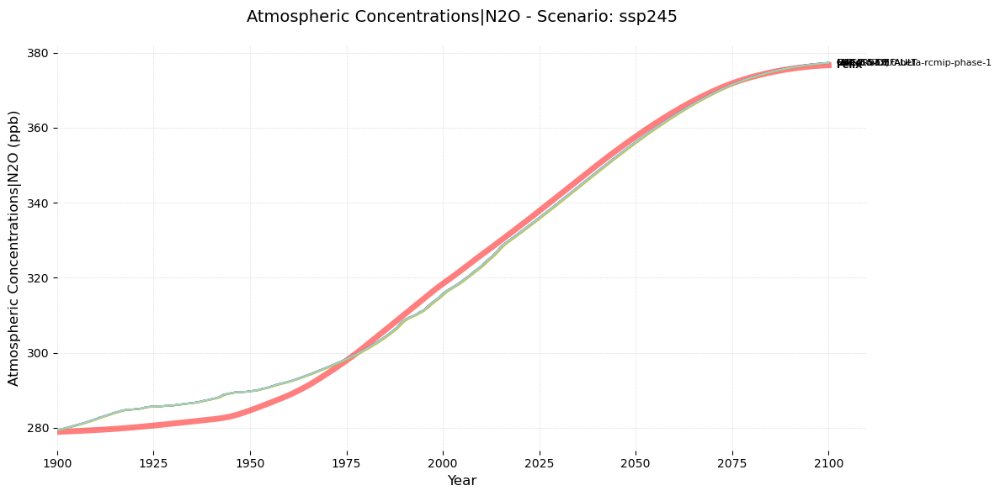

Original data shape: (11371, 1625)
After variable filtering: (430, 1625)
After scenario filtering: (7, 1625)
After region filtering: (7, 1625)
After year range filtering: (7, 206)
After excluding models: (7, 206)


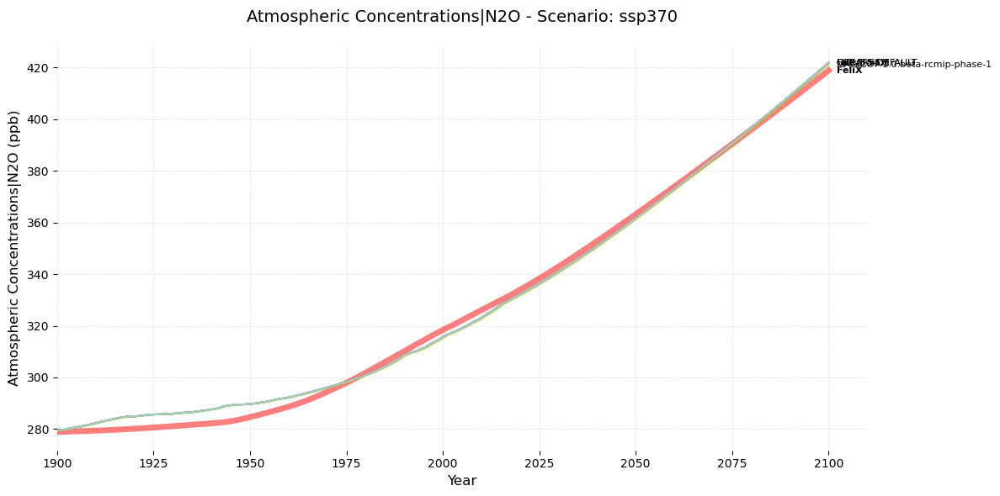

Original data shape: (11371, 1625)
After variable filtering: (430, 1625)
After scenario filtering: (6, 1625)
After region filtering: (6, 1625)
After year range filtering: (6, 206)
After excluding models: (6, 206)


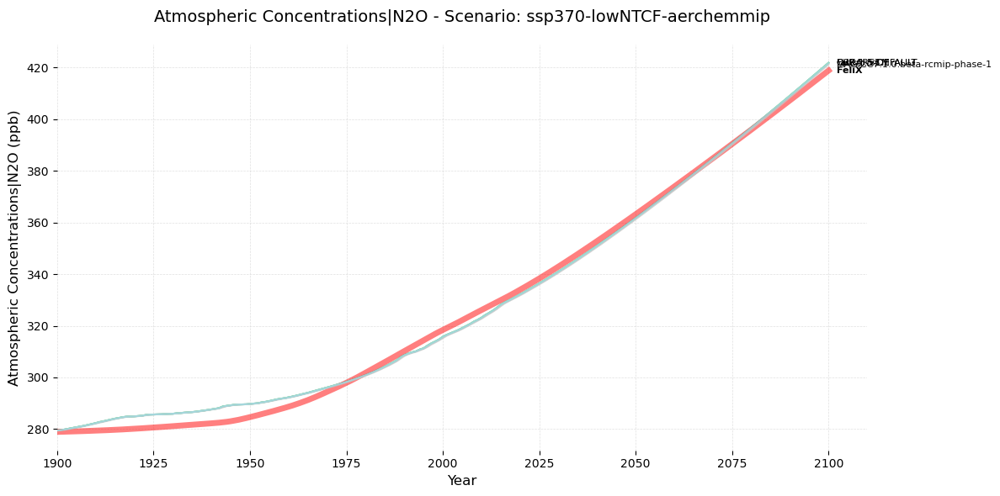

Original data shape: (11371, 1625)
After variable filtering: (430, 1625)
After scenario filtering: (4, 1625)
After region filtering: (4, 1625)
After year range filtering: (4, 206)
After excluding models: (4, 206)


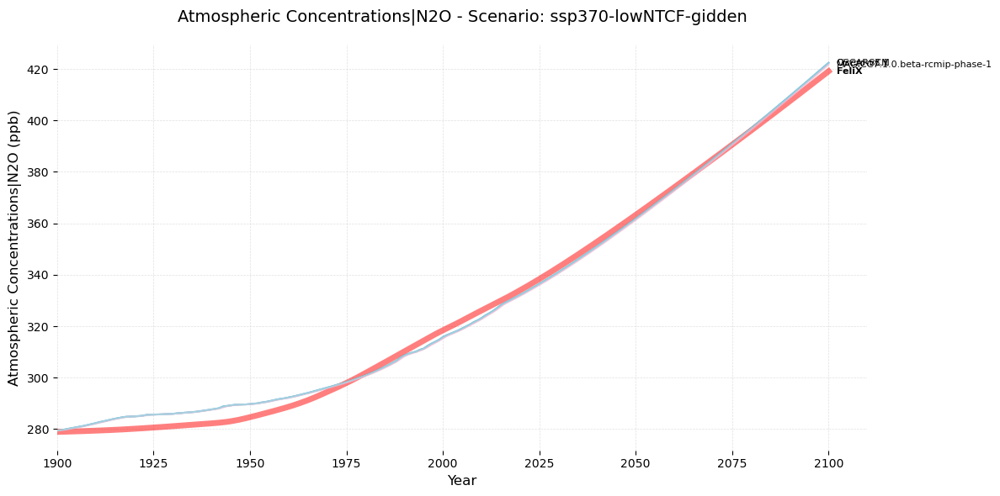

Original data shape: (11371, 1625)
After variable filtering: (430, 1625)
After scenario filtering: (7, 1625)
After region filtering: (7, 1625)
After year range filtering: (7, 206)
After excluding models: (7, 206)


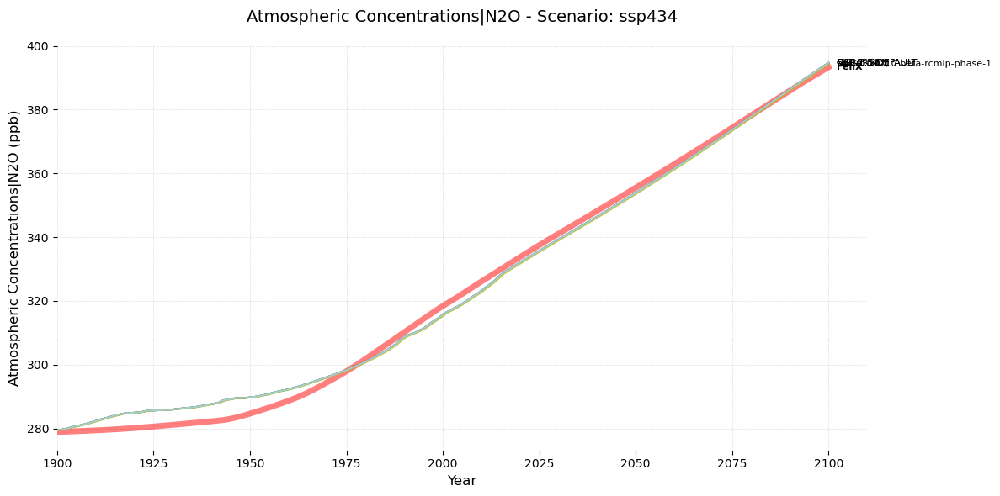

Original data shape: (11371, 1625)
After variable filtering: (430, 1625)
After scenario filtering: (7, 1625)
After region filtering: (7, 1625)
After year range filtering: (7, 206)
After excluding models: (7, 206)


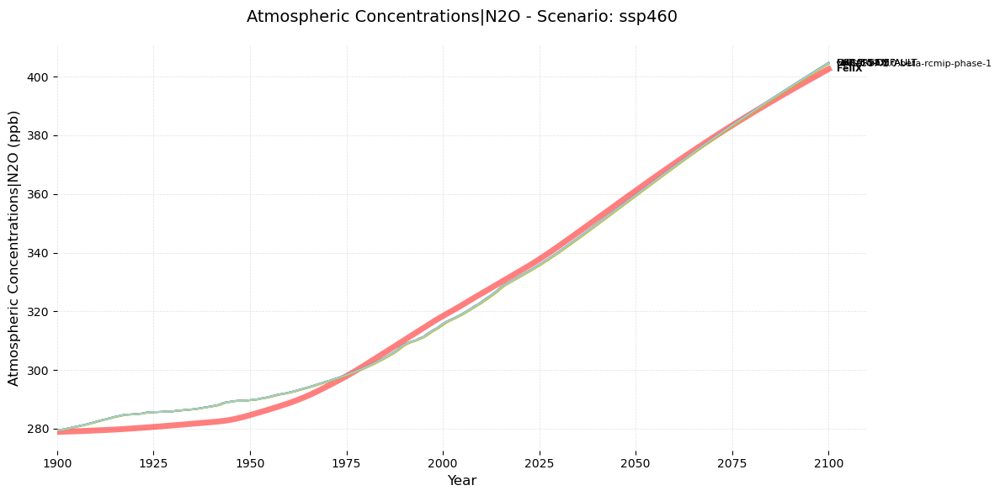

Original data shape: (11371, 1625)
After variable filtering: (430, 1625)
After scenario filtering: (7, 1625)
After region filtering: (7, 1625)
After year range filtering: (7, 206)
After excluding models: (7, 206)


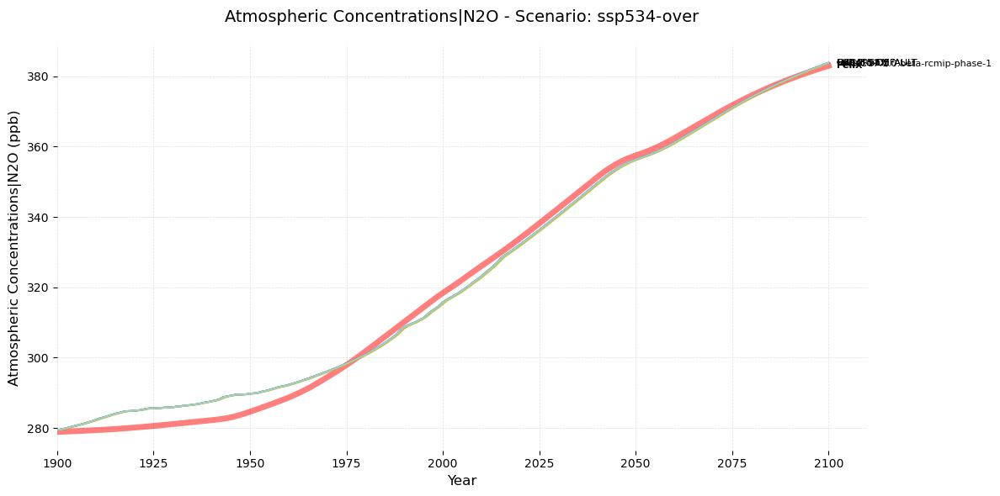

Original data shape: (11371, 1625)
After variable filtering: (430, 1625)
After scenario filtering: (7, 1625)
After region filtering: (7, 1625)
After year range filtering: (7, 206)
After excluding models: (7, 206)


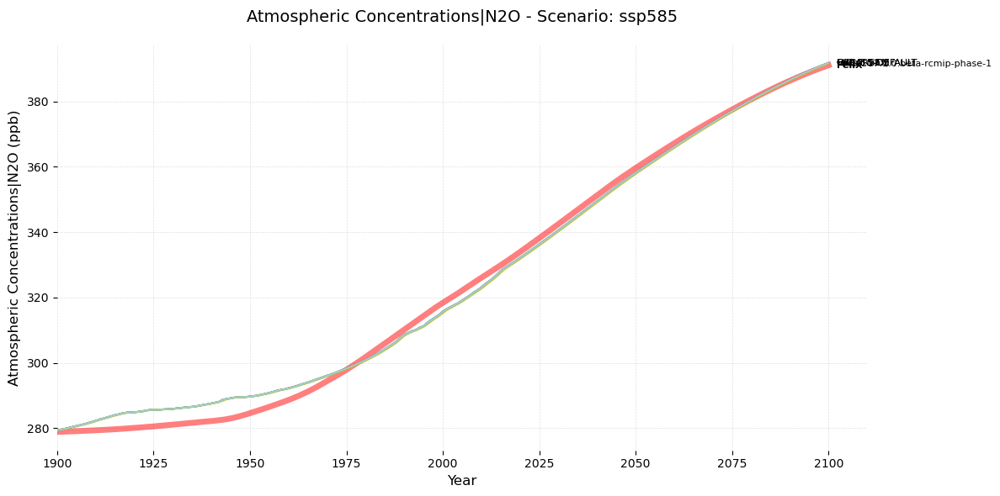

Original data shape: (11371, 1625)
After variable filtering: (430, 1625)
After scenario filtering: (5, 1625)
After region filtering: (5, 1625)
After year range filtering: (5, 206)
After excluding models: (5, 206)


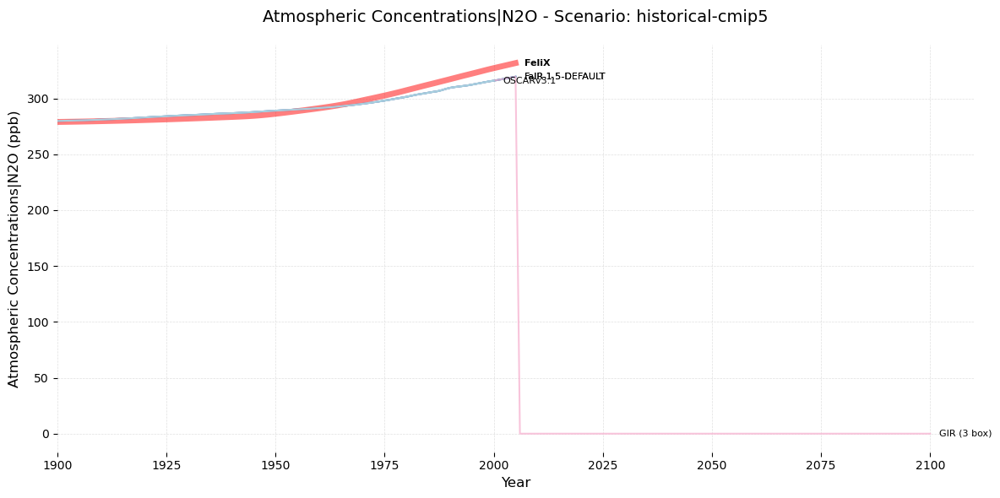

Original data shape: (11371, 1625)
After variable filtering: (142, 1625)
After scenario filtering: (3, 1625)
After region filtering: (3, 1625)
After year range filtering: (3, 206)
After excluding models: (3, 206)


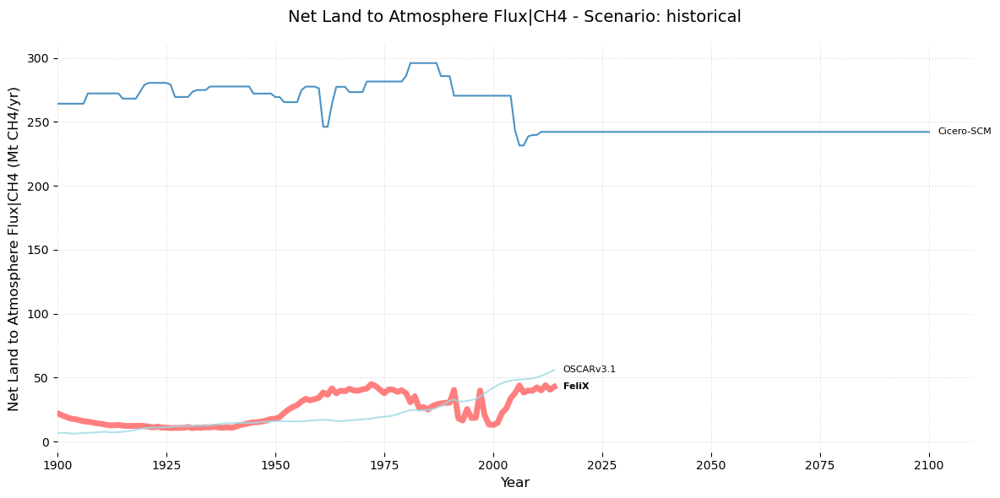

Original data shape: (11371, 1625)
After variable filtering: (142, 1625)
After scenario filtering: (3, 1625)
After region filtering: (3, 1625)
After year range filtering: (3, 206)
After excluding models: (3, 206)


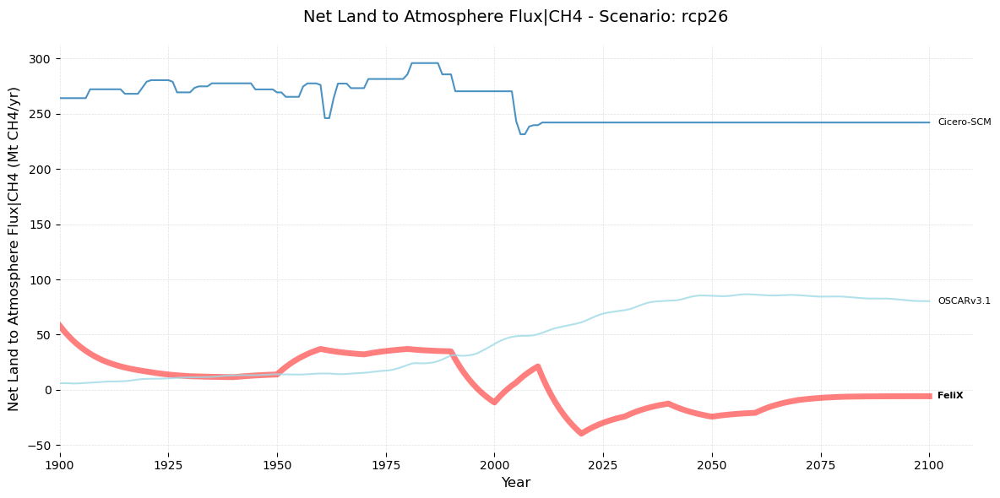

Original data shape: (11371, 1625)
After variable filtering: (142, 1625)
After scenario filtering: (3, 1625)
After region filtering: (3, 1625)
After year range filtering: (3, 206)
After excluding models: (3, 206)


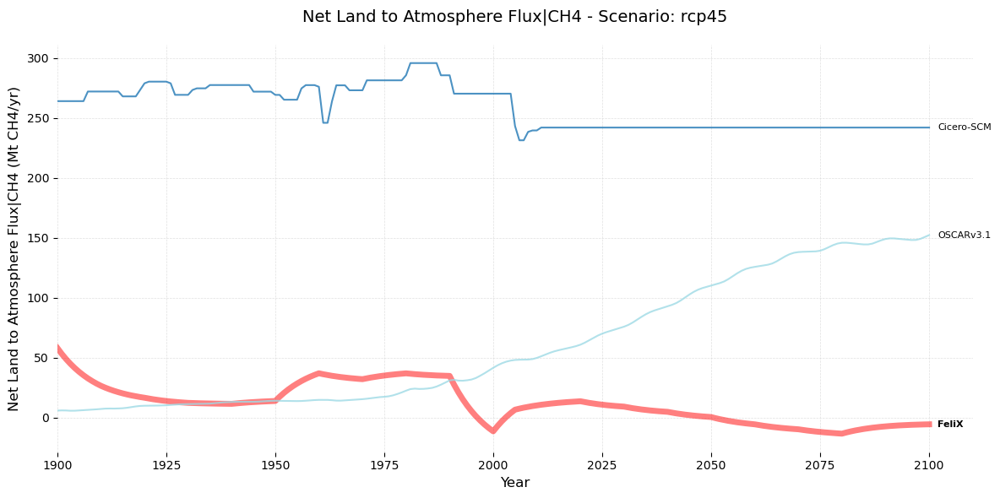

Original data shape: (11371, 1625)
After variable filtering: (142, 1625)
After scenario filtering: (3, 1625)
After region filtering: (3, 1625)
After year range filtering: (3, 206)
After excluding models: (3, 206)


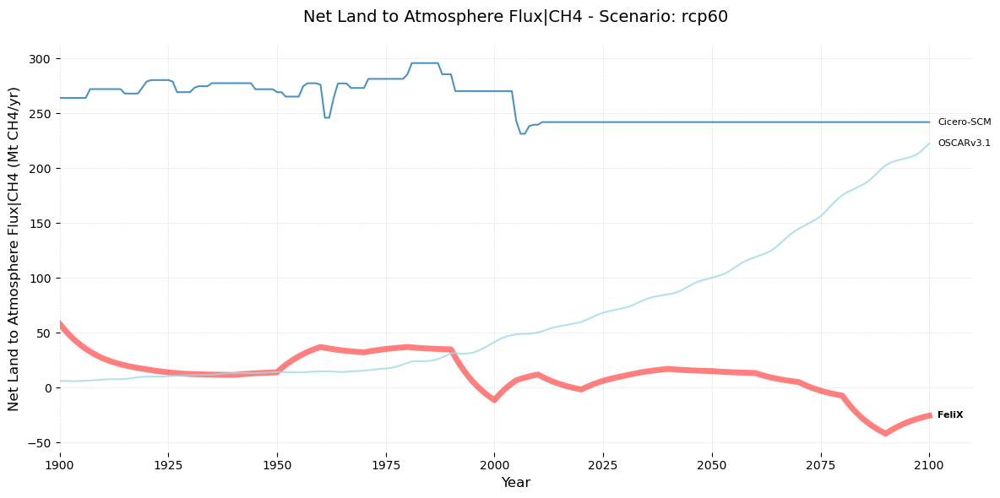

Original data shape: (11371, 1625)
After variable filtering: (142, 1625)
After scenario filtering: (3, 1625)
After region filtering: (3, 1625)
After year range filtering: (3, 206)
After excluding models: (3, 206)


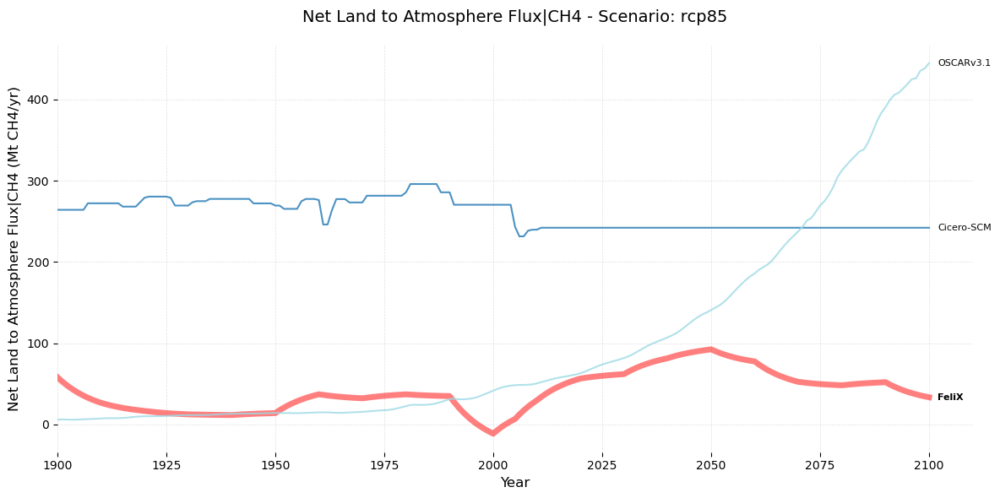

Original data shape: (11371, 1625)
After variable filtering: (142, 1625)
After scenario filtering: (3, 1625)
After region filtering: (3, 1625)
After year range filtering: (3, 206)
After excluding models: (3, 206)


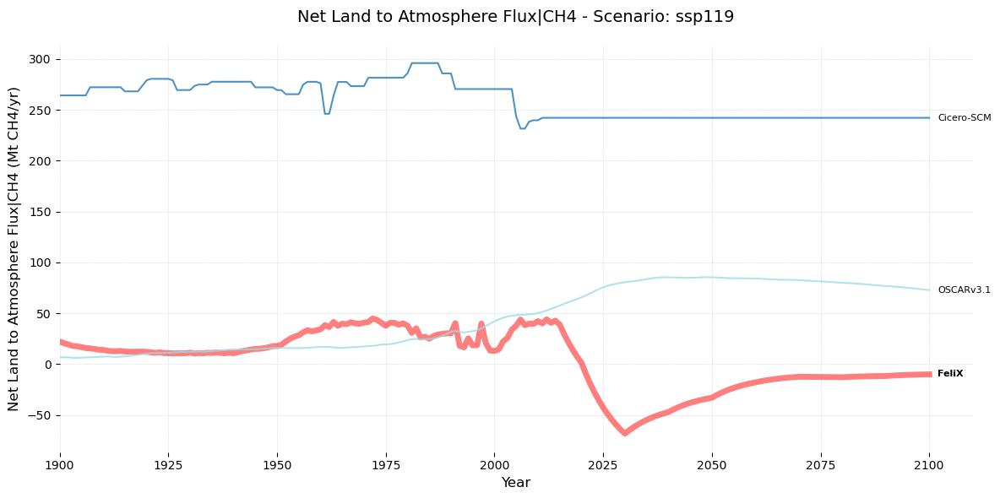

Original data shape: (11371, 1625)
After variable filtering: (142, 1625)
After scenario filtering: (3, 1625)
After region filtering: (3, 1625)
After year range filtering: (3, 206)
After excluding models: (3, 206)


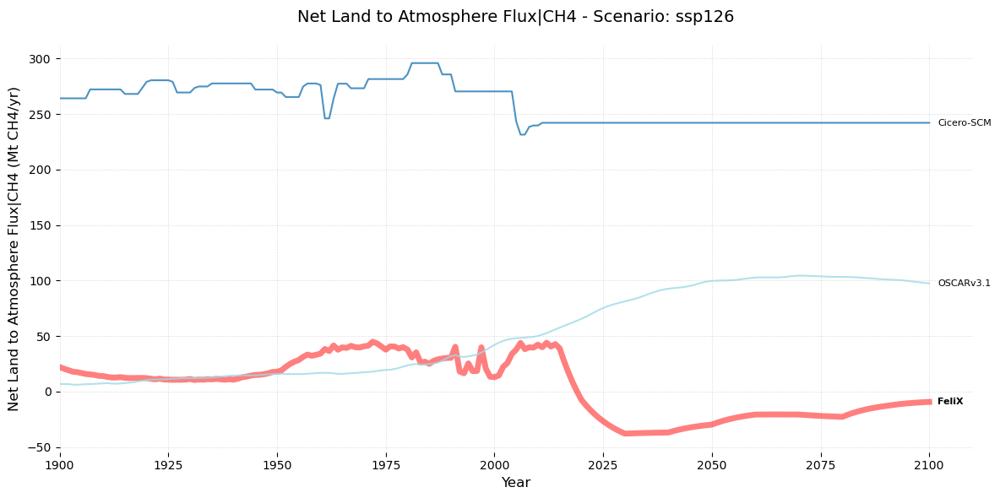

Original data shape: (11371, 1625)
After variable filtering: (142, 1625)
After scenario filtering: (3, 1625)
After region filtering: (3, 1625)
After year range filtering: (3, 206)
After excluding models: (3, 206)


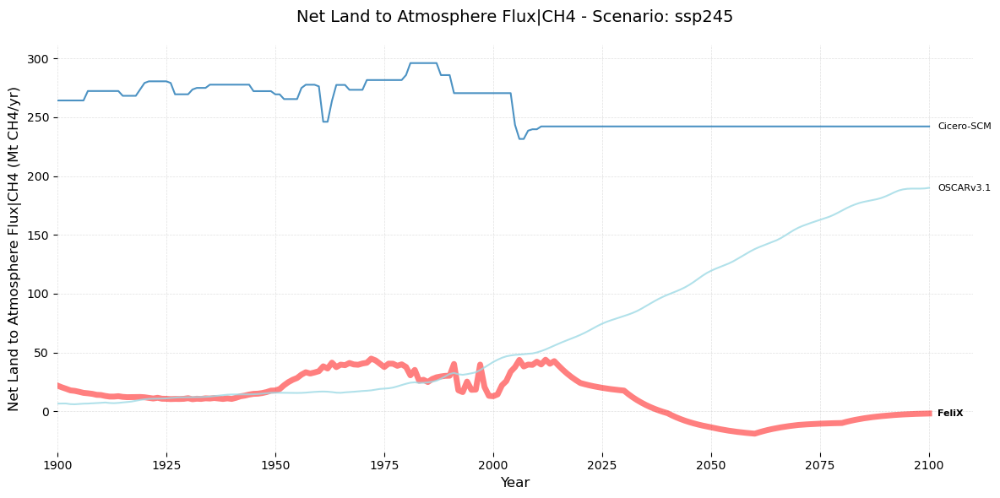

Original data shape: (11371, 1625)
After variable filtering: (142, 1625)
After scenario filtering: (3, 1625)
After region filtering: (3, 1625)
After year range filtering: (3, 206)
After excluding models: (3, 206)


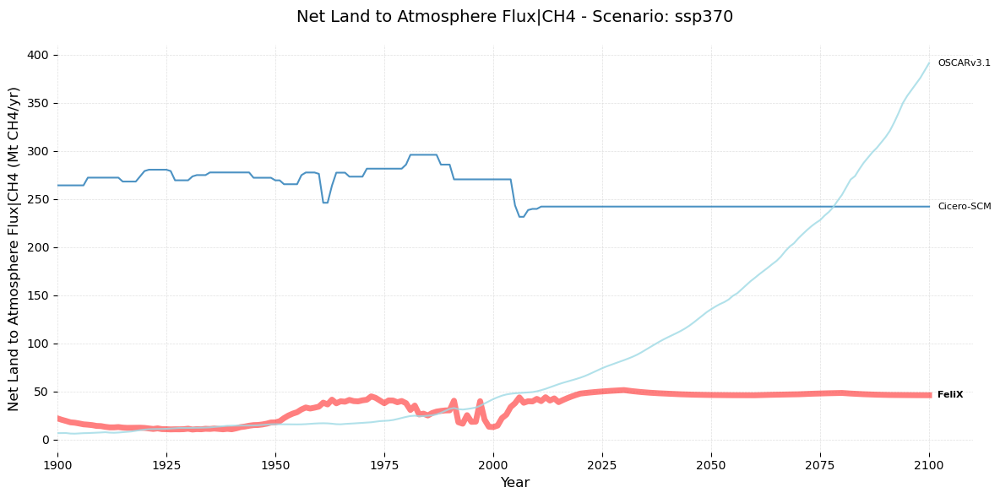

Original data shape: (11371, 1625)
After variable filtering: (142, 1625)
After scenario filtering: (3, 1625)
After region filtering: (3, 1625)
After year range filtering: (3, 206)
After excluding models: (3, 206)


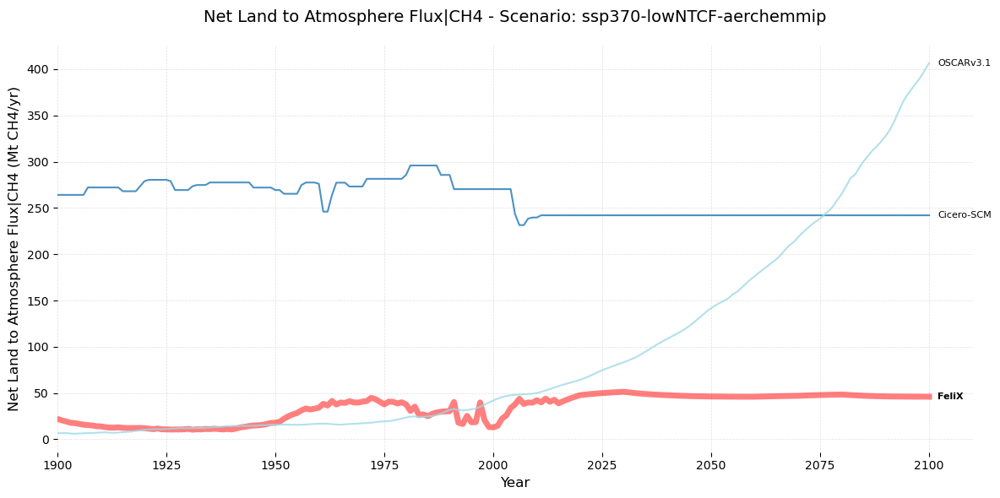

Original data shape: (11371, 1625)
After variable filtering: (142, 1625)
After scenario filtering: (3, 1625)
After region filtering: (3, 1625)
After year range filtering: (3, 206)
After excluding models: (3, 206)


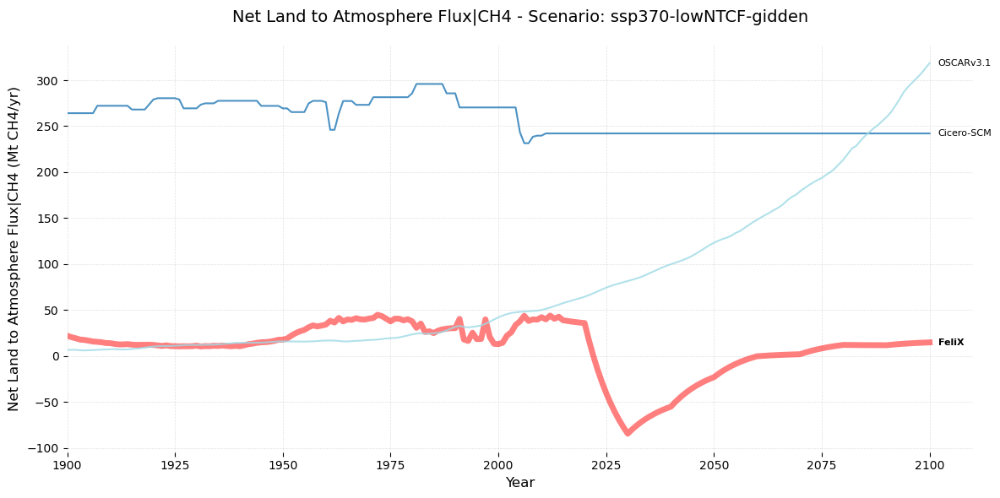

Original data shape: (11371, 1625)
After variable filtering: (142, 1625)
After scenario filtering: (3, 1625)
After region filtering: (3, 1625)
After year range filtering: (3, 206)
After excluding models: (3, 206)


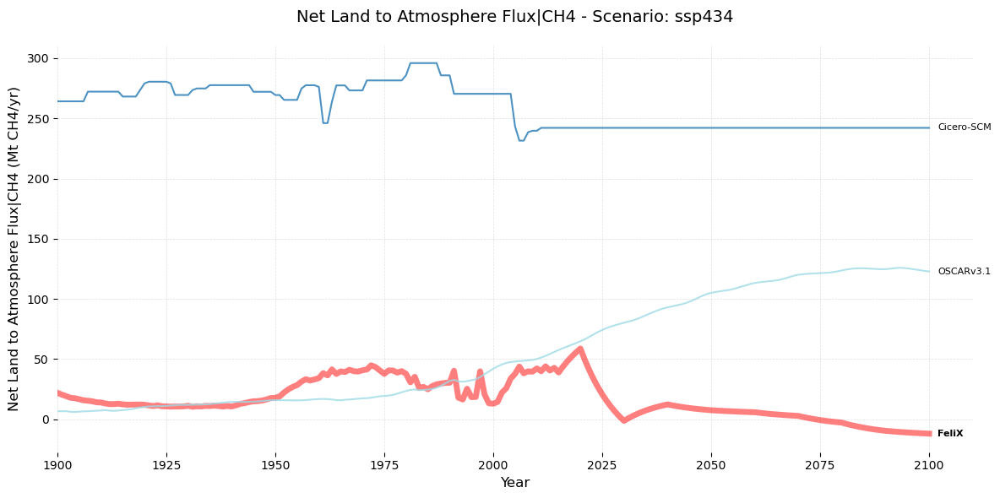

Original data shape: (11371, 1625)
After variable filtering: (142, 1625)
After scenario filtering: (3, 1625)
After region filtering: (3, 1625)
After year range filtering: (3, 206)
After excluding models: (3, 206)


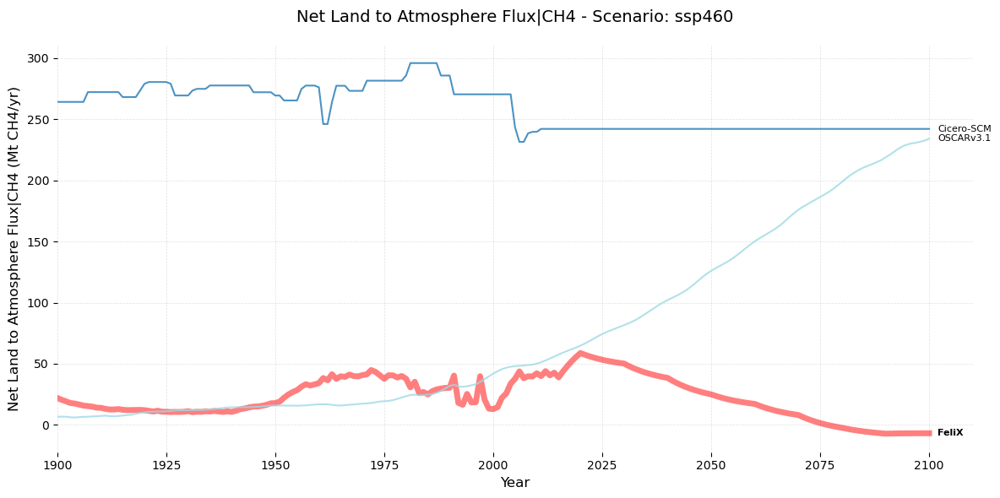

Original data shape: (11371, 1625)
After variable filtering: (142, 1625)
After scenario filtering: (3, 1625)
After region filtering: (3, 1625)
After year range filtering: (3, 206)
After excluding models: (3, 206)


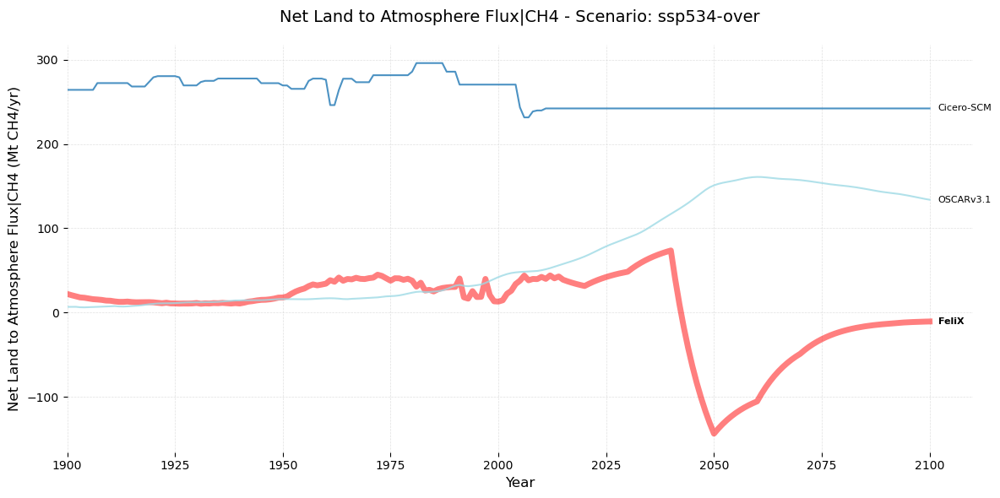

Original data shape: (11371, 1625)
After variable filtering: (142, 1625)
After scenario filtering: (3, 1625)
After region filtering: (3, 1625)
After year range filtering: (3, 206)
After excluding models: (3, 206)


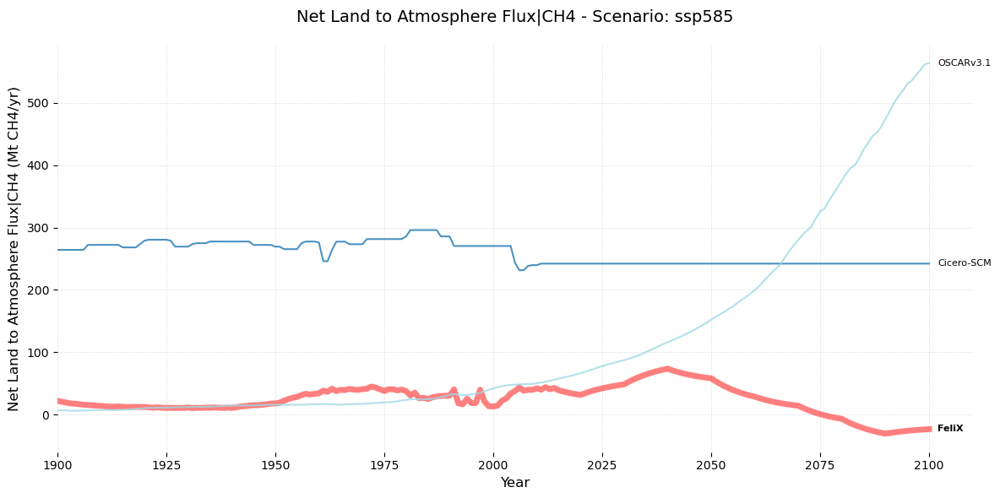

Original data shape: (11371, 1625)
After variable filtering: (142, 1625)
After scenario filtering: (2, 1625)
After region filtering: (2, 1625)
After year range filtering: (2, 206)
After excluding models: (2, 206)


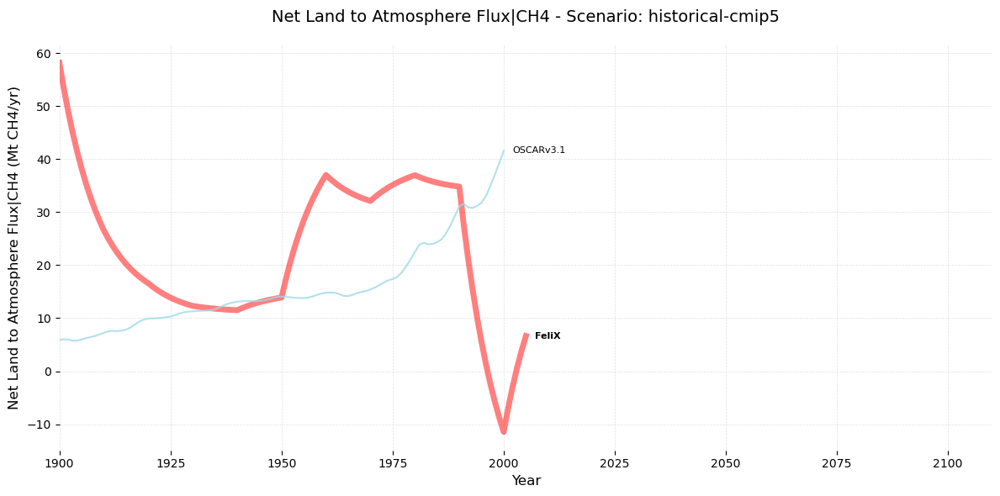

Original data shape: (11371, 1625)
After variable filtering: (562, 1625)
After scenario filtering: (9, 1625)
After region filtering: (9, 1625)
After year range filtering: (9, 206)
After excluding models: (9, 206)


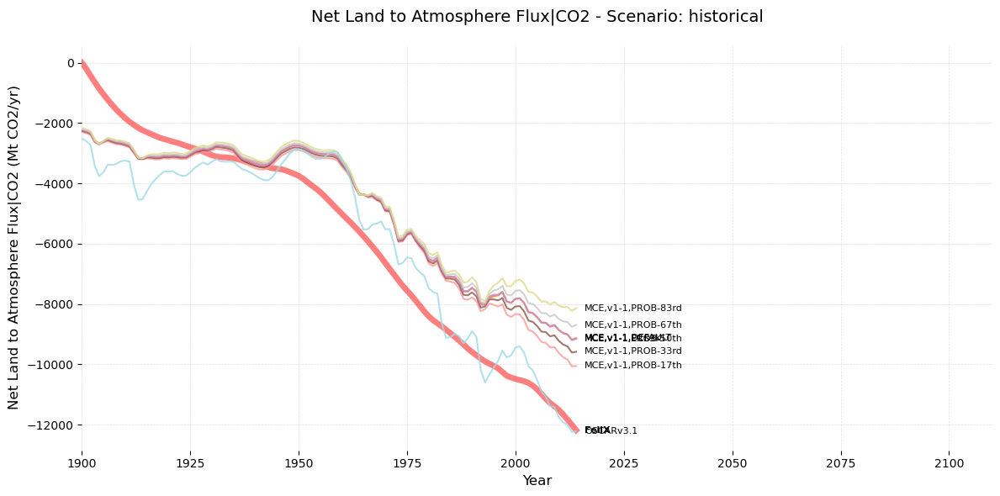

Original data shape: (11371, 1625)
After variable filtering: (562, 1625)
After scenario filtering: (2, 1625)
After region filtering: (2, 1625)
After year range filtering: (2, 206)
After excluding models: (2, 206)


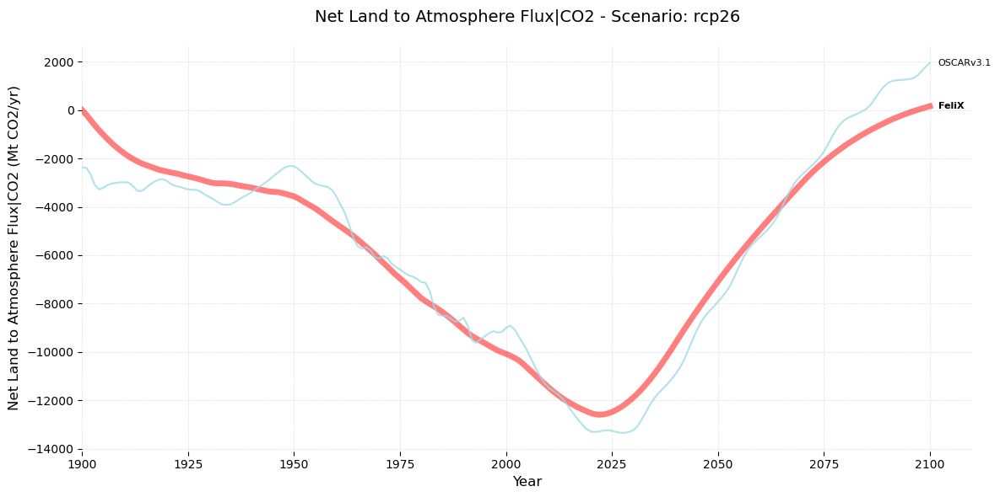

Original data shape: (11371, 1625)
After variable filtering: (562, 1625)
After scenario filtering: (2, 1625)
After region filtering: (2, 1625)
After year range filtering: (2, 206)
After excluding models: (2, 206)


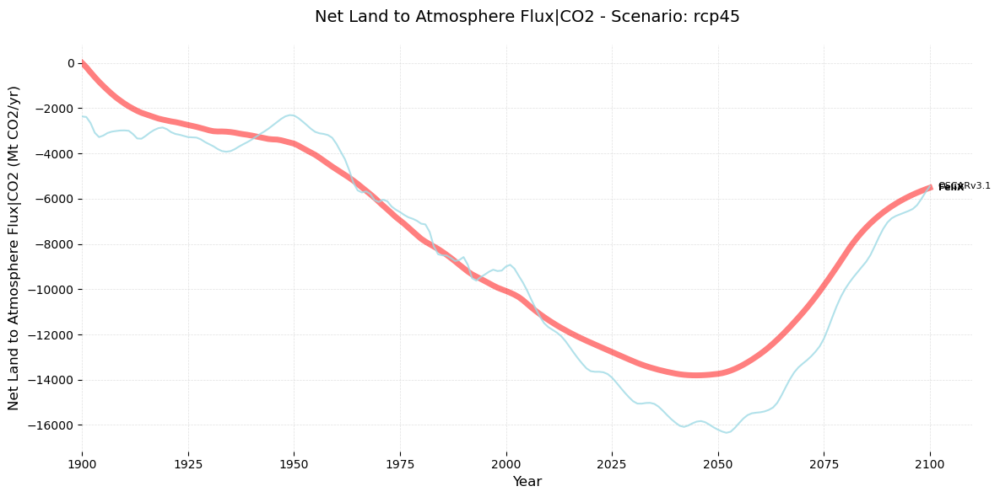

Original data shape: (11371, 1625)
After variable filtering: (562, 1625)
After scenario filtering: (2, 1625)
After region filtering: (2, 1625)
After year range filtering: (2, 206)
After excluding models: (2, 206)


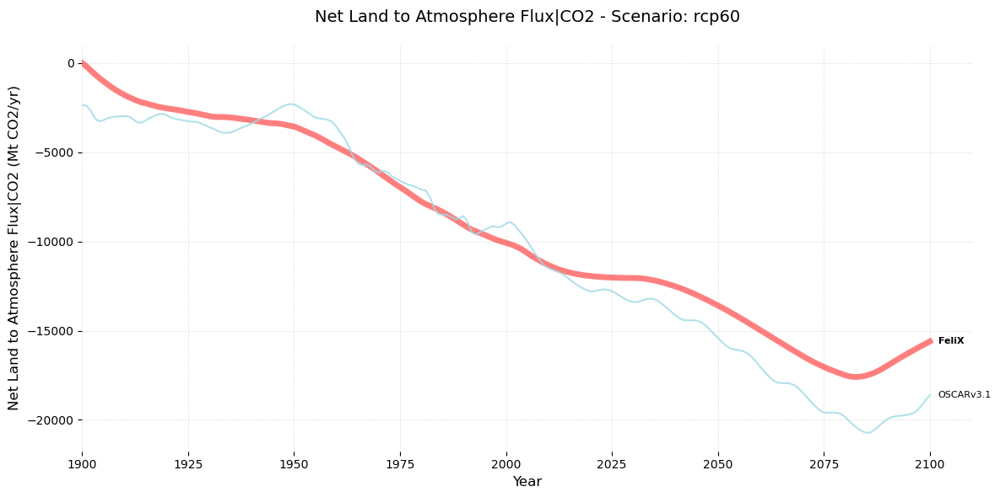

Original data shape: (11371, 1625)
After variable filtering: (562, 1625)
After scenario filtering: (2, 1625)
After region filtering: (2, 1625)
After year range filtering: (2, 206)
After excluding models: (2, 206)


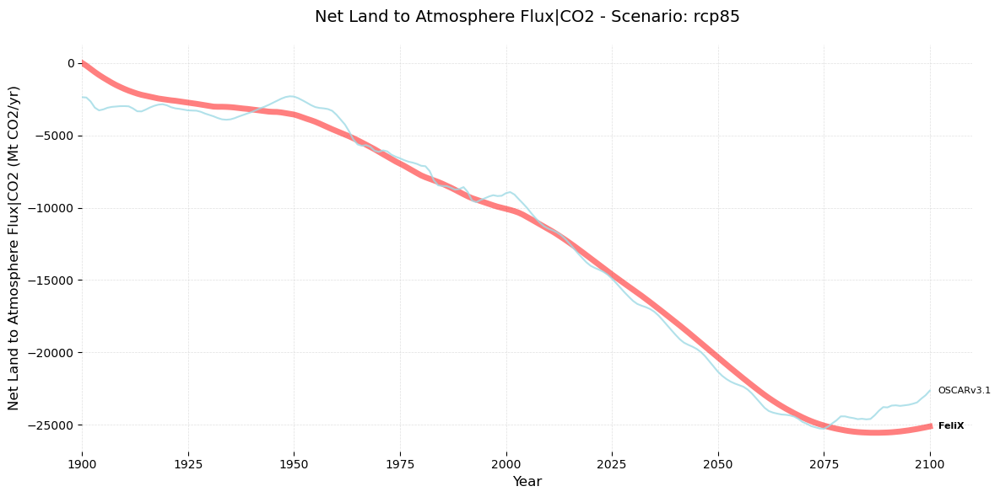

Original data shape: (11371, 1625)
After variable filtering: (562, 1625)
After scenario filtering: (9, 1625)
After region filtering: (9, 1625)
After year range filtering: (9, 206)
After excluding models: (9, 206)


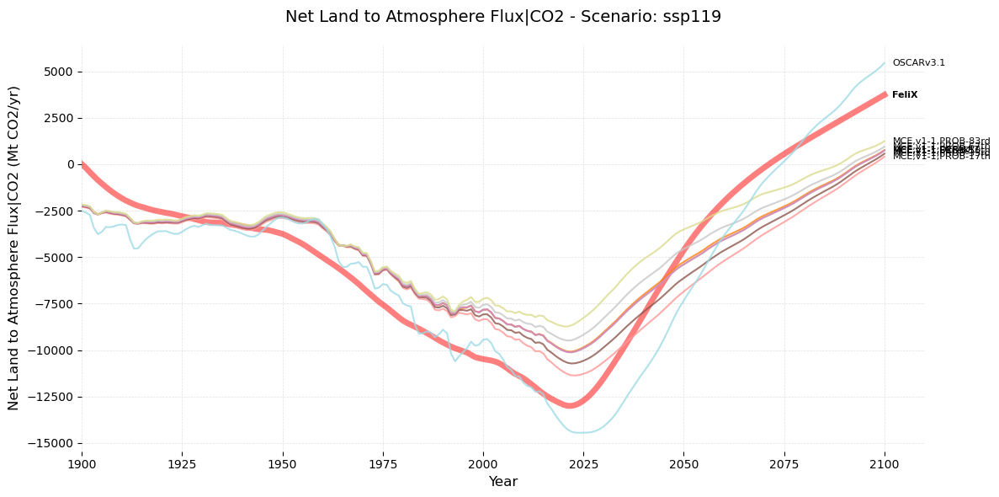

Original data shape: (11371, 1625)
After variable filtering: (562, 1625)
After scenario filtering: (9, 1625)
After region filtering: (9, 1625)
After year range filtering: (9, 206)
After excluding models: (9, 206)


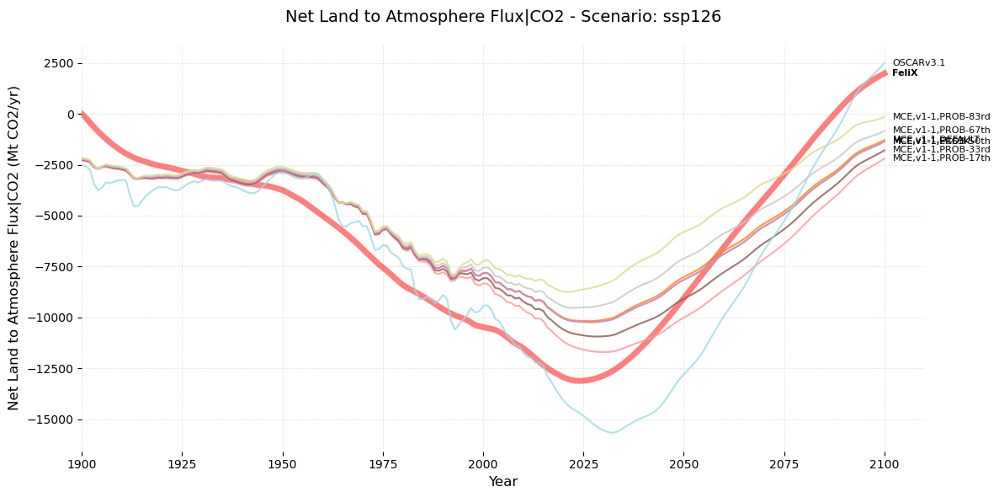

Original data shape: (11371, 1625)
After variable filtering: (562, 1625)
After scenario filtering: (9, 1625)
After region filtering: (9, 1625)
After year range filtering: (9, 206)
After excluding models: (9, 206)


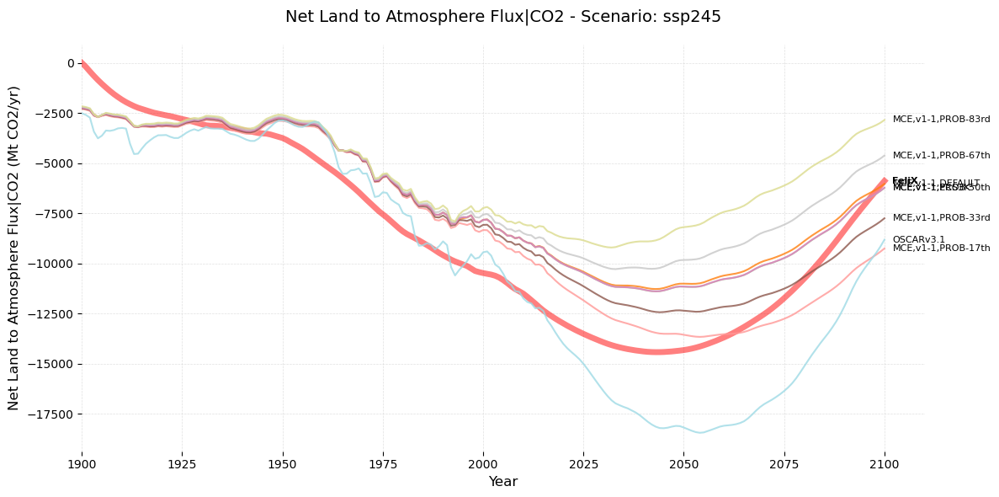

Original data shape: (11371, 1625)
After variable filtering: (562, 1625)
After scenario filtering: (9, 1625)
After region filtering: (9, 1625)
After year range filtering: (9, 206)
After excluding models: (9, 206)


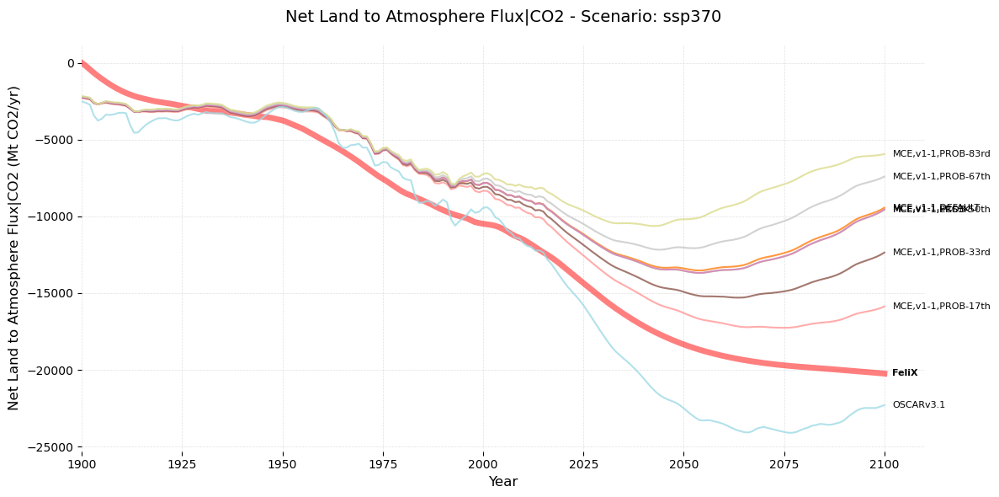

Original data shape: (11371, 1625)
After variable filtering: (562, 1625)
After scenario filtering: (9, 1625)
After region filtering: (9, 1625)
After year range filtering: (9, 206)
After excluding models: (9, 206)


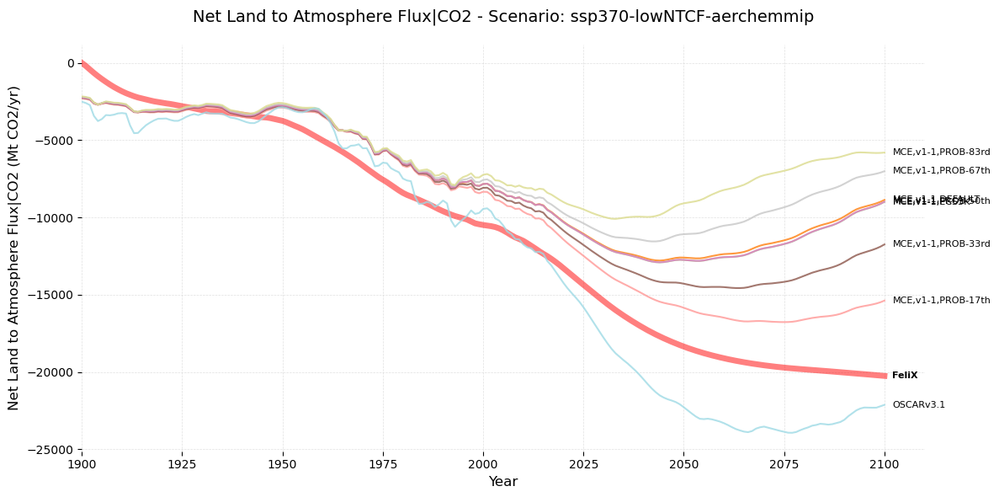

Original data shape: (11371, 1625)
After variable filtering: (562, 1625)
After scenario filtering: (9, 1625)
After region filtering: (9, 1625)
After year range filtering: (9, 206)
After excluding models: (9, 206)


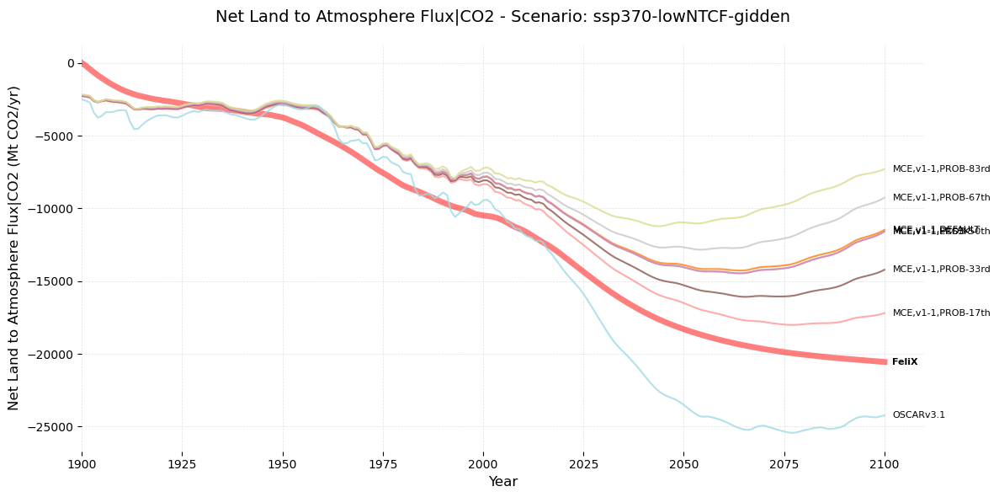

Original data shape: (11371, 1625)
After variable filtering: (562, 1625)
After scenario filtering: (9, 1625)
After region filtering: (9, 1625)
After year range filtering: (9, 206)
After excluding models: (9, 206)


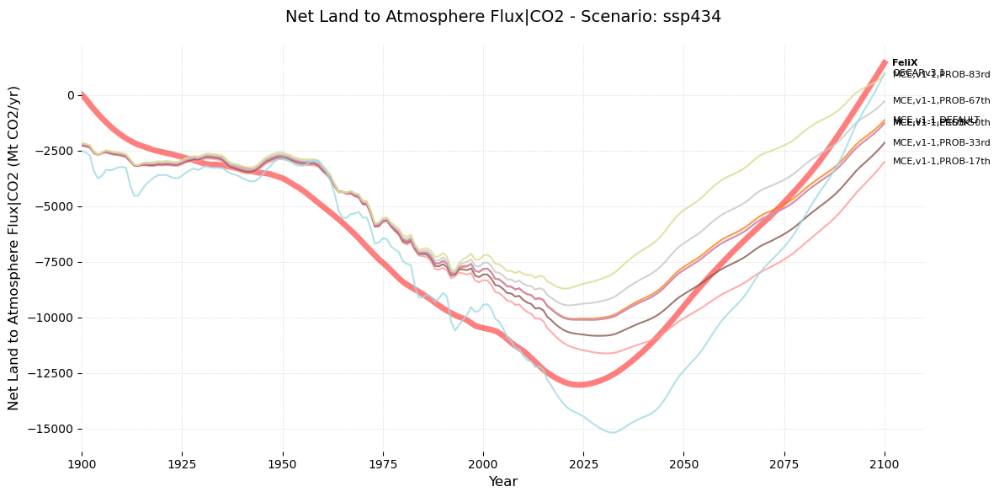

Original data shape: (11371, 1625)
After variable filtering: (562, 1625)
After scenario filtering: (9, 1625)
After region filtering: (9, 1625)
After year range filtering: (9, 206)
After excluding models: (9, 206)


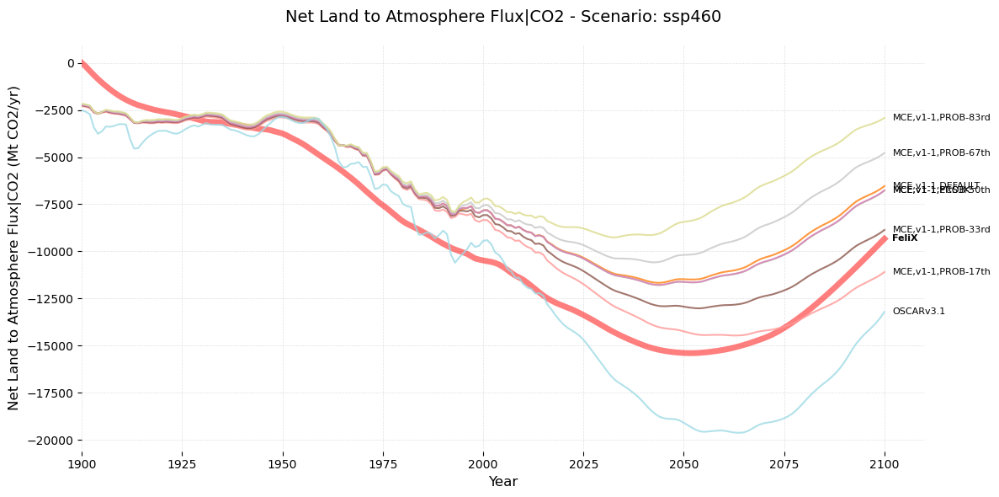

Original data shape: (11371, 1625)
After variable filtering: (562, 1625)
After scenario filtering: (9, 1625)
After region filtering: (9, 1625)
After year range filtering: (9, 206)
After excluding models: (9, 206)


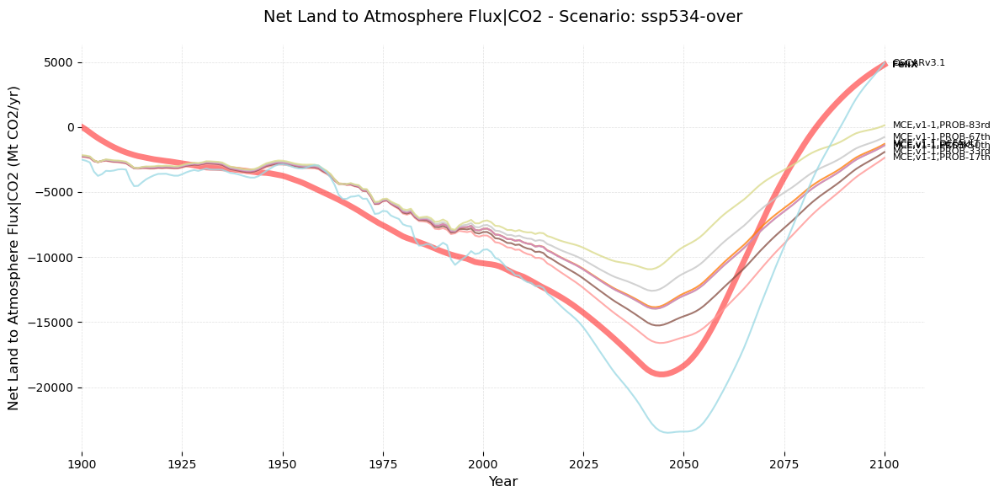

Original data shape: (11371, 1625)
After variable filtering: (562, 1625)
After scenario filtering: (9, 1625)
After region filtering: (9, 1625)
After year range filtering: (9, 206)
After excluding models: (9, 206)


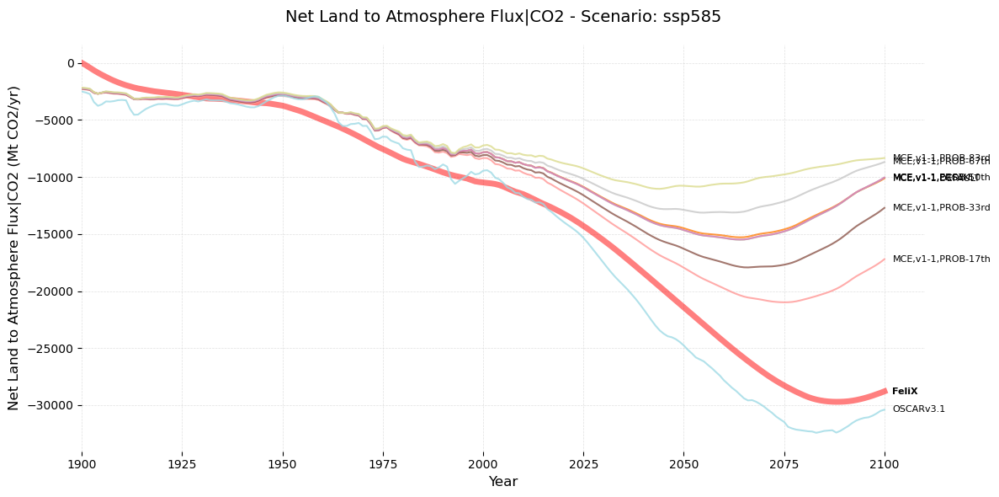

Original data shape: (11371, 1625)
After variable filtering: (562, 1625)
After scenario filtering: (2, 1625)
After region filtering: (2, 1625)
After year range filtering: (2, 206)
After excluding models: (2, 206)


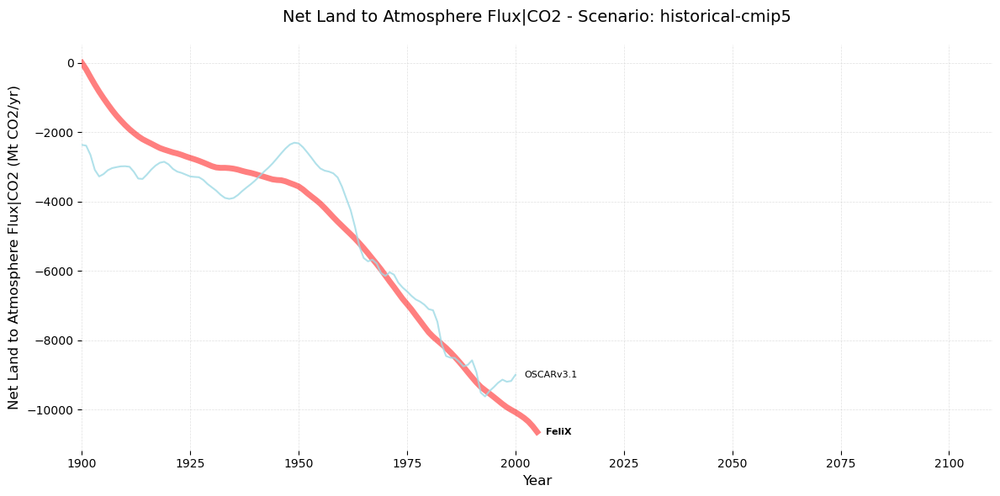

Original data shape: (11371, 1625)
After variable filtering: (562, 1625)
After scenario filtering: (9, 1625)
After region filtering: (9, 1625)
After year range filtering: (9, 206)
After excluding models: (9, 206)


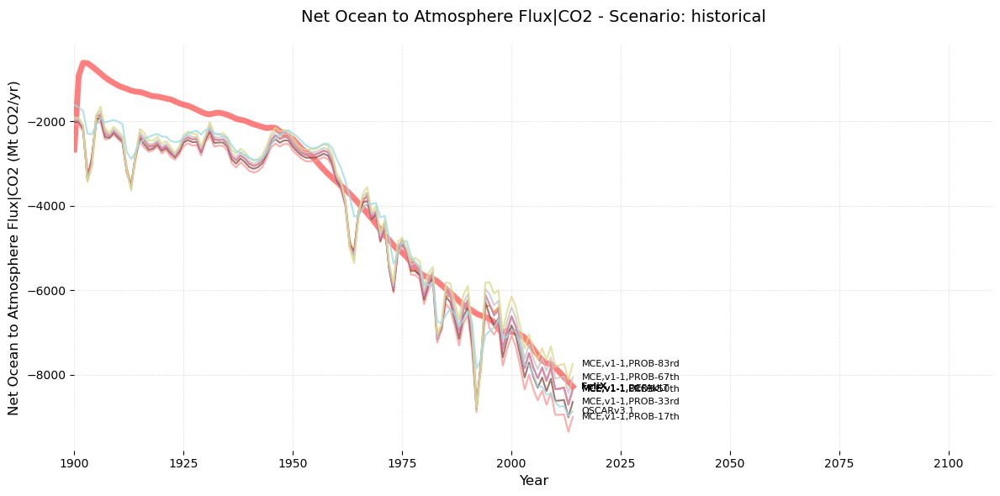

Original data shape: (11371, 1625)
After variable filtering: (562, 1625)
After scenario filtering: (2, 1625)
After region filtering: (2, 1625)
After year range filtering: (2, 206)
After excluding models: (2, 206)


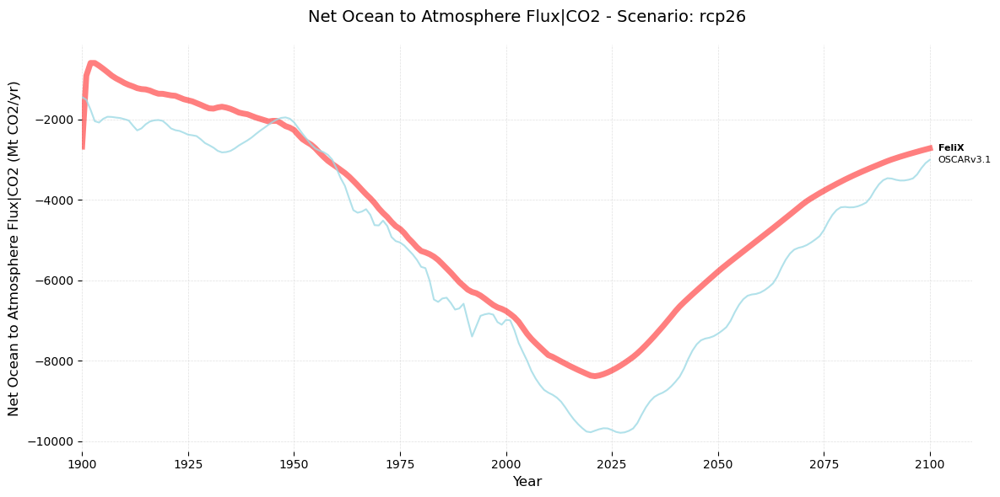

Original data shape: (11371, 1625)
After variable filtering: (562, 1625)
After scenario filtering: (2, 1625)
After region filtering: (2, 1625)
After year range filtering: (2, 206)
After excluding models: (2, 206)


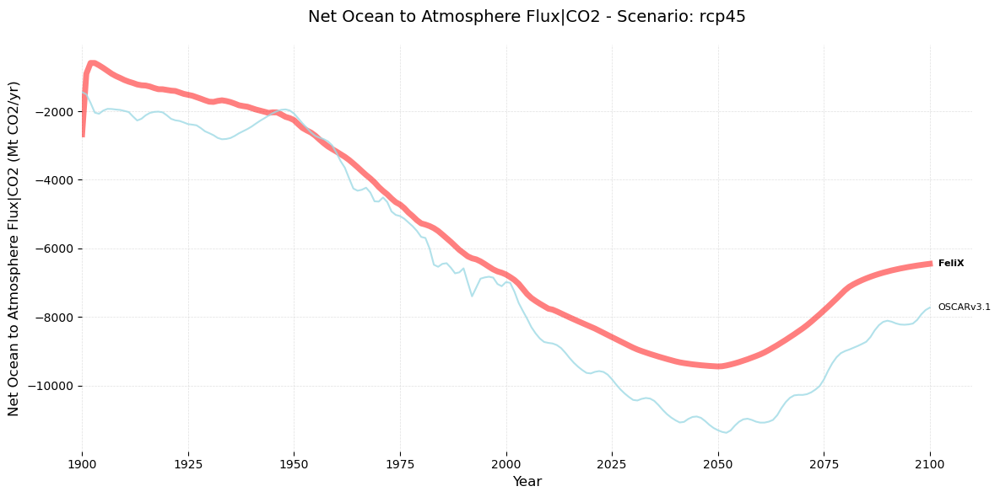

Original data shape: (11371, 1625)
After variable filtering: (562, 1625)
After scenario filtering: (2, 1625)
After region filtering: (2, 1625)
After year range filtering: (2, 206)
After excluding models: (2, 206)


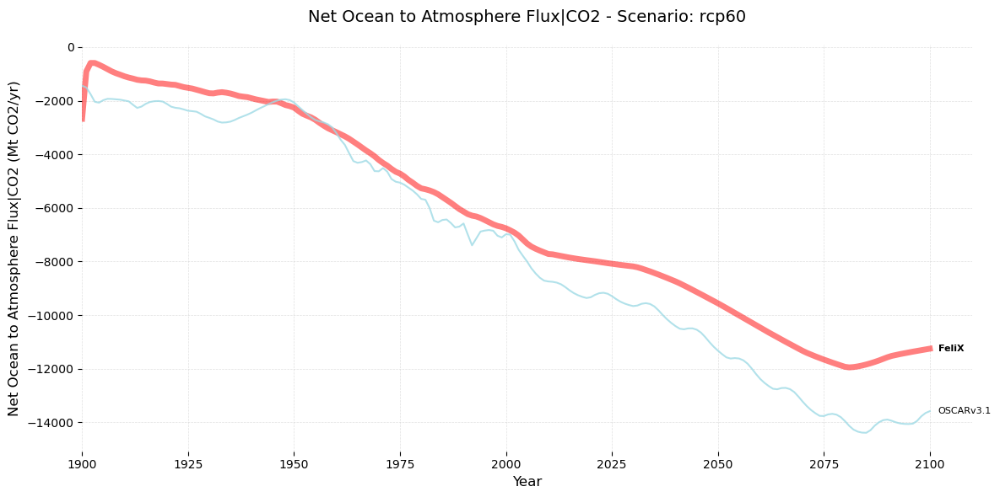

Original data shape: (11371, 1625)
After variable filtering: (562, 1625)
After scenario filtering: (2, 1625)
After region filtering: (2, 1625)
After year range filtering: (2, 206)
After excluding models: (2, 206)


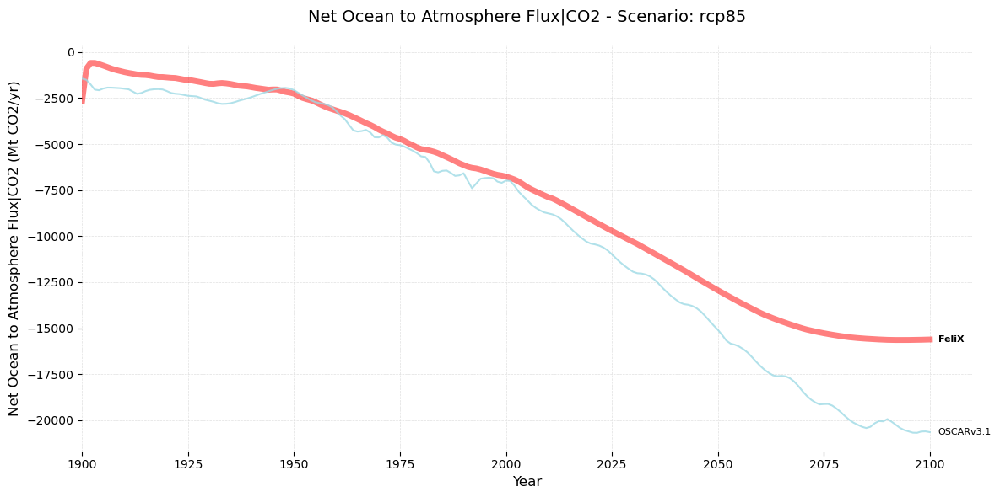

Original data shape: (11371, 1625)
After variable filtering: (562, 1625)
After scenario filtering: (9, 1625)
After region filtering: (9, 1625)
After year range filtering: (9, 206)
After excluding models: (9, 206)


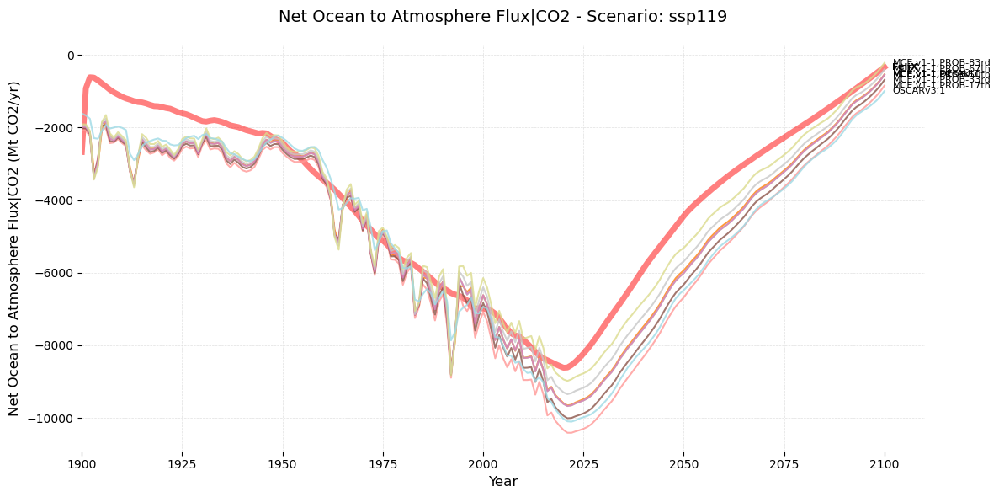

Original data shape: (11371, 1625)
After variable filtering: (562, 1625)
After scenario filtering: (9, 1625)
After region filtering: (9, 1625)
After year range filtering: (9, 206)
After excluding models: (9, 206)


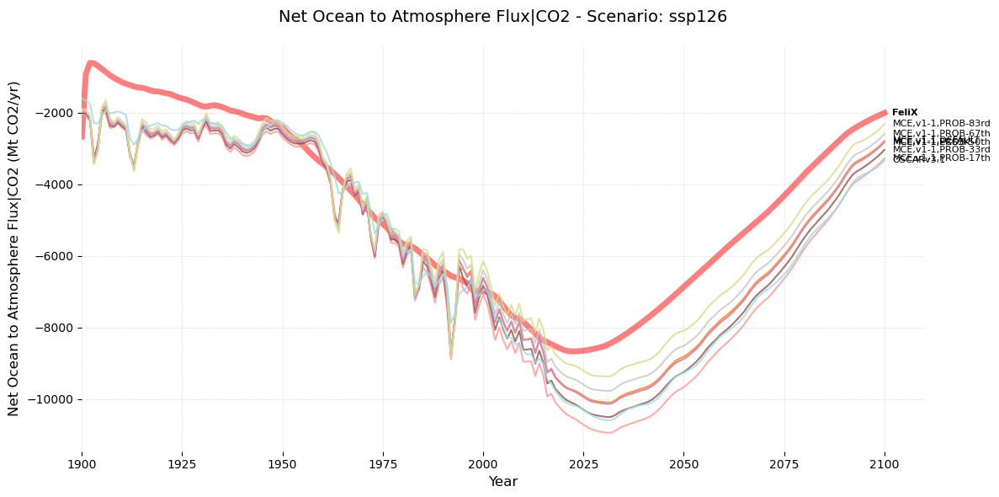

Original data shape: (11371, 1625)
After variable filtering: (562, 1625)
After scenario filtering: (9, 1625)
After region filtering: (9, 1625)
After year range filtering: (9, 206)
After excluding models: (9, 206)


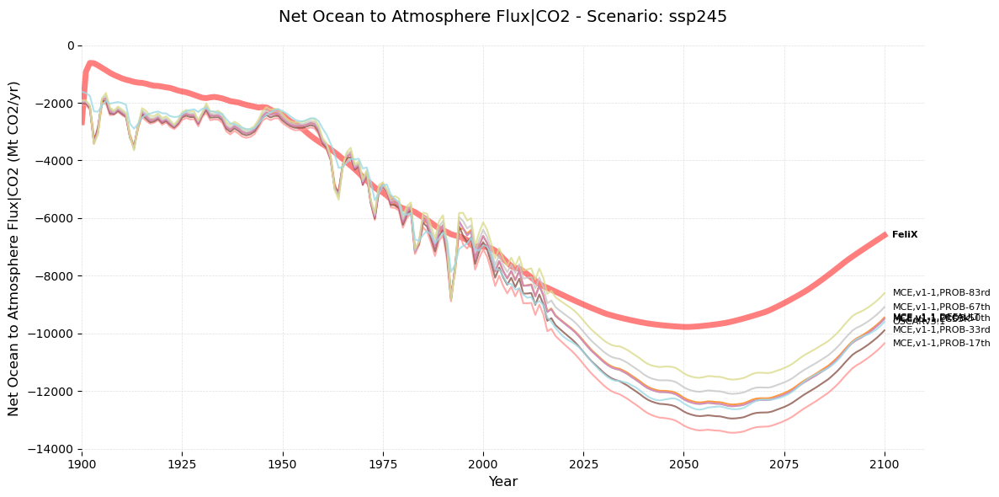

Original data shape: (11371, 1625)
After variable filtering: (562, 1625)
After scenario filtering: (9, 1625)
After region filtering: (9, 1625)
After year range filtering: (9, 206)
After excluding models: (9, 206)


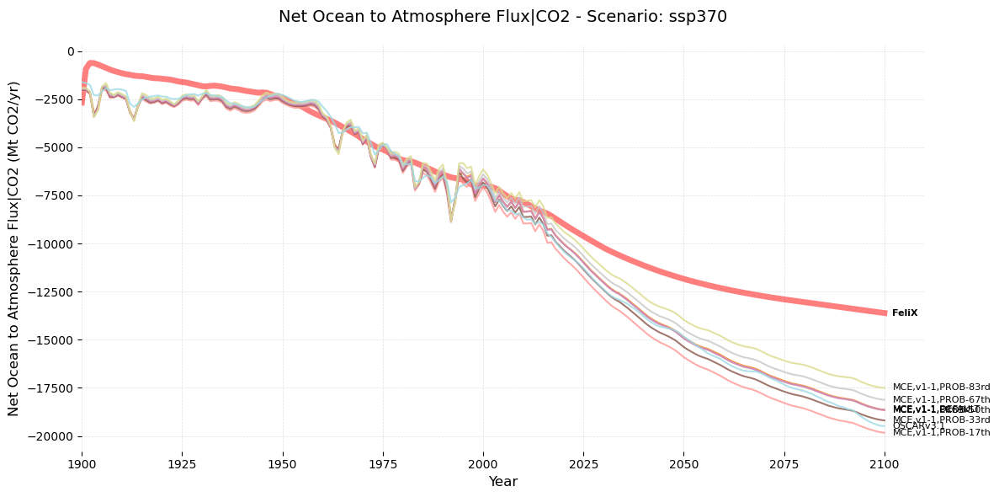

Original data shape: (11371, 1625)
After variable filtering: (562, 1625)
After scenario filtering: (9, 1625)
After region filtering: (9, 1625)
After year range filtering: (9, 206)
After excluding models: (9, 206)


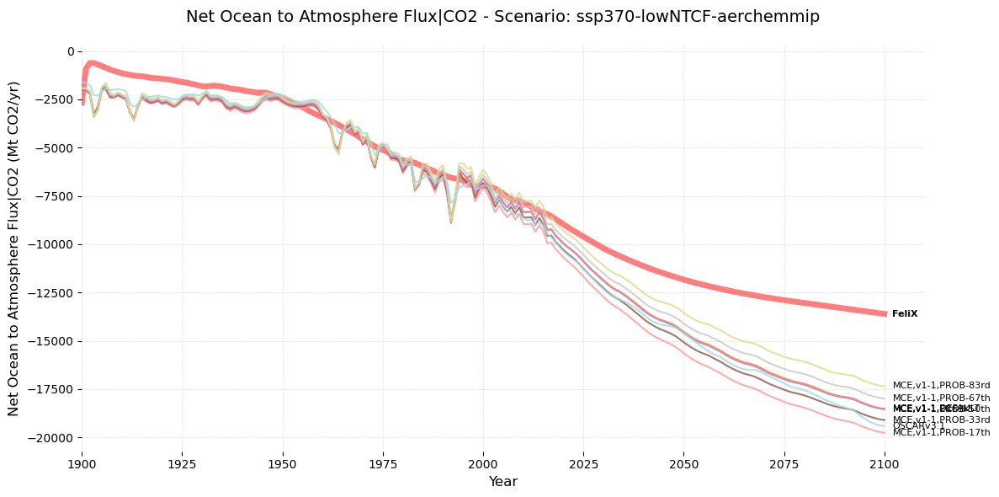

Original data shape: (11371, 1625)
After variable filtering: (562, 1625)
After scenario filtering: (9, 1625)
After region filtering: (9, 1625)
After year range filtering: (9, 206)
After excluding models: (9, 206)


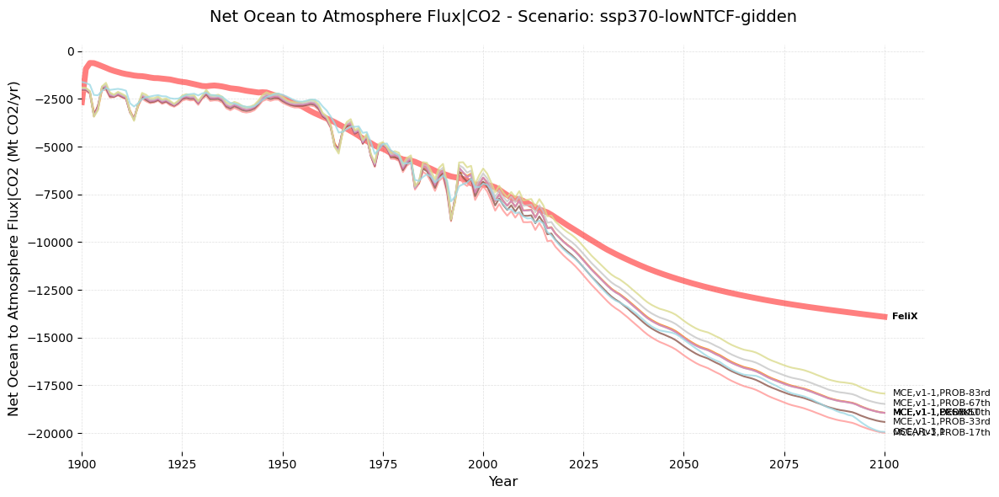

Original data shape: (11371, 1625)
After variable filtering: (562, 1625)
After scenario filtering: (9, 1625)
After region filtering: (9, 1625)
After year range filtering: (9, 206)
After excluding models: (9, 206)


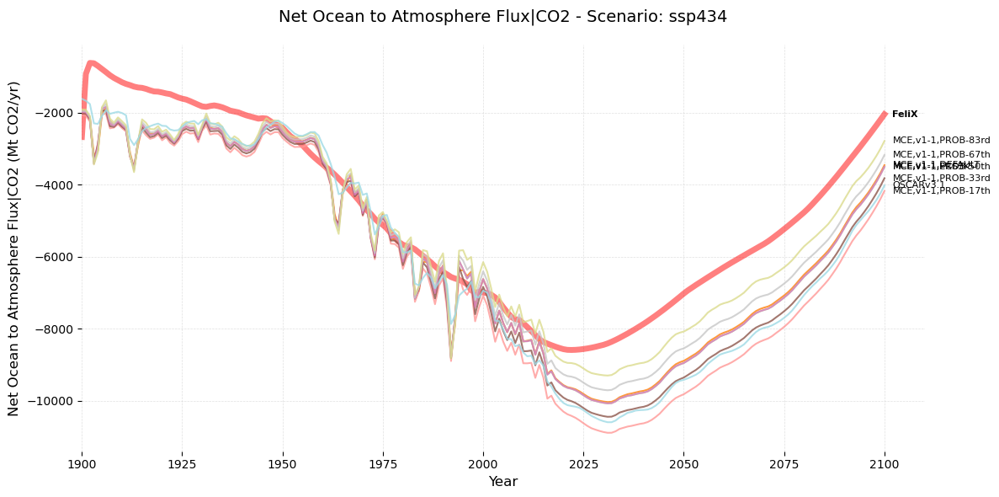

Original data shape: (11371, 1625)
After variable filtering: (562, 1625)
After scenario filtering: (9, 1625)
After region filtering: (9, 1625)
After year range filtering: (9, 206)
After excluding models: (9, 206)


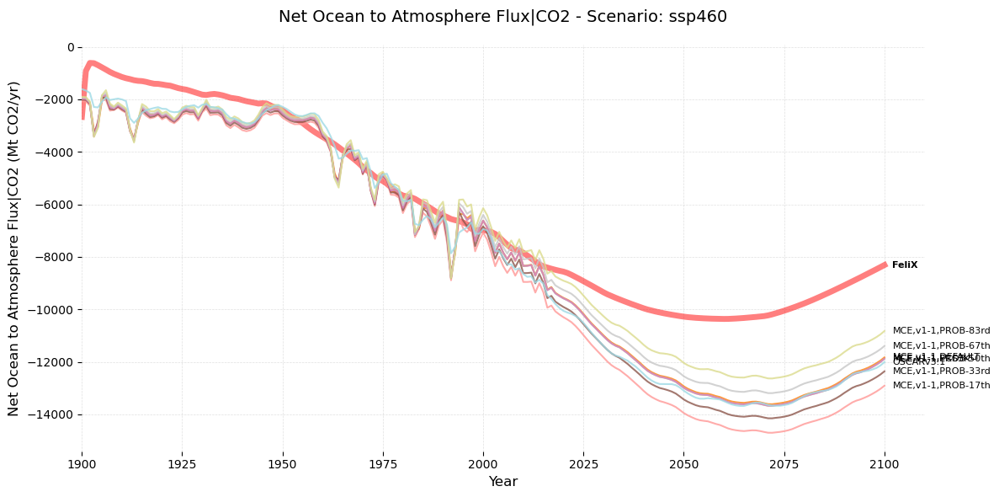

Original data shape: (11371, 1625)
After variable filtering: (562, 1625)
After scenario filtering: (9, 1625)
After region filtering: (9, 1625)
After year range filtering: (9, 206)
After excluding models: (9, 206)


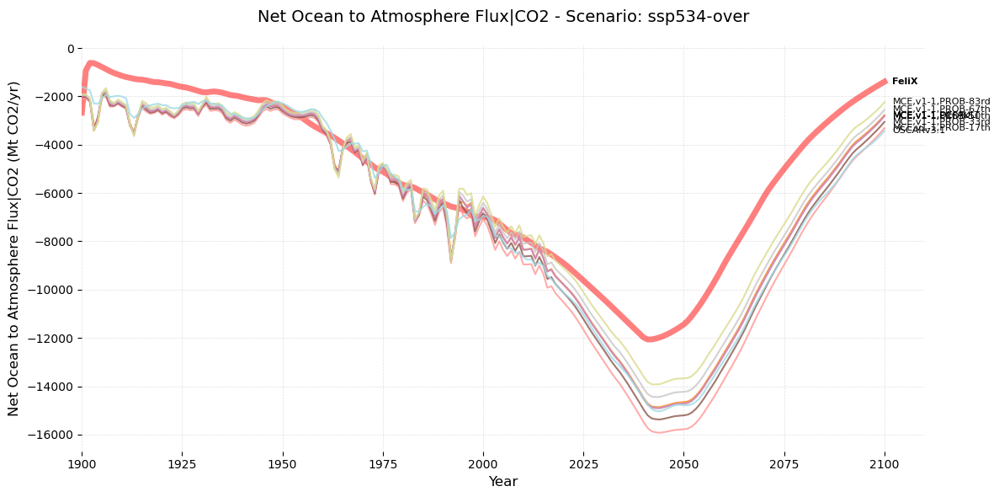

Original data shape: (11371, 1625)
After variable filtering: (562, 1625)
After scenario filtering: (9, 1625)
After region filtering: (9, 1625)
After year range filtering: (9, 206)
After excluding models: (9, 206)


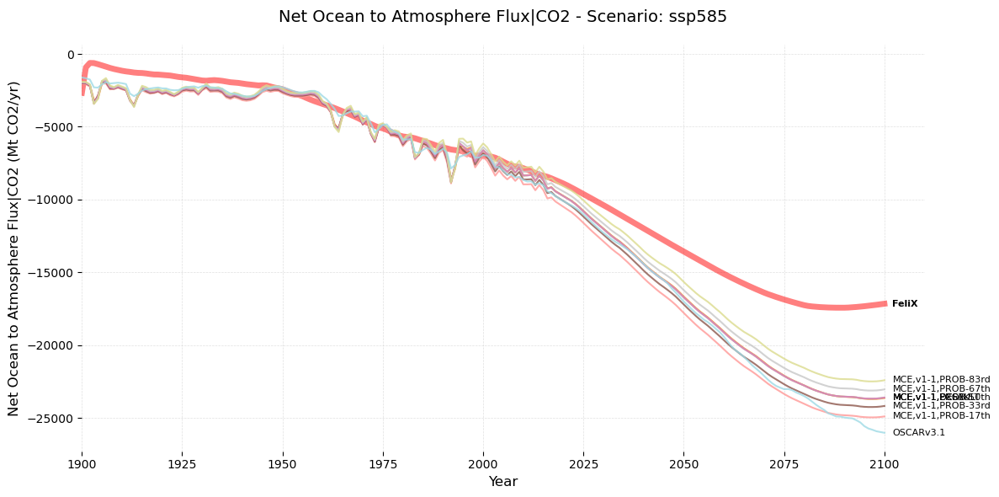

Original data shape: (11371, 1625)
After variable filtering: (562, 1625)
After scenario filtering: (2, 1625)
After region filtering: (2, 1625)
After year range filtering: (2, 206)
After excluding models: (2, 206)


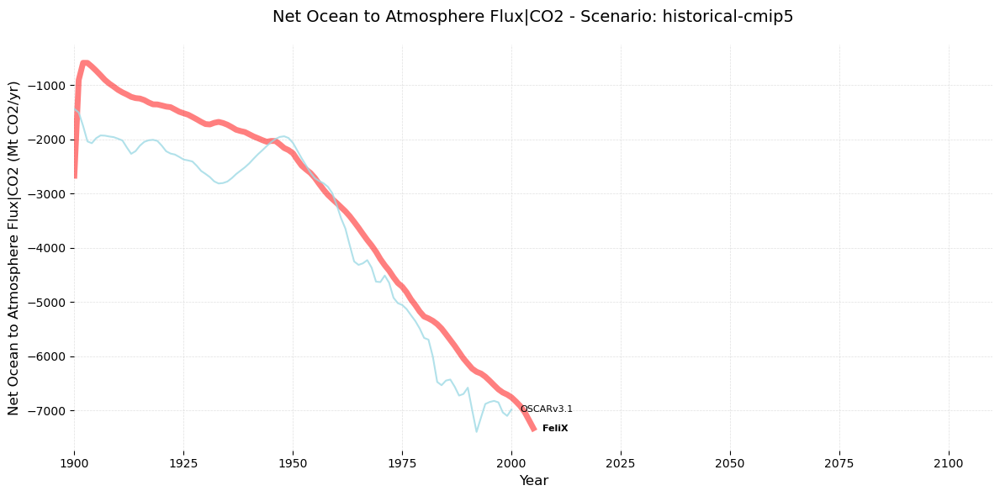

Original data shape: (11371, 1625)
After variable filtering: (241, 1625)
After scenario filtering: (4, 1625)
After region filtering: (4, 1625)
After year range filtering: (4, 206)
After excluding models: (4, 206)


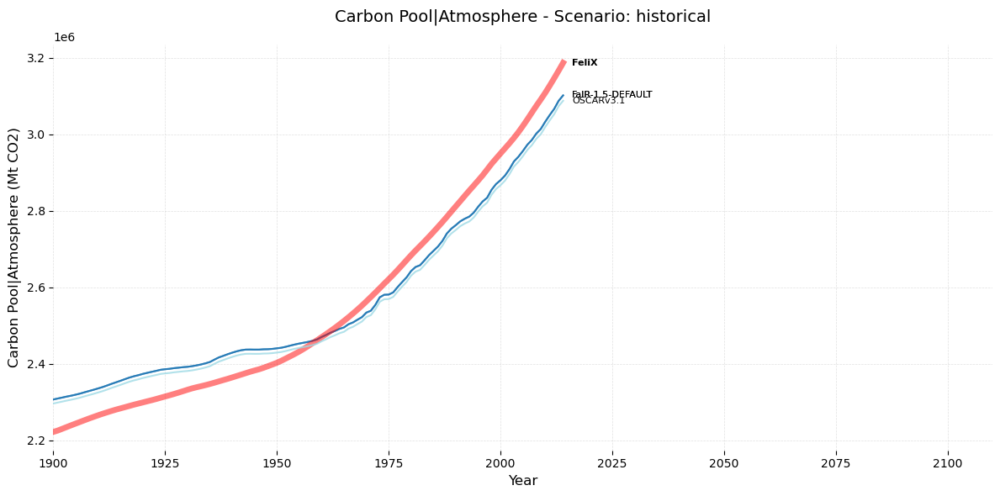

Original data shape: (11371, 1625)
After variable filtering: (241, 1625)
After scenario filtering: (4, 1625)
After region filtering: (4, 1625)
After year range filtering: (4, 206)
After excluding models: (4, 206)


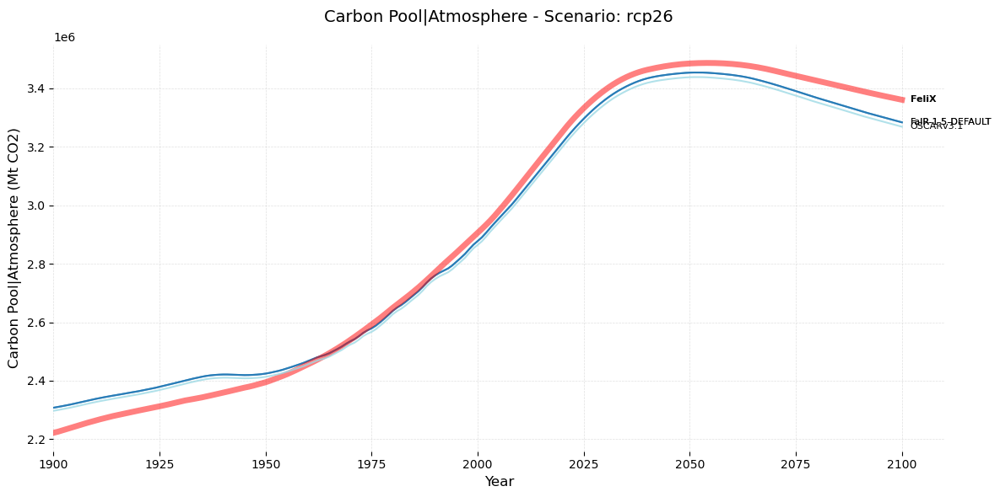

Original data shape: (11371, 1625)
After variable filtering: (241, 1625)
After scenario filtering: (4, 1625)
After region filtering: (4, 1625)
After year range filtering: (4, 206)
After excluding models: (4, 206)


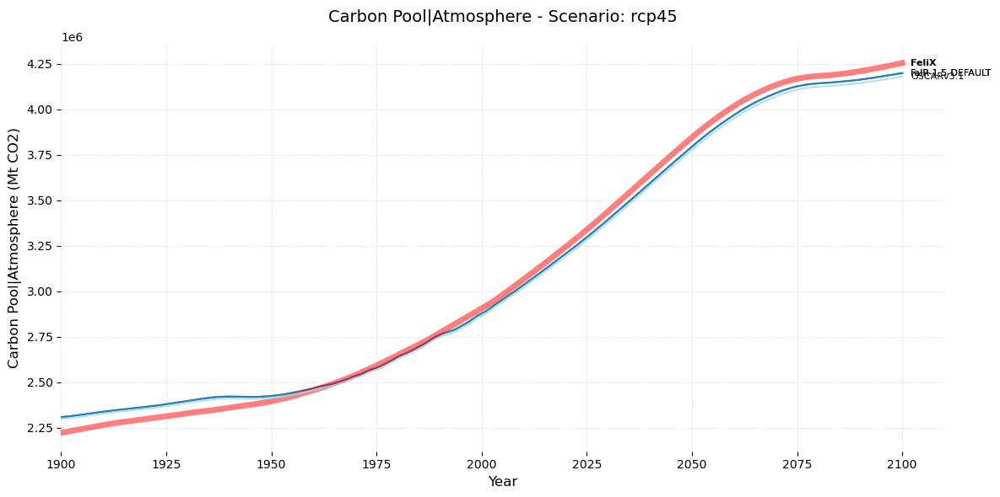

Original data shape: (11371, 1625)
After variable filtering: (241, 1625)
After scenario filtering: (4, 1625)
After region filtering: (4, 1625)
After year range filtering: (4, 206)
After excluding models: (4, 206)


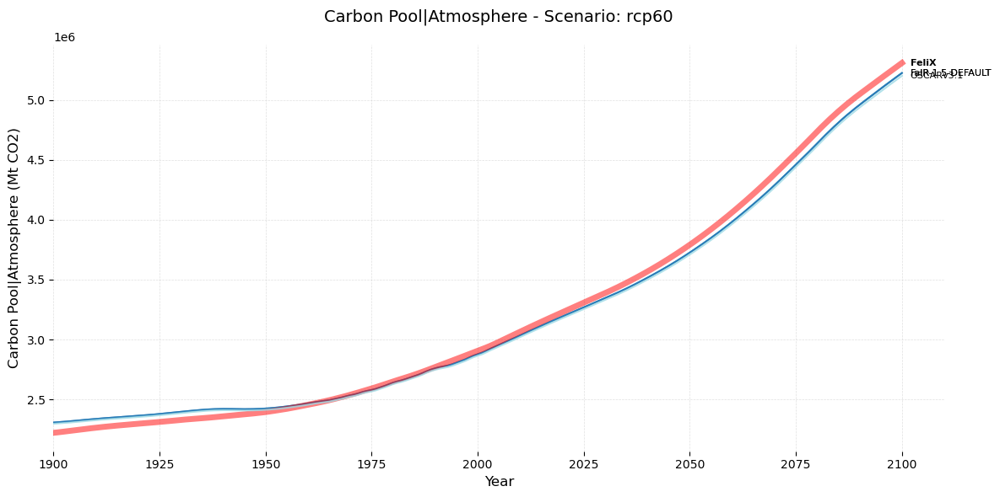

Original data shape: (11371, 1625)
After variable filtering: (241, 1625)
After scenario filtering: (4, 1625)
After region filtering: (4, 1625)
After year range filtering: (4, 206)
After excluding models: (4, 206)


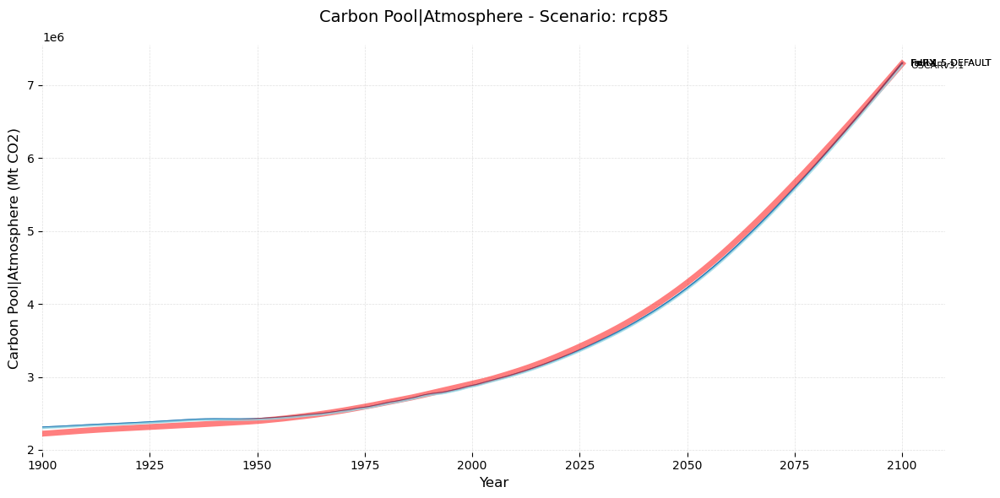

Original data shape: (11371, 1625)
After variable filtering: (241, 1625)
After scenario filtering: (4, 1625)
After region filtering: (4, 1625)
After year range filtering: (4, 206)
After excluding models: (4, 206)


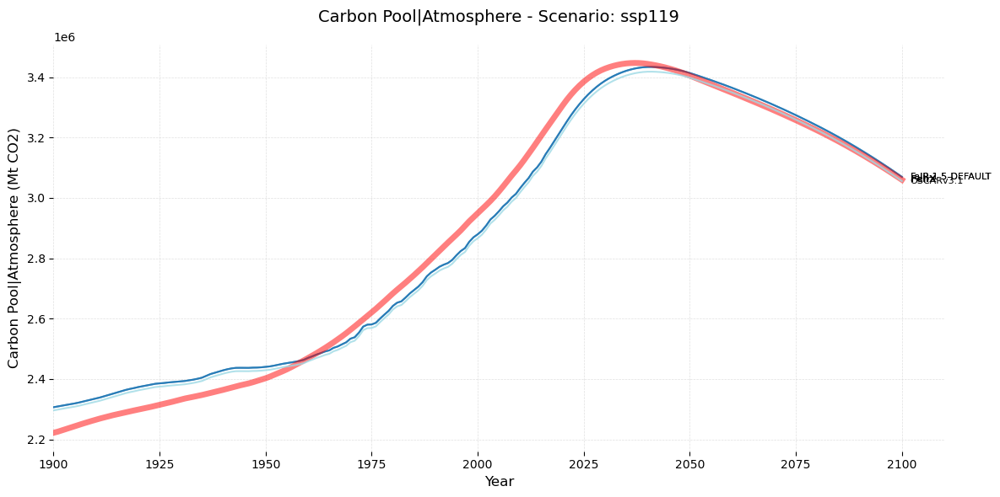

Original data shape: (11371, 1625)
After variable filtering: (241, 1625)
After scenario filtering: (4, 1625)
After region filtering: (4, 1625)
After year range filtering: (4, 206)
After excluding models: (4, 206)


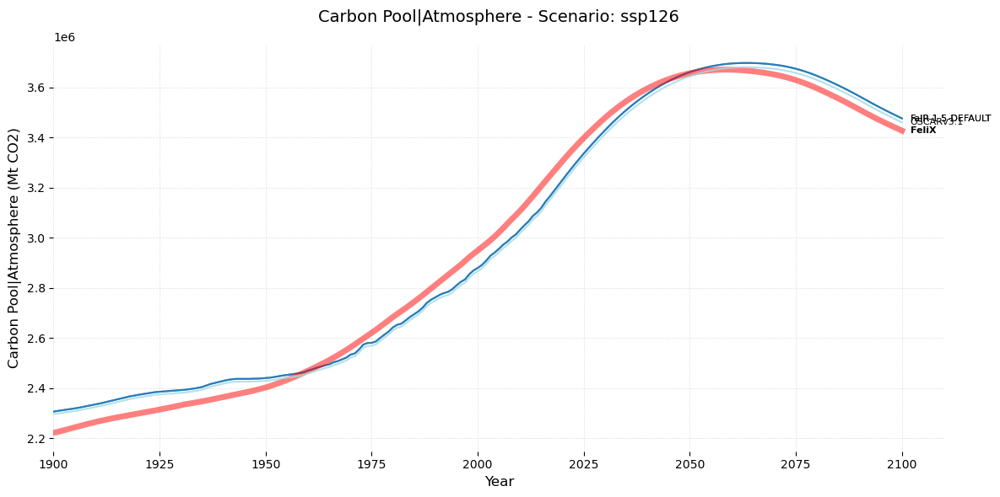

Original data shape: (11371, 1625)
After variable filtering: (241, 1625)
After scenario filtering: (4, 1625)
After region filtering: (4, 1625)
After year range filtering: (4, 206)
After excluding models: (4, 206)


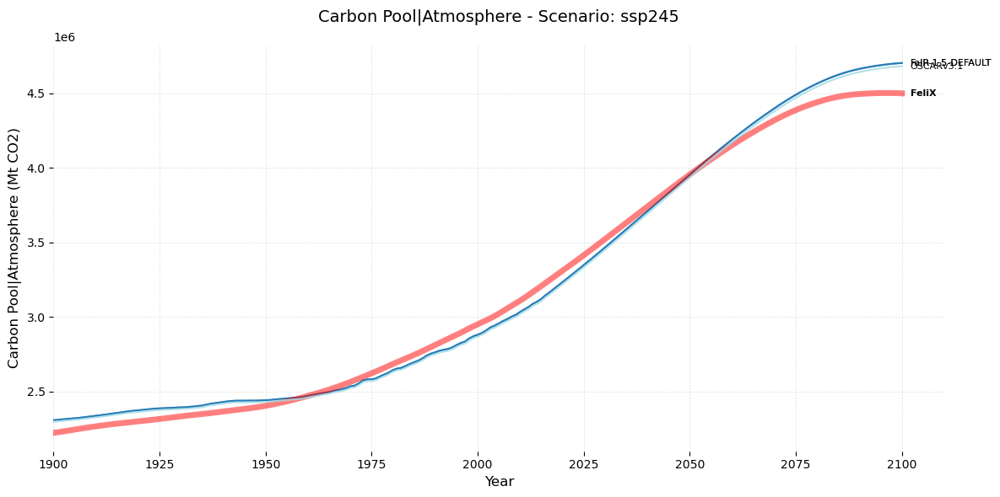

Original data shape: (11371, 1625)
After variable filtering: (241, 1625)
After scenario filtering: (4, 1625)
After region filtering: (4, 1625)
After year range filtering: (4, 206)
After excluding models: (4, 206)


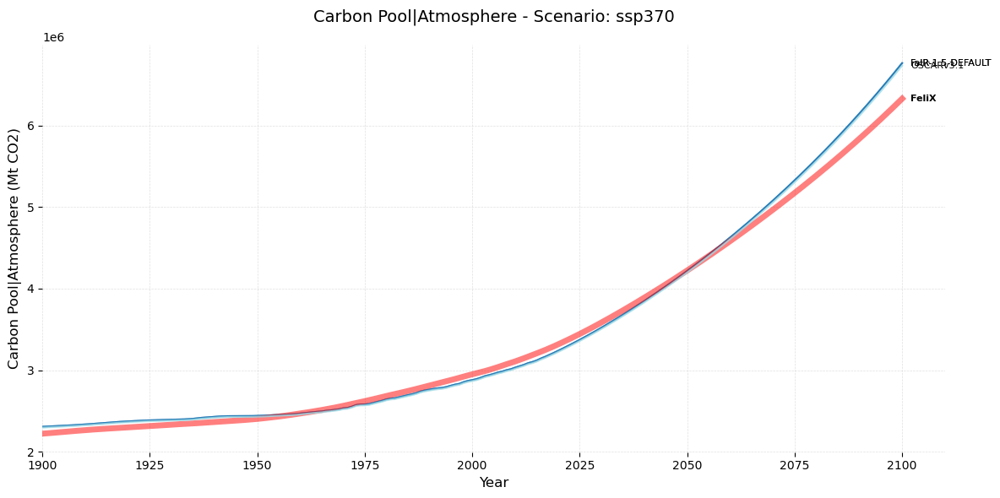

Original data shape: (11371, 1625)
After variable filtering: (241, 1625)
After scenario filtering: (4, 1625)
After region filtering: (4, 1625)
After year range filtering: (4, 206)
After excluding models: (4, 206)


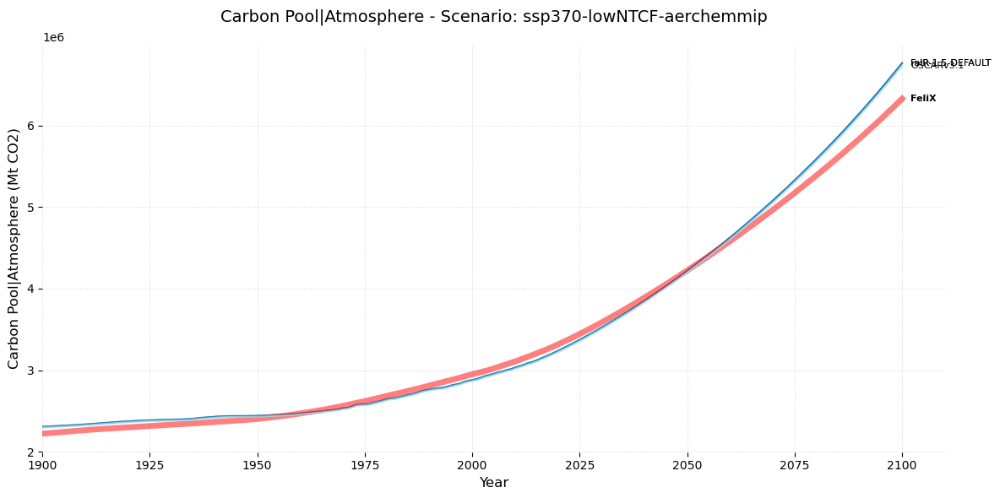

Original data shape: (11371, 1625)
After variable filtering: (241, 1625)
After scenario filtering: (2, 1625)
After region filtering: (2, 1625)
After year range filtering: (2, 206)
After excluding models: (2, 206)


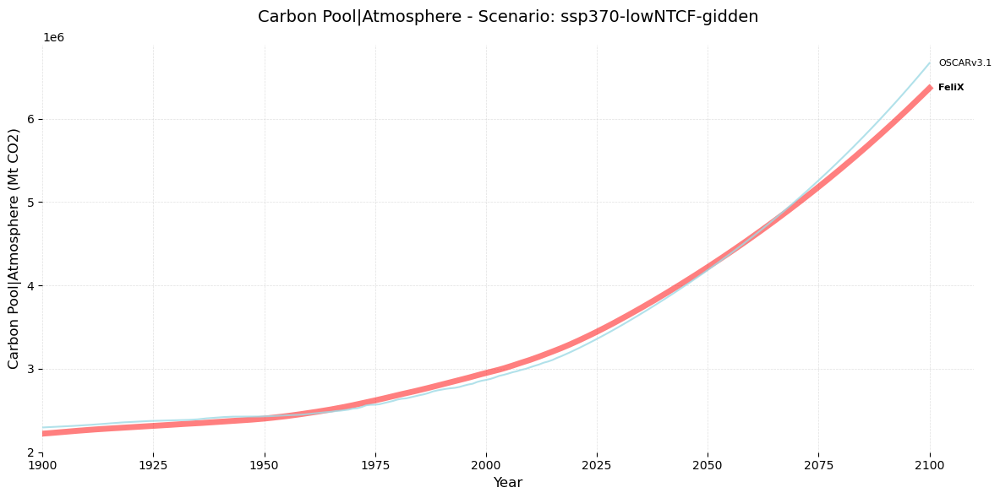

Original data shape: (11371, 1625)
After variable filtering: (241, 1625)
After scenario filtering: (4, 1625)
After region filtering: (4, 1625)
After year range filtering: (4, 206)
After excluding models: (4, 206)


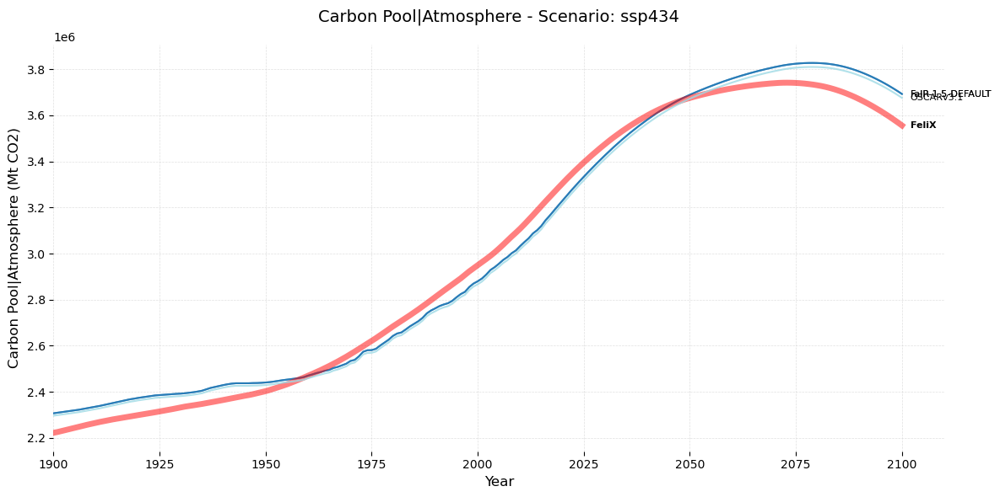

Original data shape: (11371, 1625)
After variable filtering: (241, 1625)
After scenario filtering: (4, 1625)
After region filtering: (4, 1625)
After year range filtering: (4, 206)
After excluding models: (4, 206)


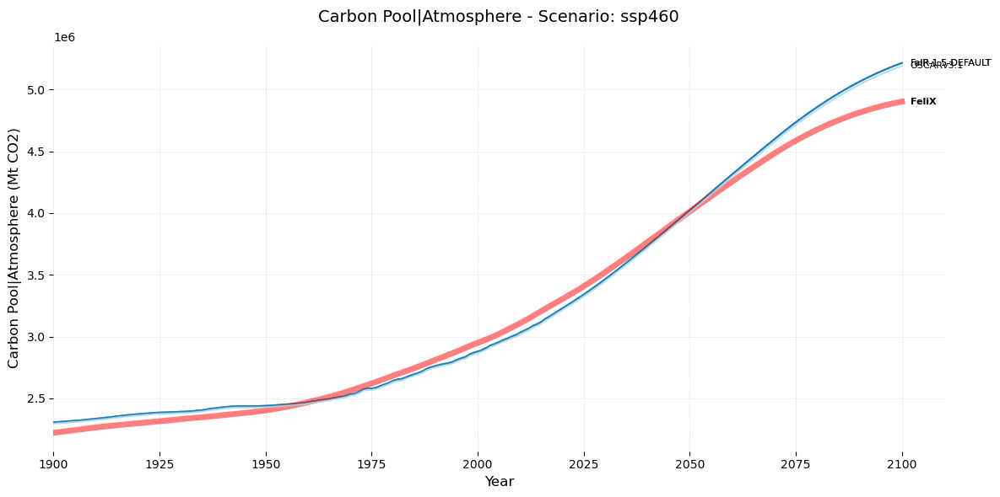

Original data shape: (11371, 1625)
After variable filtering: (241, 1625)
After scenario filtering: (4, 1625)
After region filtering: (4, 1625)
After year range filtering: (4, 206)
After excluding models: (4, 206)


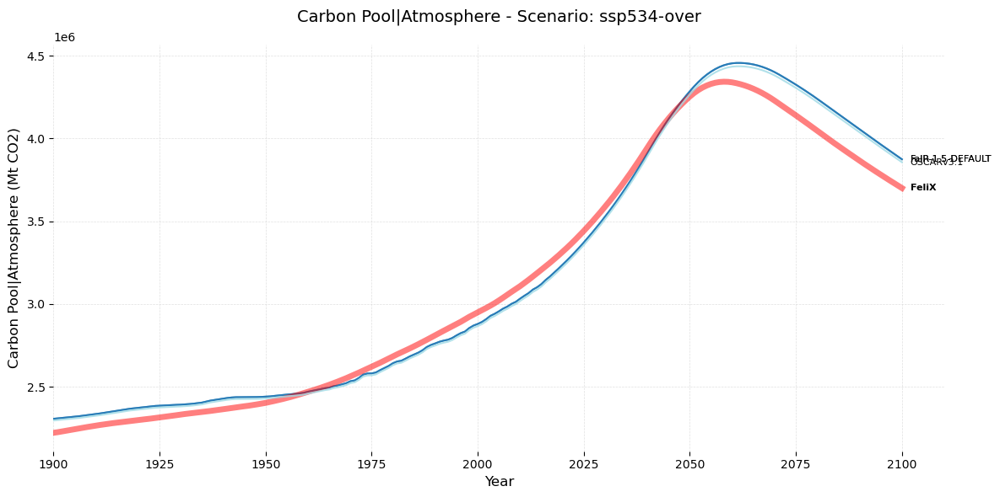

Original data shape: (11371, 1625)
After variable filtering: (241, 1625)
After scenario filtering: (4, 1625)
After region filtering: (4, 1625)
After year range filtering: (4, 206)
After excluding models: (4, 206)


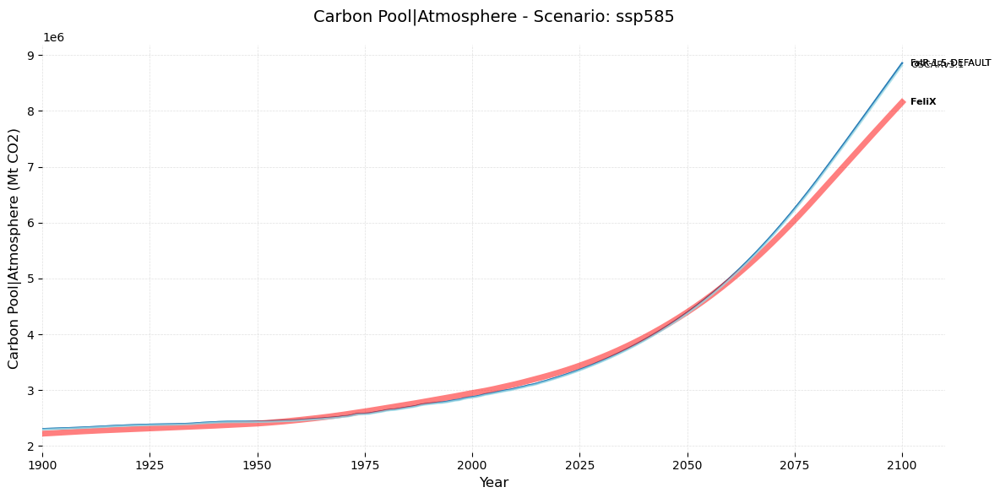

Original data shape: (11371, 1625)
After variable filtering: (241, 1625)
After scenario filtering: (4, 1625)
After region filtering: (4, 1625)
After year range filtering: (4, 206)
After excluding models: (4, 206)


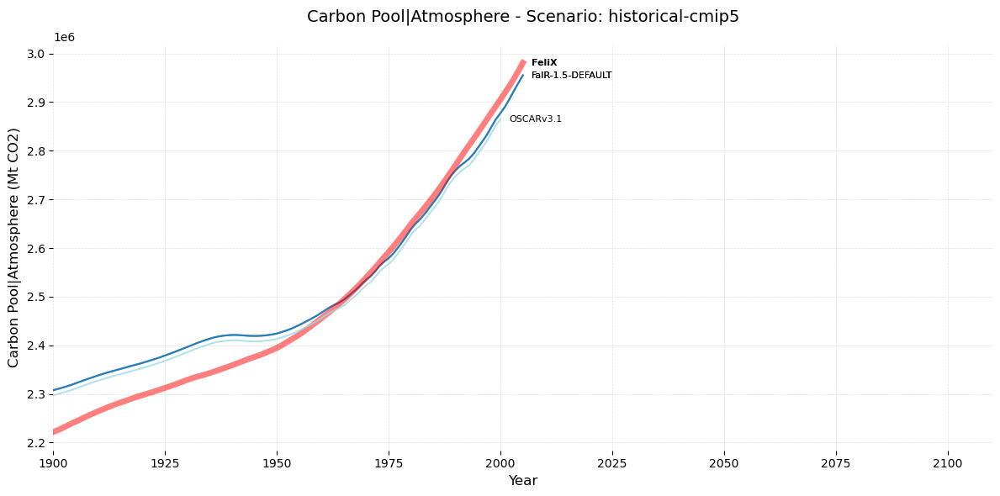

Original data shape: (11371, 1625)
After variable filtering: (91, 1625)
After scenario filtering: (2, 1625)
After region filtering: (2, 1625)
After year range filtering: (2, 206)
After excluding models: (2, 206)


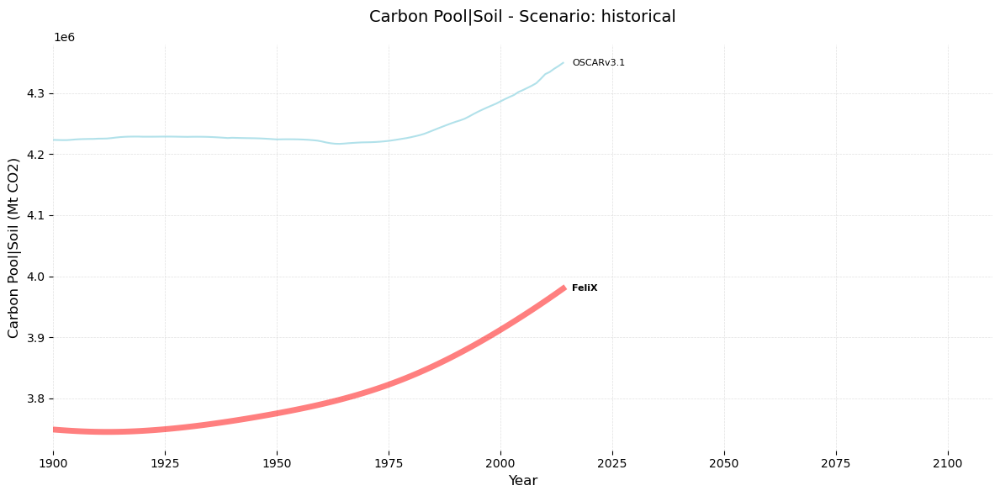

Original data shape: (11371, 1625)
After variable filtering: (91, 1625)
After scenario filtering: (2, 1625)
After region filtering: (2, 1625)
After year range filtering: (2, 206)
After excluding models: (2, 206)


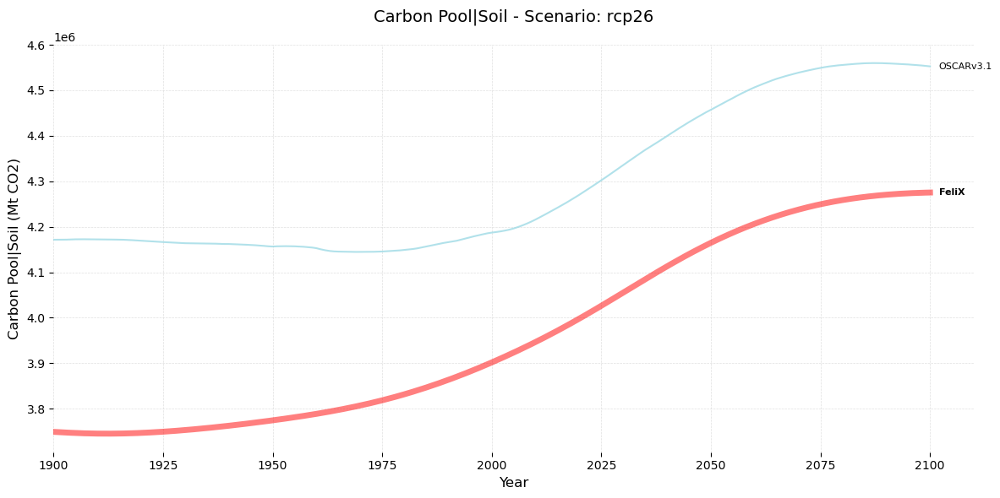

Original data shape: (11371, 1625)
After variable filtering: (91, 1625)
After scenario filtering: (2, 1625)
After region filtering: (2, 1625)
After year range filtering: (2, 206)
After excluding models: (2, 206)


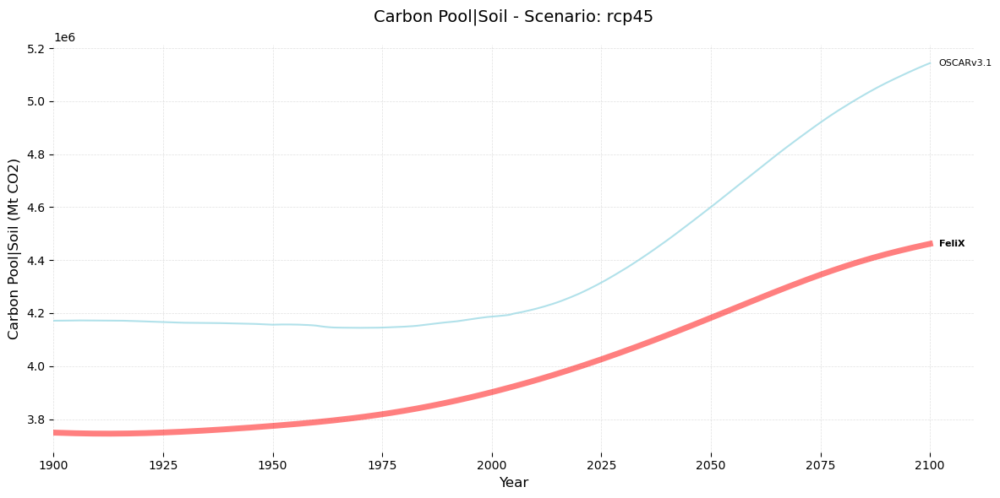

Original data shape: (11371, 1625)
After variable filtering: (91, 1625)
After scenario filtering: (2, 1625)
After region filtering: (2, 1625)
After year range filtering: (2, 206)
After excluding models: (2, 206)


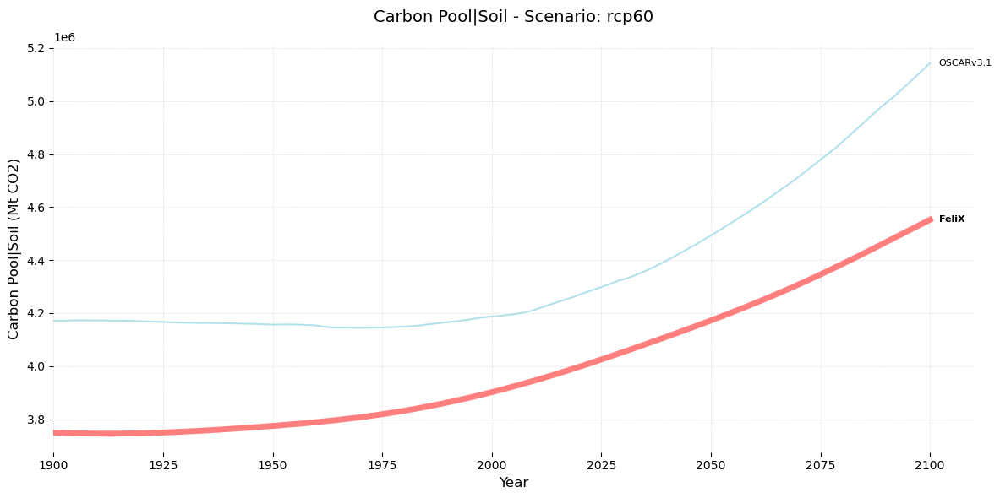

Original data shape: (11371, 1625)
After variable filtering: (91, 1625)
After scenario filtering: (2, 1625)
After region filtering: (2, 1625)
After year range filtering: (2, 206)
After excluding models: (2, 206)


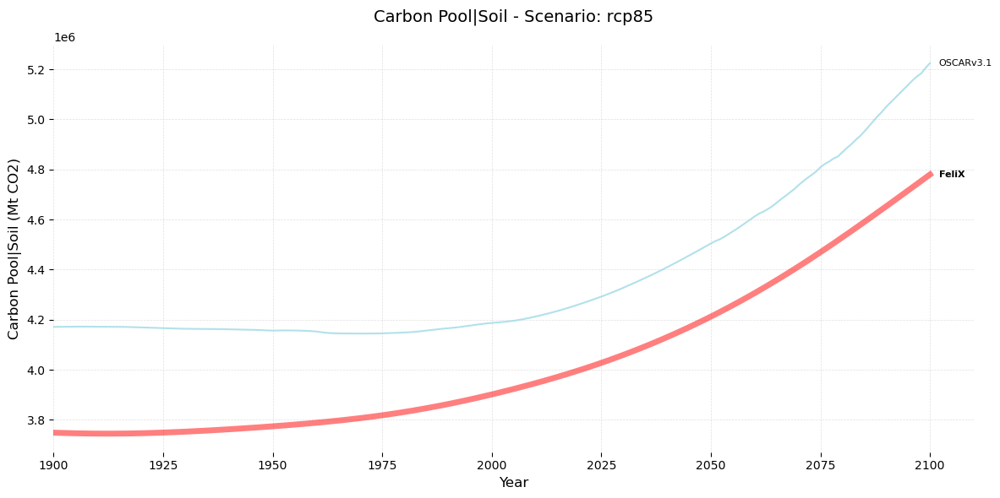

Original data shape: (11371, 1625)
After variable filtering: (91, 1625)
After scenario filtering: (2, 1625)
After region filtering: (2, 1625)
After year range filtering: (2, 206)
After excluding models: (2, 206)


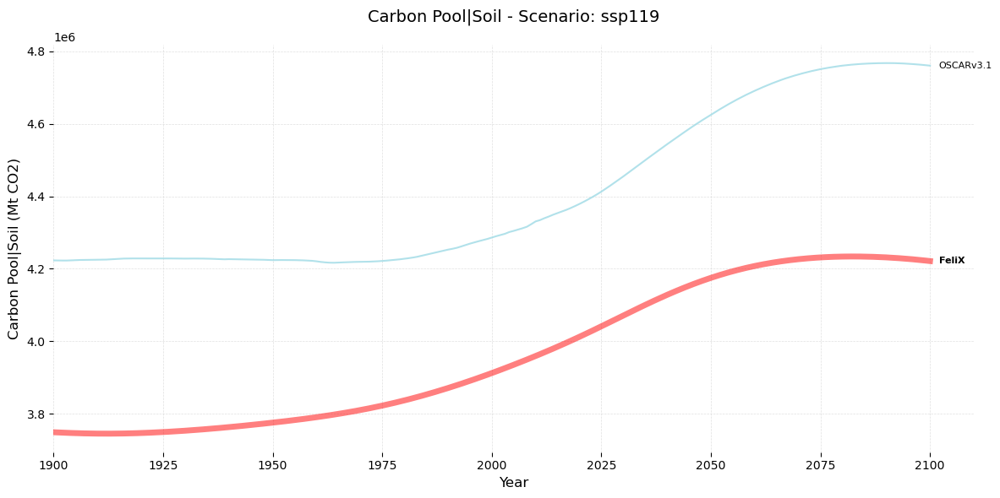

Original data shape: (11371, 1625)
After variable filtering: (91, 1625)
After scenario filtering: (2, 1625)
After region filtering: (2, 1625)
After year range filtering: (2, 206)
After excluding models: (2, 206)


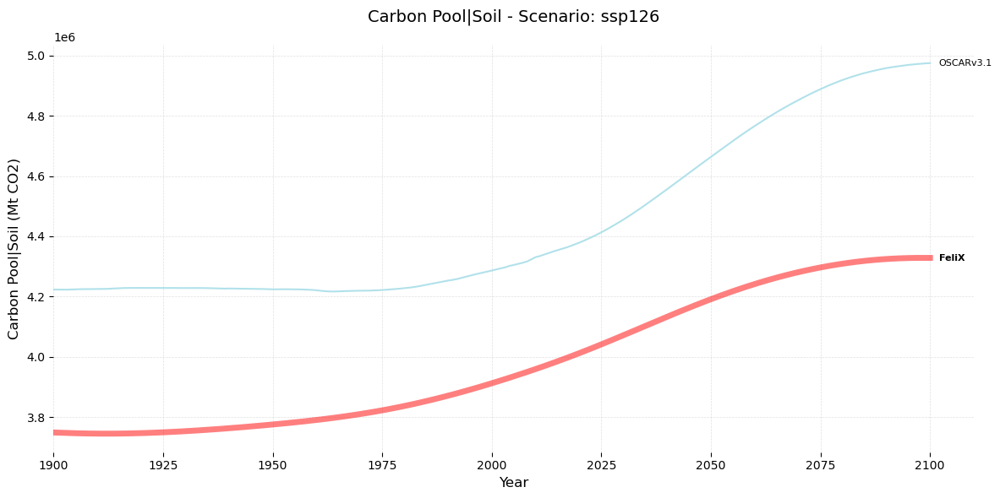

Original data shape: (11371, 1625)
After variable filtering: (91, 1625)
After scenario filtering: (2, 1625)
After region filtering: (2, 1625)
After year range filtering: (2, 206)
After excluding models: (2, 206)


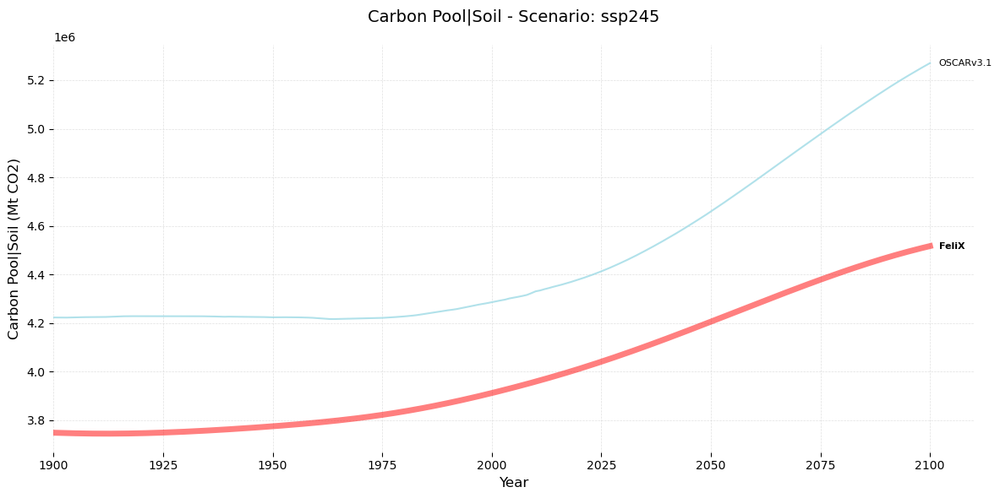

Original data shape: (11371, 1625)
After variable filtering: (91, 1625)
After scenario filtering: (2, 1625)
After region filtering: (2, 1625)
After year range filtering: (2, 206)
After excluding models: (2, 206)


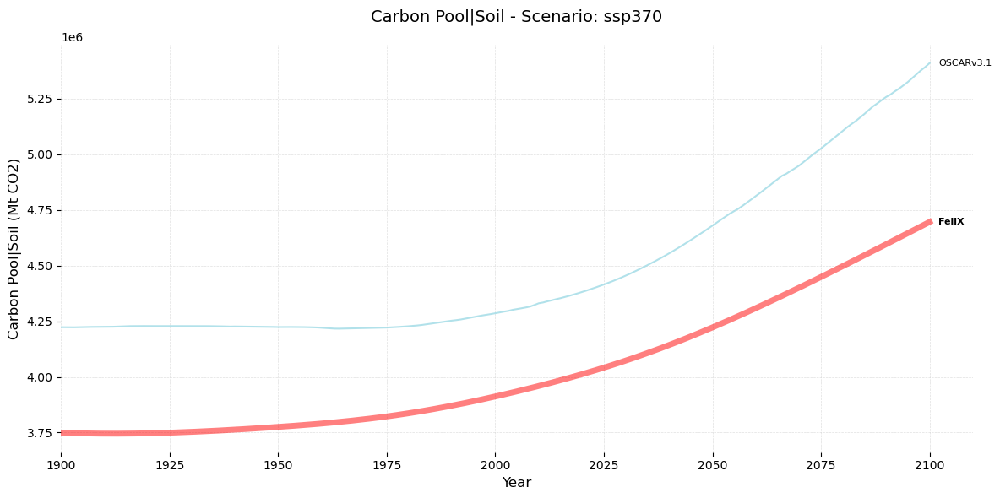

Original data shape: (11371, 1625)
After variable filtering: (91, 1625)
After scenario filtering: (2, 1625)
After region filtering: (2, 1625)
After year range filtering: (2, 206)
After excluding models: (2, 206)


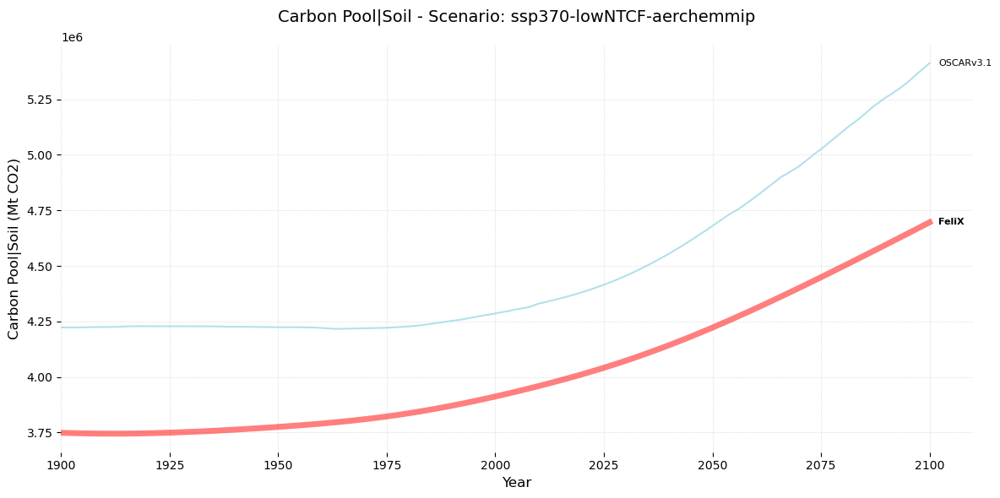

Original data shape: (11371, 1625)
After variable filtering: (91, 1625)
After scenario filtering: (2, 1625)
After region filtering: (2, 1625)
After year range filtering: (2, 206)
After excluding models: (2, 206)


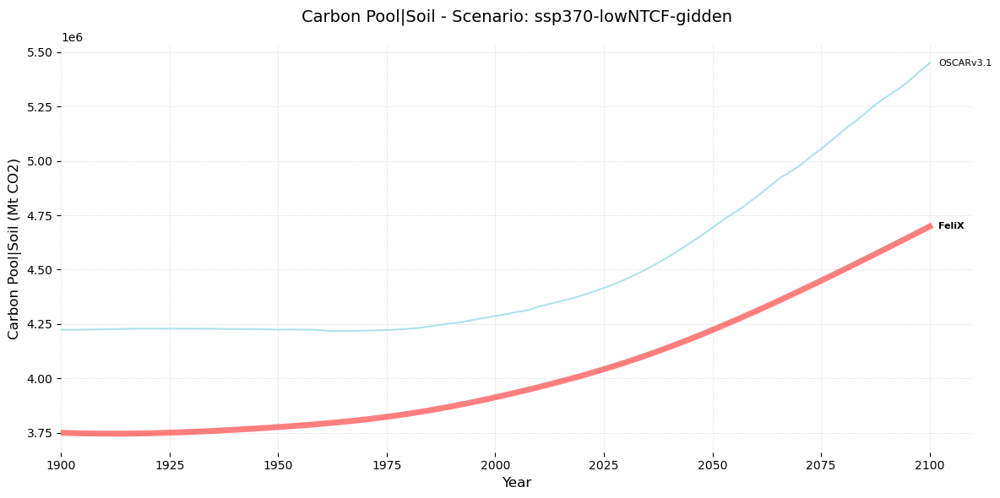

Original data shape: (11371, 1625)
After variable filtering: (91, 1625)
After scenario filtering: (2, 1625)
After region filtering: (2, 1625)
After year range filtering: (2, 206)
After excluding models: (2, 206)


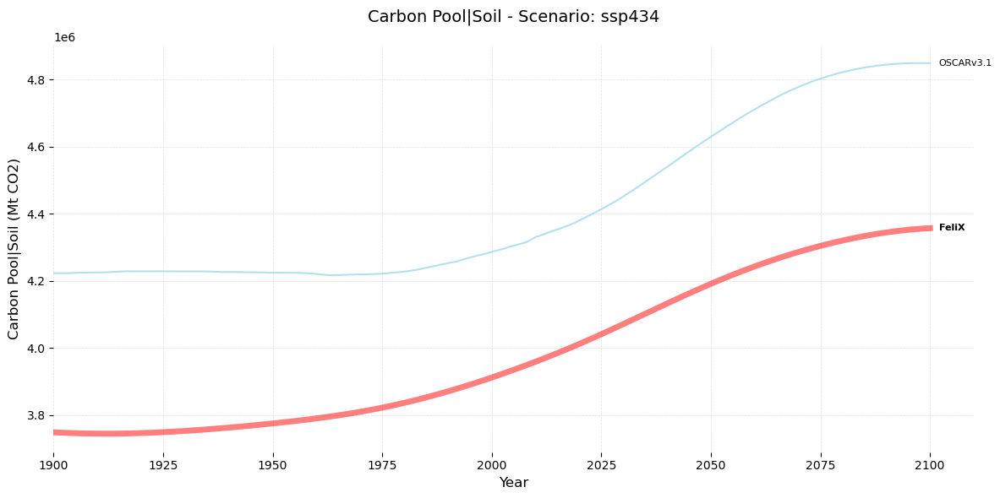

Original data shape: (11371, 1625)
After variable filtering: (91, 1625)
After scenario filtering: (2, 1625)
After region filtering: (2, 1625)
After year range filtering: (2, 206)
After excluding models: (2, 206)


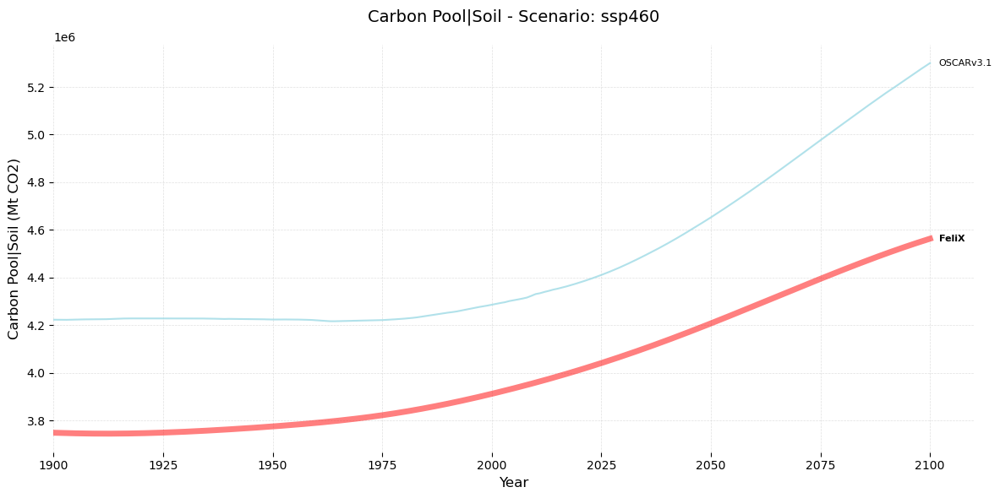

Original data shape: (11371, 1625)
After variable filtering: (91, 1625)
After scenario filtering: (2, 1625)
After region filtering: (2, 1625)
After year range filtering: (2, 206)
After excluding models: (2, 206)


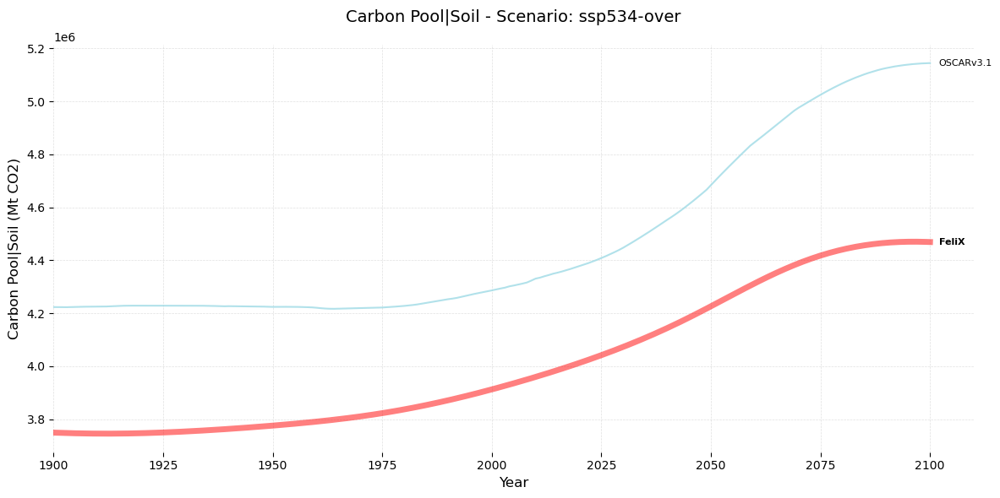

Original data shape: (11371, 1625)
After variable filtering: (91, 1625)
After scenario filtering: (2, 1625)
After region filtering: (2, 1625)
After year range filtering: (2, 206)
After excluding models: (2, 206)


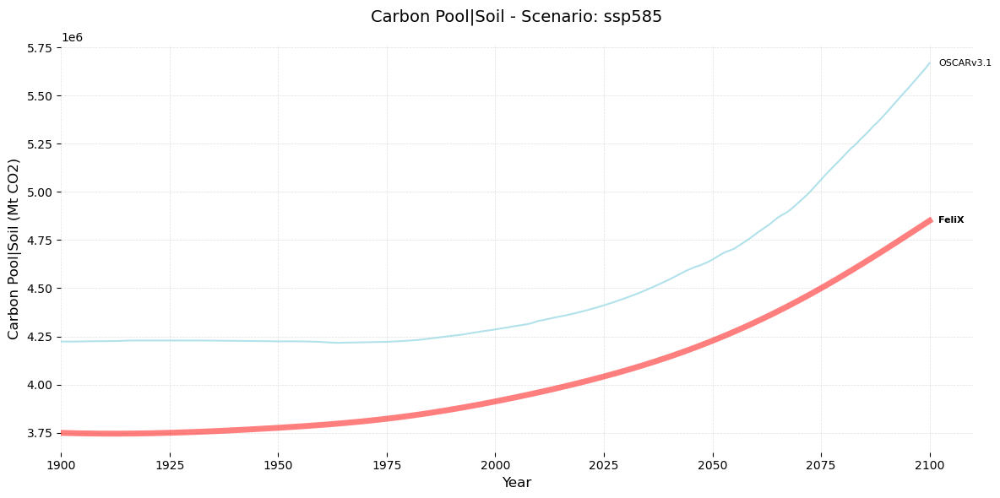

Original data shape: (11371, 1625)
After variable filtering: (91, 1625)
After scenario filtering: (2, 1625)
After region filtering: (2, 1625)
After year range filtering: (2, 206)
After excluding models: (2, 206)


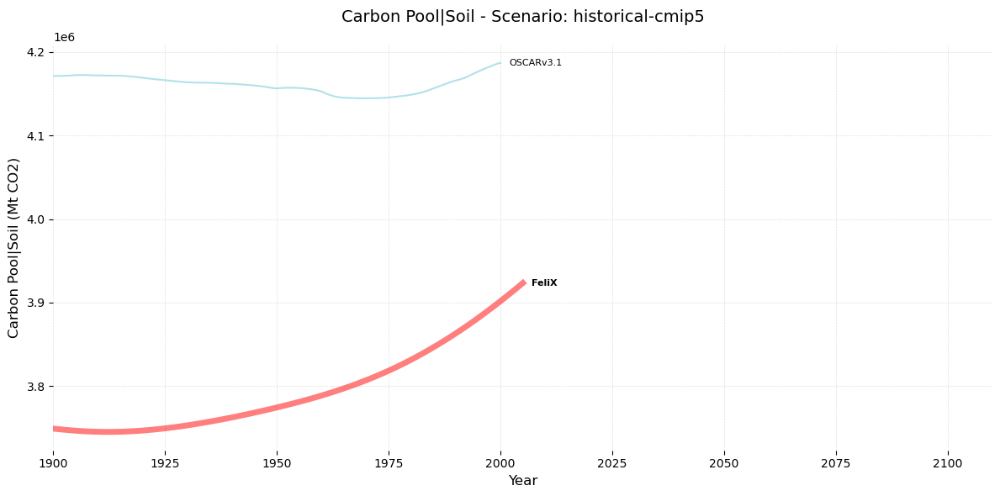

Original data shape: (11371, 1625)
After variable filtering: (91, 1625)
After scenario filtering: (2, 1625)
After region filtering: (2, 1625)
After year range filtering: (2, 206)
After excluding models: (2, 206)


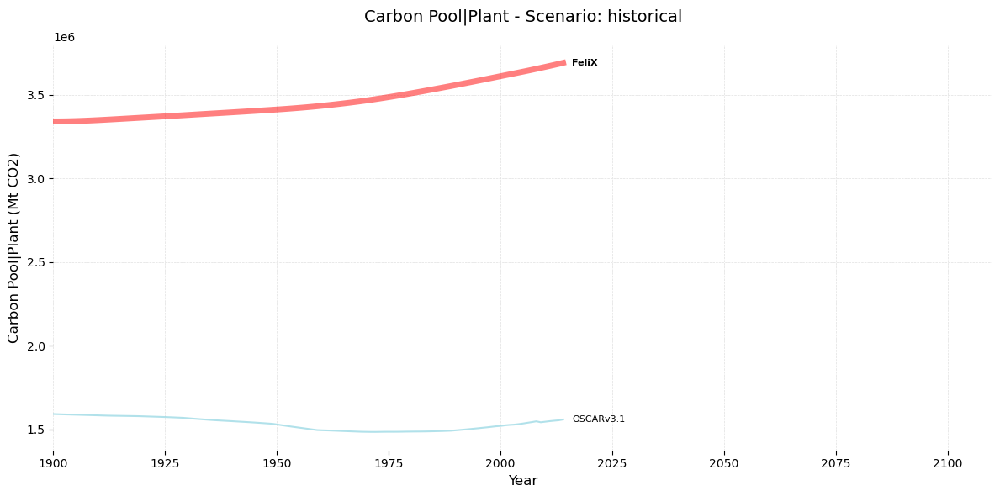

Original data shape: (11371, 1625)
After variable filtering: (91, 1625)
After scenario filtering: (2, 1625)
After region filtering: (2, 1625)
After year range filtering: (2, 206)
After excluding models: (2, 206)


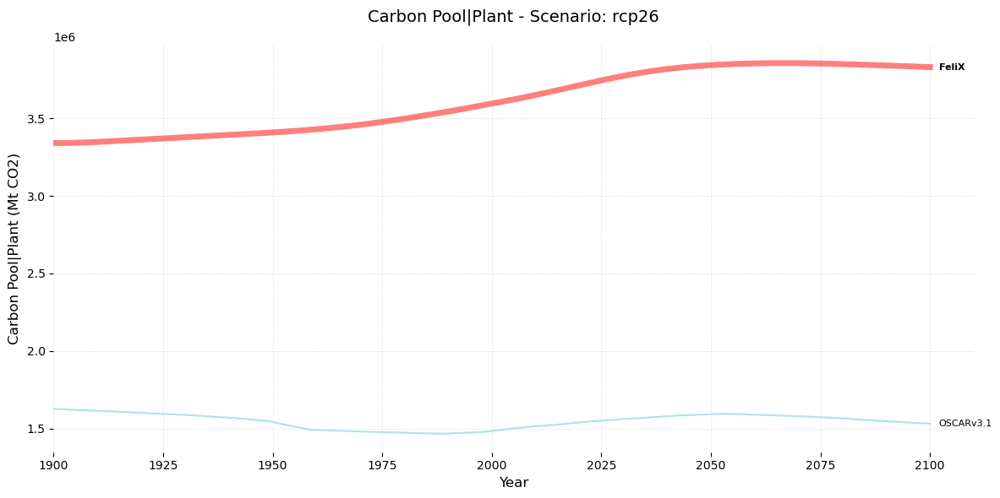

Original data shape: (11371, 1625)
After variable filtering: (91, 1625)
After scenario filtering: (2, 1625)
After region filtering: (2, 1625)
After year range filtering: (2, 206)
After excluding models: (2, 206)


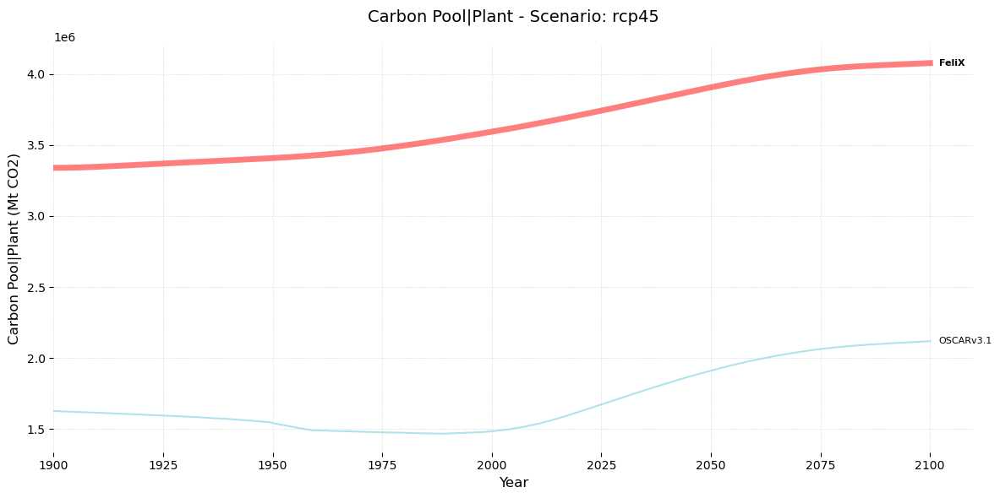

Original data shape: (11371, 1625)
After variable filtering: (91, 1625)
After scenario filtering: (2, 1625)
After region filtering: (2, 1625)
After year range filtering: (2, 206)
After excluding models: (2, 206)


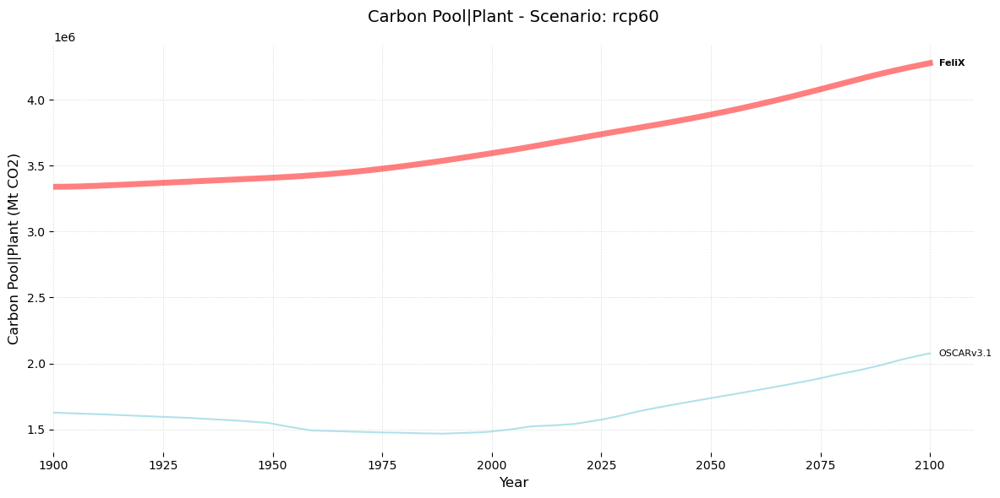

Original data shape: (11371, 1625)
After variable filtering: (91, 1625)
After scenario filtering: (2, 1625)
After region filtering: (2, 1625)
After year range filtering: (2, 206)
After excluding models: (2, 206)


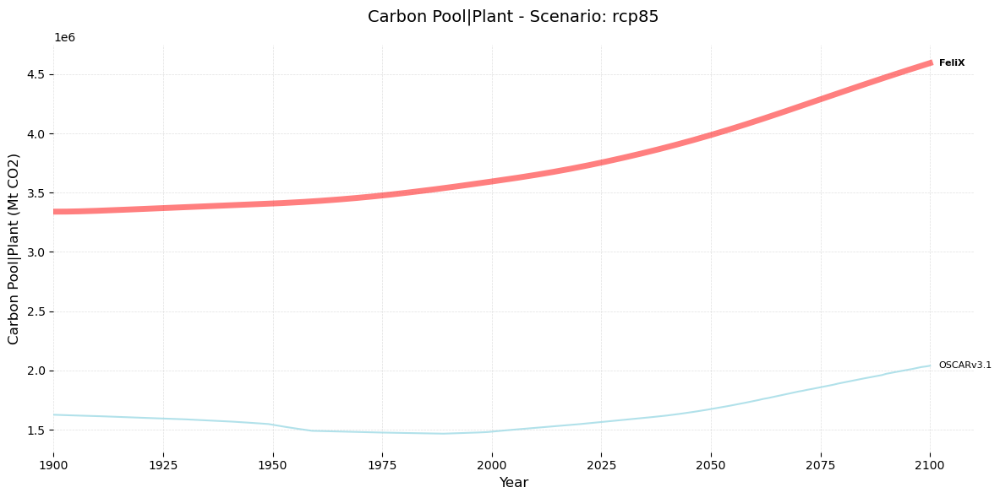

Original data shape: (11371, 1625)
After variable filtering: (91, 1625)
After scenario filtering: (2, 1625)
After region filtering: (2, 1625)
After year range filtering: (2, 206)
After excluding models: (2, 206)


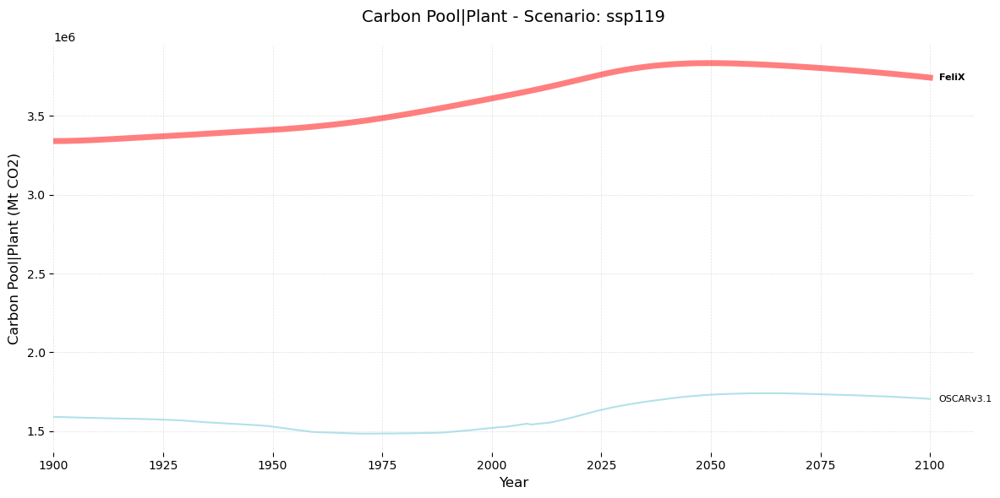

Original data shape: (11371, 1625)
After variable filtering: (91, 1625)
After scenario filtering: (2, 1625)
After region filtering: (2, 1625)
After year range filtering: (2, 206)
After excluding models: (2, 206)


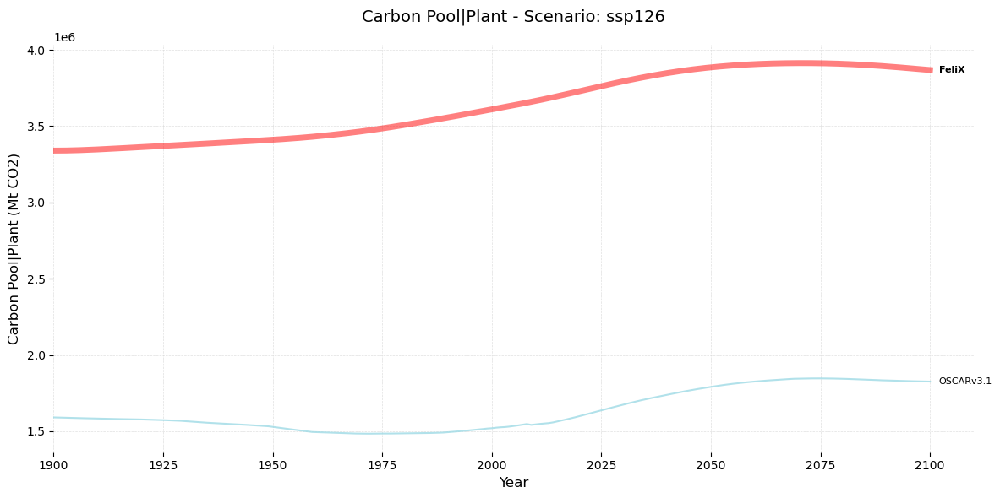

Original data shape: (11371, 1625)
After variable filtering: (91, 1625)
After scenario filtering: (2, 1625)
After region filtering: (2, 1625)
After year range filtering: (2, 206)
After excluding models: (2, 206)


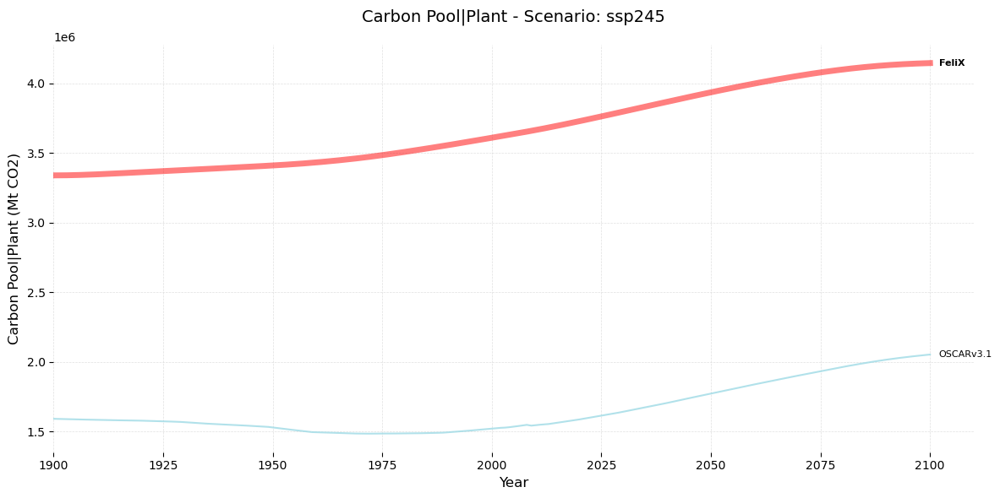

Original data shape: (11371, 1625)
After variable filtering: (91, 1625)
After scenario filtering: (2, 1625)
After region filtering: (2, 1625)
After year range filtering: (2, 206)
After excluding models: (2, 206)


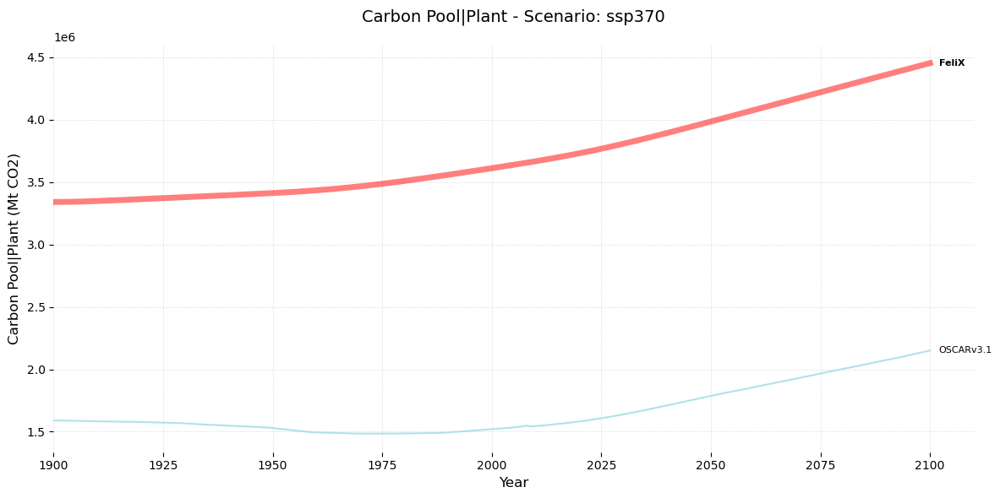

Original data shape: (11371, 1625)
After variable filtering: (91, 1625)
After scenario filtering: (2, 1625)
After region filtering: (2, 1625)
After year range filtering: (2, 206)
After excluding models: (2, 206)


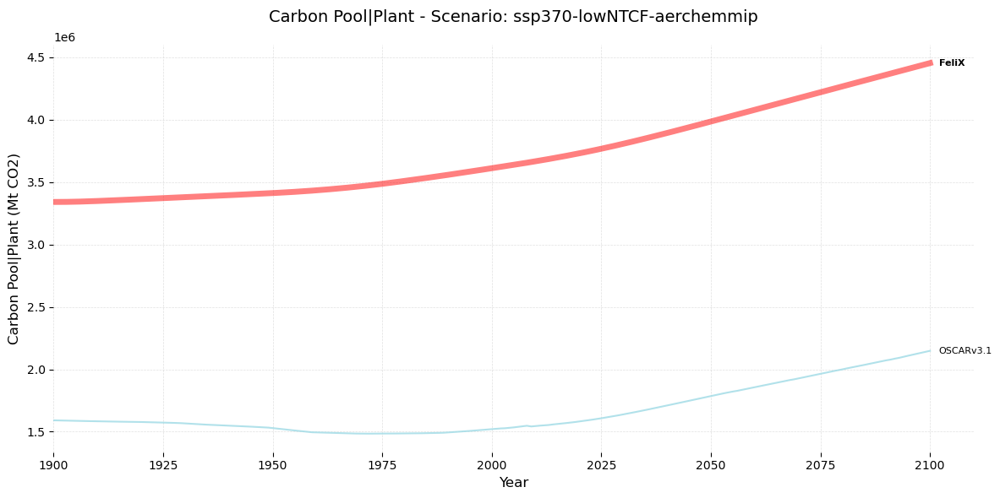

Original data shape: (11371, 1625)
After variable filtering: (91, 1625)
After scenario filtering: (2, 1625)
After region filtering: (2, 1625)
After year range filtering: (2, 206)
After excluding models: (2, 206)


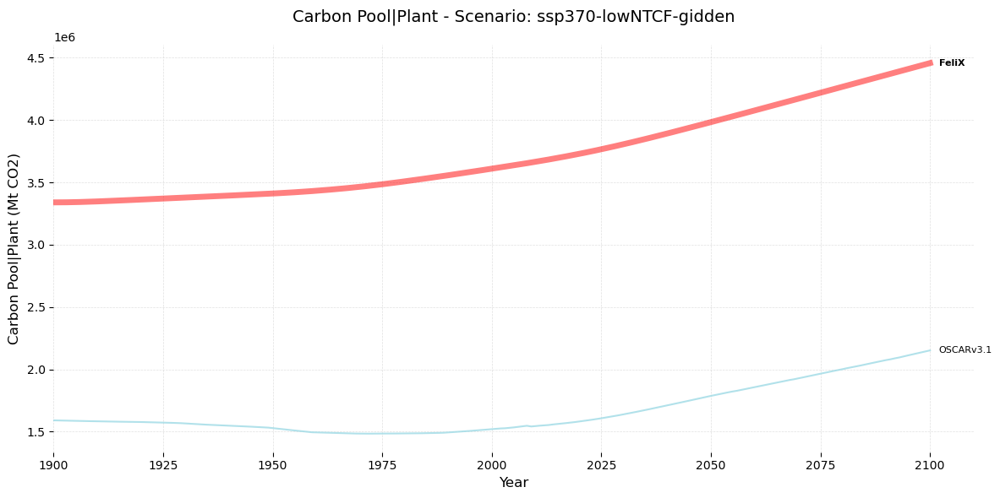

Original data shape: (11371, 1625)
After variable filtering: (91, 1625)
After scenario filtering: (2, 1625)
After region filtering: (2, 1625)
After year range filtering: (2, 206)
After excluding models: (2, 206)


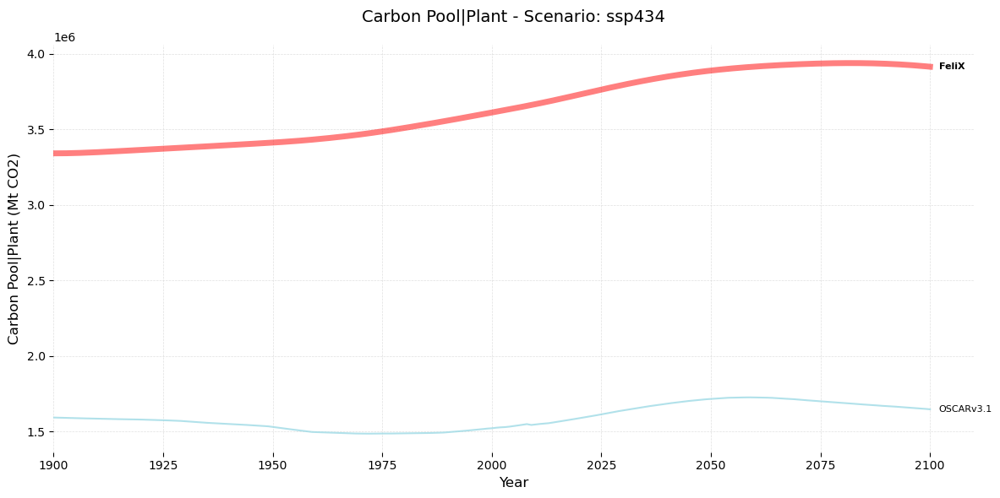

Original data shape: (11371, 1625)
After variable filtering: (91, 1625)
After scenario filtering: (2, 1625)
After region filtering: (2, 1625)
After year range filtering: (2, 206)
After excluding models: (2, 206)


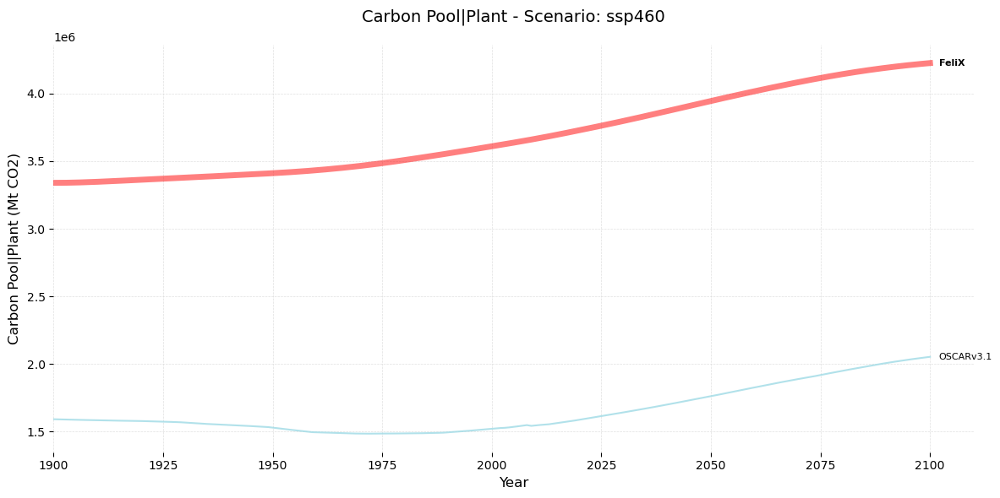

Original data shape: (11371, 1625)
After variable filtering: (91, 1625)
After scenario filtering: (2, 1625)
After region filtering: (2, 1625)
After year range filtering: (2, 206)
After excluding models: (2, 206)


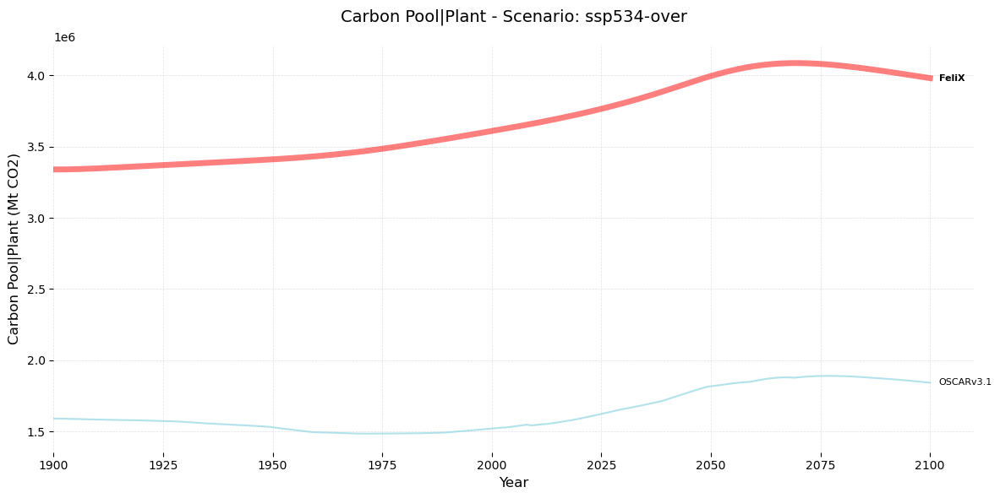

Original data shape: (11371, 1625)
After variable filtering: (91, 1625)
After scenario filtering: (2, 1625)
After region filtering: (2, 1625)
After year range filtering: (2, 206)
After excluding models: (2, 206)


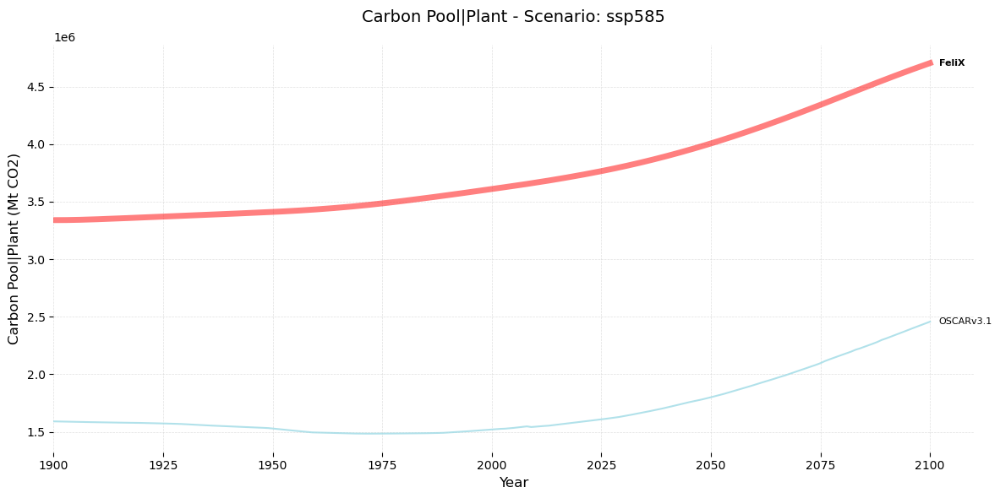

Original data shape: (11371, 1625)
After variable filtering: (91, 1625)
After scenario filtering: (2, 1625)
After region filtering: (2, 1625)
After year range filtering: (2, 206)
After excluding models: (2, 206)


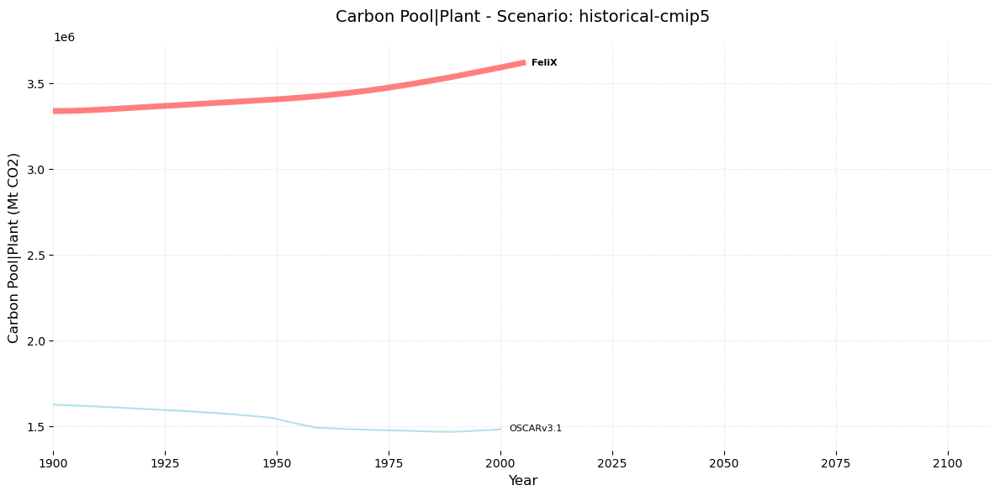

Original data shape: (11371, 1625)
After variable filtering: (91, 1625)
After scenario filtering: (2, 1625)
After region filtering: (2, 1625)
After year range filtering: (2, 206)
After excluding models: (2, 206)


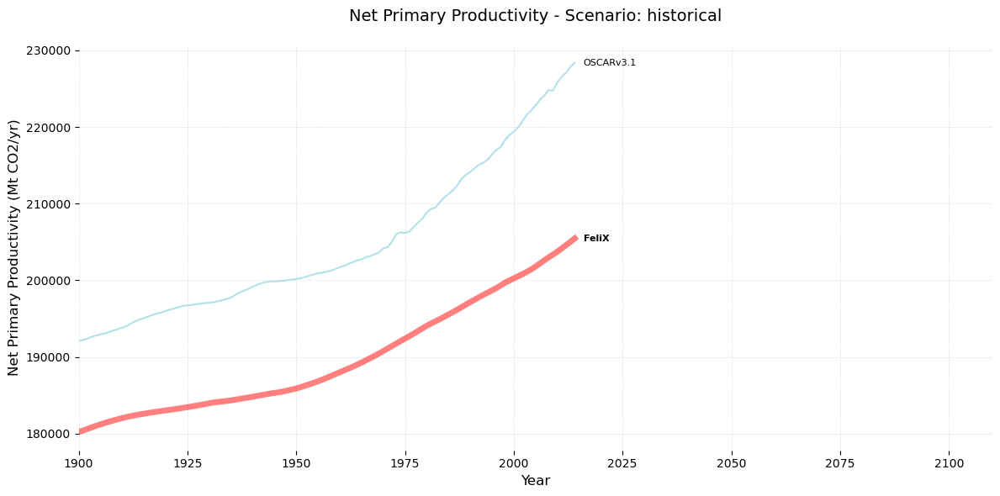

Original data shape: (11371, 1625)
After variable filtering: (91, 1625)
After scenario filtering: (2, 1625)
After region filtering: (2, 1625)
After year range filtering: (2, 206)
After excluding models: (2, 206)


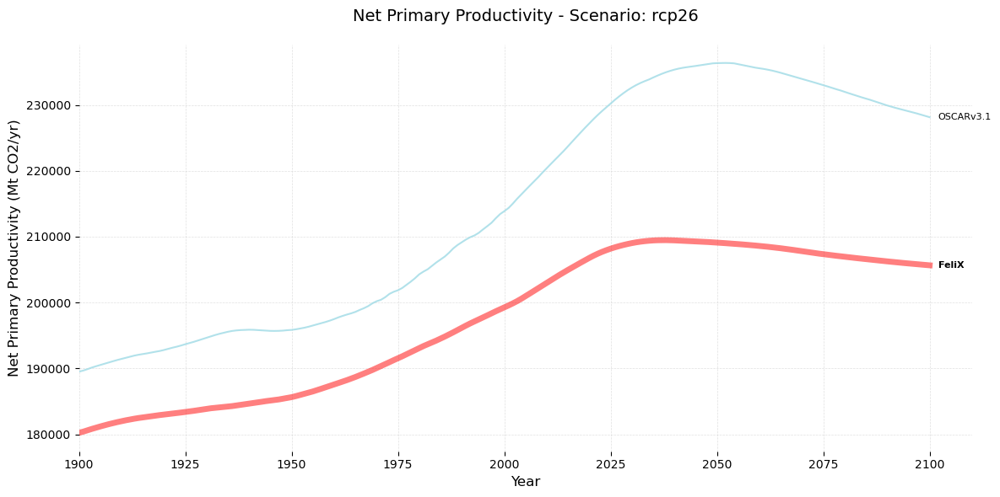

Original data shape: (11371, 1625)
After variable filtering: (91, 1625)
After scenario filtering: (2, 1625)
After region filtering: (2, 1625)
After year range filtering: (2, 206)
After excluding models: (2, 206)


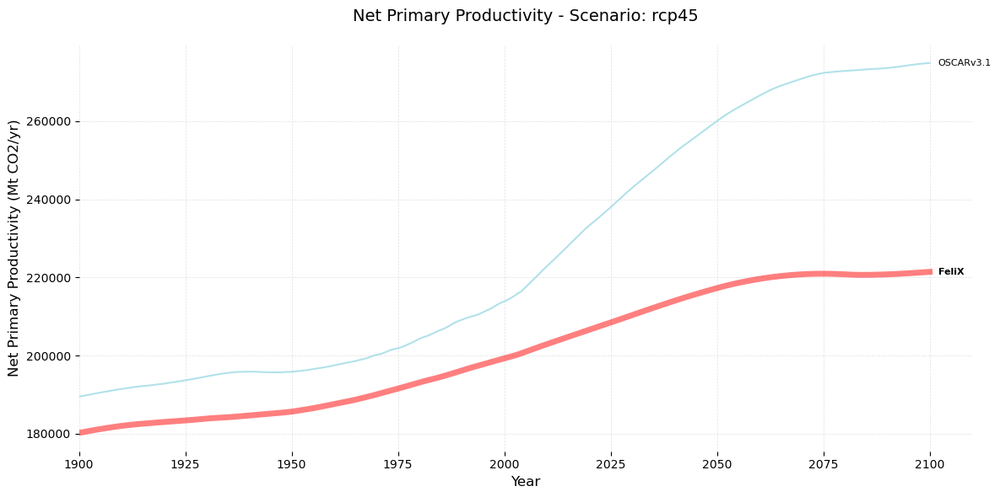

Original data shape: (11371, 1625)
After variable filtering: (91, 1625)
After scenario filtering: (2, 1625)
After region filtering: (2, 1625)
After year range filtering: (2, 206)
After excluding models: (2, 206)


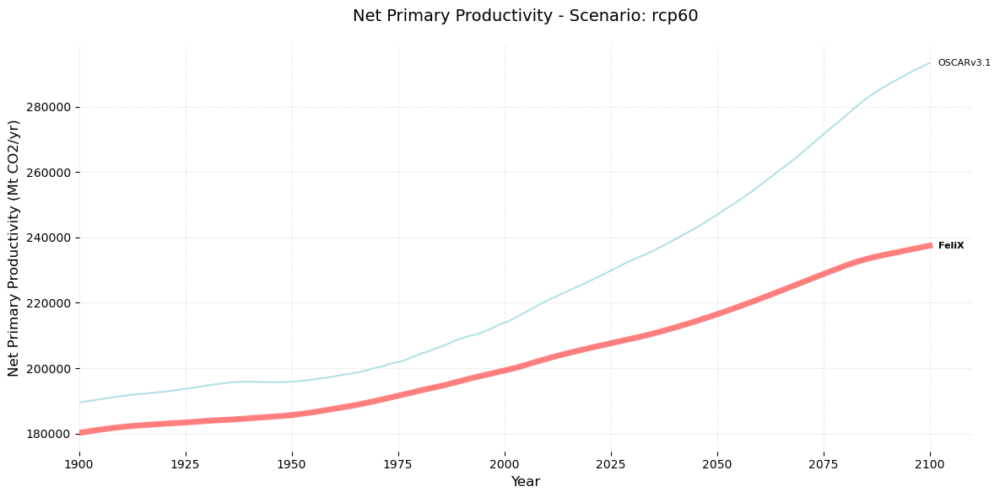

Original data shape: (11371, 1625)
After variable filtering: (91, 1625)
After scenario filtering: (2, 1625)
After region filtering: (2, 1625)
After year range filtering: (2, 206)
After excluding models: (2, 206)


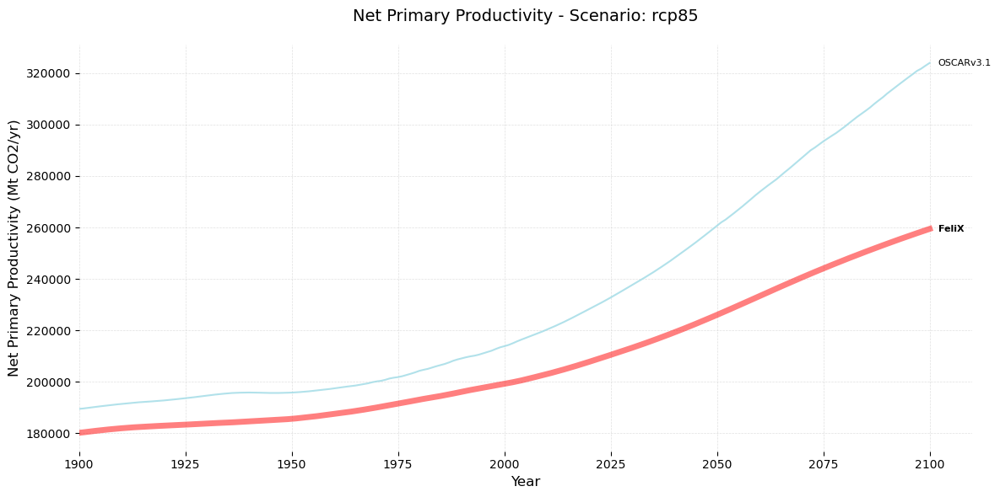

Original data shape: (11371, 1625)
After variable filtering: (91, 1625)
After scenario filtering: (2, 1625)
After region filtering: (2, 1625)
After year range filtering: (2, 206)
After excluding models: (2, 206)


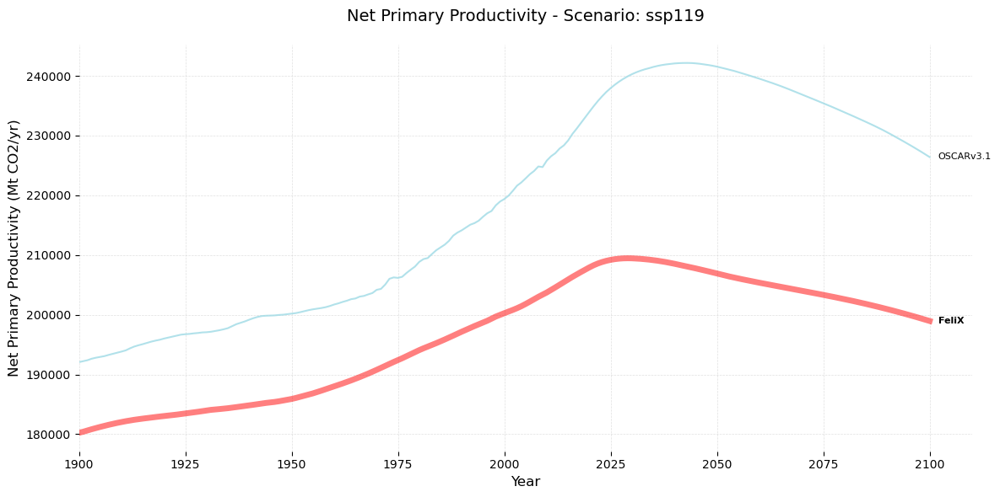

Original data shape: (11371, 1625)
After variable filtering: (91, 1625)
After scenario filtering: (2, 1625)
After region filtering: (2, 1625)
After year range filtering: (2, 206)
After excluding models: (2, 206)


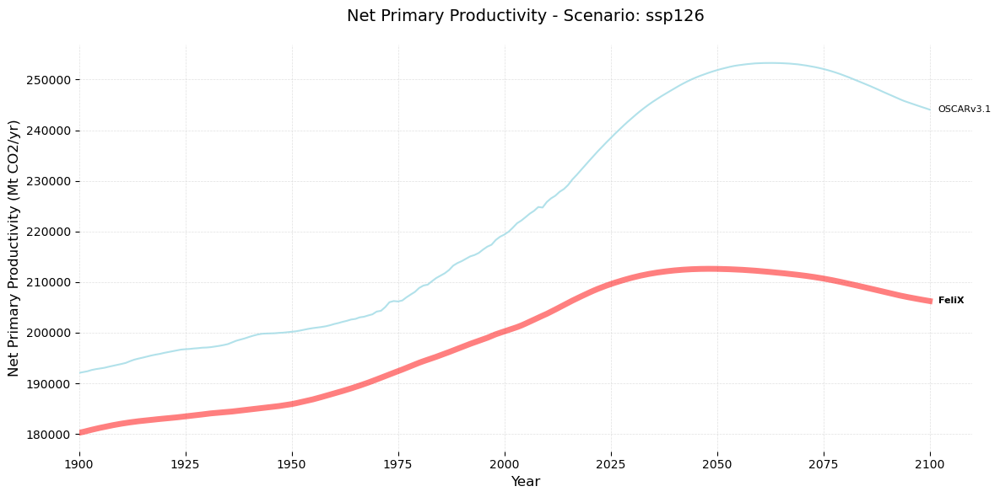

Original data shape: (11371, 1625)
After variable filtering: (91, 1625)
After scenario filtering: (2, 1625)
After region filtering: (2, 1625)
After year range filtering: (2, 206)
After excluding models: (2, 206)


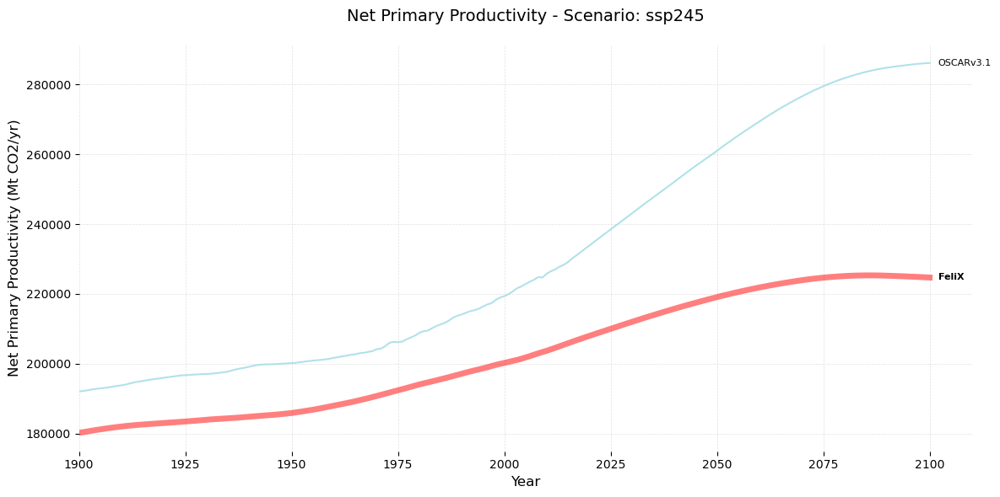

Original data shape: (11371, 1625)
After variable filtering: (91, 1625)
After scenario filtering: (2, 1625)
After region filtering: (2, 1625)
After year range filtering: (2, 206)
After excluding models: (2, 206)


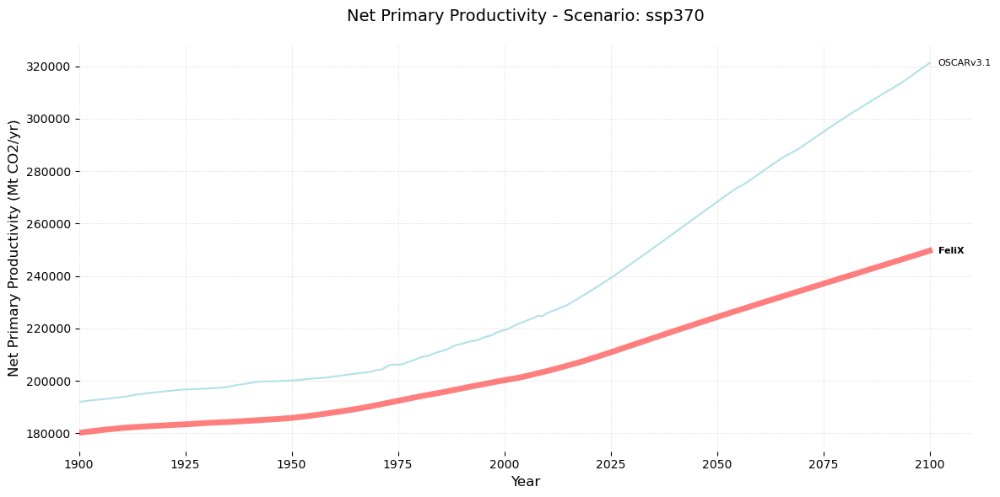

Original data shape: (11371, 1625)
After variable filtering: (91, 1625)
After scenario filtering: (2, 1625)
After region filtering: (2, 1625)
After year range filtering: (2, 206)
After excluding models: (2, 206)


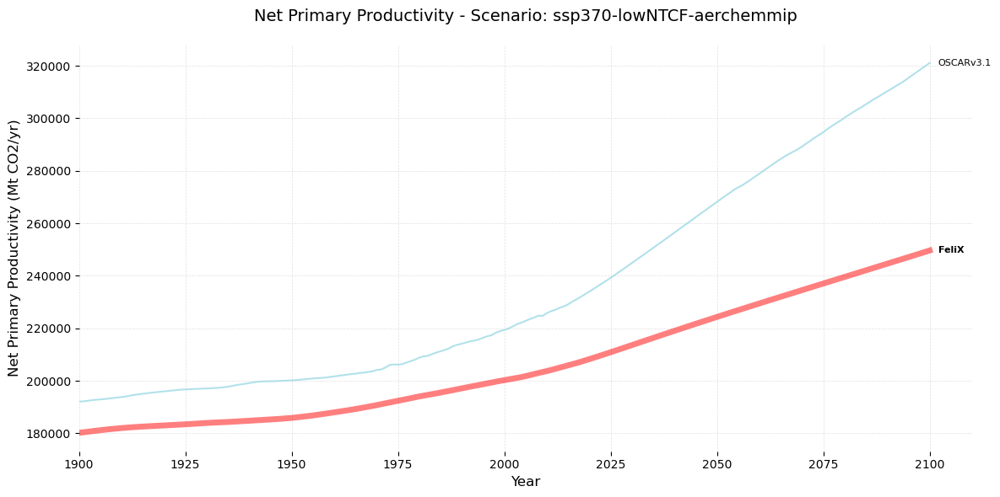

Original data shape: (11371, 1625)
After variable filtering: (91, 1625)
After scenario filtering: (2, 1625)
After region filtering: (2, 1625)
After year range filtering: (2, 206)
After excluding models: (2, 206)


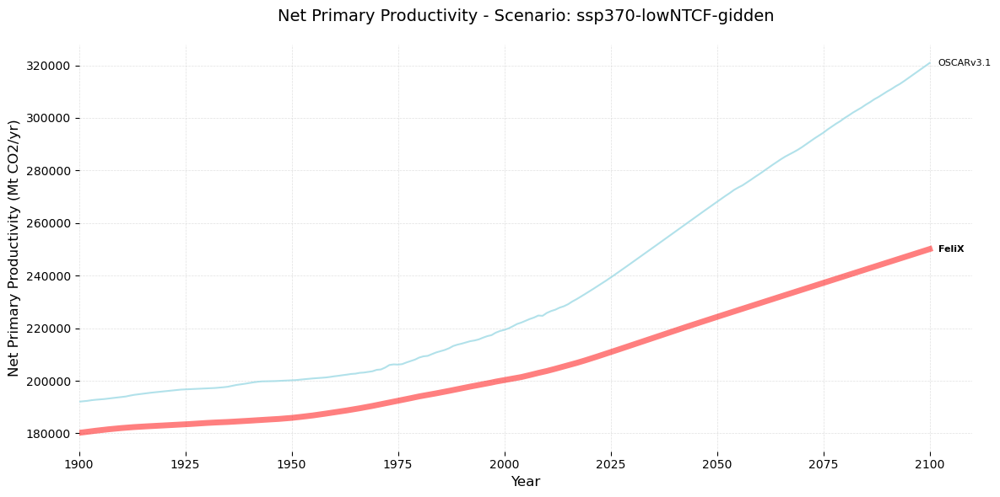

Original data shape: (11371, 1625)
After variable filtering: (91, 1625)
After scenario filtering: (2, 1625)
After region filtering: (2, 1625)
After year range filtering: (2, 206)
After excluding models: (2, 206)


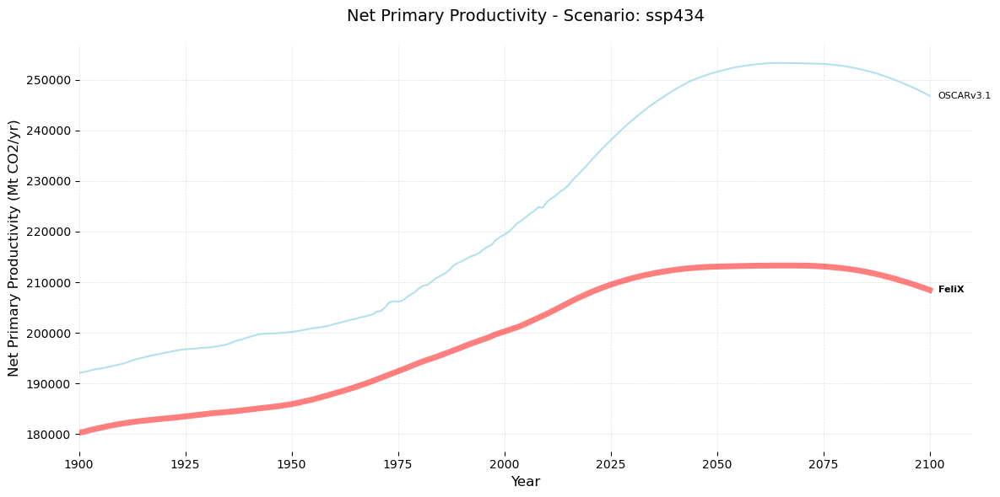

Original data shape: (11371, 1625)
After variable filtering: (91, 1625)
After scenario filtering: (2, 1625)
After region filtering: (2, 1625)
After year range filtering: (2, 206)
After excluding models: (2, 206)


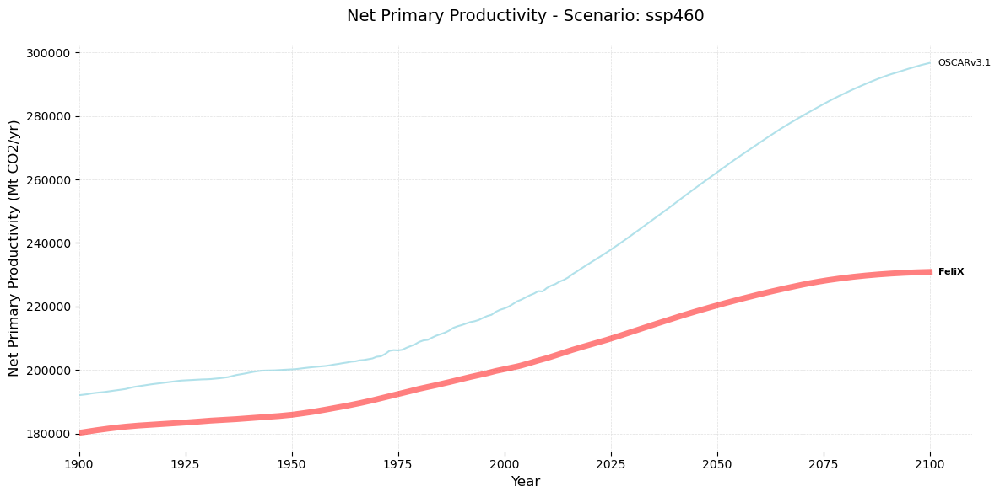

Original data shape: (11371, 1625)
After variable filtering: (91, 1625)
After scenario filtering: (2, 1625)
After region filtering: (2, 1625)
After year range filtering: (2, 206)
After excluding models: (2, 206)


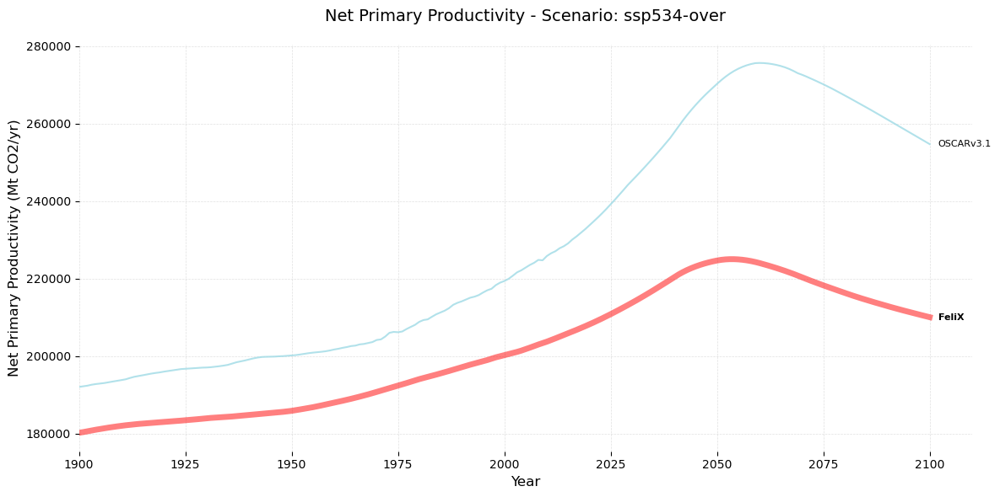

Original data shape: (11371, 1625)
After variable filtering: (91, 1625)
After scenario filtering: (2, 1625)
After region filtering: (2, 1625)
After year range filtering: (2, 206)
After excluding models: (2, 206)


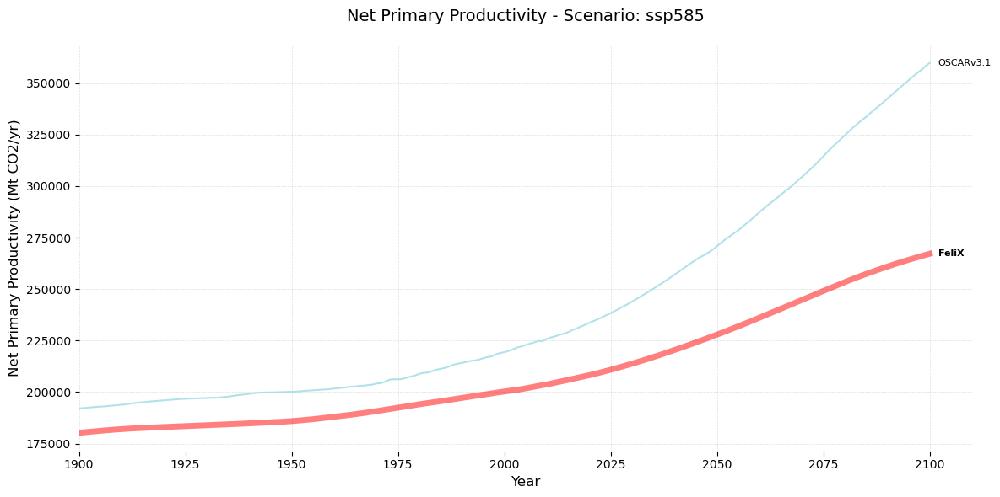

Original data shape: (11371, 1625)
After variable filtering: (91, 1625)
After scenario filtering: (2, 1625)
After region filtering: (2, 1625)
After year range filtering: (2, 206)
After excluding models: (2, 206)


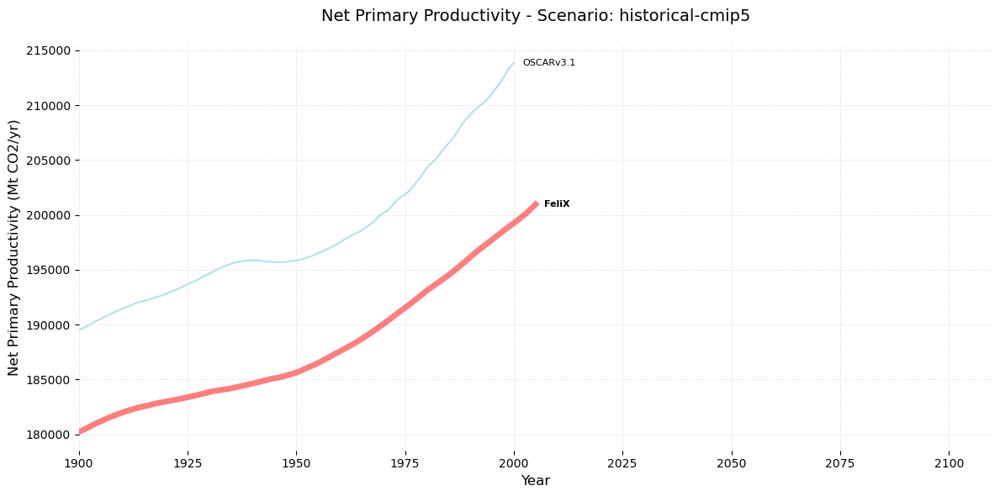

Original data shape: (11371, 1625)
After variable filtering: (762, 1625)
After scenario filtering: (12, 1625)
After region filtering: (12, 1625)
After year range filtering: (12, 206)
After excluding models: (12, 206)


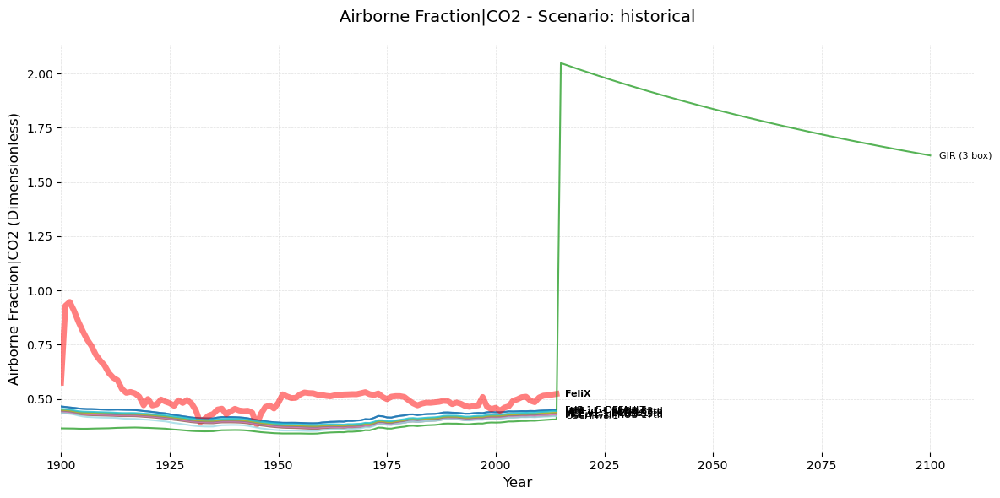

Original data shape: (11371, 1625)
After variable filtering: (762, 1625)
After scenario filtering: (5, 1625)
After region filtering: (5, 1625)
After year range filtering: (5, 206)
After excluding models: (5, 206)


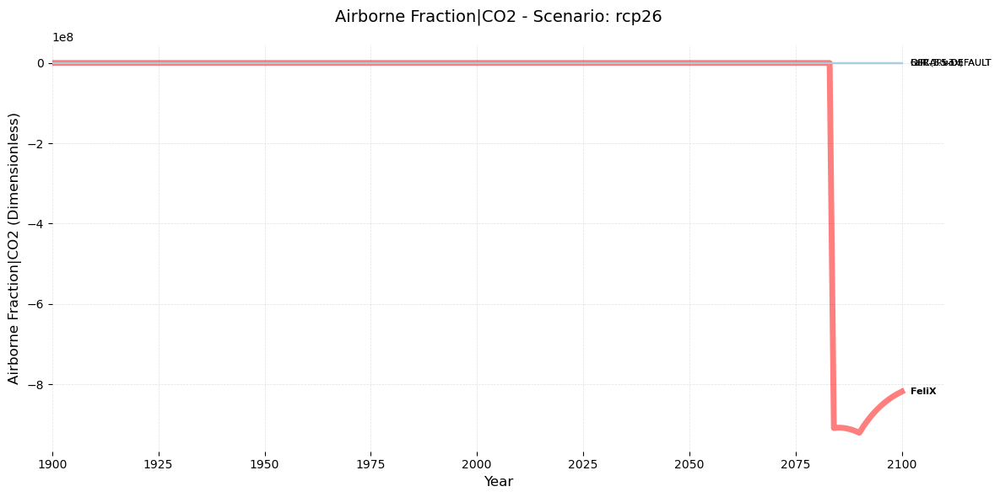

Original data shape: (11371, 1625)
After variable filtering: (762, 1625)
After scenario filtering: (5, 1625)
After region filtering: (5, 1625)
After year range filtering: (5, 206)
After excluding models: (5, 206)


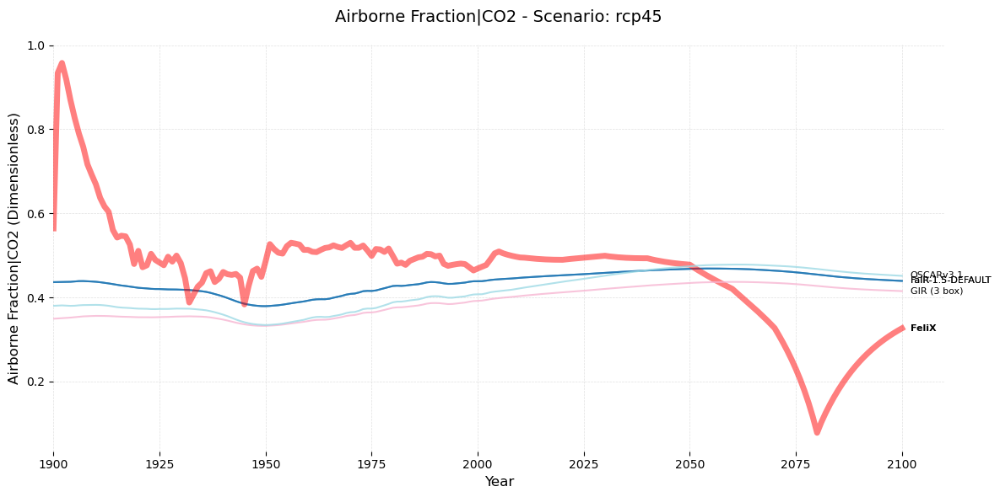

Original data shape: (11371, 1625)
After variable filtering: (762, 1625)
After scenario filtering: (5, 1625)
After region filtering: (5, 1625)
After year range filtering: (5, 206)
After excluding models: (5, 206)


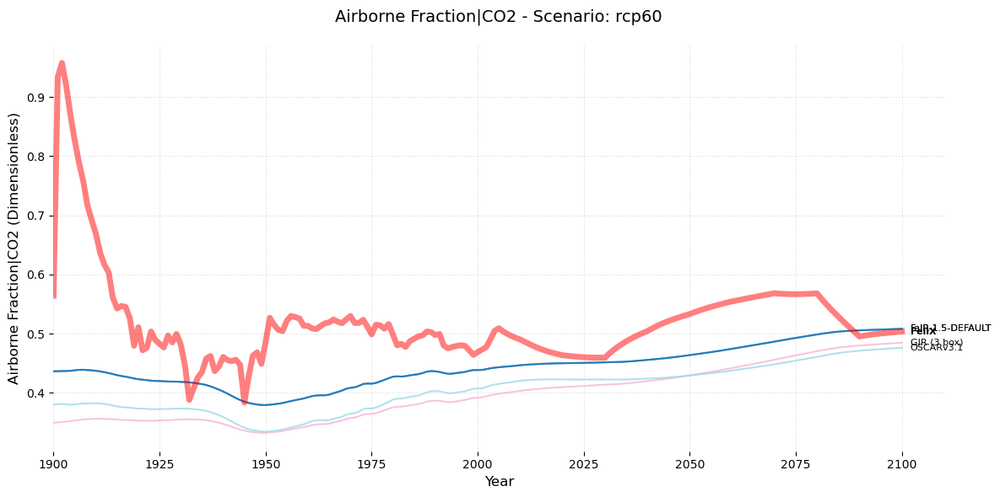

Original data shape: (11371, 1625)
After variable filtering: (762, 1625)
After scenario filtering: (5, 1625)
After region filtering: (5, 1625)
After year range filtering: (5, 206)
After excluding models: (5, 206)


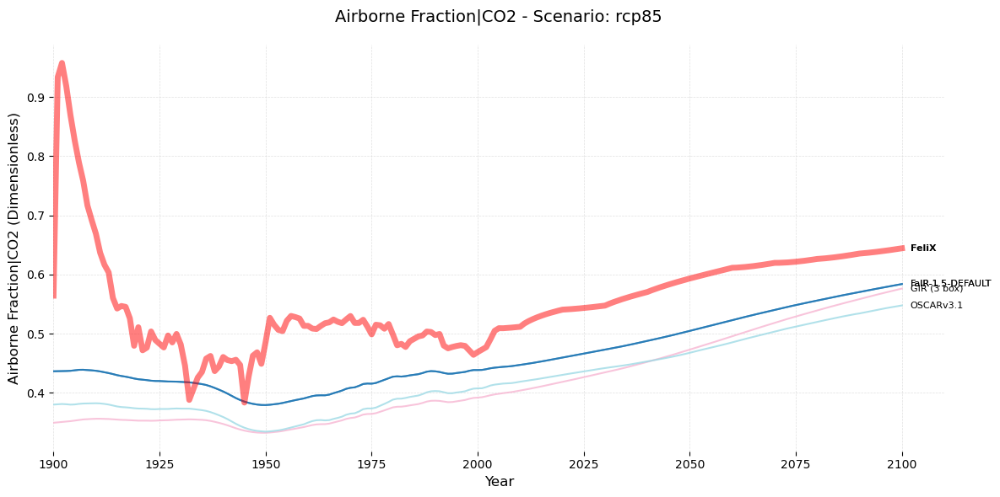

Original data shape: (11371, 1625)
After variable filtering: (762, 1625)
After scenario filtering: (12, 1625)
After region filtering: (12, 1625)
After year range filtering: (12, 206)
After excluding models: (12, 206)


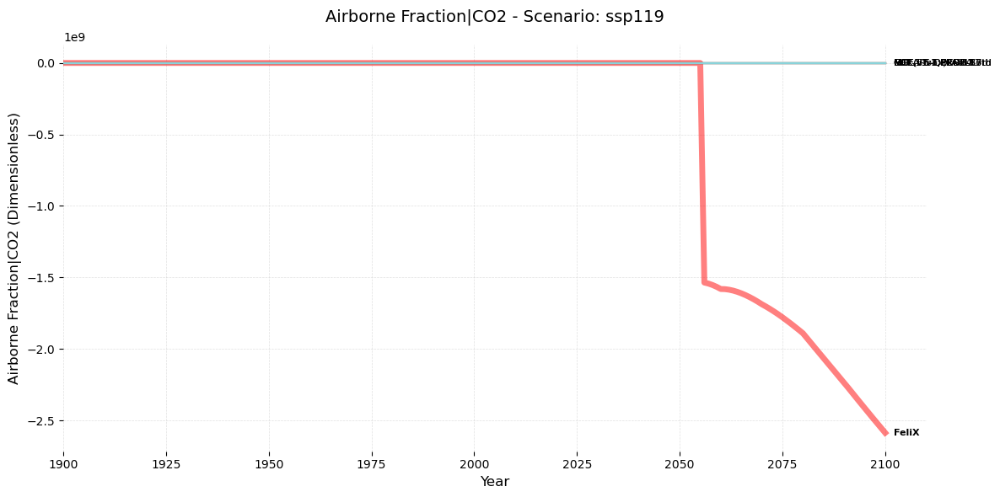

Original data shape: (11371, 1625)
After variable filtering: (762, 1625)
After scenario filtering: (12, 1625)
After region filtering: (12, 1625)
After year range filtering: (12, 206)
After excluding models: (12, 206)


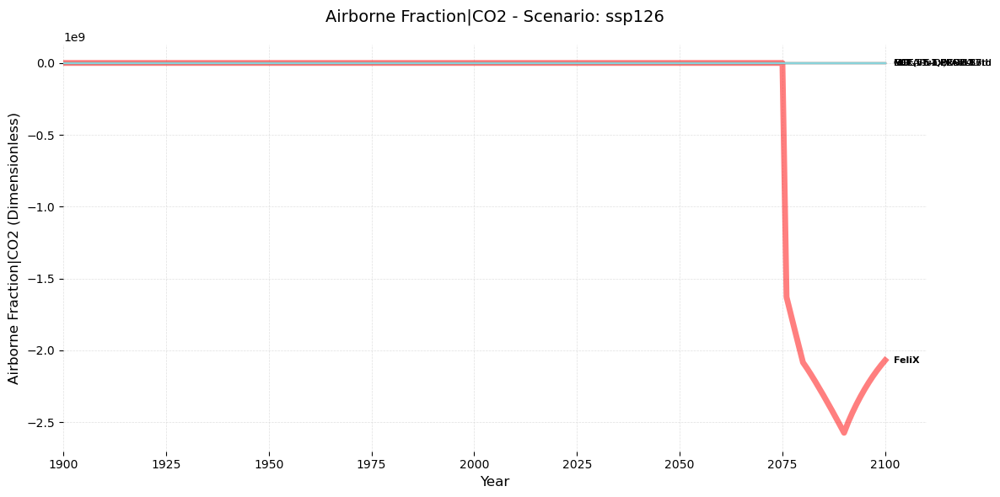

Original data shape: (11371, 1625)
After variable filtering: (762, 1625)
After scenario filtering: (12, 1625)
After region filtering: (12, 1625)
After year range filtering: (12, 206)
After excluding models: (12, 206)


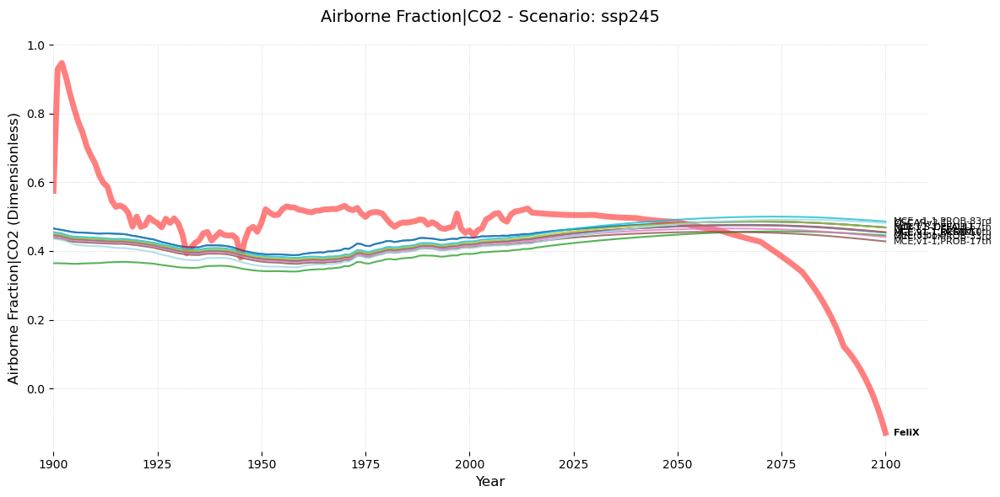

Original data shape: (11371, 1625)
After variable filtering: (762, 1625)
After scenario filtering: (12, 1625)
After region filtering: (12, 1625)
After year range filtering: (12, 206)
After excluding models: (12, 206)


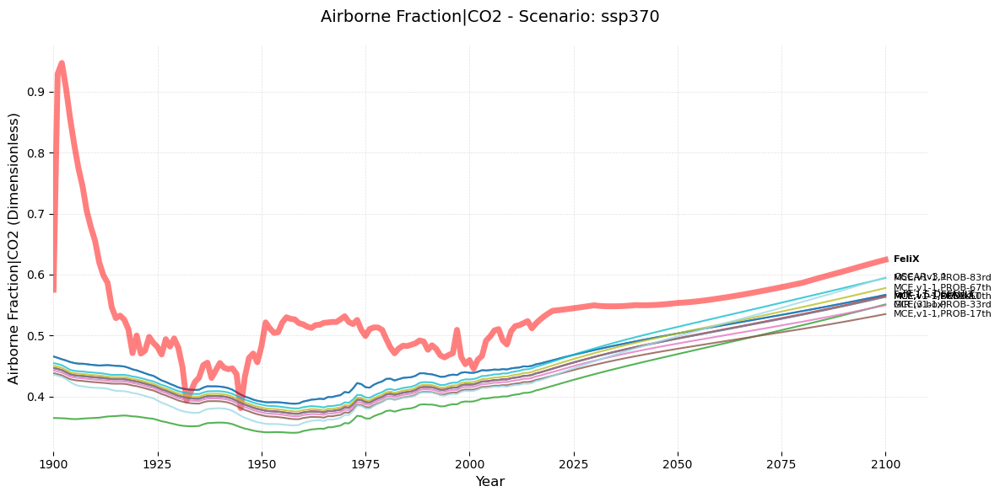

Original data shape: (11371, 1625)
After variable filtering: (762, 1625)
After scenario filtering: (11, 1625)
After region filtering: (11, 1625)
After year range filtering: (11, 206)
After excluding models: (11, 206)


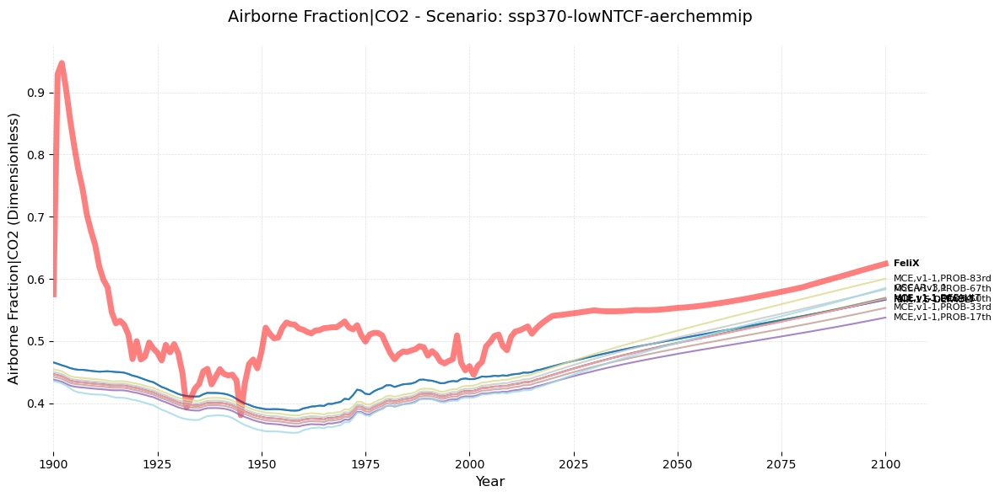

Original data shape: (11371, 1625)
After variable filtering: (762, 1625)
After scenario filtering: (9, 1625)
After region filtering: (9, 1625)
After year range filtering: (9, 206)
After excluding models: (9, 206)


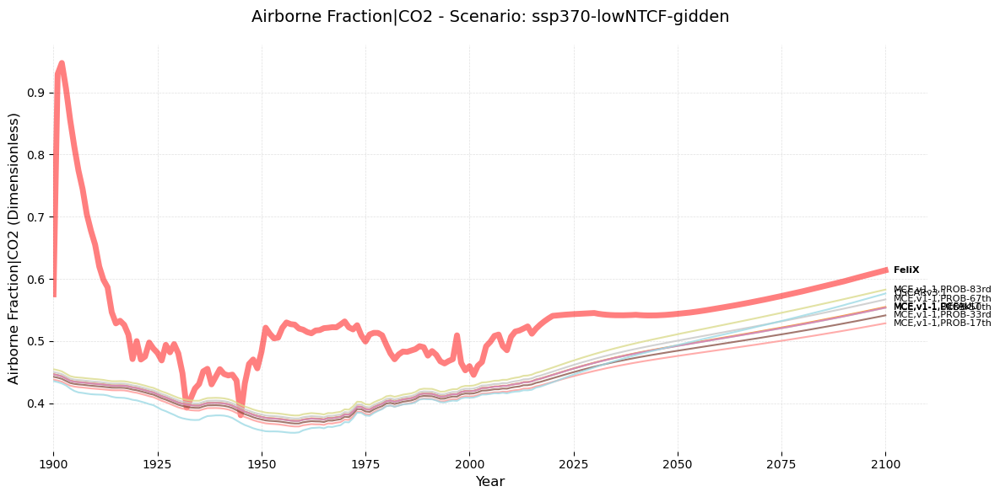

Original data shape: (11371, 1625)
After variable filtering: (762, 1625)
After scenario filtering: (12, 1625)
After region filtering: (12, 1625)
After year range filtering: (12, 206)
After excluding models: (12, 206)


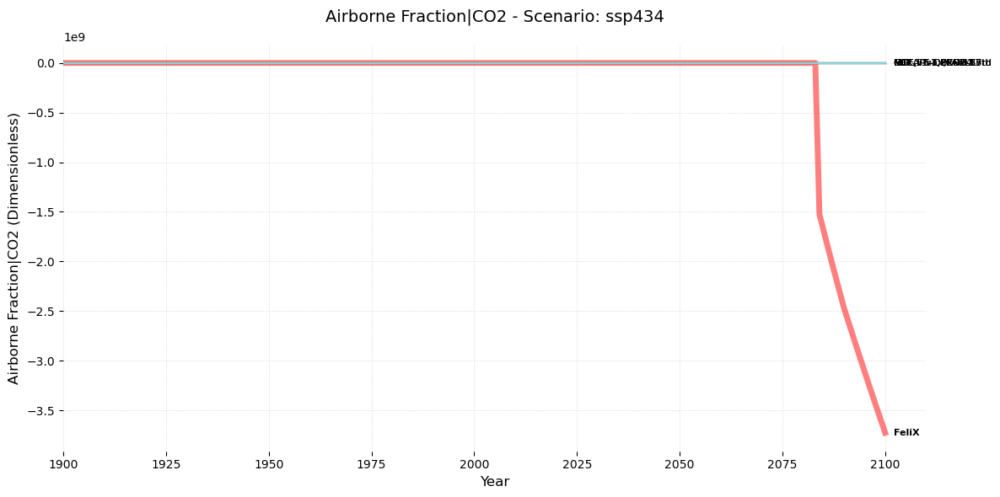

Original data shape: (11371, 1625)
After variable filtering: (762, 1625)
After scenario filtering: (12, 1625)
After region filtering: (12, 1625)
After year range filtering: (12, 206)
After excluding models: (12, 206)


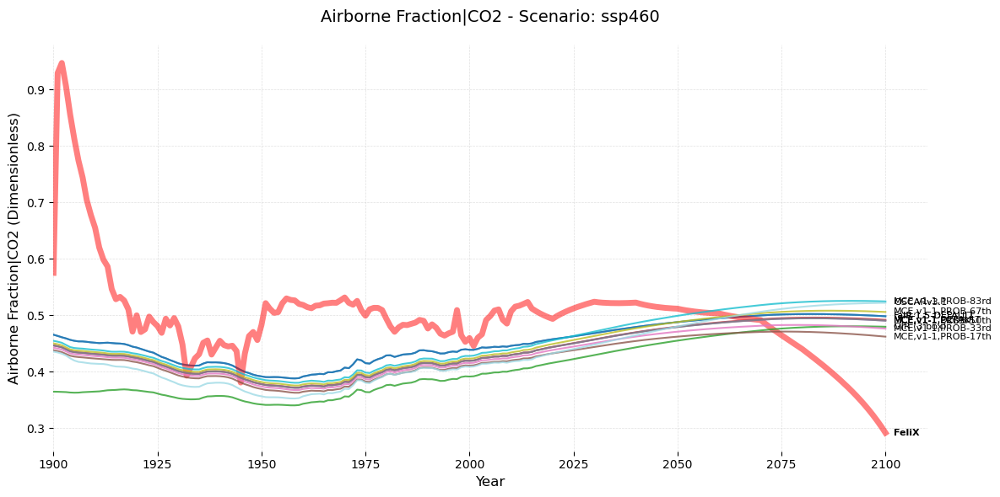

Original data shape: (11371, 1625)
After variable filtering: (762, 1625)
After scenario filtering: (12, 1625)
After region filtering: (12, 1625)
After year range filtering: (12, 206)
After excluding models: (12, 206)


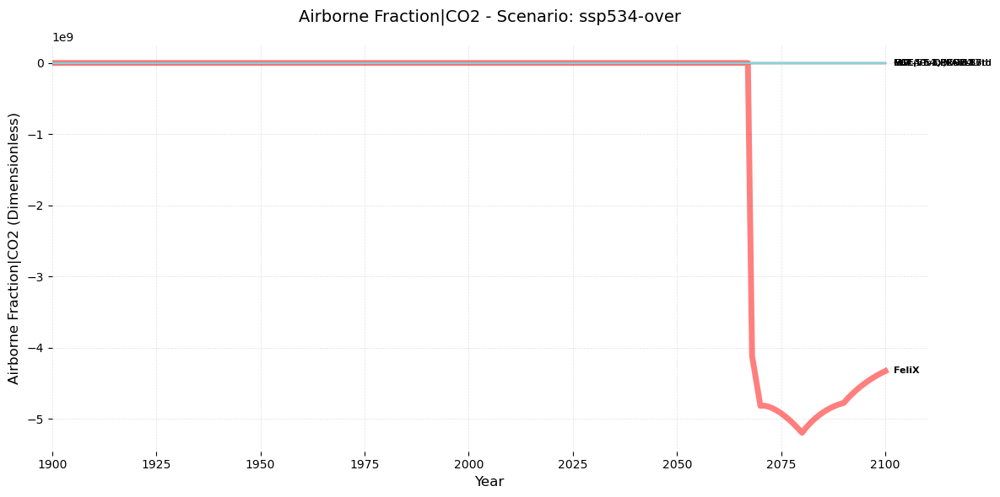

Original data shape: (11371, 1625)
After variable filtering: (762, 1625)
After scenario filtering: (12, 1625)
After region filtering: (12, 1625)
After year range filtering: (12, 206)
After excluding models: (12, 206)


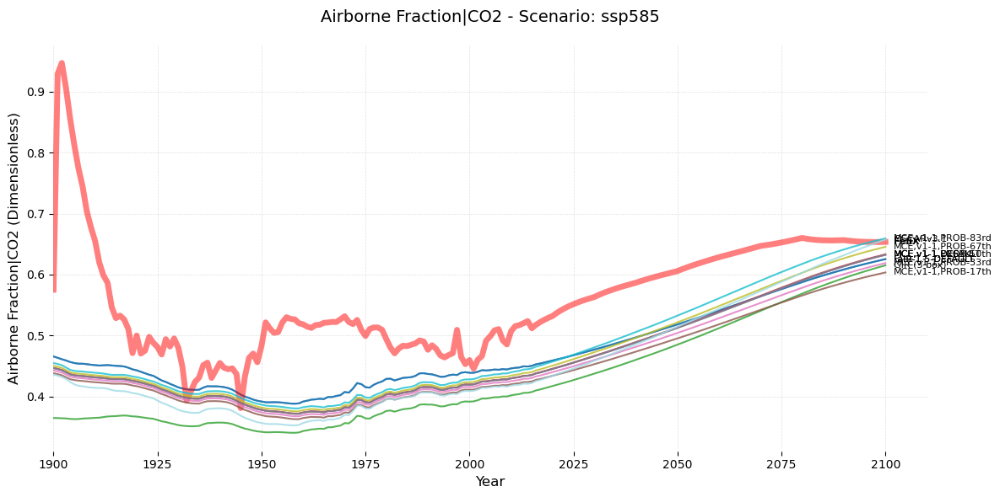

Original data shape: (11371, 1625)
After variable filtering: (762, 1625)
After scenario filtering: (5, 1625)
After region filtering: (5, 1625)
After year range filtering: (5, 206)
After excluding models: (5, 206)


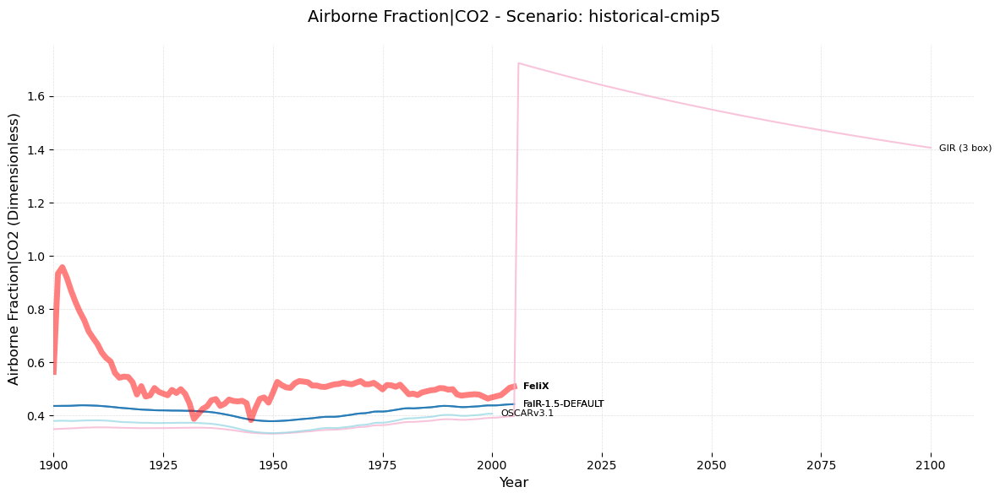

Original data shape: (11371, 1625)
After variable filtering: (801, 1625)
After scenario filtering: (12, 1625)
After region filtering: (12, 1625)
After year range filtering: (12, 206)
After excluding models: (12, 206)


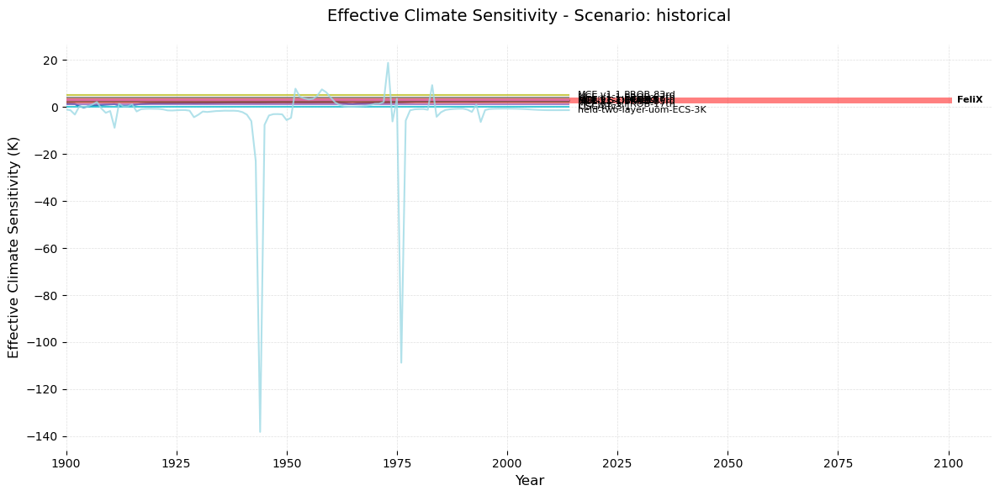

Original data shape: (11371, 1625)
After variable filtering: (801, 1625)
After scenario filtering: (4, 1625)
After region filtering: (4, 1625)
After year range filtering: (4, 206)
After excluding models: (4, 206)


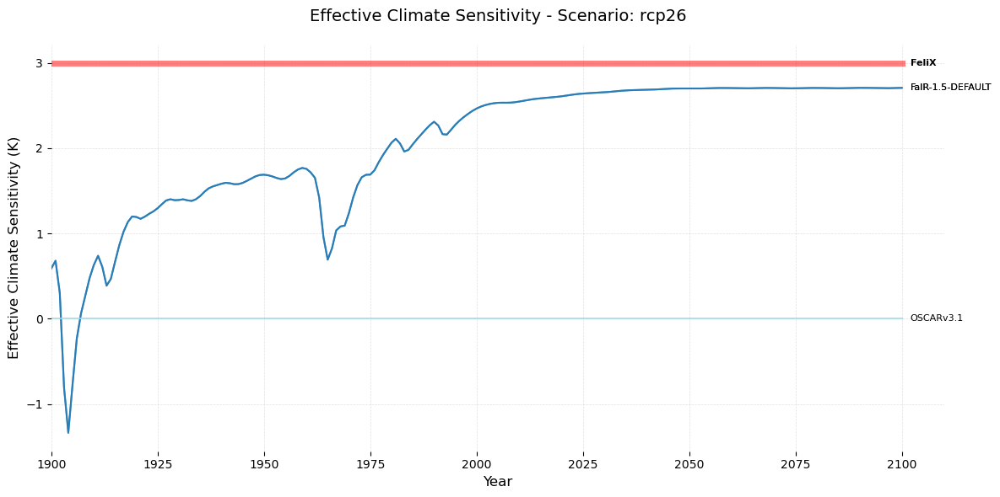

Original data shape: (11371, 1625)
After variable filtering: (801, 1625)
After scenario filtering: (4, 1625)
After region filtering: (4, 1625)
After year range filtering: (4, 206)
After excluding models: (4, 206)


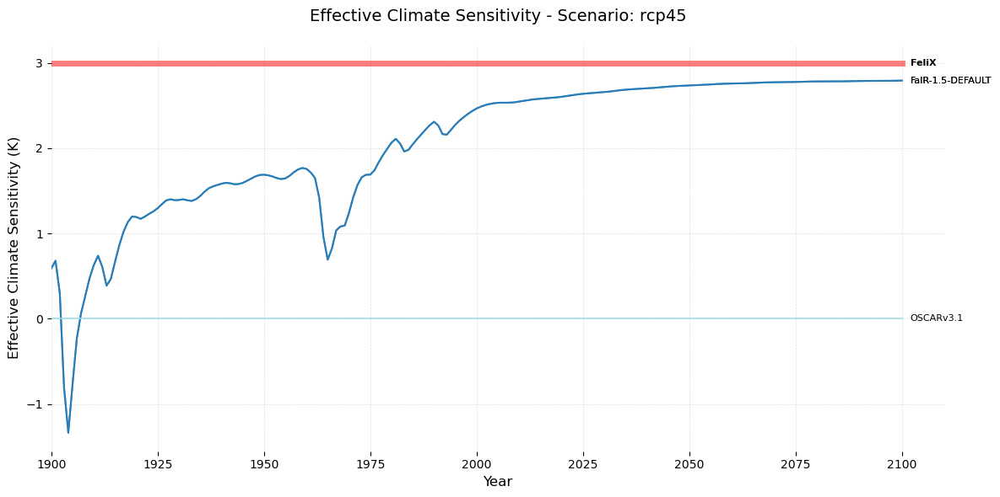

Original data shape: (11371, 1625)
After variable filtering: (801, 1625)
After scenario filtering: (4, 1625)
After region filtering: (4, 1625)
After year range filtering: (4, 206)
After excluding models: (4, 206)


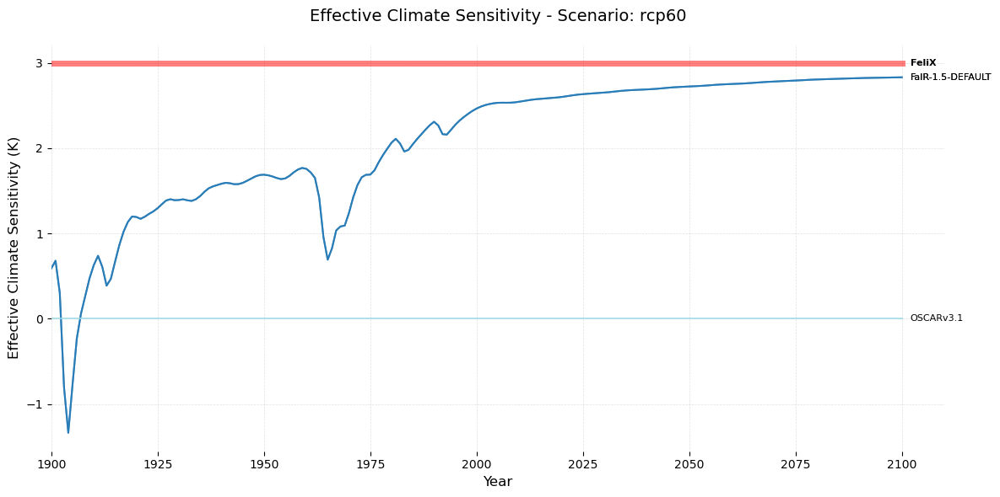

Original data shape: (11371, 1625)
After variable filtering: (801, 1625)
After scenario filtering: (4, 1625)
After region filtering: (4, 1625)
After year range filtering: (4, 206)
After excluding models: (4, 206)


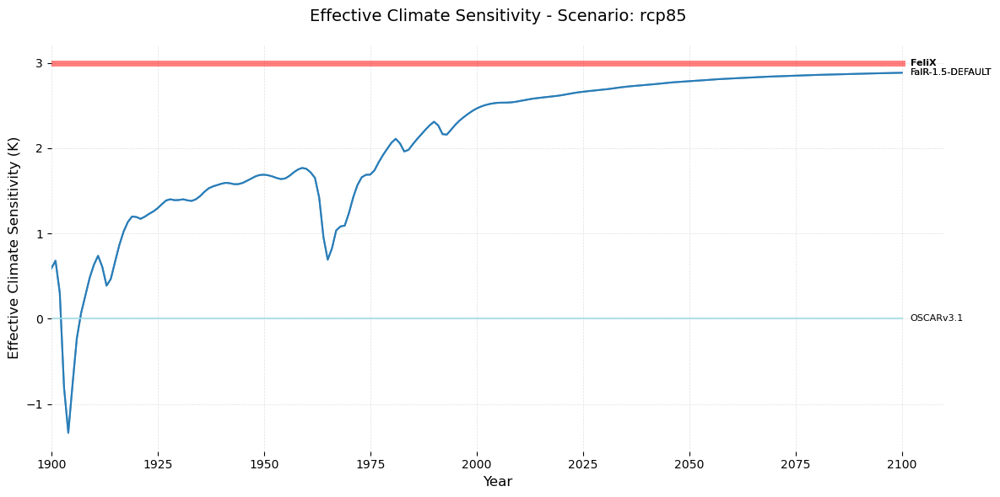

Original data shape: (11371, 1625)
After variable filtering: (801, 1625)
After scenario filtering: (12, 1625)
After region filtering: (12, 1625)
After year range filtering: (12, 206)
After excluding models: (12, 206)


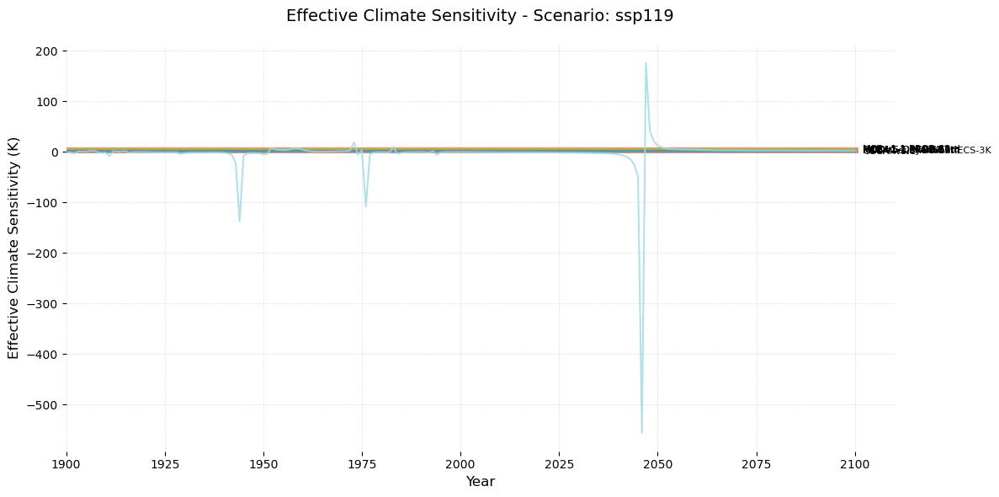

Original data shape: (11371, 1625)
After variable filtering: (801, 1625)
After scenario filtering: (12, 1625)
After region filtering: (12, 1625)
After year range filtering: (12, 206)
After excluding models: (12, 206)


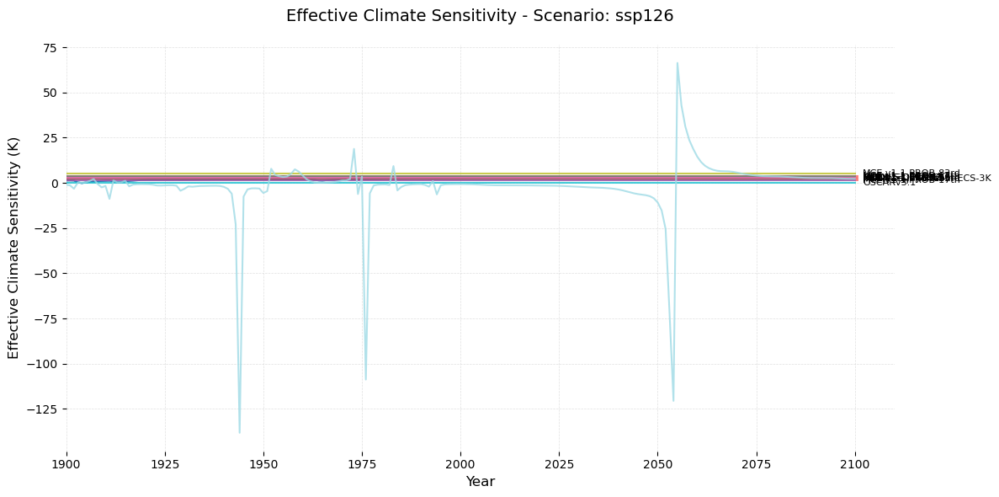

Original data shape: (11371, 1625)
After variable filtering: (801, 1625)
After scenario filtering: (12, 1625)
After region filtering: (12, 1625)
After year range filtering: (12, 206)
After excluding models: (12, 206)


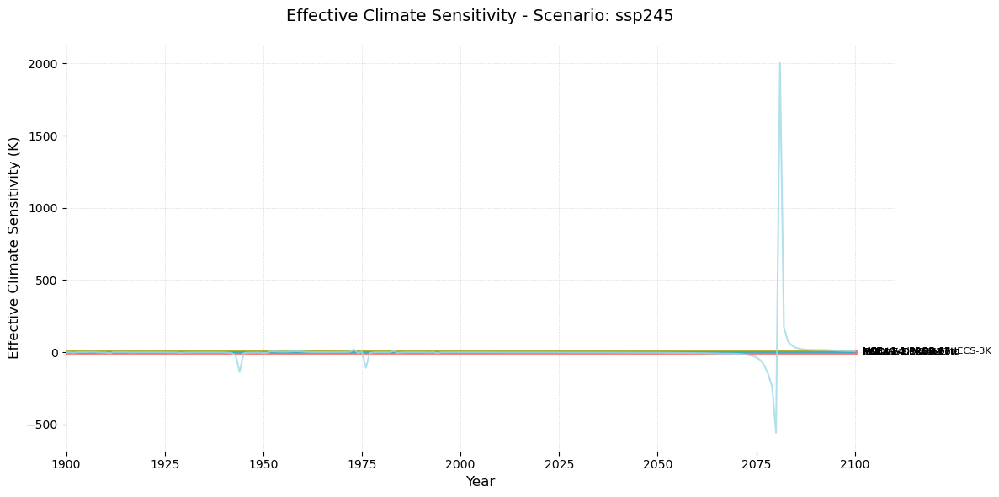

Original data shape: (11371, 1625)
After variable filtering: (801, 1625)
After scenario filtering: (12, 1625)
After region filtering: (12, 1625)
After year range filtering: (12, 206)
After excluding models: (12, 206)


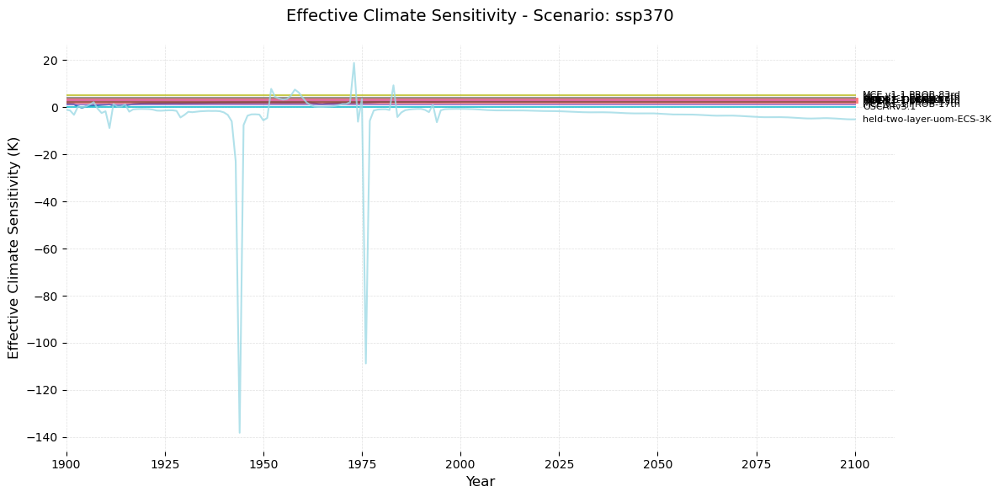

Original data shape: (11371, 1625)
After variable filtering: (801, 1625)
After scenario filtering: (11, 1625)
After region filtering: (11, 1625)
After year range filtering: (11, 206)
After excluding models: (11, 206)


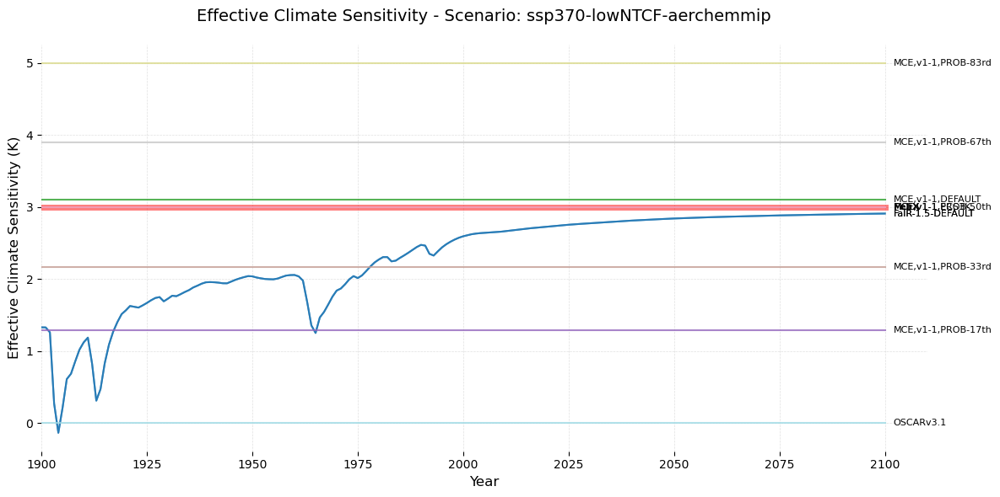

Original data shape: (11371, 1625)
After variable filtering: (801, 1625)
After scenario filtering: (9, 1625)
After region filtering: (9, 1625)
After year range filtering: (9, 206)
After excluding models: (9, 206)


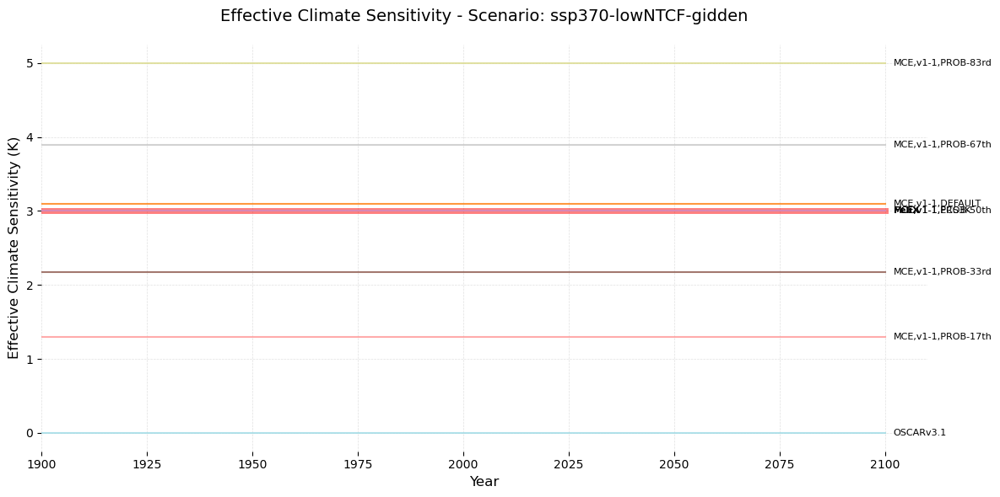

Original data shape: (11371, 1625)
After variable filtering: (801, 1625)
After scenario filtering: (12, 1625)
After region filtering: (12, 1625)
After year range filtering: (12, 206)
After excluding models: (12, 206)


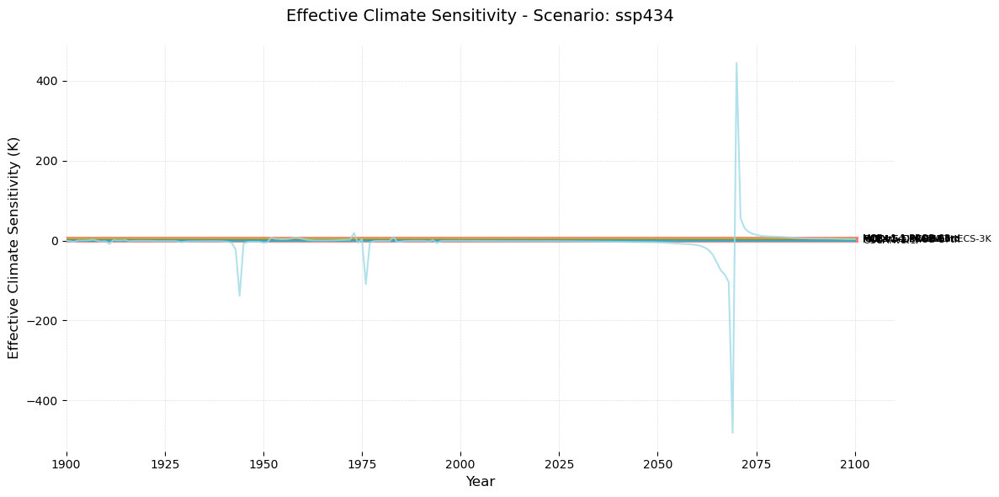

Original data shape: (11371, 1625)
After variable filtering: (801, 1625)
After scenario filtering: (12, 1625)
After region filtering: (12, 1625)
After year range filtering: (12, 206)
After excluding models: (12, 206)


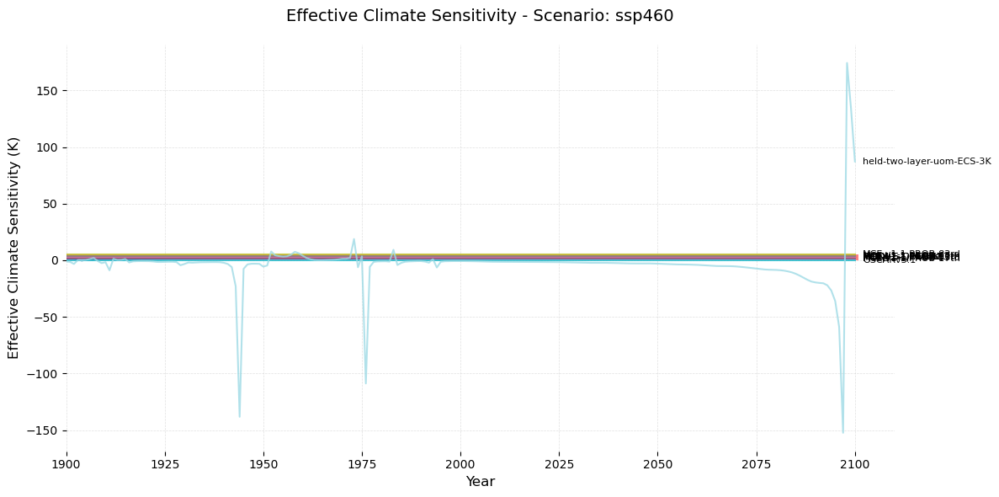

Original data shape: (11371, 1625)
After variable filtering: (801, 1625)
After scenario filtering: (12, 1625)
After region filtering: (12, 1625)
After year range filtering: (12, 206)
After excluding models: (12, 206)


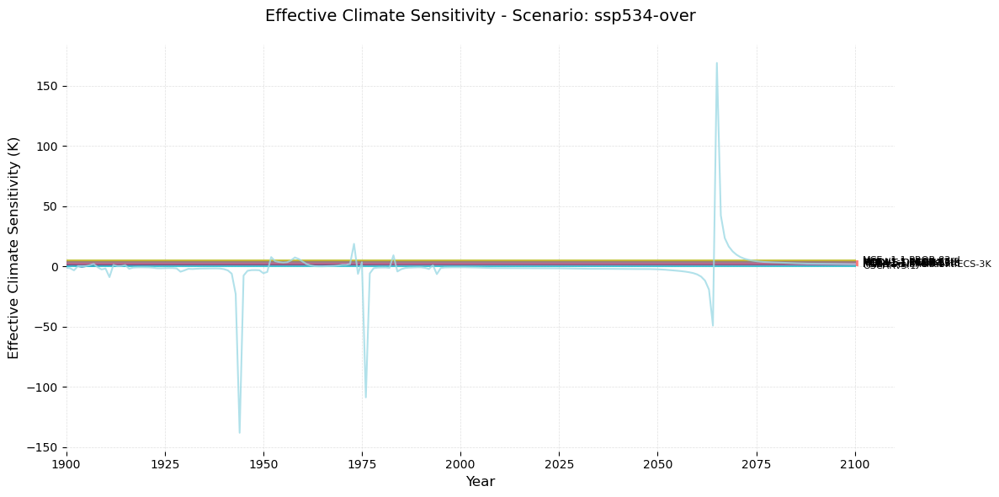

Original data shape: (11371, 1625)
After variable filtering: (801, 1625)
After scenario filtering: (12, 1625)
After region filtering: (12, 1625)
After year range filtering: (12, 206)
After excluding models: (12, 206)


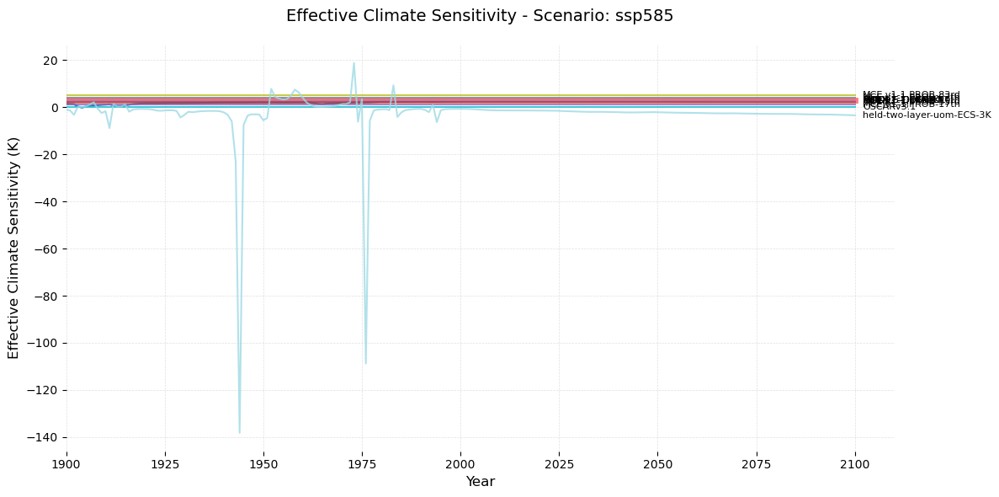

Original data shape: (11371, 1625)
After variable filtering: (801, 1625)
After scenario filtering: (4, 1625)
After region filtering: (4, 1625)
After year range filtering: (4, 206)
After excluding models: (4, 206)


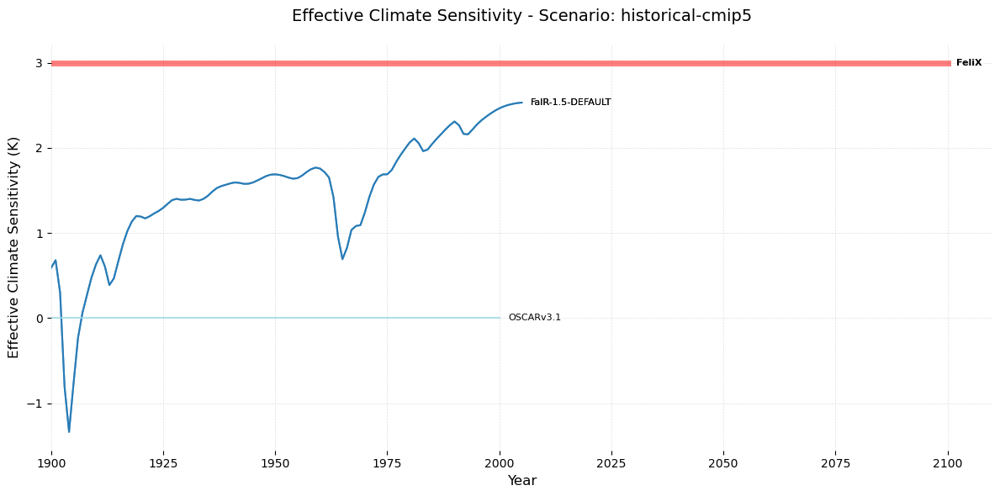

Original data shape: (11371, 1625)
After variable filtering: (801, 1625)
After scenario filtering: (12, 1625)
After region filtering: (12, 1625)
After year range filtering: (12, 206)
After excluding models: (12, 206)


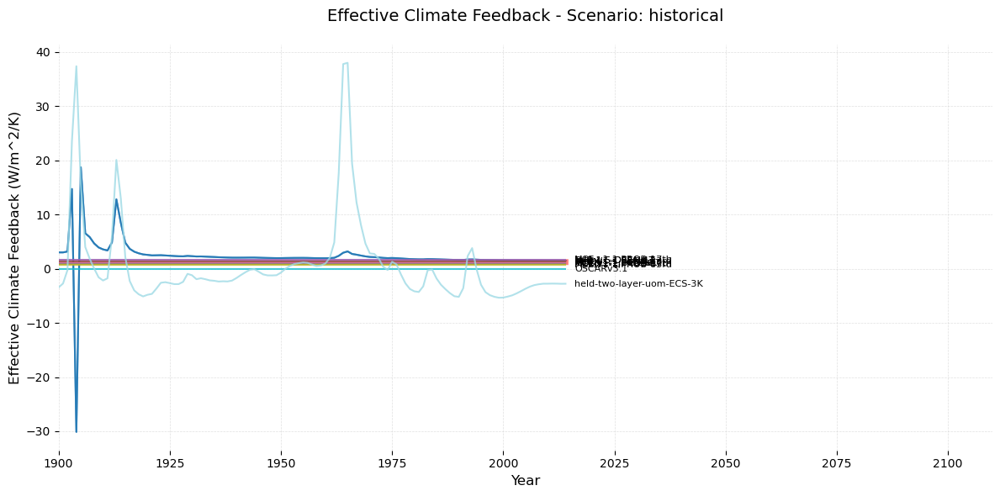

Original data shape: (11371, 1625)
After variable filtering: (801, 1625)
After scenario filtering: (4, 1625)
After region filtering: (4, 1625)
After year range filtering: (4, 206)
After excluding models: (4, 206)


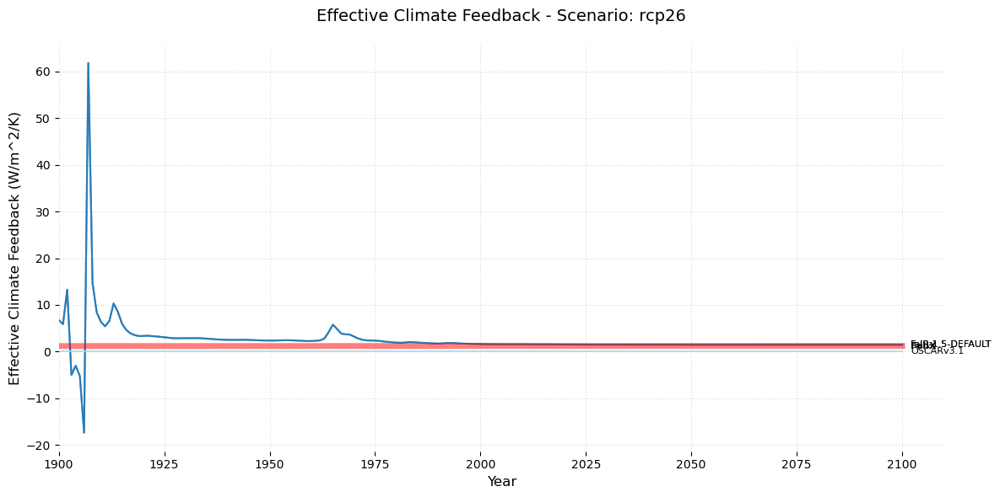

Original data shape: (11371, 1625)
After variable filtering: (801, 1625)
After scenario filtering: (4, 1625)
After region filtering: (4, 1625)
After year range filtering: (4, 206)
After excluding models: (4, 206)


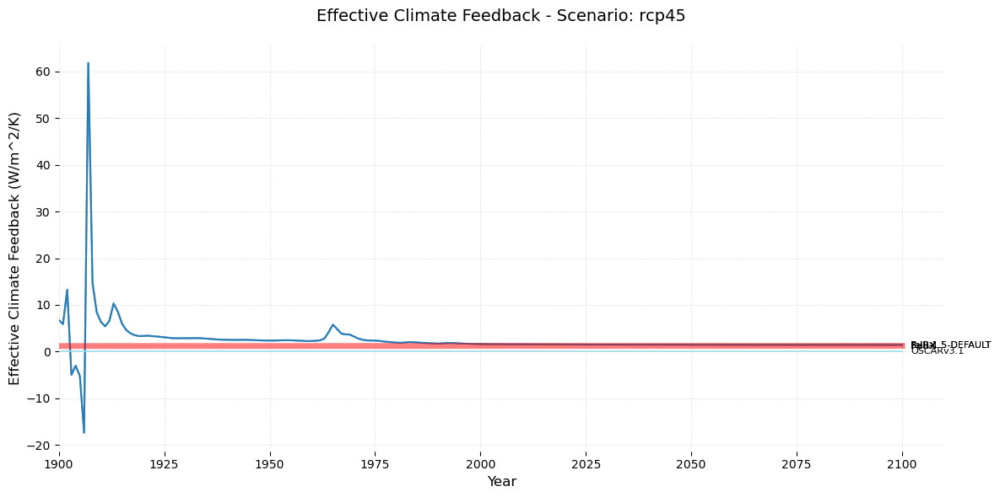

Original data shape: (11371, 1625)
After variable filtering: (801, 1625)
After scenario filtering: (4, 1625)
After region filtering: (4, 1625)
After year range filtering: (4, 206)
After excluding models: (4, 206)


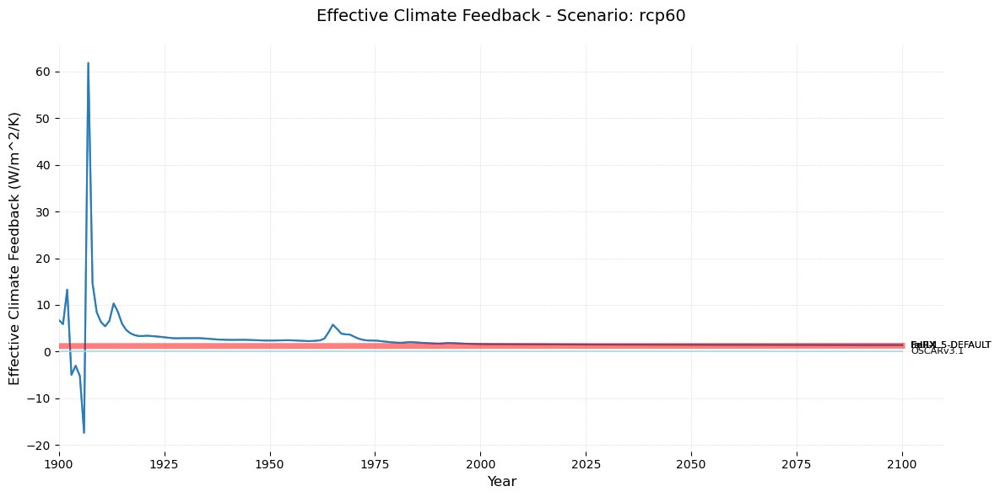

Original data shape: (11371, 1625)
After variable filtering: (801, 1625)
After scenario filtering: (4, 1625)
After region filtering: (4, 1625)
After year range filtering: (4, 206)
After excluding models: (4, 206)


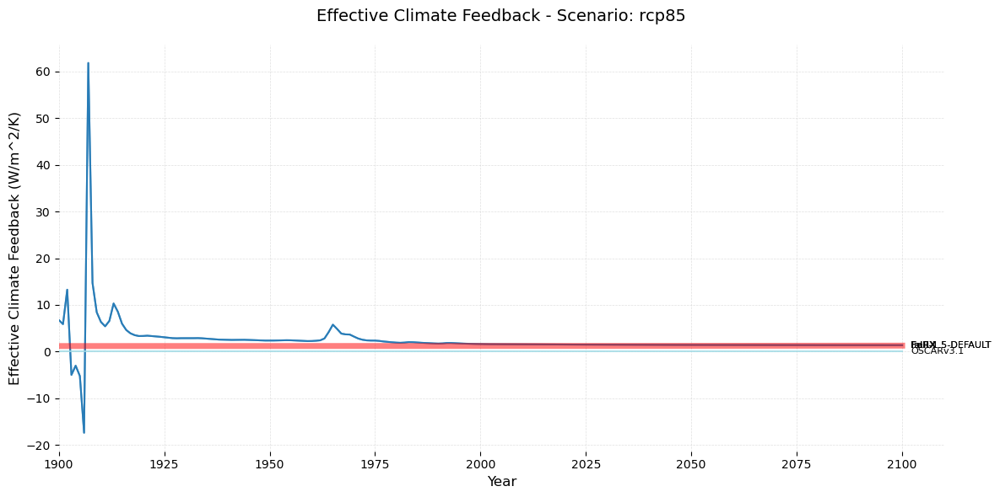

Original data shape: (11371, 1625)
After variable filtering: (801, 1625)
After scenario filtering: (12, 1625)
After region filtering: (12, 1625)
After year range filtering: (12, 206)
After excluding models: (12, 206)


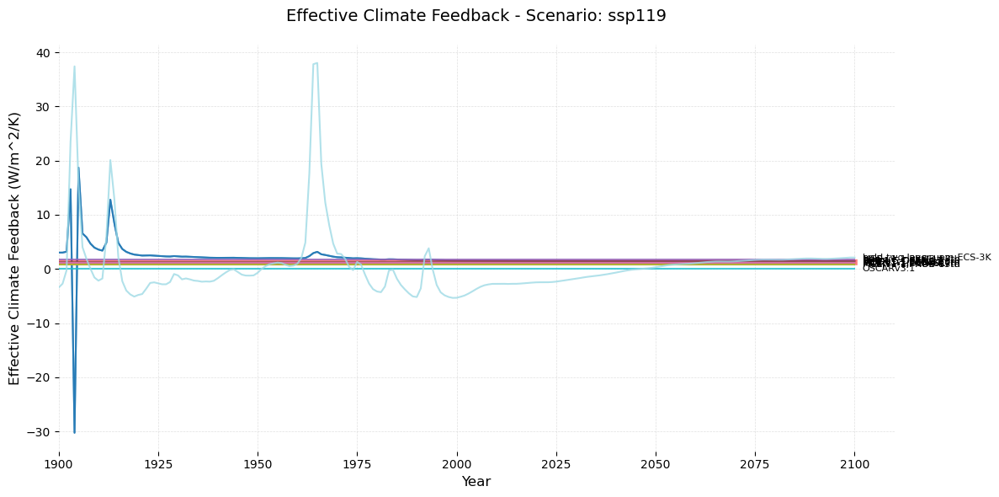

Original data shape: (11371, 1625)
After variable filtering: (801, 1625)
After scenario filtering: (12, 1625)
After region filtering: (12, 1625)
After year range filtering: (12, 206)
After excluding models: (12, 206)


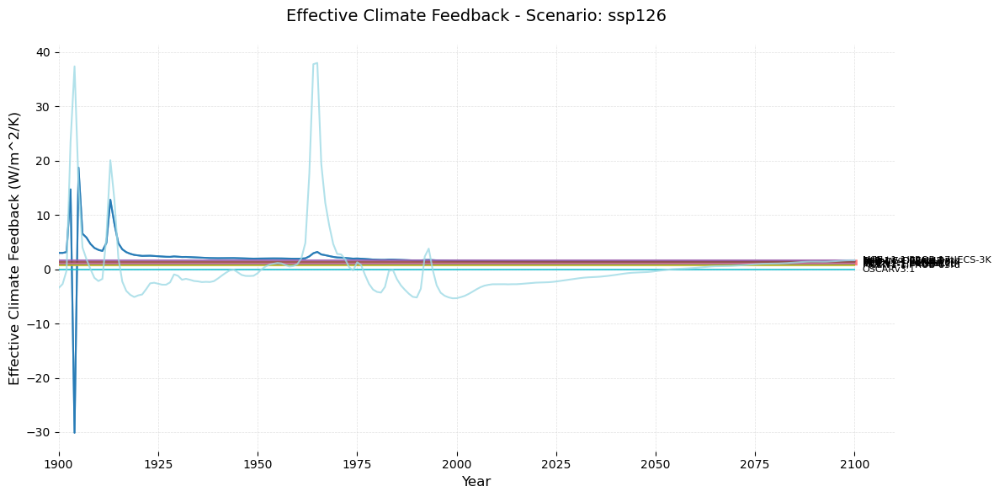

Original data shape: (11371, 1625)
After variable filtering: (801, 1625)
After scenario filtering: (12, 1625)
After region filtering: (12, 1625)
After year range filtering: (12, 206)
After excluding models: (12, 206)


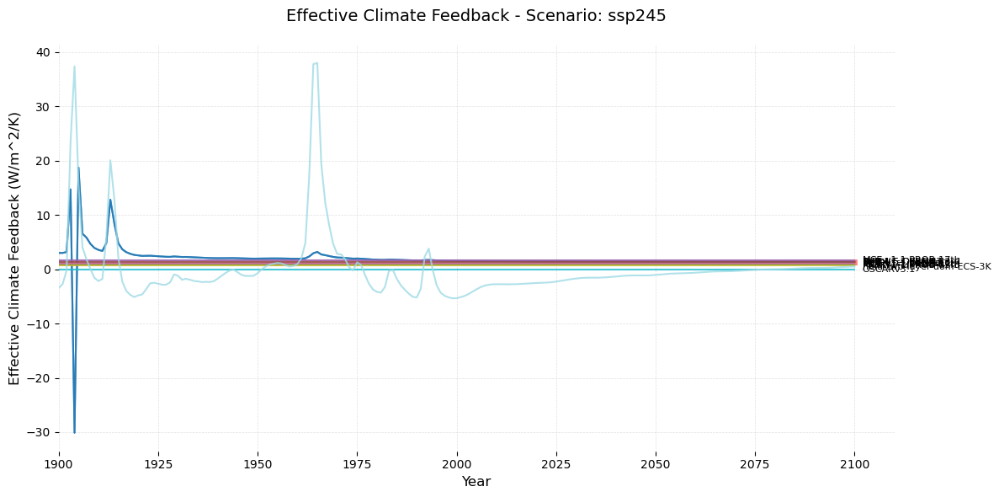

Original data shape: (11371, 1625)
After variable filtering: (801, 1625)
After scenario filtering: (12, 1625)
After region filtering: (12, 1625)
After year range filtering: (12, 206)
After excluding models: (12, 206)


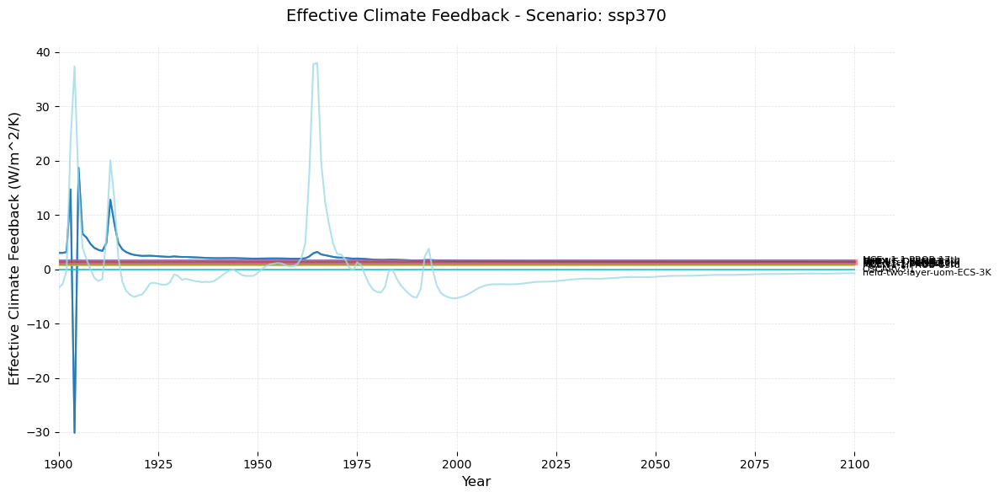

Original data shape: (11371, 1625)
After variable filtering: (801, 1625)
After scenario filtering: (11, 1625)
After region filtering: (11, 1625)
After year range filtering: (11, 206)
After excluding models: (11, 206)


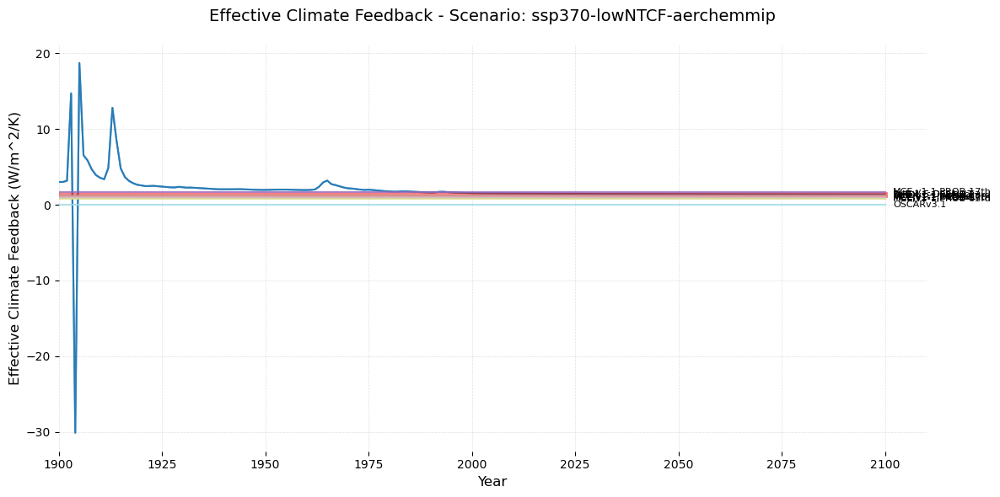

Original data shape: (11371, 1625)
After variable filtering: (801, 1625)
After scenario filtering: (9, 1625)
After region filtering: (9, 1625)
After year range filtering: (9, 206)
After excluding models: (9, 206)


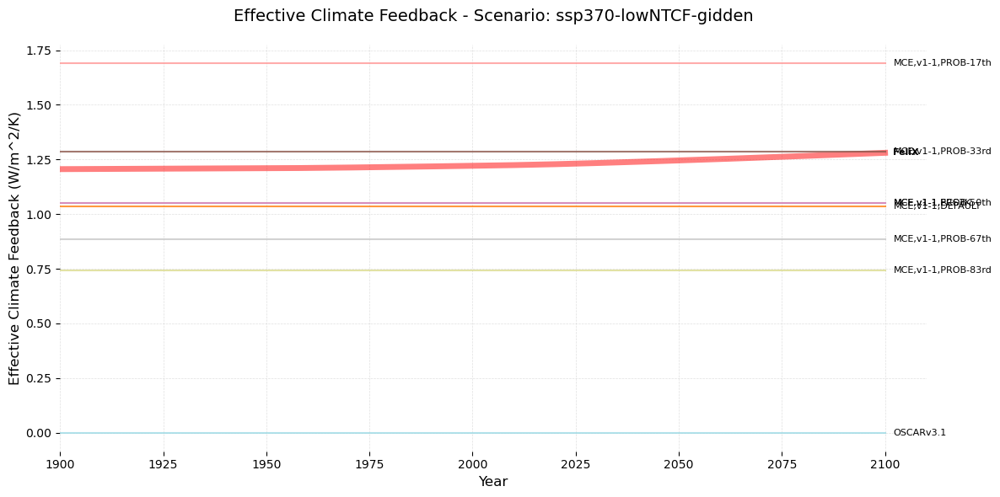

Original data shape: (11371, 1625)
After variable filtering: (801, 1625)
After scenario filtering: (12, 1625)
After region filtering: (12, 1625)
After year range filtering: (12, 206)
After excluding models: (12, 206)


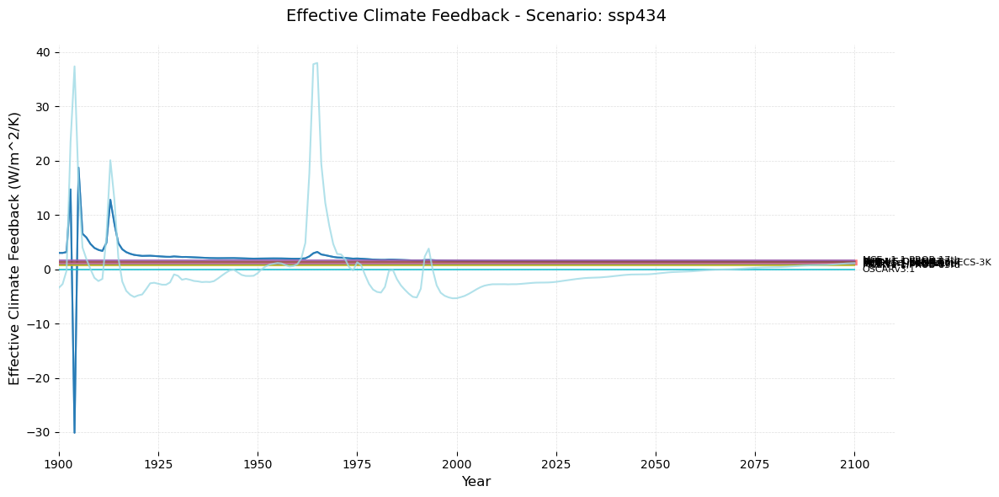

Original data shape: (11371, 1625)
After variable filtering: (801, 1625)
After scenario filtering: (12, 1625)
After region filtering: (12, 1625)
After year range filtering: (12, 206)
After excluding models: (12, 206)


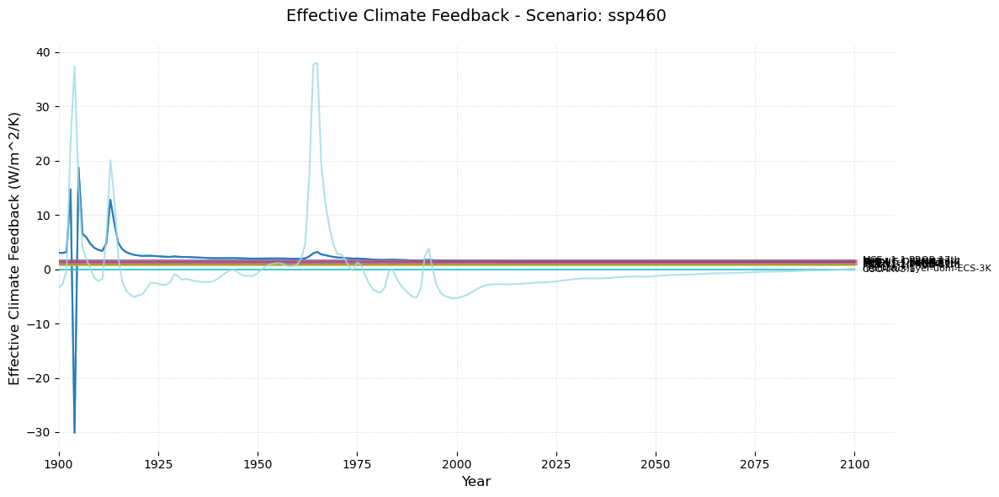

Original data shape: (11371, 1625)
After variable filtering: (801, 1625)
After scenario filtering: (12, 1625)
After region filtering: (12, 1625)
After year range filtering: (12, 206)
After excluding models: (12, 206)


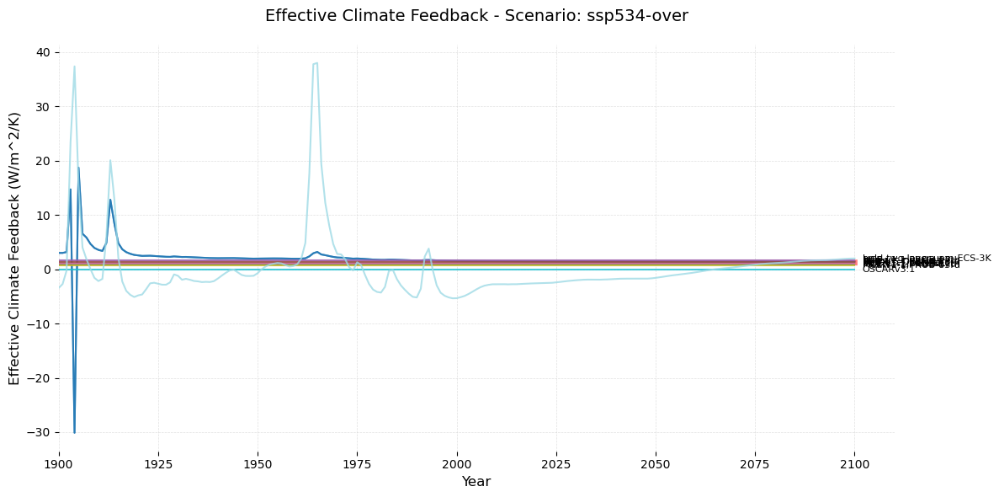

Original data shape: (11371, 1625)
After variable filtering: (801, 1625)
After scenario filtering: (12, 1625)
After region filtering: (12, 1625)
After year range filtering: (12, 206)
After excluding models: (12, 206)


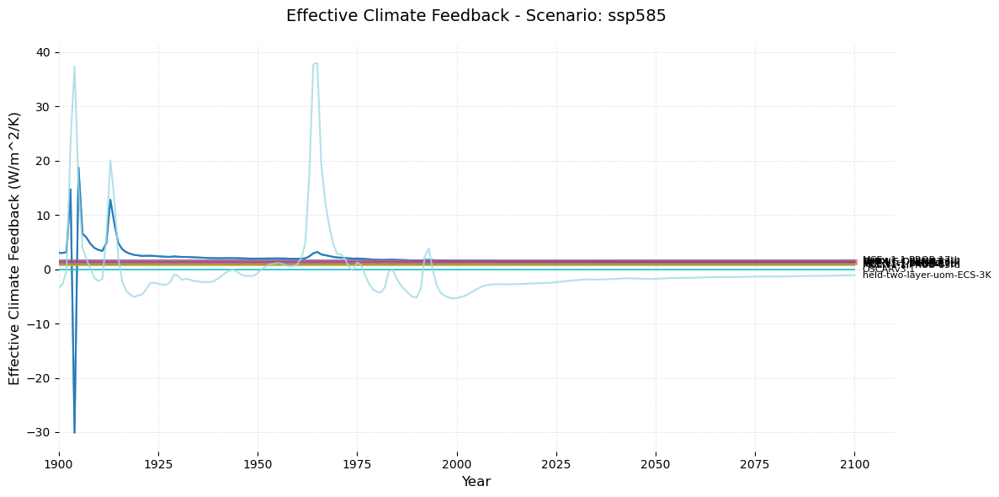

Original data shape: (11371, 1625)
After variable filtering: (801, 1625)
After scenario filtering: (4, 1625)
After region filtering: (4, 1625)
After year range filtering: (4, 206)
After excluding models: (4, 206)


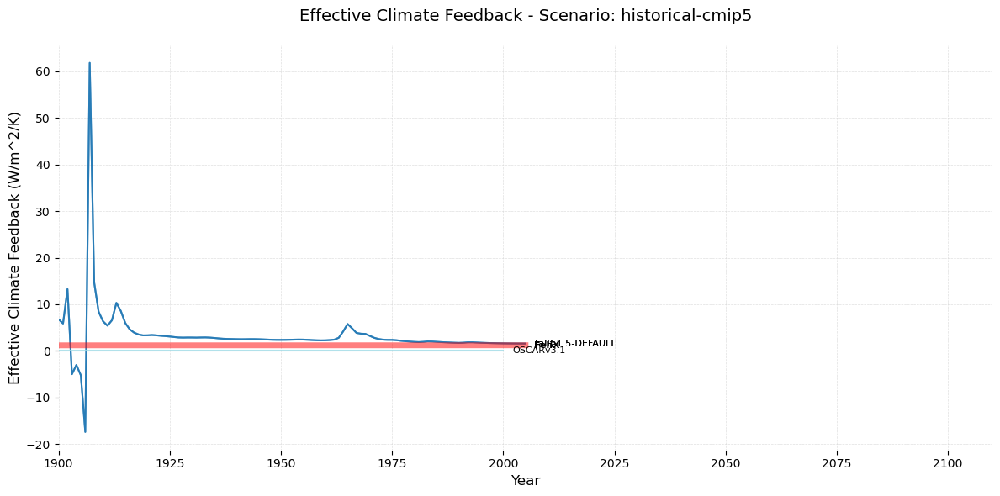

Original data shape: (11371, 1625)
After variable filtering: (922, 1625)
After scenario filtering: (13, 1625)
After region filtering: (13, 1625)
After year range filtering: (13, 206)
After excluding models: (13, 206)


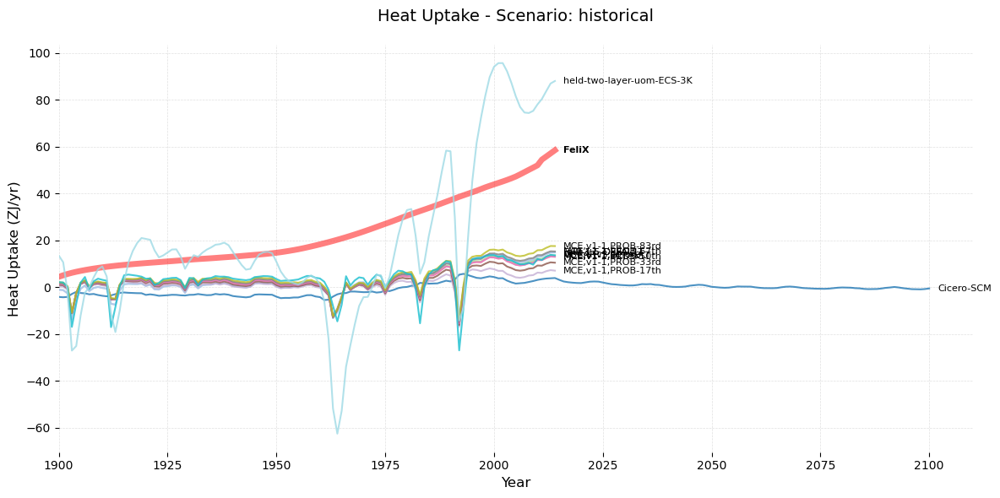

Original data shape: (11371, 1625)
After variable filtering: (922, 1625)
After scenario filtering: (6, 1625)
After region filtering: (6, 1625)
After year range filtering: (6, 206)
After excluding models: (6, 206)


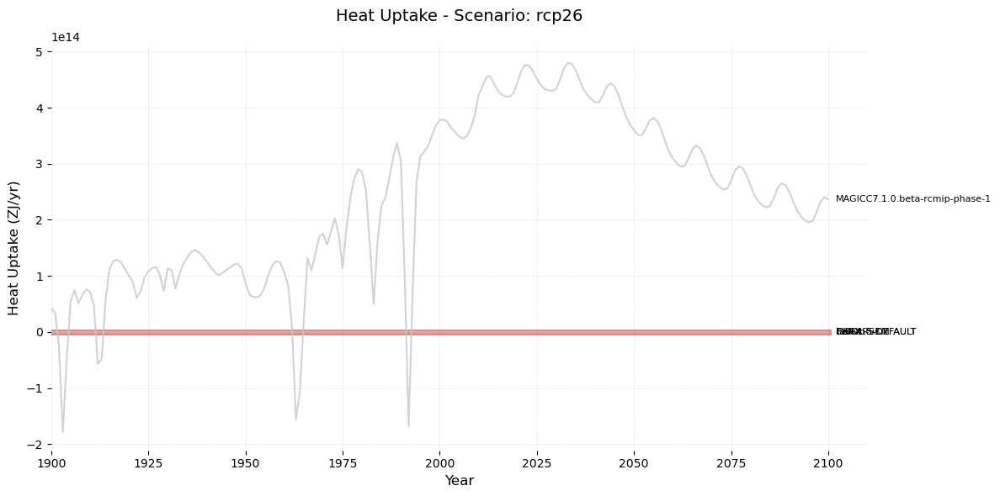

Original data shape: (11371, 1625)
After variable filtering: (922, 1625)
After scenario filtering: (6, 1625)
After region filtering: (6, 1625)
After year range filtering: (6, 206)
After excluding models: (6, 206)


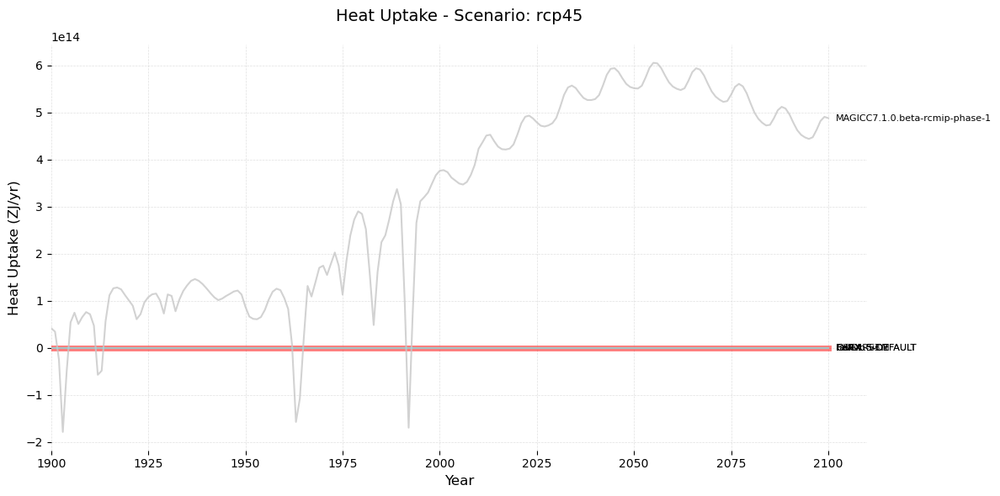

Original data shape: (11371, 1625)
After variable filtering: (922, 1625)
After scenario filtering: (6, 1625)
After region filtering: (6, 1625)
After year range filtering: (6, 206)
After excluding models: (6, 206)


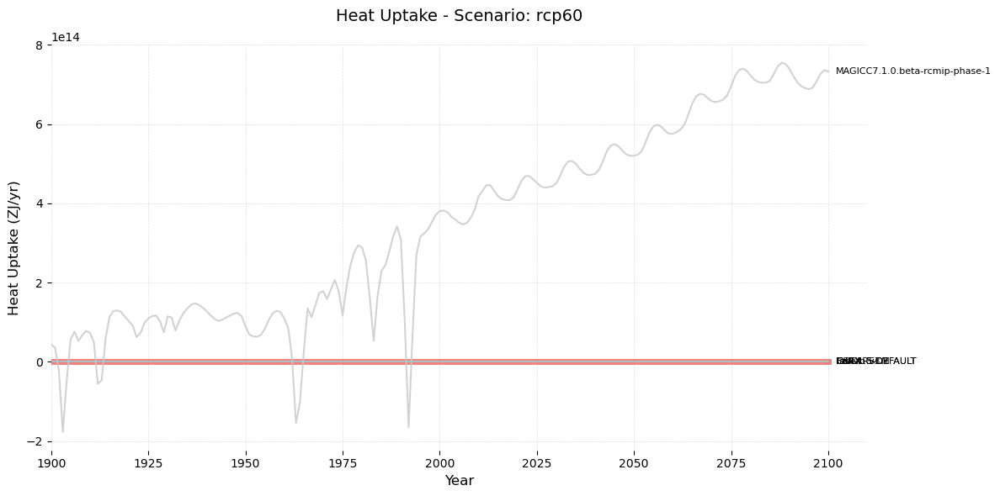

Original data shape: (11371, 1625)
After variable filtering: (922, 1625)
After scenario filtering: (6, 1625)
After region filtering: (6, 1625)
After year range filtering: (6, 206)
After excluding models: (6, 206)


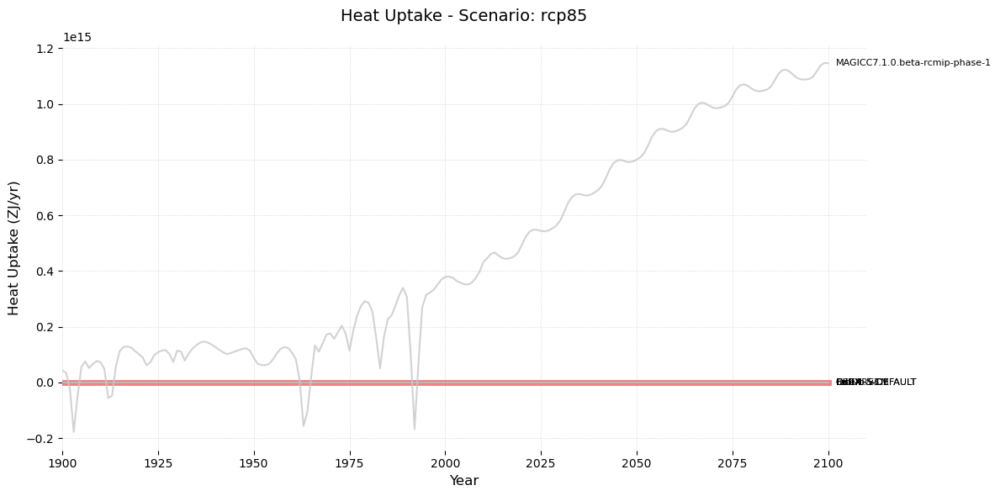

Original data shape: (11371, 1625)
After variable filtering: (922, 1625)
After scenario filtering: (14, 1625)
After region filtering: (14, 1625)
After year range filtering: (14, 206)
After excluding models: (14, 206)


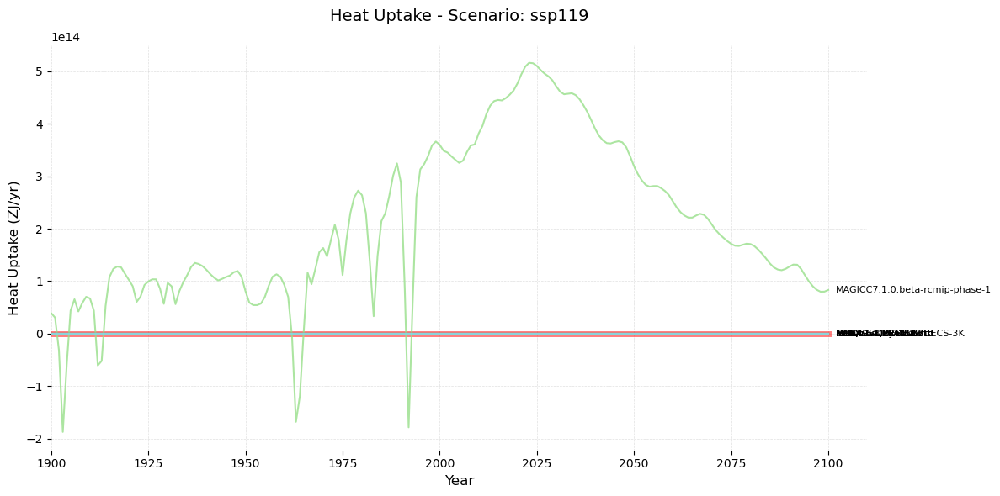

Original data shape: (11371, 1625)
After variable filtering: (922, 1625)
After scenario filtering: (14, 1625)
After region filtering: (14, 1625)
After year range filtering: (14, 206)
After excluding models: (14, 206)


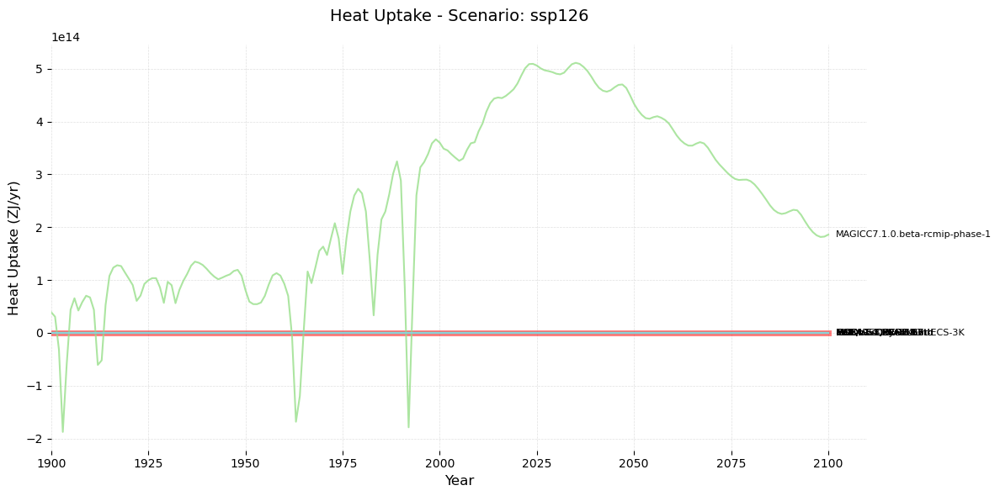

Original data shape: (11371, 1625)
After variable filtering: (922, 1625)
After scenario filtering: (14, 1625)
After region filtering: (14, 1625)
After year range filtering: (14, 206)
After excluding models: (14, 206)


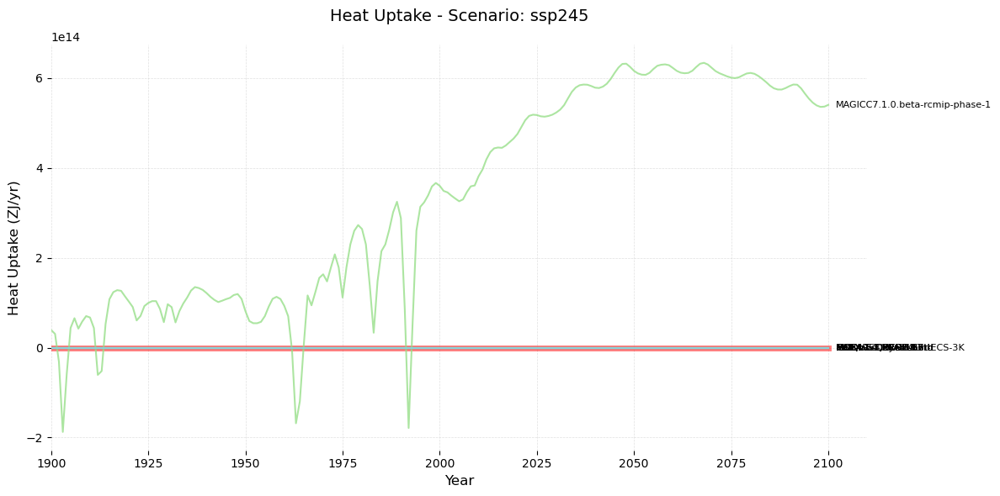

Original data shape: (11371, 1625)
After variable filtering: (922, 1625)
After scenario filtering: (14, 1625)
After region filtering: (14, 1625)
After year range filtering: (14, 206)
After excluding models: (14, 206)


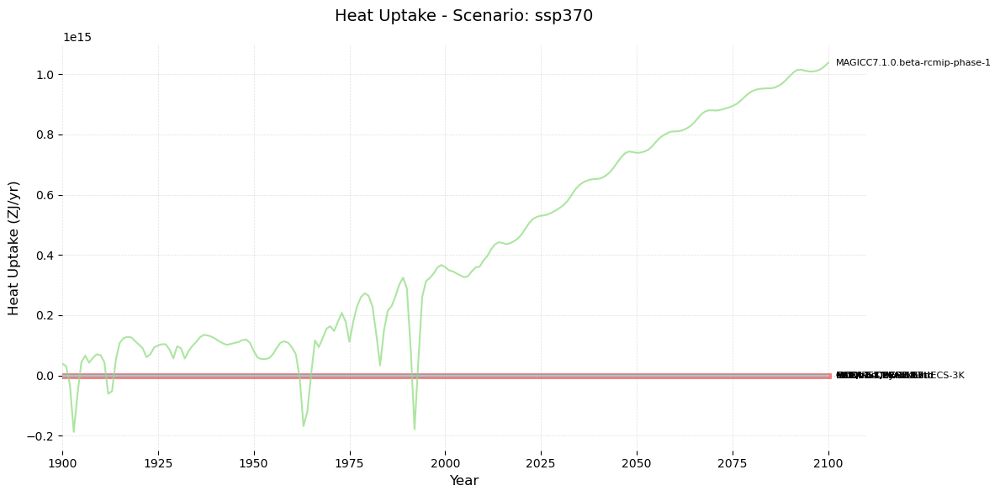

Original data shape: (11371, 1625)
After variable filtering: (922, 1625)
After scenario filtering: (13, 1625)
After region filtering: (13, 1625)
After year range filtering: (13, 206)
After excluding models: (13, 206)


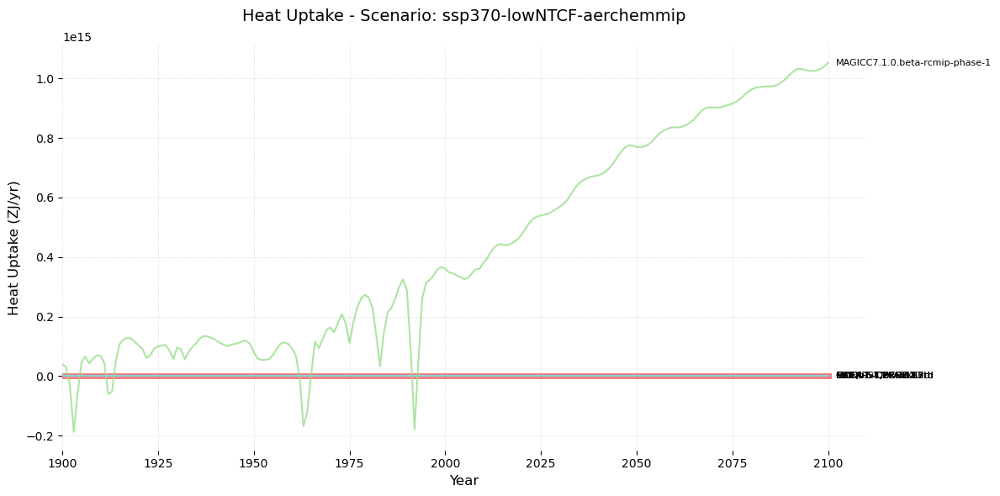

Original data shape: (11371, 1625)
After variable filtering: (922, 1625)
After scenario filtering: (11, 1625)
After region filtering: (11, 1625)
After year range filtering: (11, 206)
After excluding models: (11, 206)


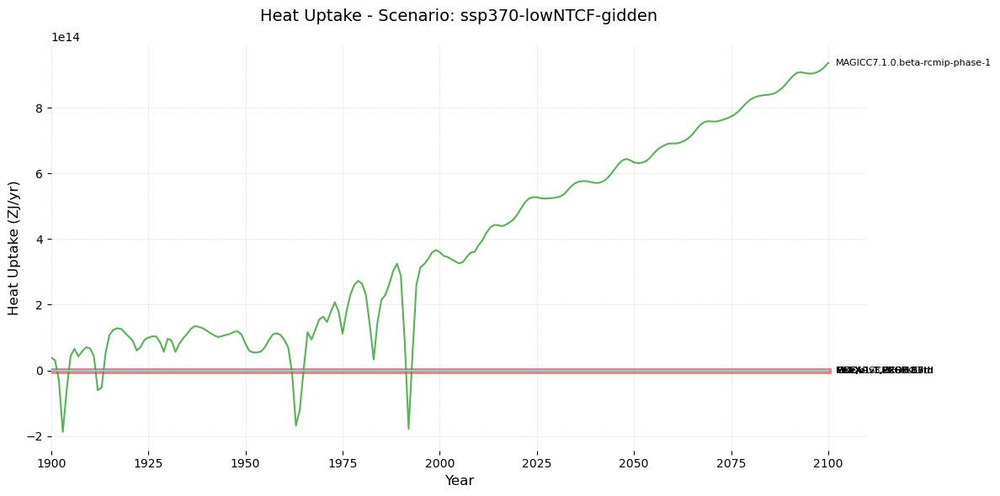

Original data shape: (11371, 1625)
After variable filtering: (922, 1625)
After scenario filtering: (14, 1625)
After region filtering: (14, 1625)
After year range filtering: (14, 206)
After excluding models: (14, 206)


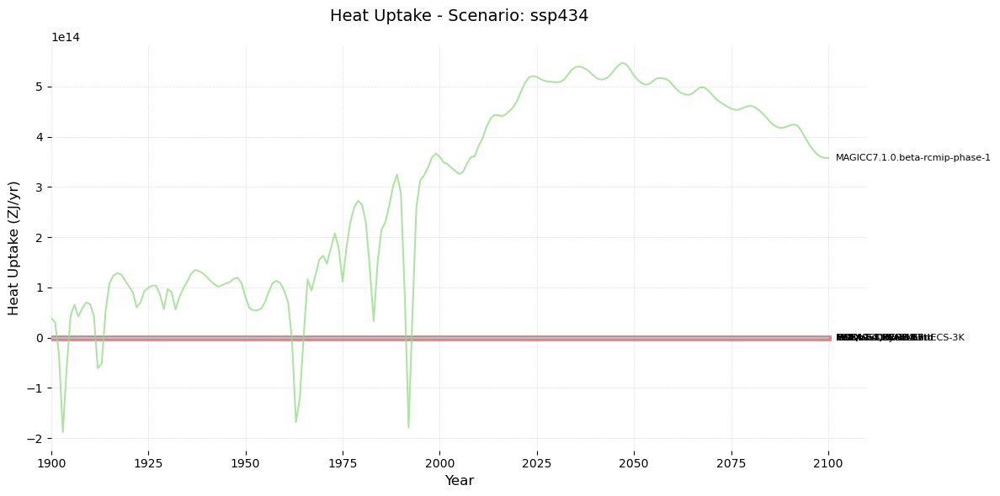

Original data shape: (11371, 1625)
After variable filtering: (922, 1625)
After scenario filtering: (14, 1625)
After region filtering: (14, 1625)
After year range filtering: (14, 206)
After excluding models: (14, 206)


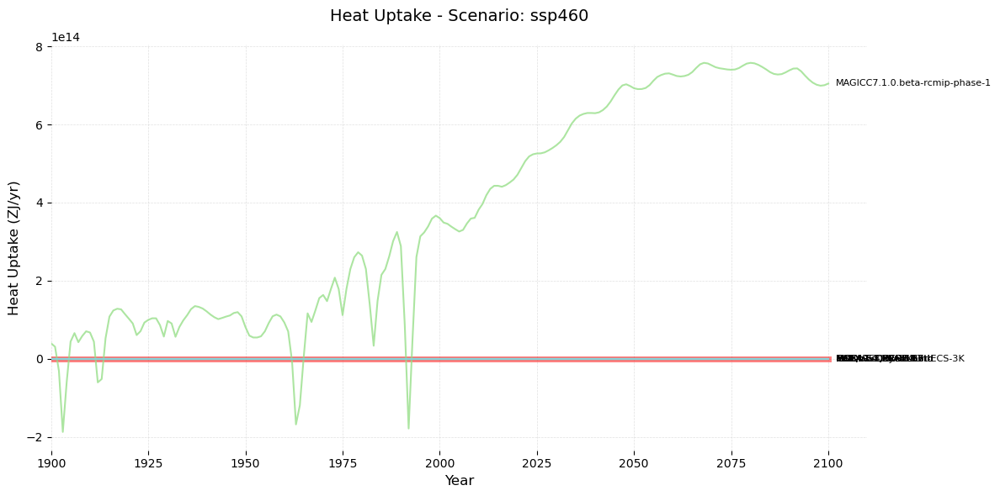

Original data shape: (11371, 1625)
After variable filtering: (922, 1625)
After scenario filtering: (14, 1625)
After region filtering: (14, 1625)
After year range filtering: (14, 206)
After excluding models: (14, 206)


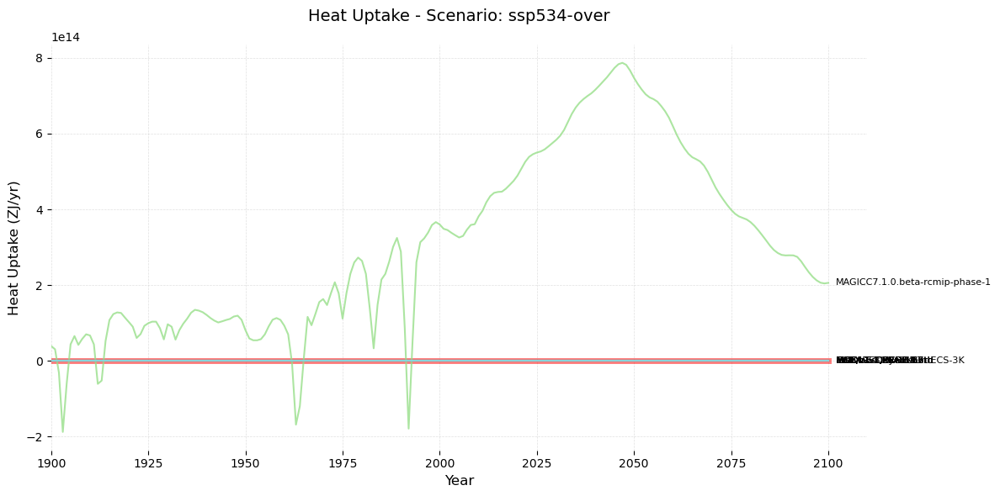

Original data shape: (11371, 1625)
After variable filtering: (922, 1625)
After scenario filtering: (14, 1625)
After region filtering: (14, 1625)
After year range filtering: (14, 206)
After excluding models: (14, 206)


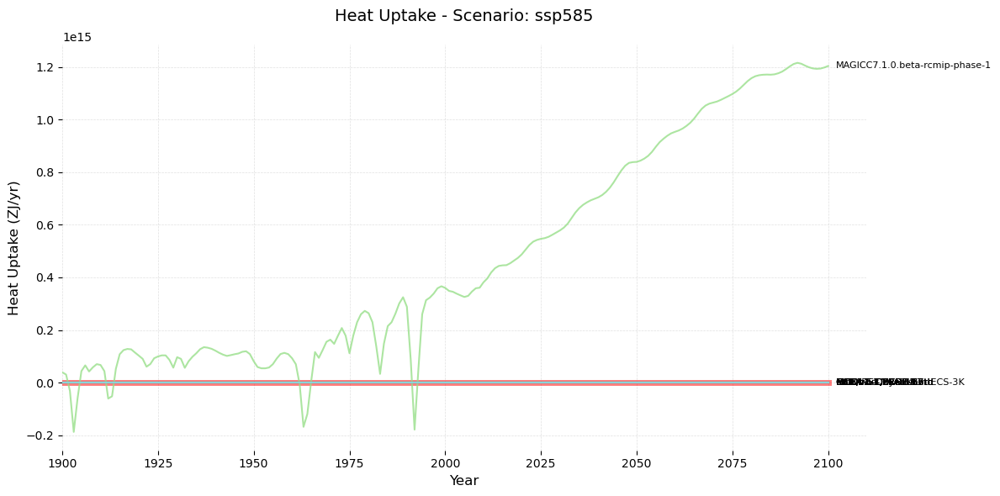

Original data shape: (11371, 1625)
After variable filtering: (922, 1625)
After scenario filtering: (4, 1625)
After region filtering: (4, 1625)
After year range filtering: (4, 206)
After excluding models: (4, 206)


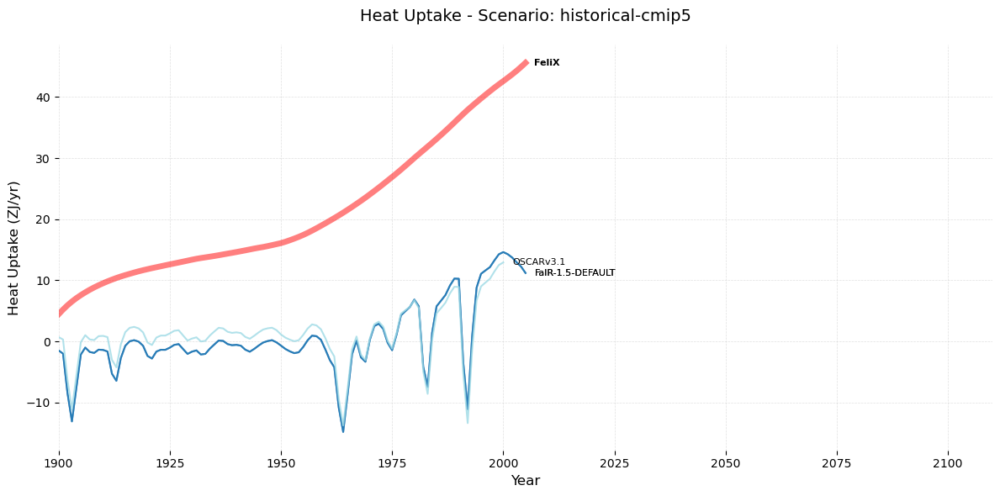

Original data shape: (11371, 1625)
After variable filtering: (623, 1625)
After scenario filtering: (10, 1625)
After region filtering: (10, 1625)
After year range filtering: (10, 206)
After excluding models: (10, 206)


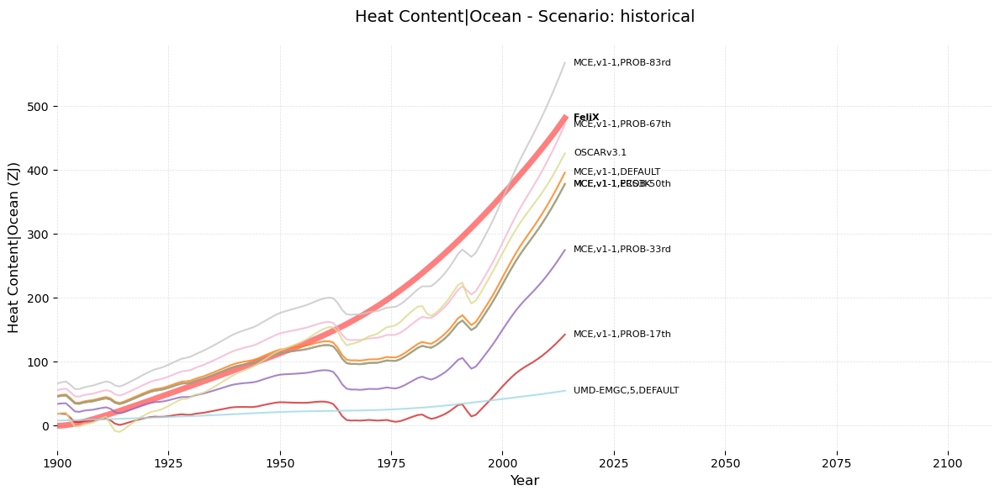

Original data shape: (11371, 1625)
After variable filtering: (623, 1625)
After scenario filtering: (3, 1625)
After region filtering: (3, 1625)
After year range filtering: (3, 206)
After excluding models: (3, 206)


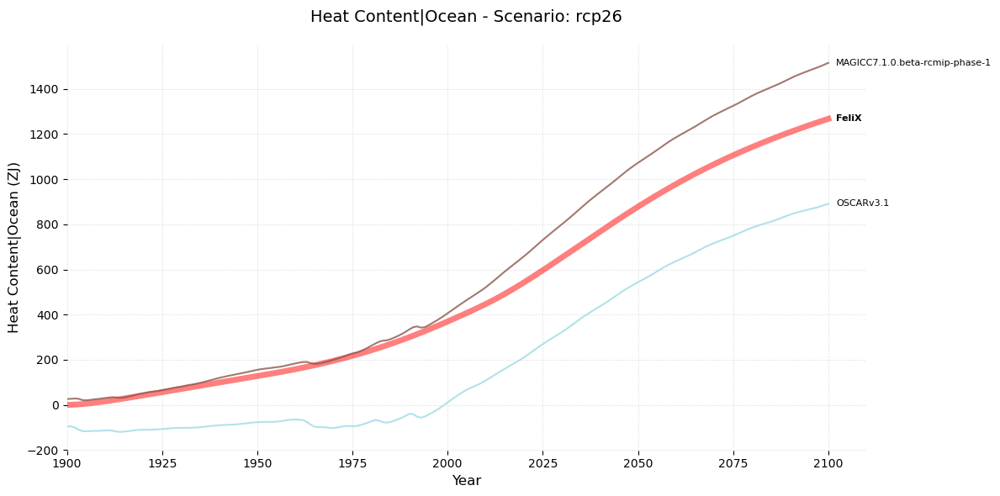

Original data shape: (11371, 1625)
After variable filtering: (623, 1625)
After scenario filtering: (3, 1625)
After region filtering: (3, 1625)
After year range filtering: (3, 206)
After excluding models: (3, 206)


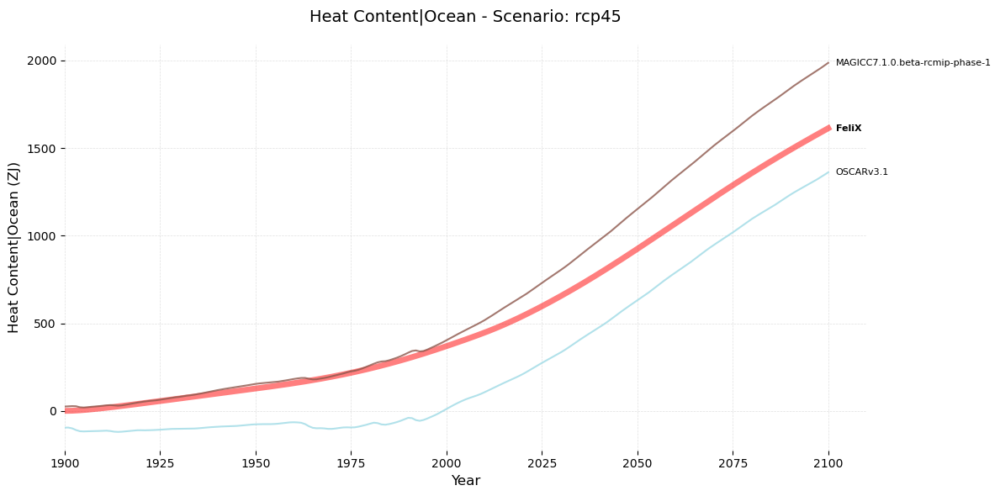

Original data shape: (11371, 1625)
After variable filtering: (623, 1625)
After scenario filtering: (3, 1625)
After region filtering: (3, 1625)
After year range filtering: (3, 206)
After excluding models: (3, 206)


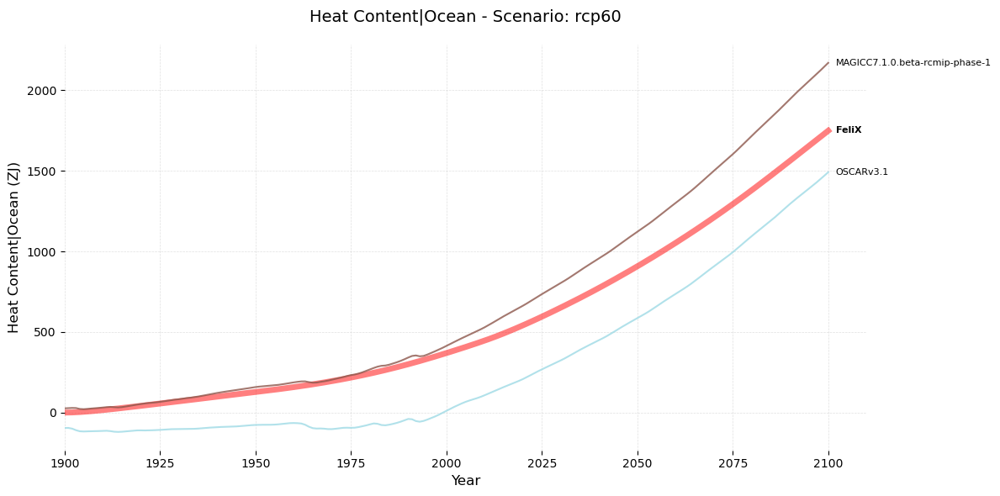

Original data shape: (11371, 1625)
After variable filtering: (623, 1625)
After scenario filtering: (3, 1625)
After region filtering: (3, 1625)
After year range filtering: (3, 206)
After excluding models: (3, 206)


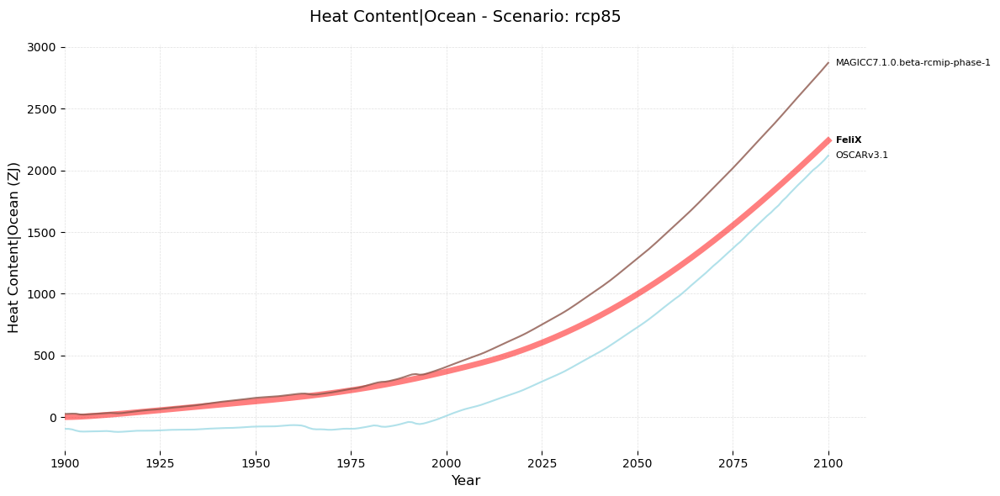

Original data shape: (11371, 1625)
After variable filtering: (623, 1625)
After scenario filtering: (11, 1625)
After region filtering: (11, 1625)
After year range filtering: (11, 206)
After excluding models: (11, 206)


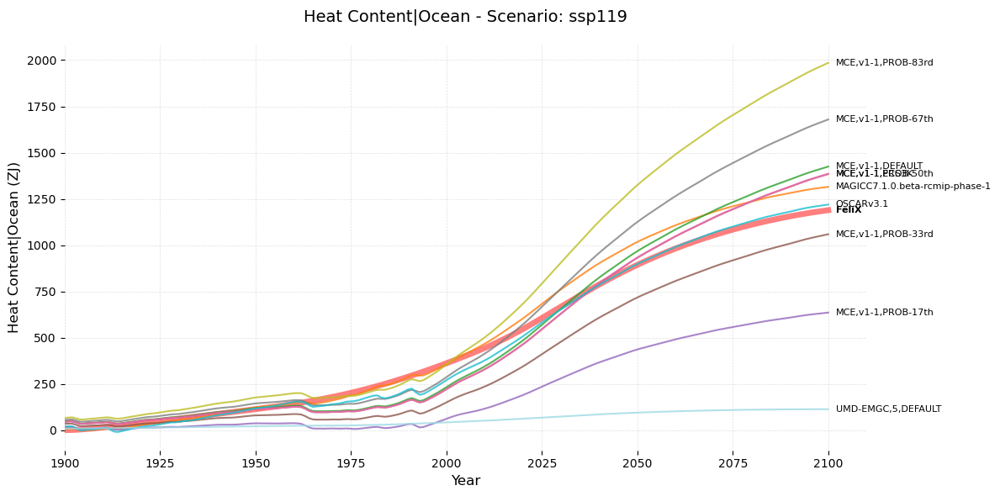

Original data shape: (11371, 1625)
After variable filtering: (623, 1625)
After scenario filtering: (11, 1625)
After region filtering: (11, 1625)
After year range filtering: (11, 206)
After excluding models: (11, 206)


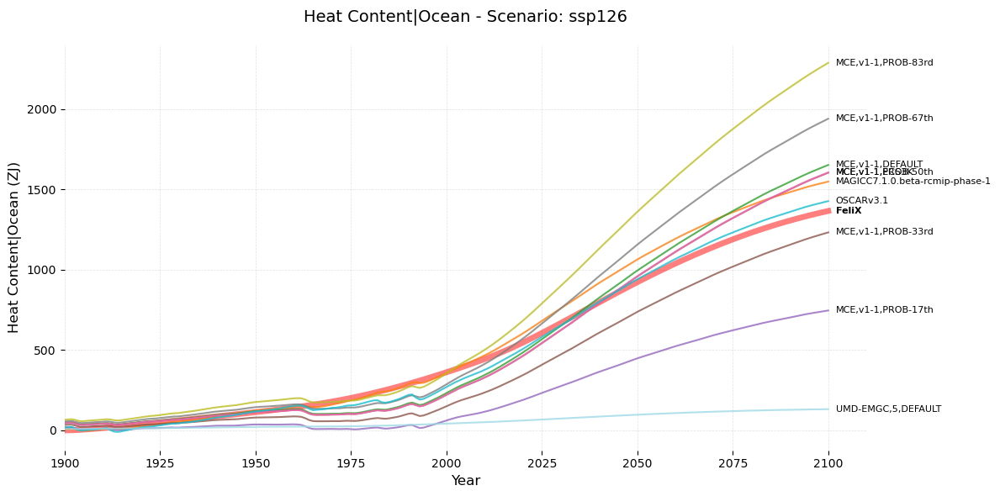

Original data shape: (11371, 1625)
After variable filtering: (623, 1625)
After scenario filtering: (11, 1625)
After region filtering: (11, 1625)
After year range filtering: (11, 206)
After excluding models: (11, 206)


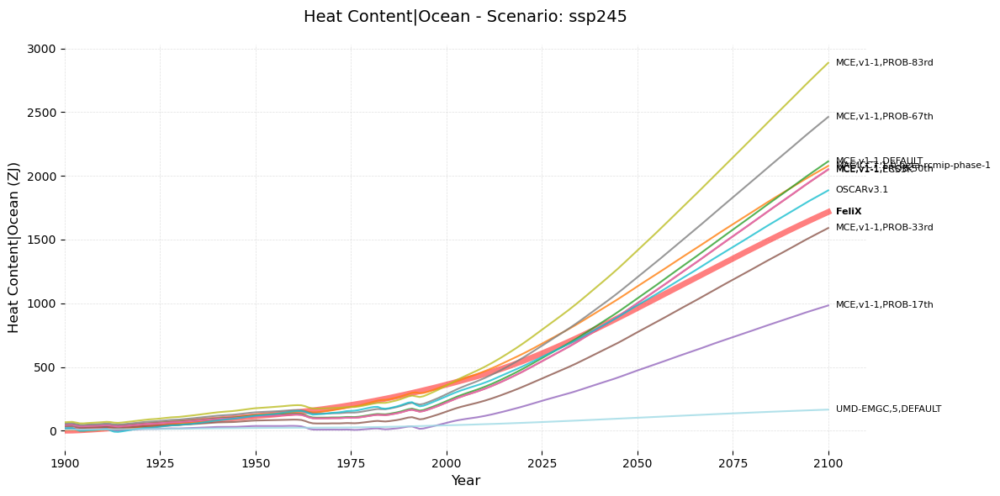

Original data shape: (11371, 1625)
After variable filtering: (623, 1625)
After scenario filtering: (11, 1625)
After region filtering: (11, 1625)
After year range filtering: (11, 206)
After excluding models: (11, 206)


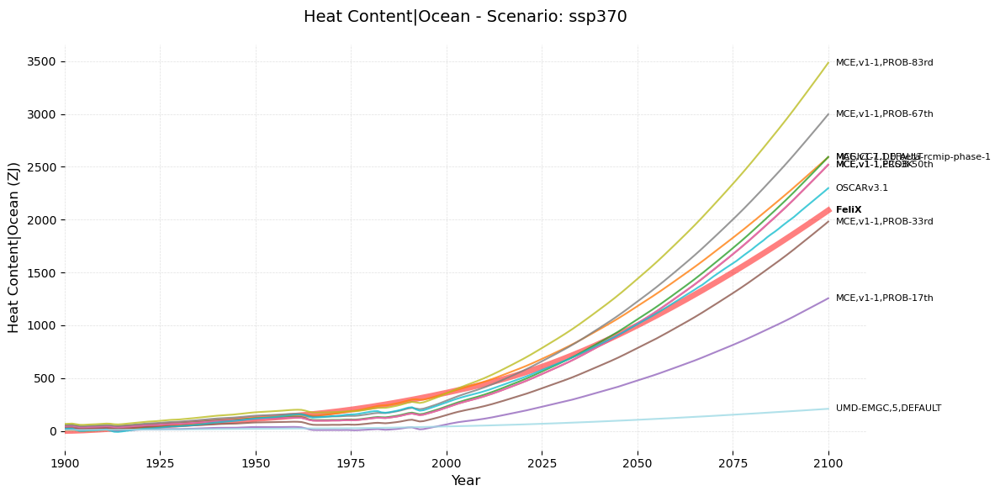

Original data shape: (11371, 1625)
After variable filtering: (623, 1625)
After scenario filtering: (10, 1625)
After region filtering: (10, 1625)
After year range filtering: (10, 206)
After excluding models: (10, 206)


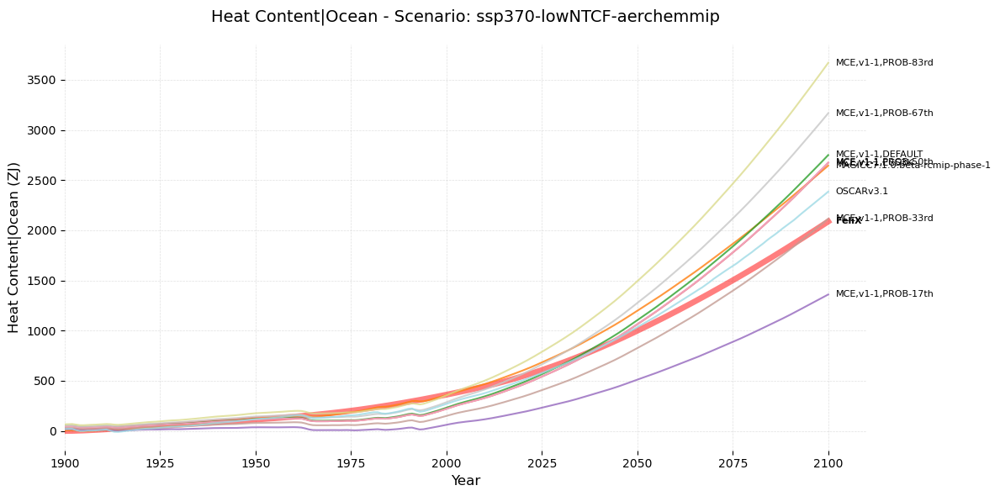

Original data shape: (11371, 1625)
After variable filtering: (623, 1625)
After scenario filtering: (10, 1625)
After region filtering: (10, 1625)
After year range filtering: (10, 206)
After excluding models: (10, 206)


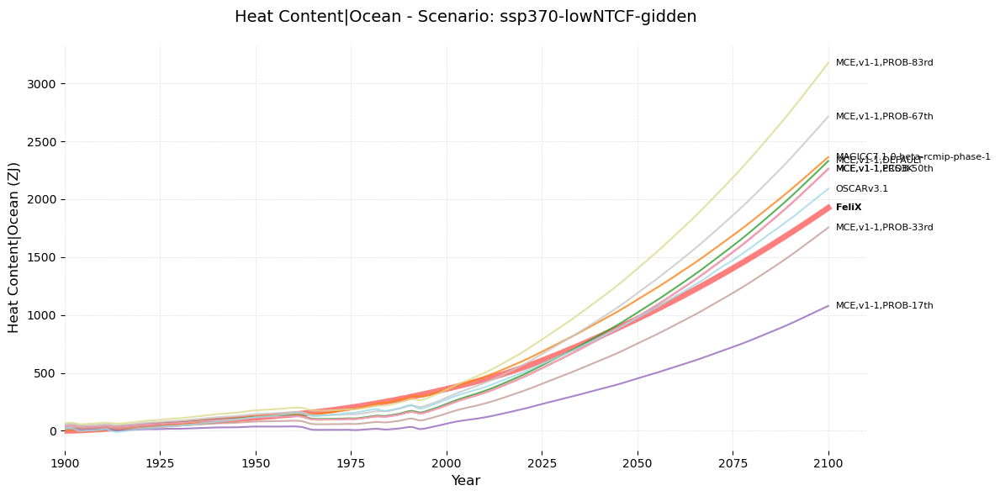

Original data shape: (11371, 1625)
After variable filtering: (623, 1625)
After scenario filtering: (11, 1625)
After region filtering: (11, 1625)
After year range filtering: (11, 206)
After excluding models: (11, 206)


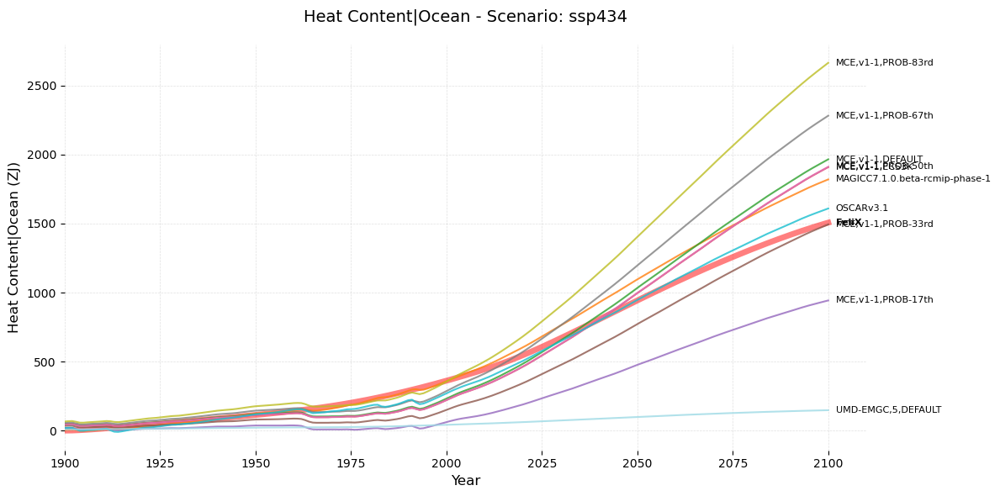

Original data shape: (11371, 1625)
After variable filtering: (623, 1625)
After scenario filtering: (11, 1625)
After region filtering: (11, 1625)
After year range filtering: (11, 206)
After excluding models: (11, 206)


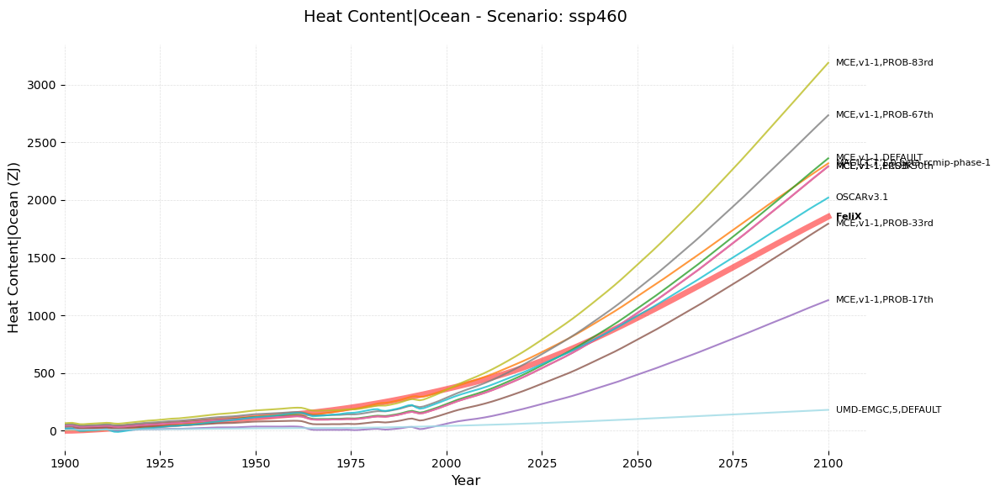

Original data shape: (11371, 1625)
After variable filtering: (623, 1625)
After scenario filtering: (10, 1625)
After region filtering: (10, 1625)
After year range filtering: (10, 206)
After excluding models: (10, 206)


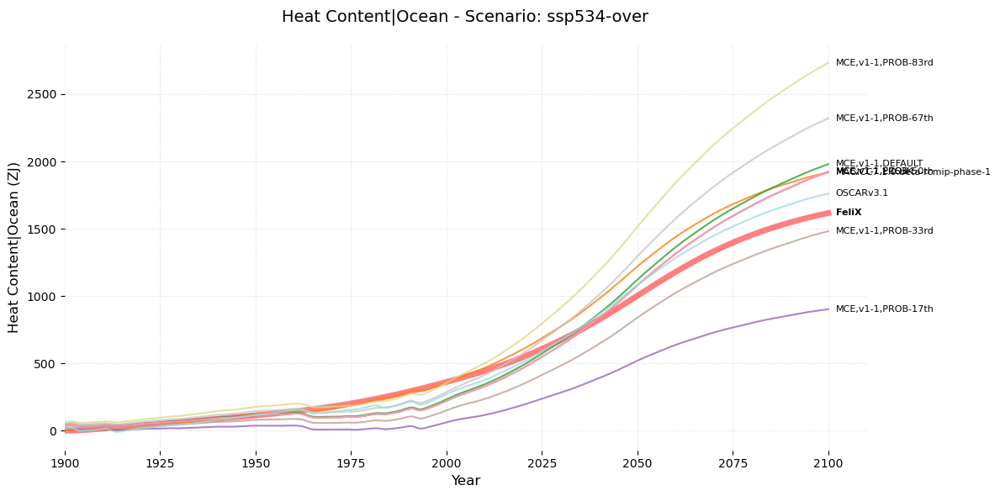

Original data shape: (11371, 1625)
After variable filtering: (623, 1625)
After scenario filtering: (11, 1625)
After region filtering: (11, 1625)
After year range filtering: (11, 206)
After excluding models: (11, 206)


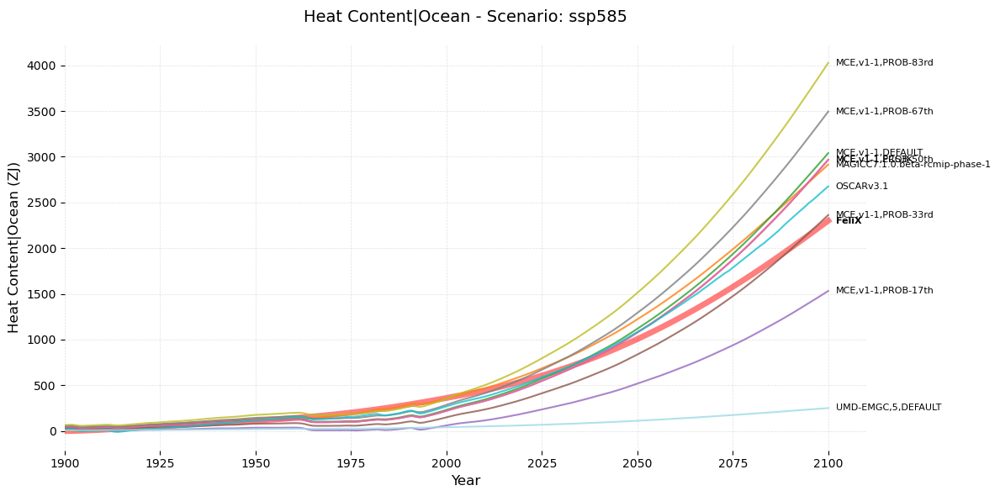

Original data shape: (11371, 1625)
After variable filtering: (623, 1625)
After scenario filtering: (2, 1625)
After region filtering: (2, 1625)
After year range filtering: (2, 206)
After excluding models: (2, 206)


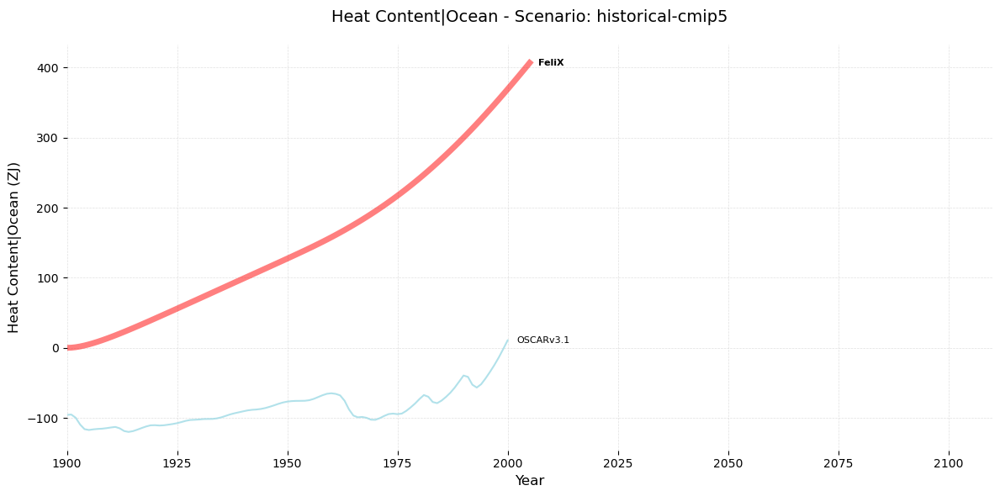

Original data shape: (11371, 1625)
After variable filtering: (22, 1625)
After scenario filtering: (1, 1625)
After region filtering: (1, 1625)
After year range filtering: (1, 206)
After excluding models: (1, 206)


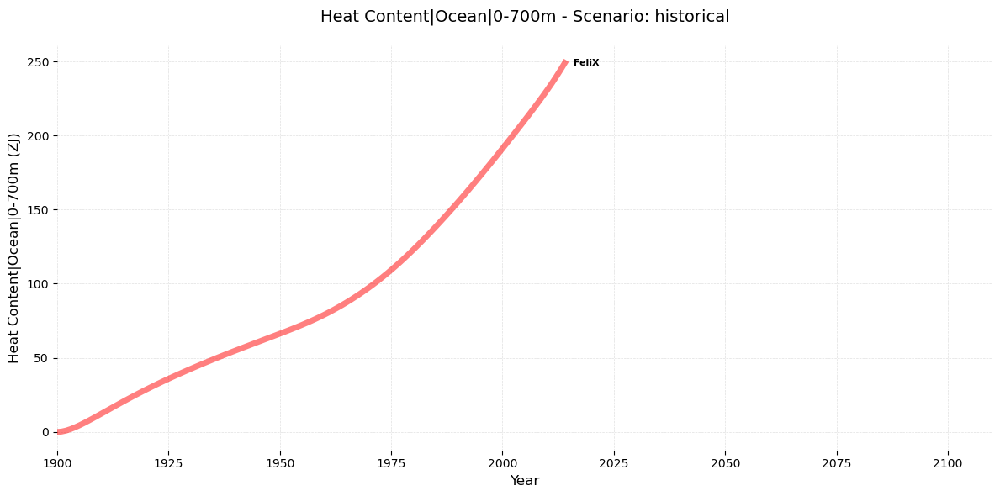

Original data shape: (11371, 1625)
After variable filtering: (22, 1625)
After scenario filtering: (1, 1625)
After region filtering: (1, 1625)
After year range filtering: (1, 206)
After excluding models: (1, 206)


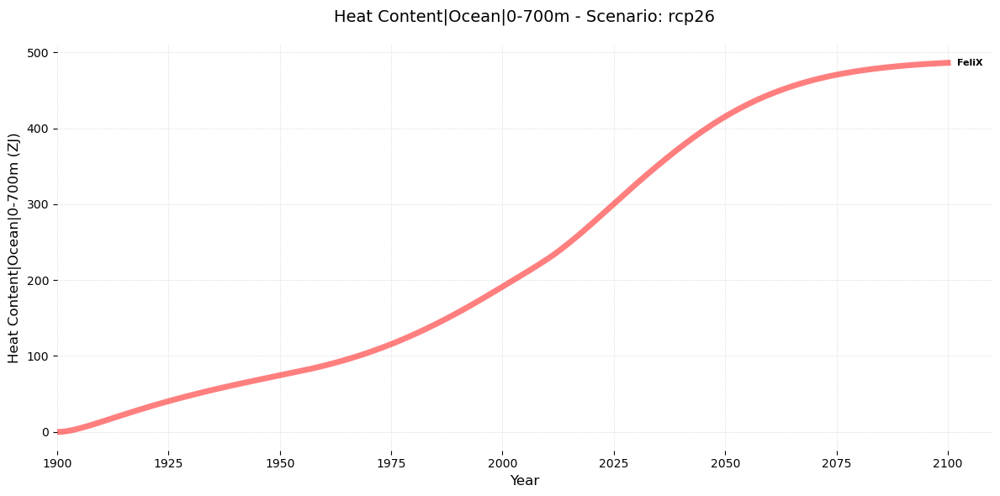

Original data shape: (11371, 1625)
After variable filtering: (22, 1625)
After scenario filtering: (1, 1625)
After region filtering: (1, 1625)
After year range filtering: (1, 206)
After excluding models: (1, 206)


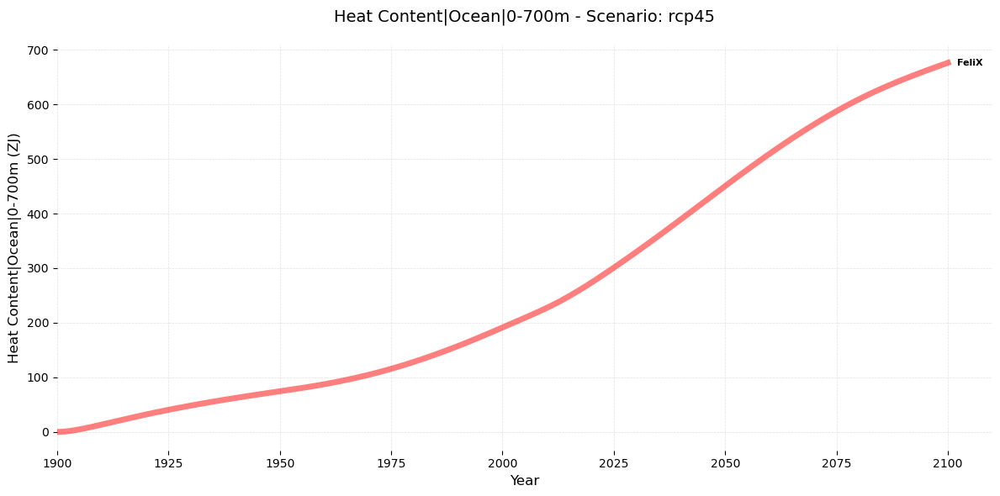

Original data shape: (11371, 1625)
After variable filtering: (22, 1625)
After scenario filtering: (1, 1625)
After region filtering: (1, 1625)
After year range filtering: (1, 206)
After excluding models: (1, 206)


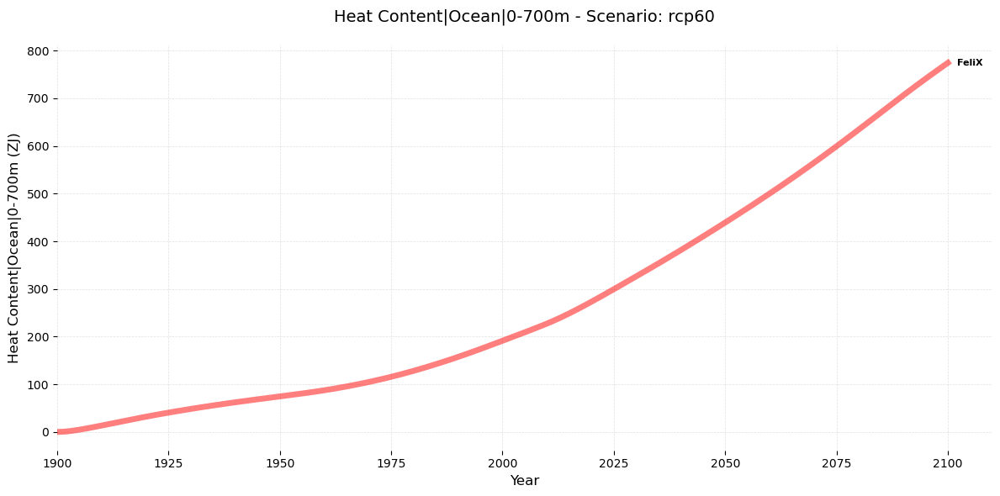

Original data shape: (11371, 1625)
After variable filtering: (22, 1625)
After scenario filtering: (1, 1625)
After region filtering: (1, 1625)
After year range filtering: (1, 206)
After excluding models: (1, 206)


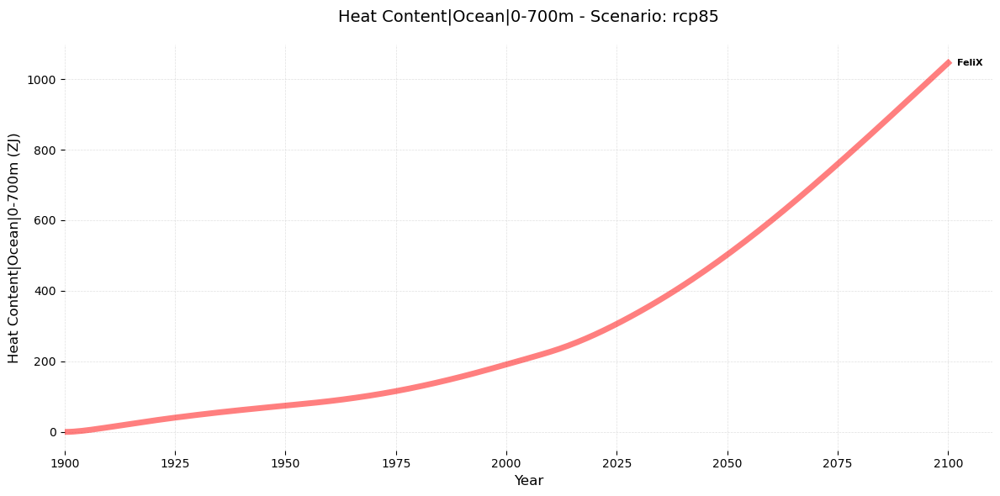

Original data shape: (11371, 1625)
After variable filtering: (22, 1625)
After scenario filtering: (1, 1625)
After region filtering: (1, 1625)
After year range filtering: (1, 206)
After excluding models: (1, 206)


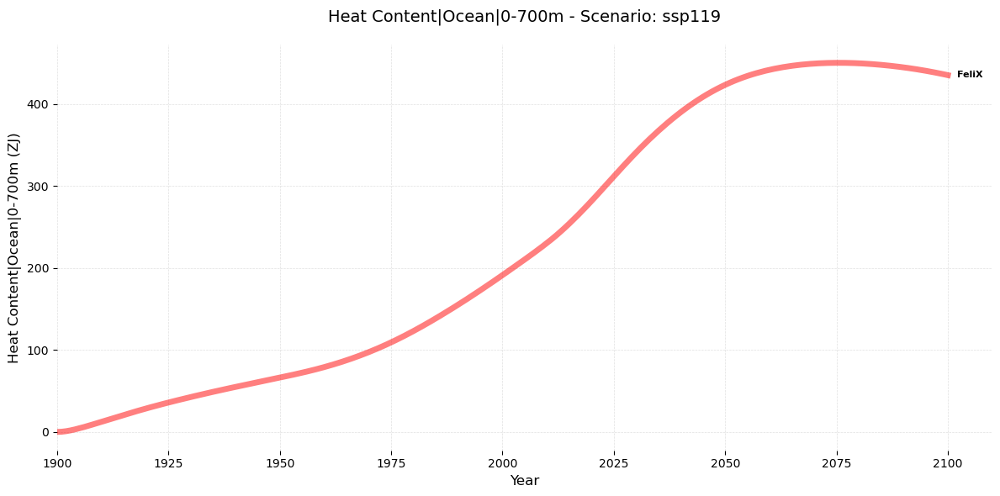

Original data shape: (11371, 1625)
After variable filtering: (22, 1625)
After scenario filtering: (1, 1625)
After region filtering: (1, 1625)
After year range filtering: (1, 206)
After excluding models: (1, 206)


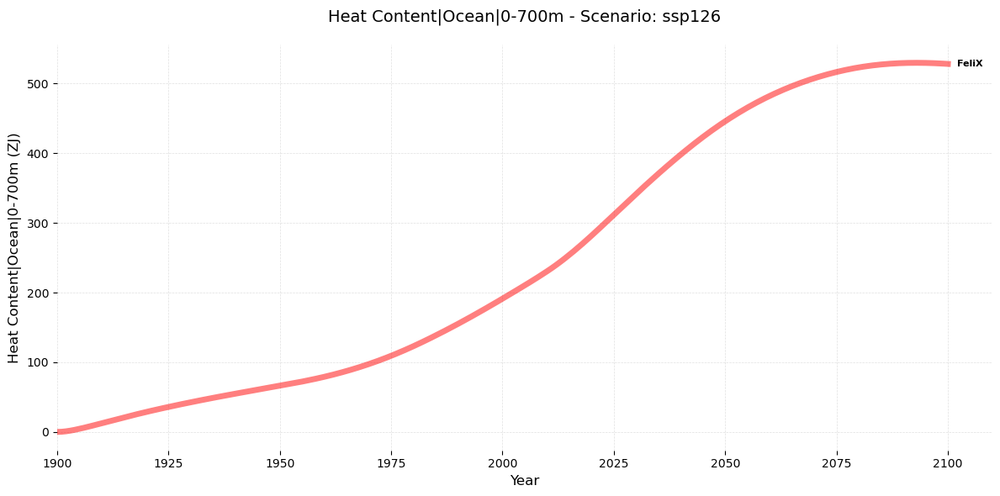

Original data shape: (11371, 1625)
After variable filtering: (22, 1625)
After scenario filtering: (1, 1625)
After region filtering: (1, 1625)
After year range filtering: (1, 206)
After excluding models: (1, 206)


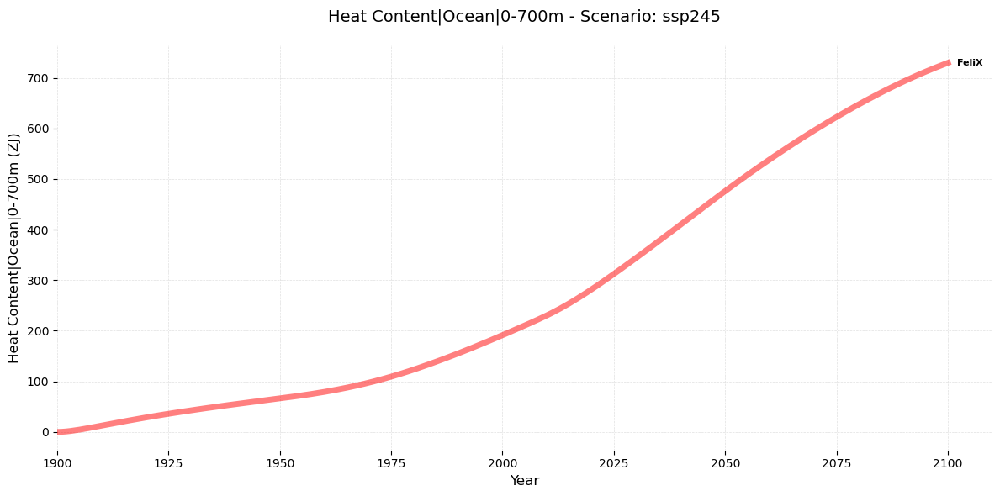

Original data shape: (11371, 1625)
After variable filtering: (22, 1625)
After scenario filtering: (1, 1625)
After region filtering: (1, 1625)
After year range filtering: (1, 206)
After excluding models: (1, 206)


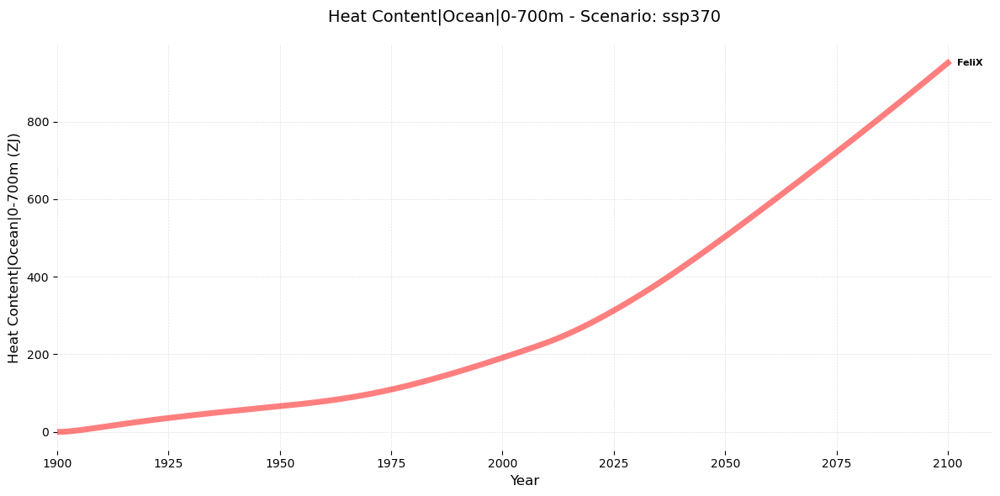

Original data shape: (11371, 1625)
After variable filtering: (22, 1625)
After scenario filtering: (1, 1625)
After region filtering: (1, 1625)
After year range filtering: (1, 206)
After excluding models: (1, 206)


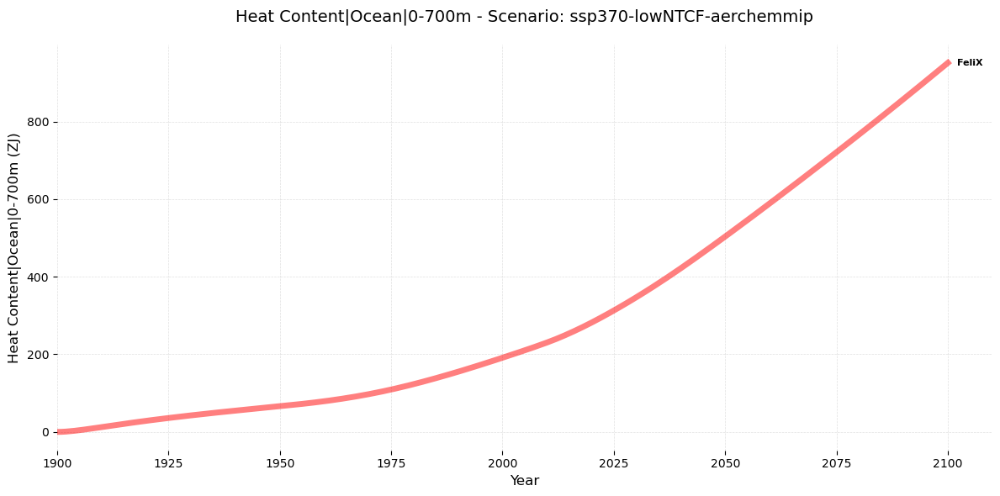

Original data shape: (11371, 1625)
After variable filtering: (22, 1625)
After scenario filtering: (1, 1625)
After region filtering: (1, 1625)
After year range filtering: (1, 206)
After excluding models: (1, 206)


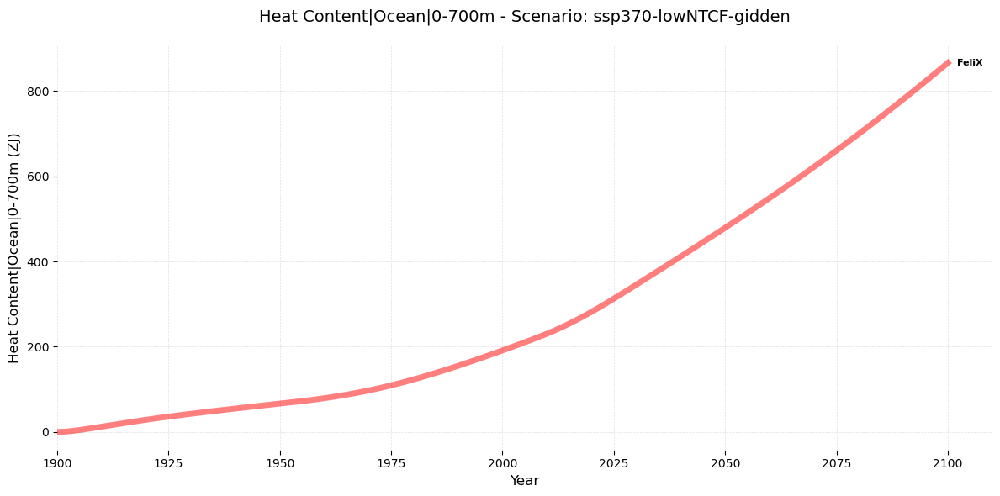

Original data shape: (11371, 1625)
After variable filtering: (22, 1625)
After scenario filtering: (1, 1625)
After region filtering: (1, 1625)
After year range filtering: (1, 206)
After excluding models: (1, 206)


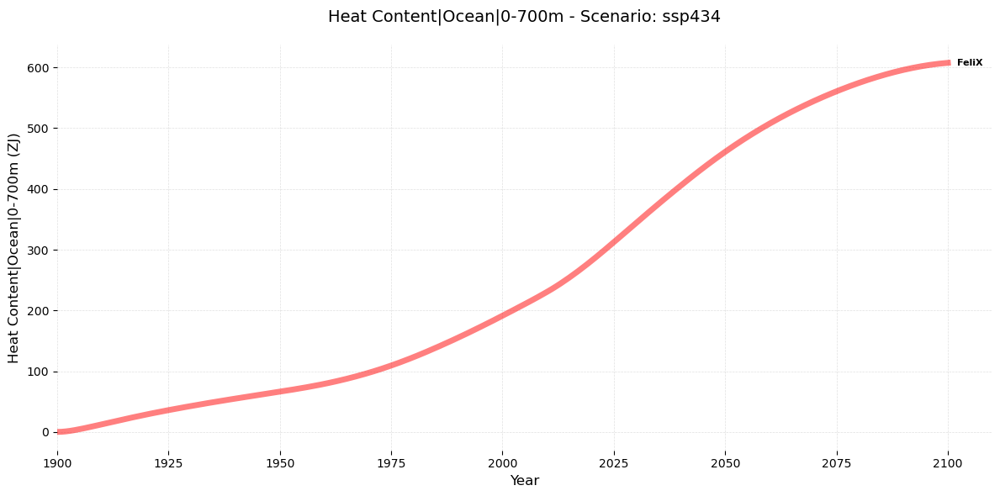

Original data shape: (11371, 1625)
After variable filtering: (22, 1625)
After scenario filtering: (1, 1625)
After region filtering: (1, 1625)
After year range filtering: (1, 206)
After excluding models: (1, 206)


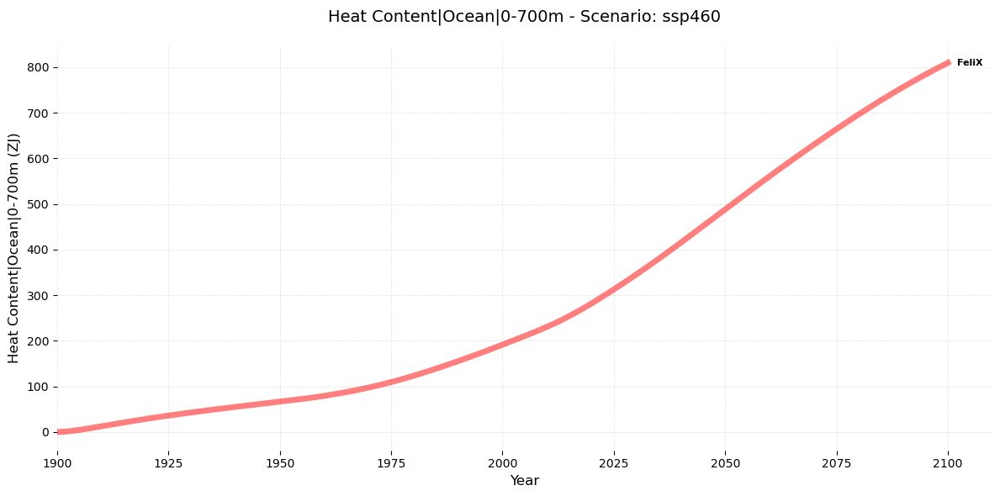

Original data shape: (11371, 1625)
After variable filtering: (22, 1625)
After scenario filtering: (1, 1625)
After region filtering: (1, 1625)
After year range filtering: (1, 206)
After excluding models: (1, 206)


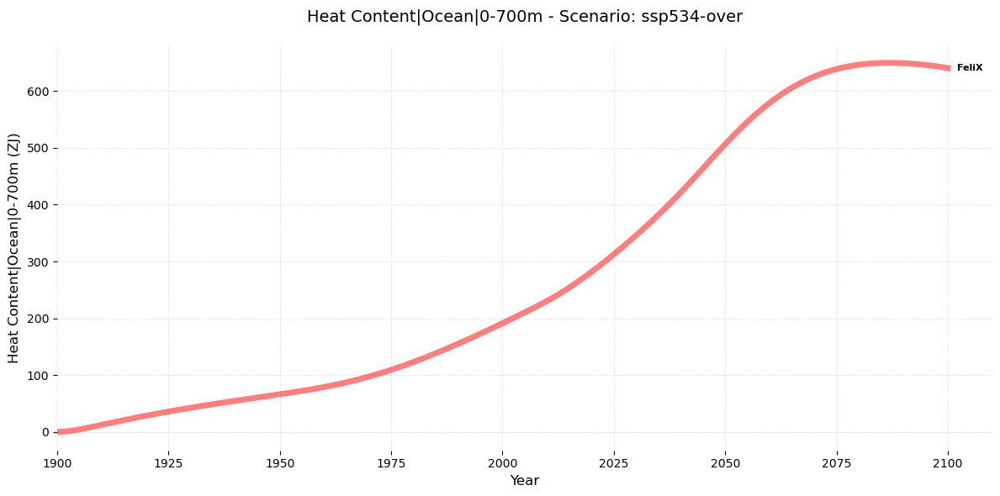

Original data shape: (11371, 1625)
After variable filtering: (22, 1625)
After scenario filtering: (1, 1625)
After region filtering: (1, 1625)
After year range filtering: (1, 206)
After excluding models: (1, 206)


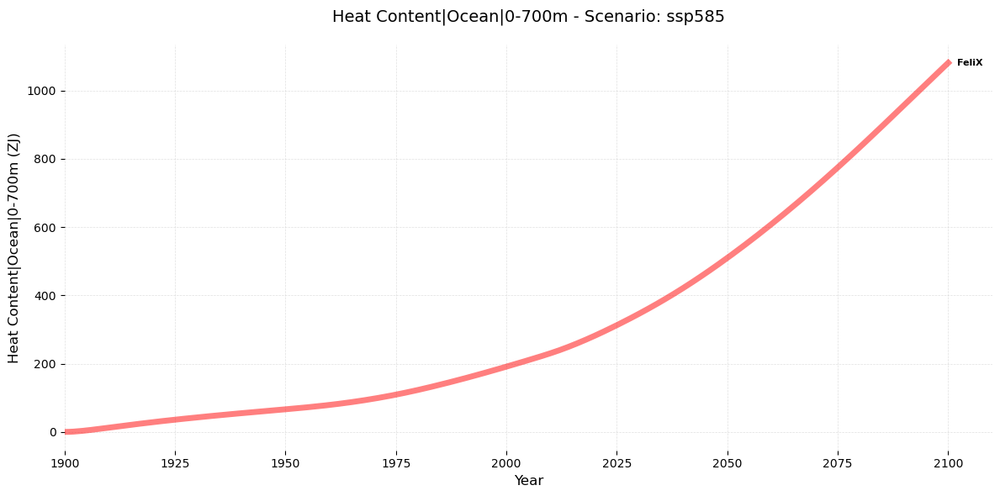

Original data shape: (11371, 1625)
After variable filtering: (22, 1625)
After scenario filtering: (1, 1625)
After region filtering: (1, 1625)
After year range filtering: (1, 206)
After excluding models: (1, 206)


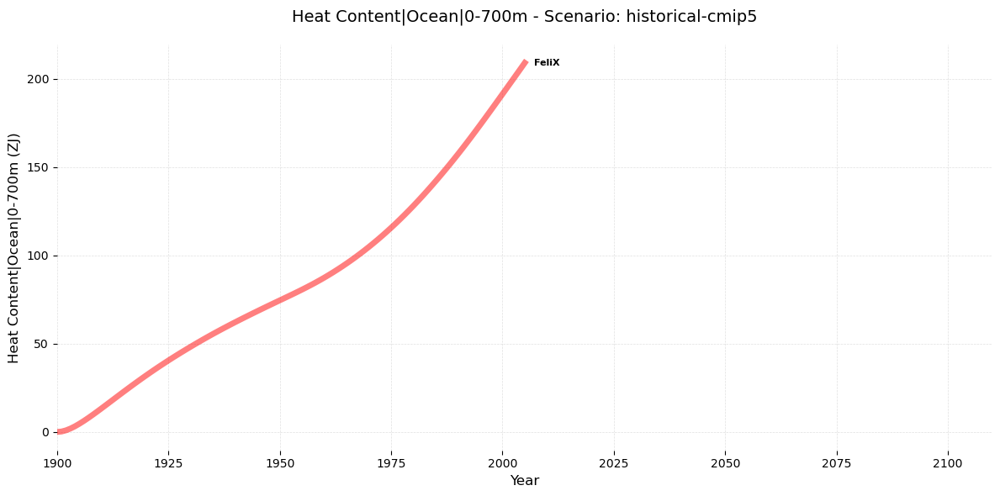

Original data shape: (11371, 1625)
After variable filtering: (22, 1625)
After scenario filtering: (1, 1625)
After region filtering: (1, 1625)
After year range filtering: (1, 206)
After excluding models: (1, 206)


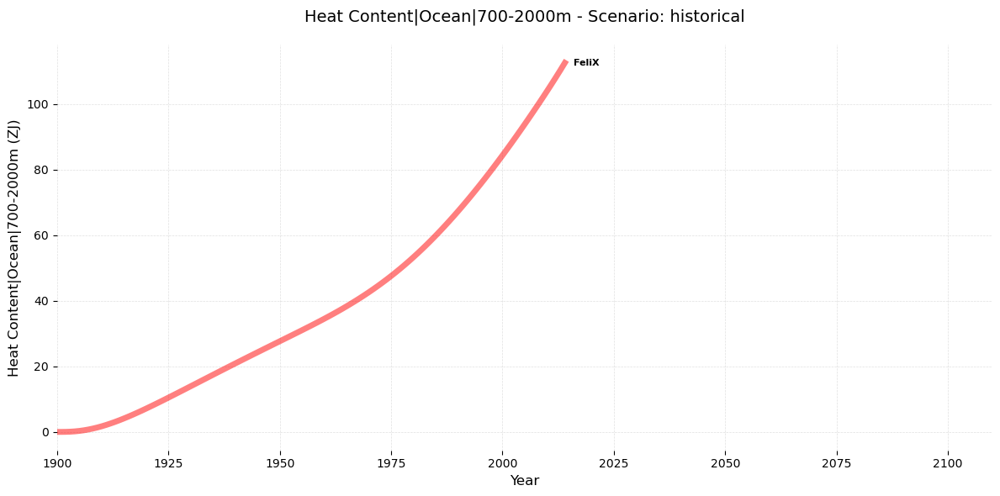

Original data shape: (11371, 1625)
After variable filtering: (22, 1625)
After scenario filtering: (1, 1625)
After region filtering: (1, 1625)
After year range filtering: (1, 206)
After excluding models: (1, 206)


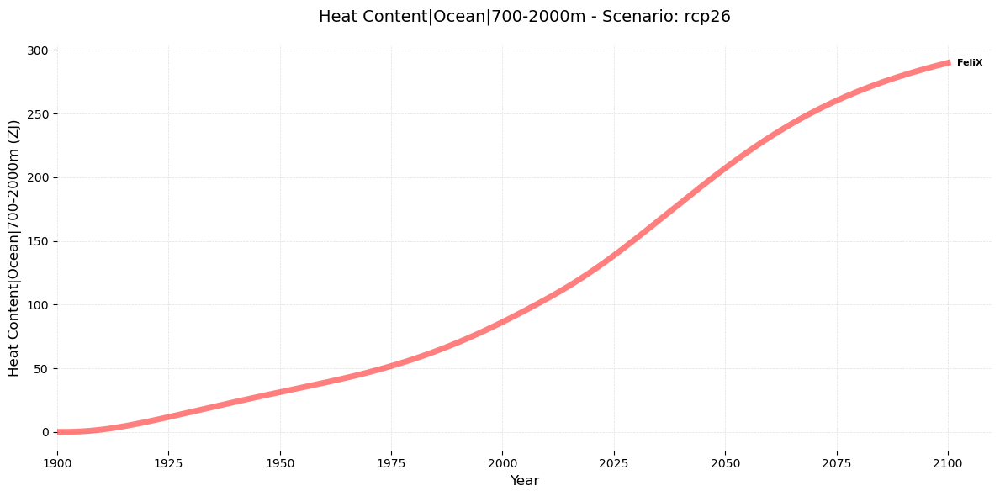

Original data shape: (11371, 1625)
After variable filtering: (22, 1625)
After scenario filtering: (1, 1625)
After region filtering: (1, 1625)
After year range filtering: (1, 206)
After excluding models: (1, 206)


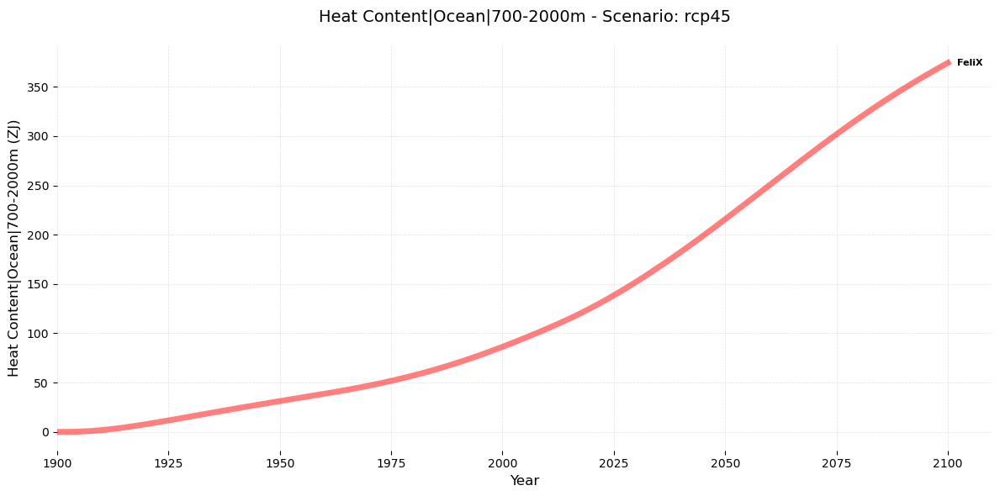

Original data shape: (11371, 1625)
After variable filtering: (22, 1625)
After scenario filtering: (1, 1625)
After region filtering: (1, 1625)
After year range filtering: (1, 206)
After excluding models: (1, 206)


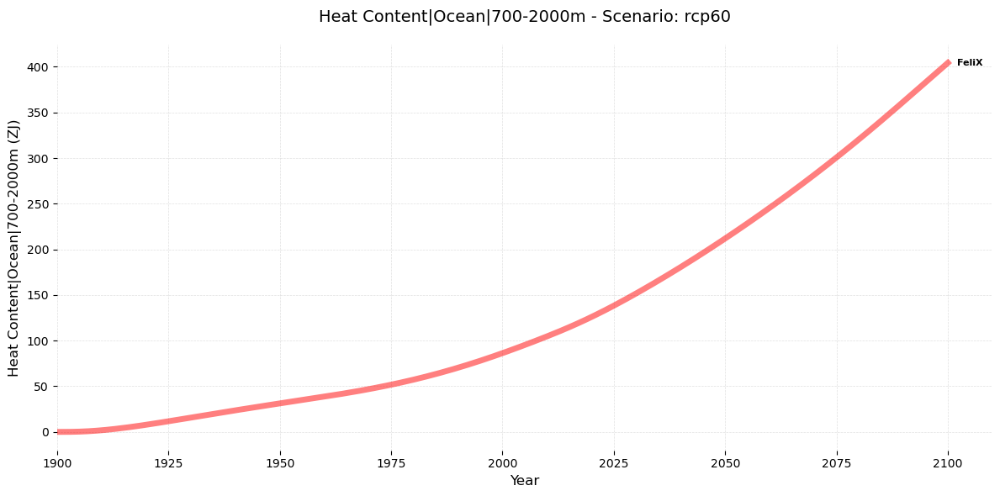

Original data shape: (11371, 1625)
After variable filtering: (22, 1625)
After scenario filtering: (1, 1625)
After region filtering: (1, 1625)
After year range filtering: (1, 206)
After excluding models: (1, 206)


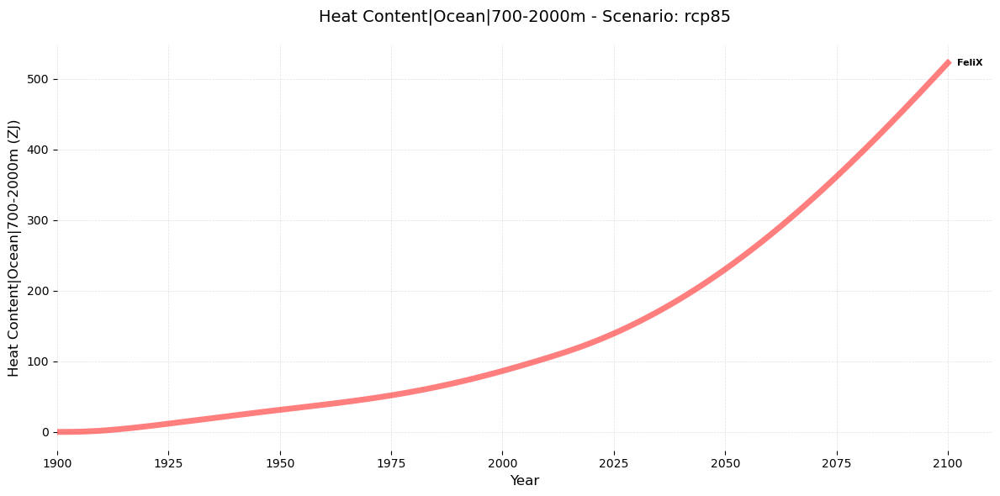

Original data shape: (11371, 1625)
After variable filtering: (22, 1625)
After scenario filtering: (1, 1625)
After region filtering: (1, 1625)
After year range filtering: (1, 206)
After excluding models: (1, 206)


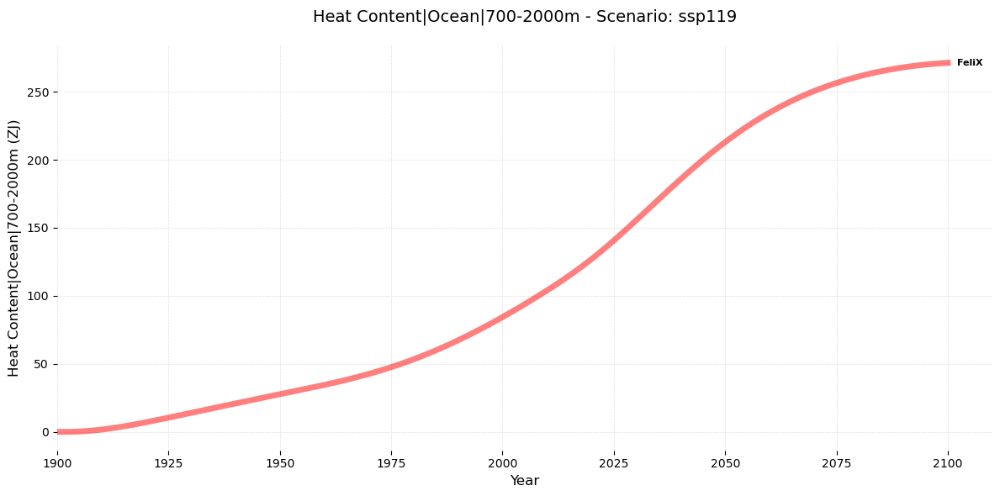

Original data shape: (11371, 1625)
After variable filtering: (22, 1625)
After scenario filtering: (1, 1625)
After region filtering: (1, 1625)
After year range filtering: (1, 206)
After excluding models: (1, 206)


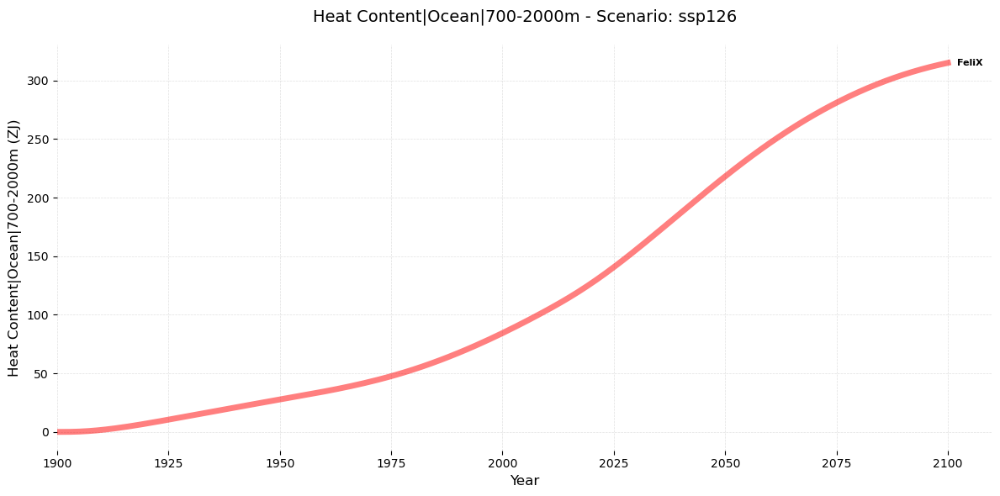

Original data shape: (11371, 1625)
After variable filtering: (22, 1625)
After scenario filtering: (1, 1625)
After region filtering: (1, 1625)
After year range filtering: (1, 206)
After excluding models: (1, 206)


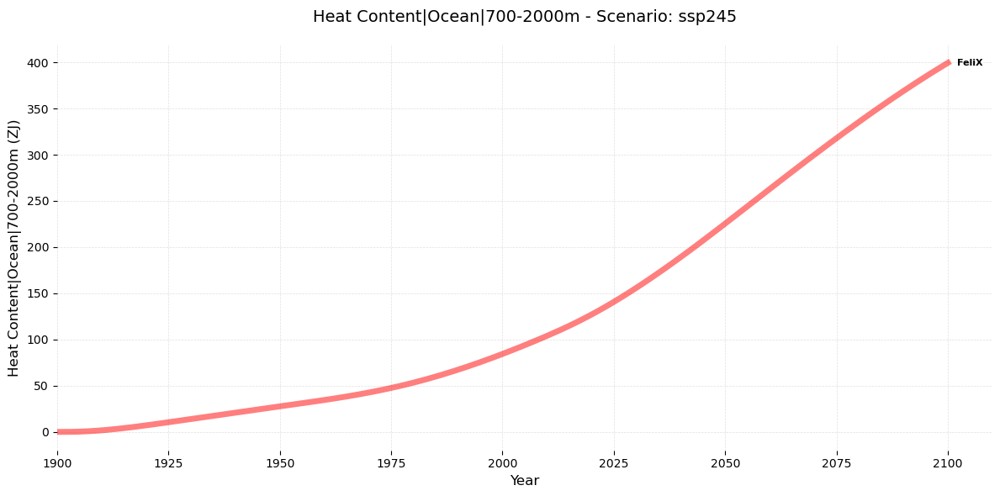

Original data shape: (11371, 1625)
After variable filtering: (22, 1625)
After scenario filtering: (1, 1625)
After region filtering: (1, 1625)
After year range filtering: (1, 206)
After excluding models: (1, 206)


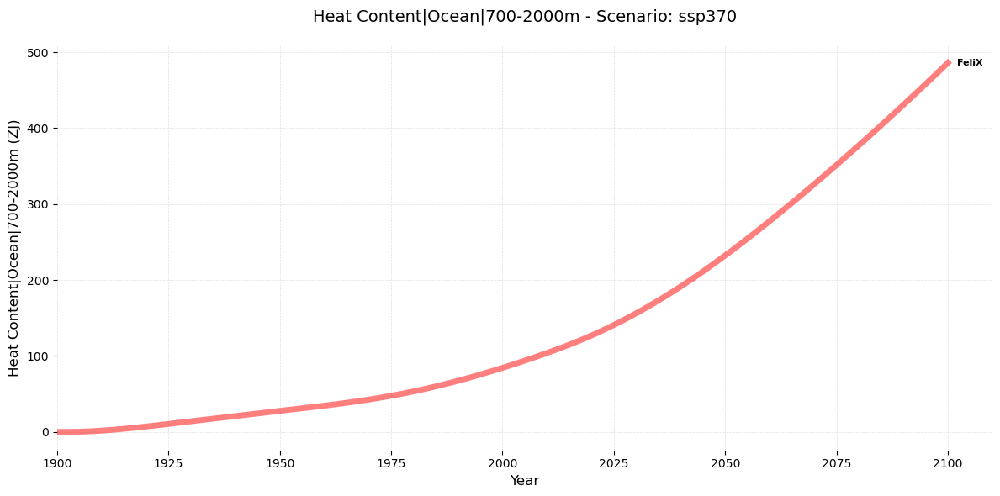

Original data shape: (11371, 1625)
After variable filtering: (22, 1625)
After scenario filtering: (1, 1625)
After region filtering: (1, 1625)
After year range filtering: (1, 206)
After excluding models: (1, 206)


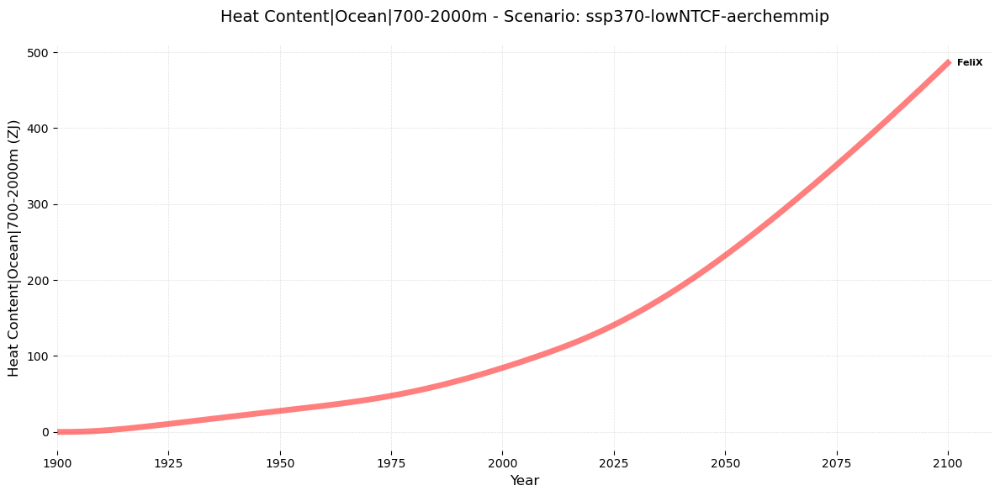

Original data shape: (11371, 1625)
After variable filtering: (22, 1625)
After scenario filtering: (1, 1625)
After region filtering: (1, 1625)
After year range filtering: (1, 206)
After excluding models: (1, 206)


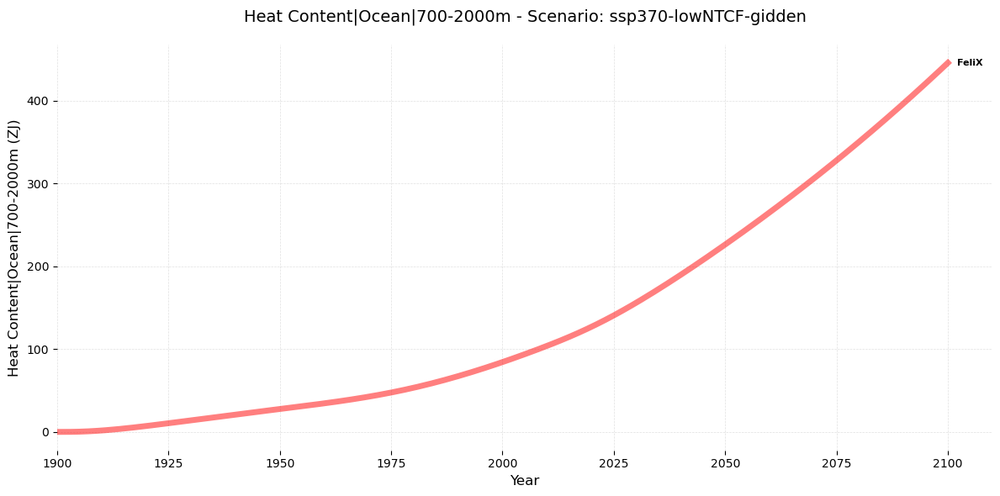

Original data shape: (11371, 1625)
After variable filtering: (22, 1625)
After scenario filtering: (1, 1625)
After region filtering: (1, 1625)
After year range filtering: (1, 206)
After excluding models: (1, 206)


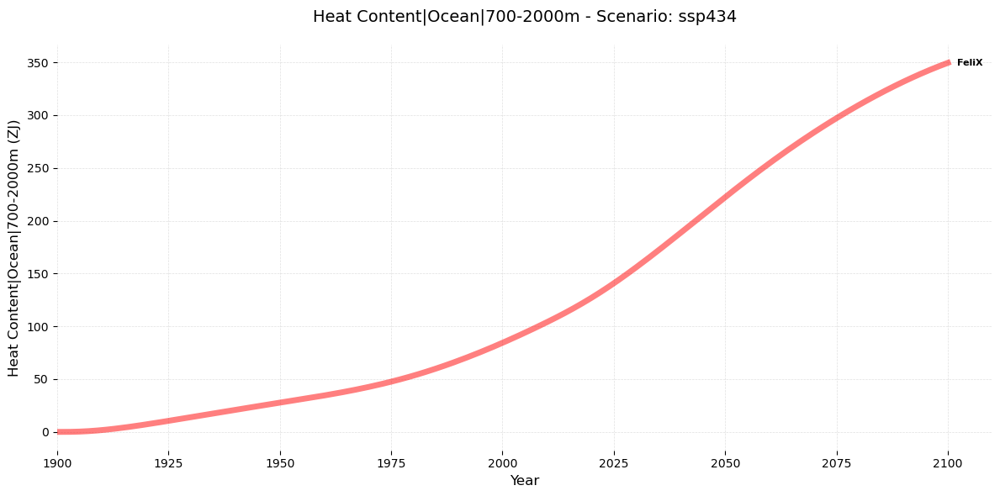

Original data shape: (11371, 1625)
After variable filtering: (22, 1625)
After scenario filtering: (1, 1625)
After region filtering: (1, 1625)
After year range filtering: (1, 206)
After excluding models: (1, 206)


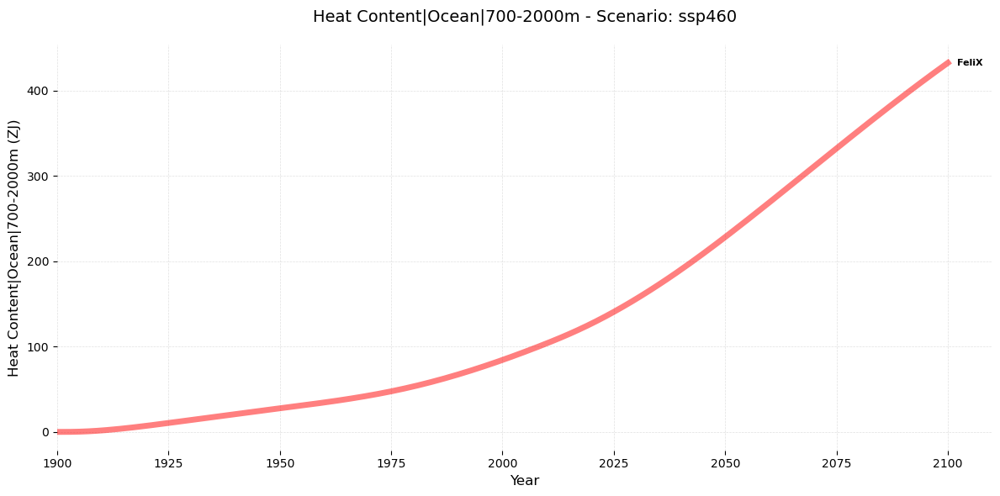

Original data shape: (11371, 1625)
After variable filtering: (22, 1625)
After scenario filtering: (1, 1625)
After region filtering: (1, 1625)
After year range filtering: (1, 206)
After excluding models: (1, 206)


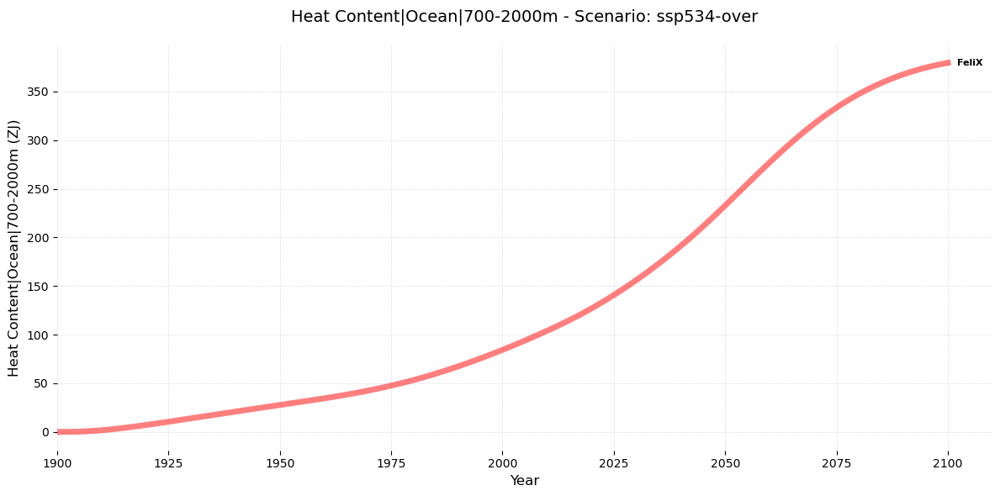

Original data shape: (11371, 1625)
After variable filtering: (22, 1625)
After scenario filtering: (1, 1625)
After region filtering: (1, 1625)
After year range filtering: (1, 206)
After excluding models: (1, 206)


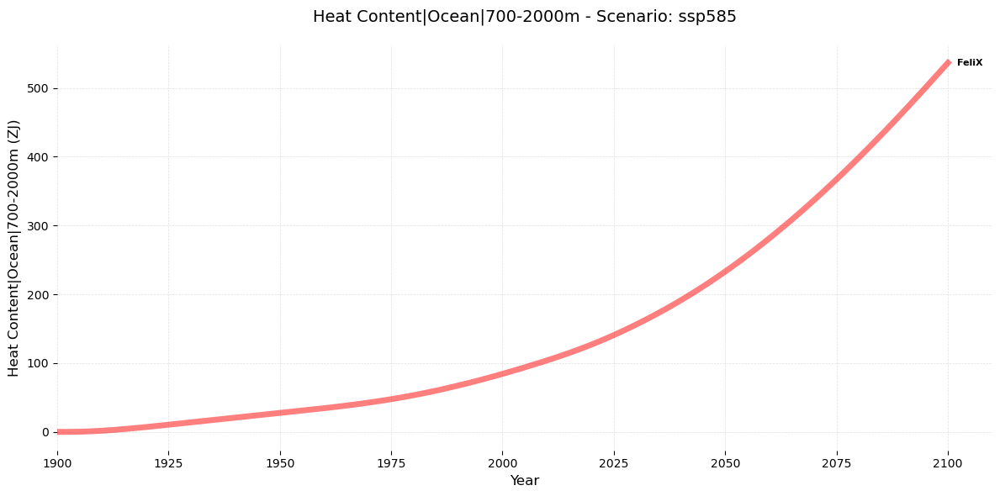

Original data shape: (11371, 1625)
After variable filtering: (22, 1625)
After scenario filtering: (1, 1625)
After region filtering: (1, 1625)
After year range filtering: (1, 206)
After excluding models: (1, 206)


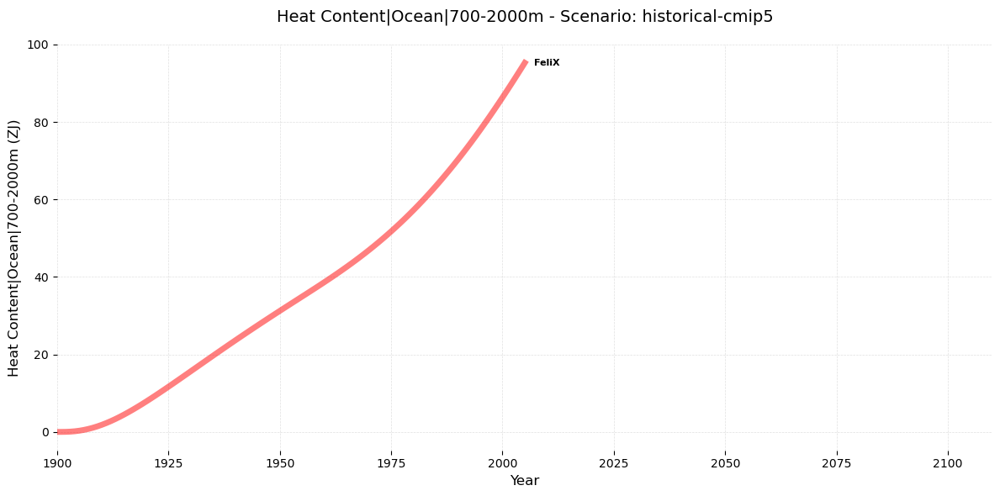

Original data shape: (11371, 1625)
After variable filtering: (81, 1625)
After scenario filtering: (3, 1625)
After region filtering: (3, 1625)
After year range filtering: (3, 206)
After excluding models: (3, 206)


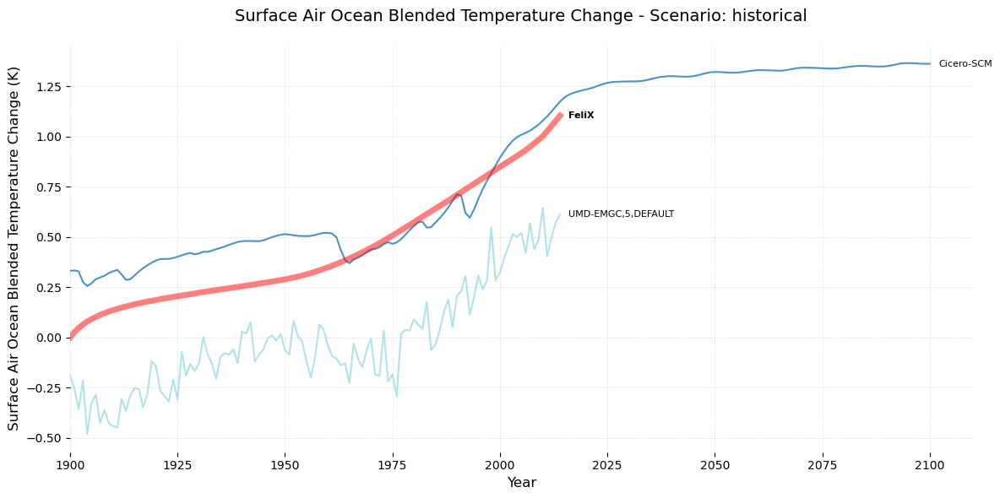

Original data shape: (11371, 1625)
After variable filtering: (81, 1625)
After scenario filtering: (2, 1625)
After region filtering: (2, 1625)
After year range filtering: (2, 206)
After excluding models: (2, 206)


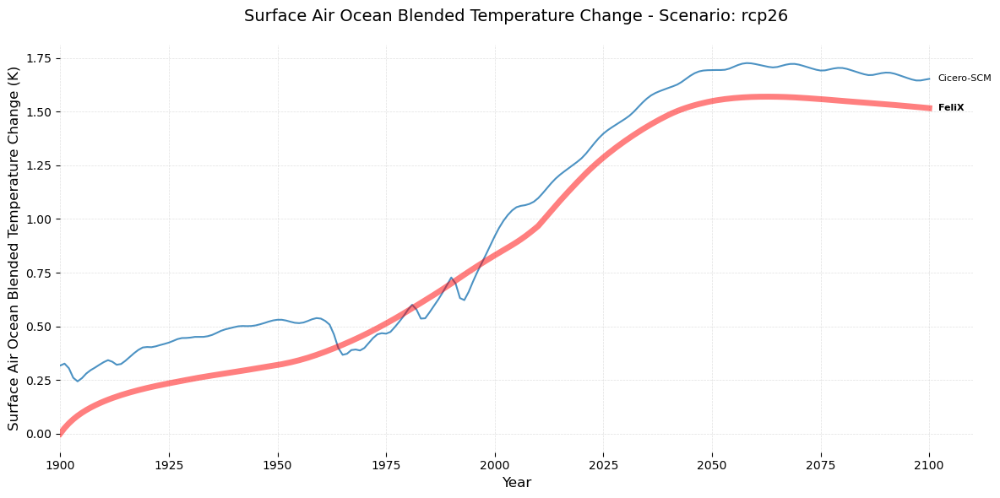

Original data shape: (11371, 1625)
After variable filtering: (81, 1625)
After scenario filtering: (2, 1625)
After region filtering: (2, 1625)
After year range filtering: (2, 206)
After excluding models: (2, 206)


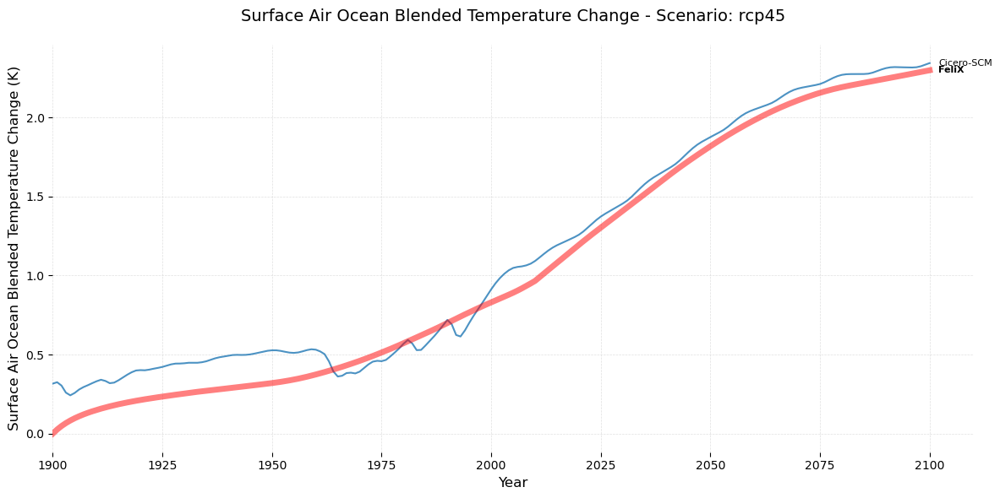

Original data shape: (11371, 1625)
After variable filtering: (81, 1625)
After scenario filtering: (2, 1625)
After region filtering: (2, 1625)
After year range filtering: (2, 206)
After excluding models: (2, 206)


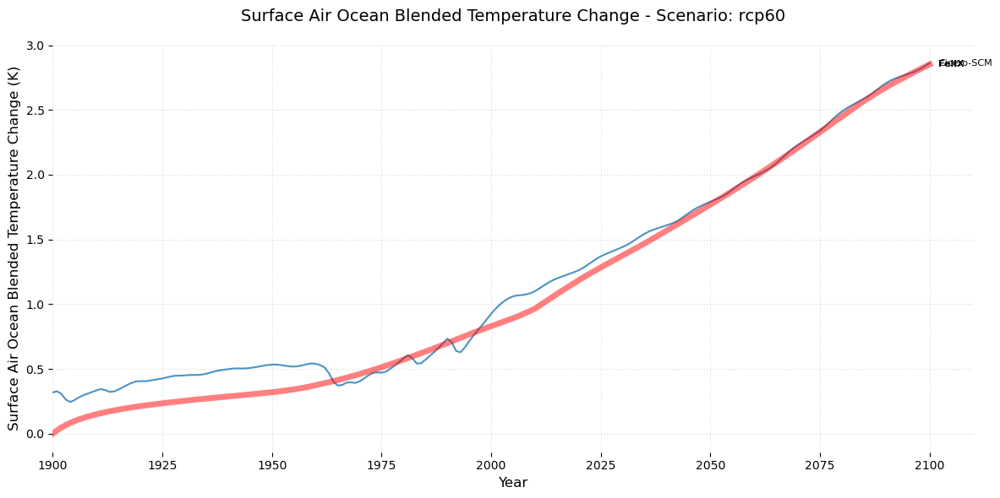

Original data shape: (11371, 1625)
After variable filtering: (81, 1625)
After scenario filtering: (2, 1625)
After region filtering: (2, 1625)
After year range filtering: (2, 206)
After excluding models: (2, 206)


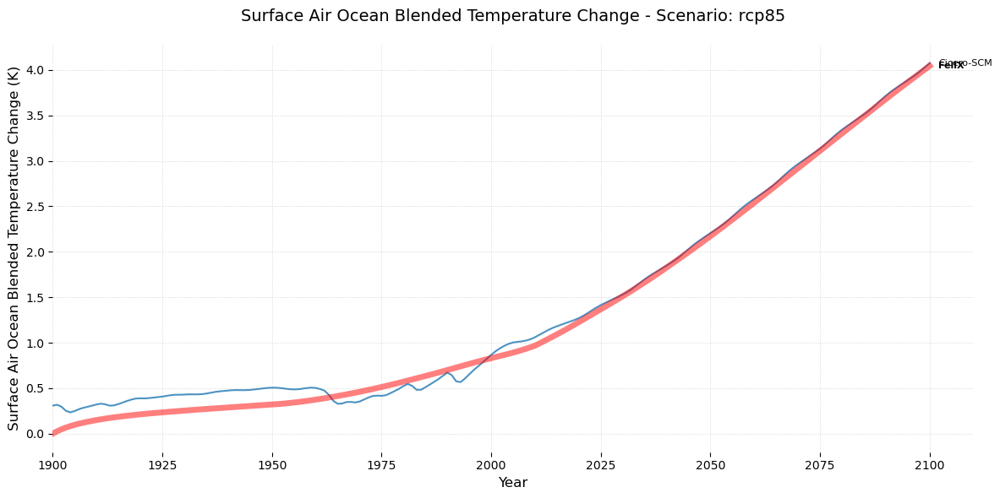

Original data shape: (11371, 1625)
After variable filtering: (81, 1625)
After scenario filtering: (3, 1625)
After region filtering: (3, 1625)
After year range filtering: (3, 206)
After excluding models: (3, 206)


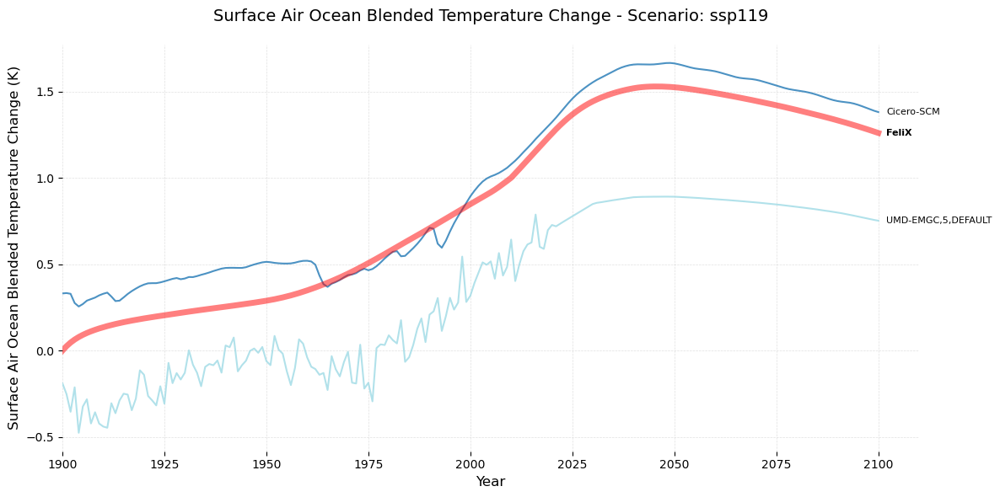

Original data shape: (11371, 1625)
After variable filtering: (81, 1625)
After scenario filtering: (3, 1625)
After region filtering: (3, 1625)
After year range filtering: (3, 206)
After excluding models: (3, 206)


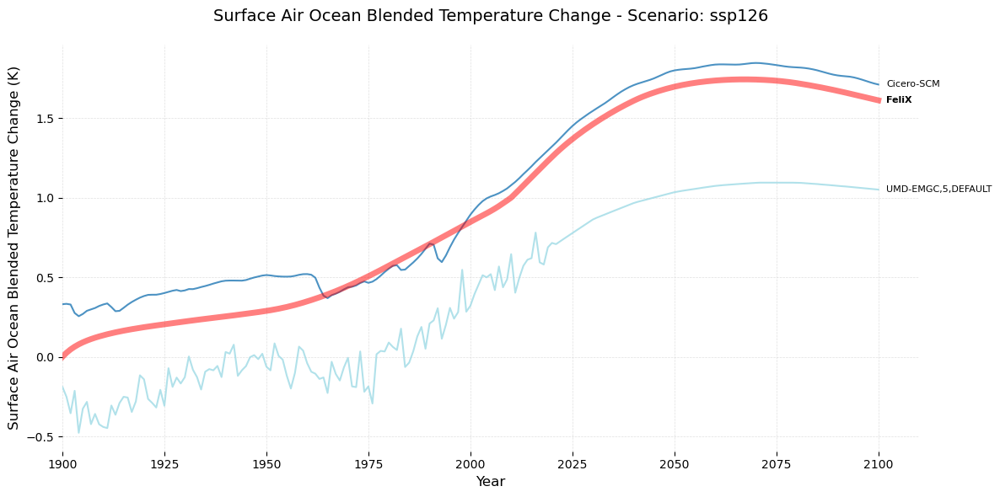

Original data shape: (11371, 1625)
After variable filtering: (81, 1625)
After scenario filtering: (3, 1625)
After region filtering: (3, 1625)
After year range filtering: (3, 206)
After excluding models: (3, 206)


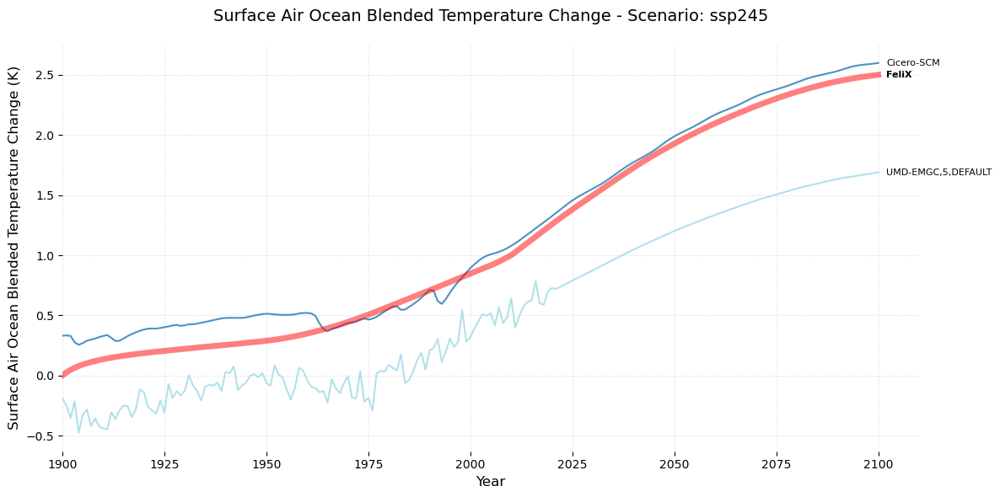

Original data shape: (11371, 1625)
After variable filtering: (81, 1625)
After scenario filtering: (3, 1625)
After region filtering: (3, 1625)
After year range filtering: (3, 206)
After excluding models: (3, 206)


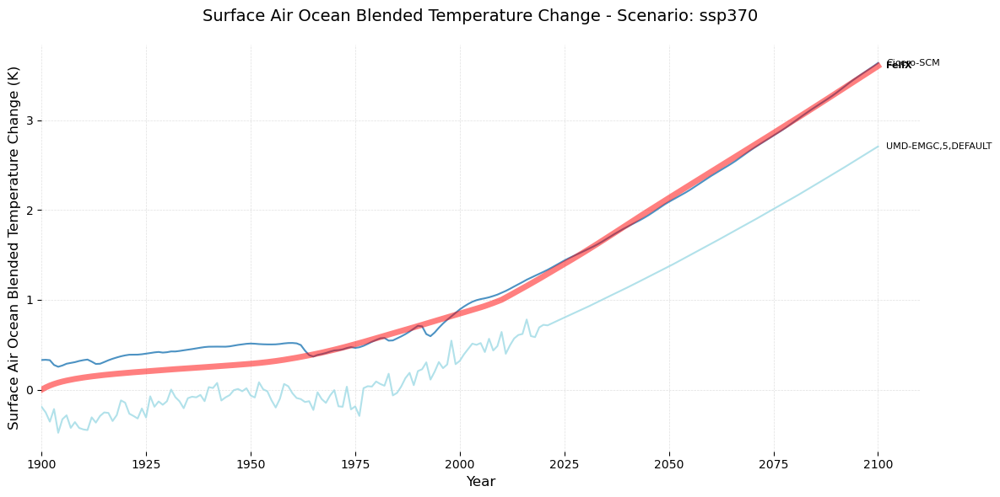

Original data shape: (11371, 1625)
After variable filtering: (81, 1625)
After scenario filtering: (2, 1625)
After region filtering: (2, 1625)
After year range filtering: (2, 206)
After excluding models: (2, 206)


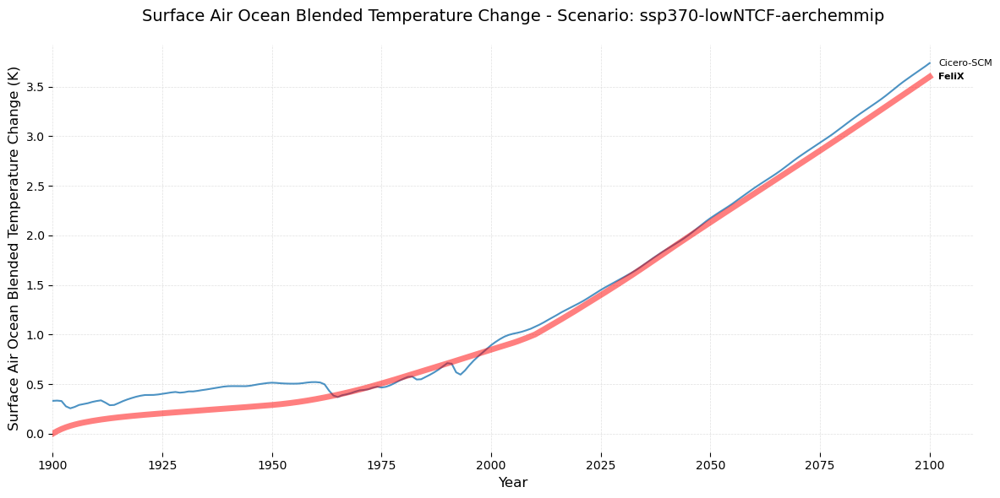

Original data shape: (11371, 1625)
After variable filtering: (81, 1625)
After scenario filtering: (2, 1625)
After region filtering: (2, 1625)
After year range filtering: (2, 206)
After excluding models: (2, 206)


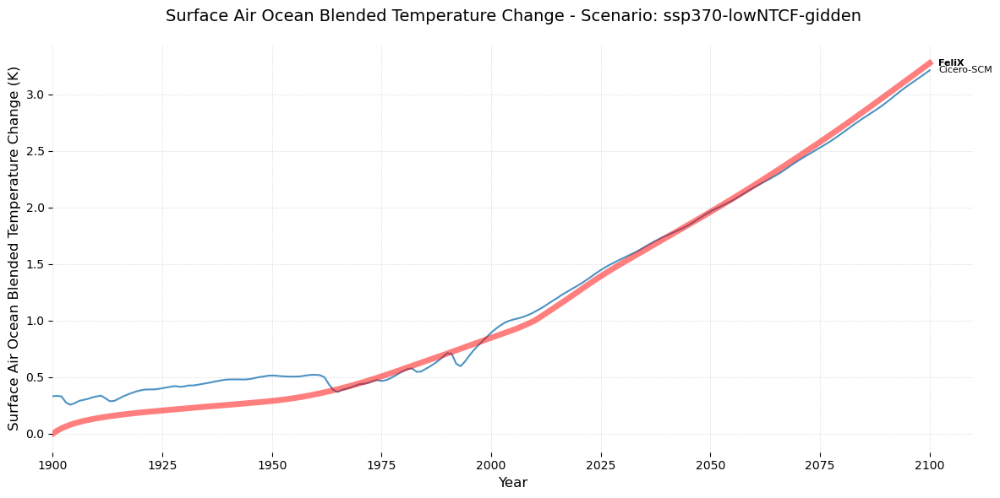

Original data shape: (11371, 1625)
After variable filtering: (81, 1625)
After scenario filtering: (3, 1625)
After region filtering: (3, 1625)
After year range filtering: (3, 206)
After excluding models: (3, 206)


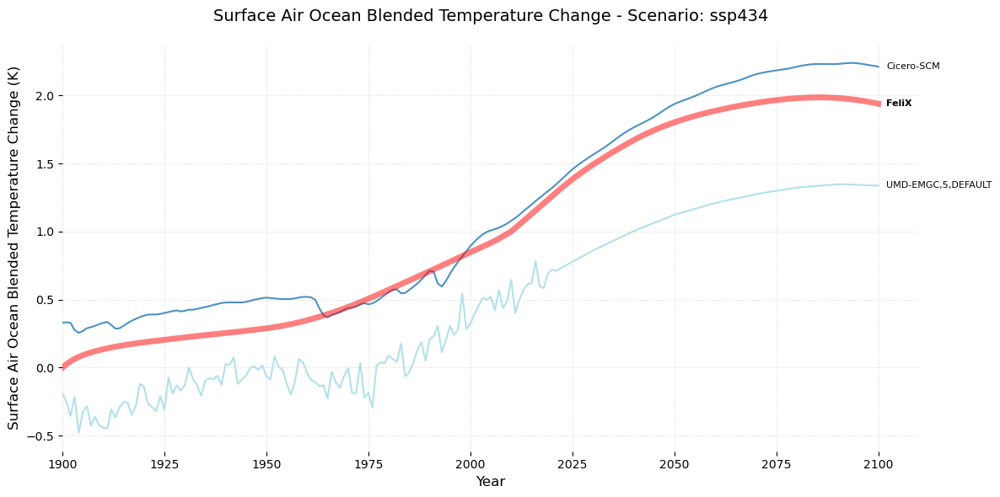

Original data shape: (11371, 1625)
After variable filtering: (81, 1625)
After scenario filtering: (3, 1625)
After region filtering: (3, 1625)
After year range filtering: (3, 206)
After excluding models: (3, 206)


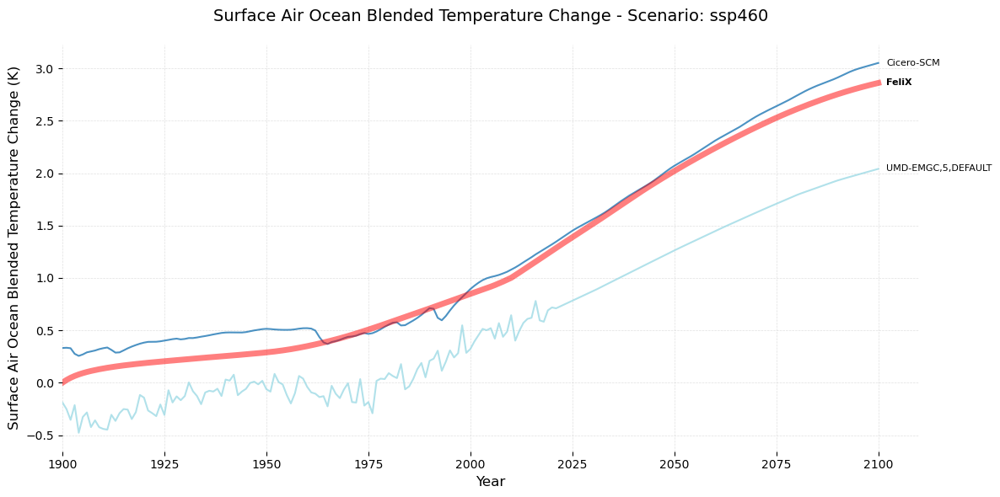

Original data shape: (11371, 1625)
After variable filtering: (81, 1625)
After scenario filtering: (2, 1625)
After region filtering: (2, 1625)
After year range filtering: (2, 206)
After excluding models: (2, 206)


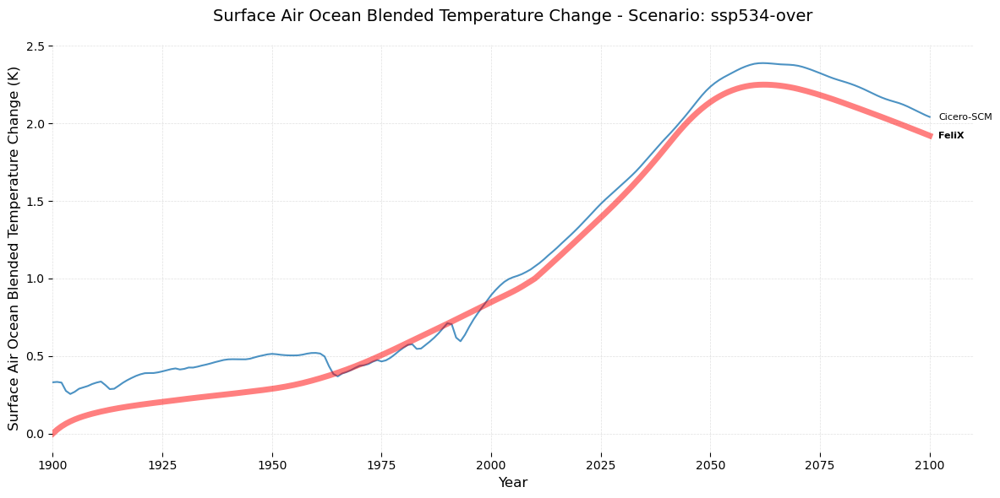

Original data shape: (11371, 1625)
After variable filtering: (81, 1625)
After scenario filtering: (3, 1625)
After region filtering: (3, 1625)
After year range filtering: (3, 206)
After excluding models: (3, 206)


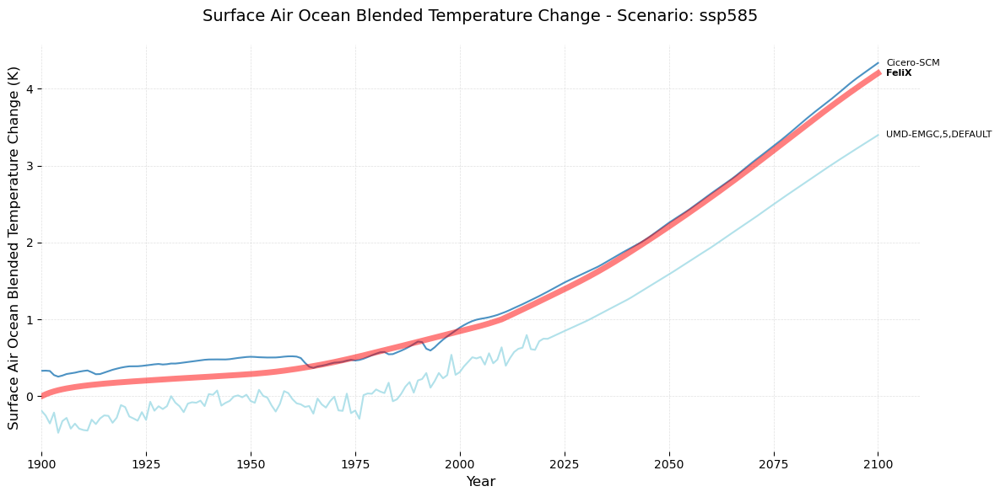

Original data shape: (11371, 1625)
After variable filtering: (81, 1625)
After scenario filtering: (1, 1625)
After region filtering: (1, 1625)
After year range filtering: (1, 206)
After excluding models: (1, 206)


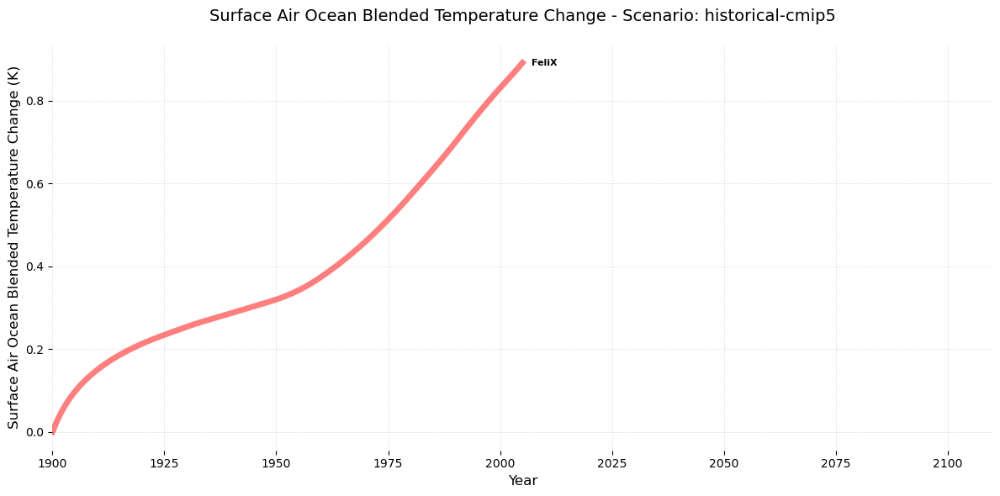

Original data shape: (11371, 1625)
After variable filtering: (1184, 1625)
After scenario filtering: (14, 1625)
After region filtering: (14, 1625)
After year range filtering: (14, 206)
After excluding models: (14, 206)


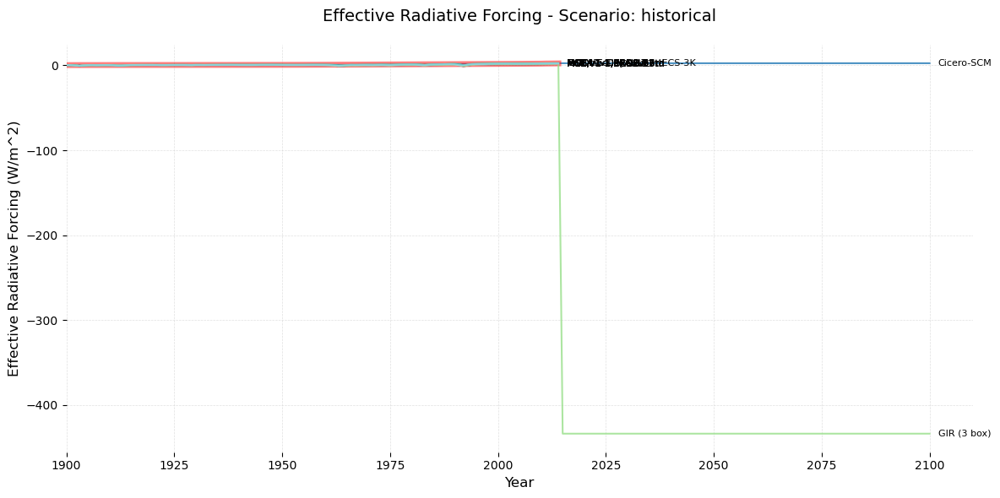

Original data shape: (11371, 1625)
After variable filtering: (1184, 1625)
After scenario filtering: (7, 1625)
After region filtering: (7, 1625)
After year range filtering: (7, 206)
After excluding models: (7, 206)


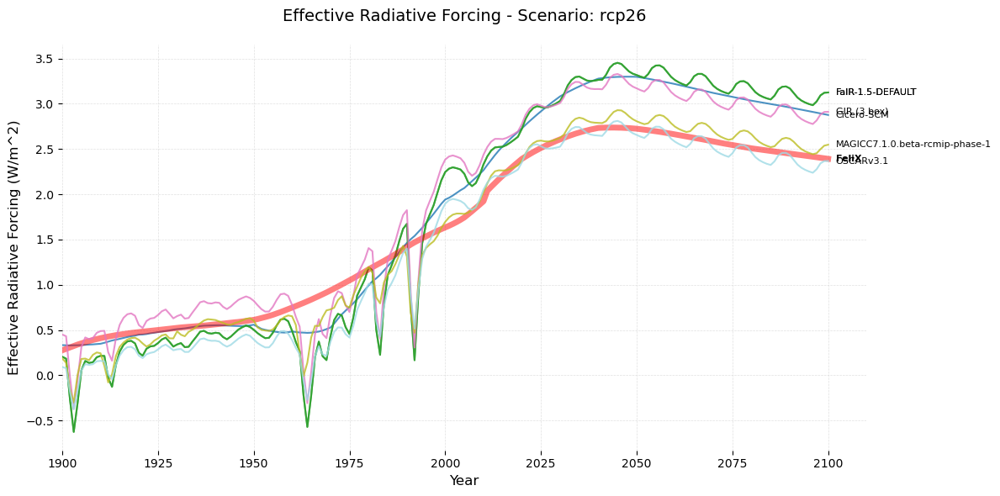

Original data shape: (11371, 1625)
After variable filtering: (1184, 1625)
After scenario filtering: (7, 1625)
After region filtering: (7, 1625)
After year range filtering: (7, 206)
After excluding models: (7, 206)


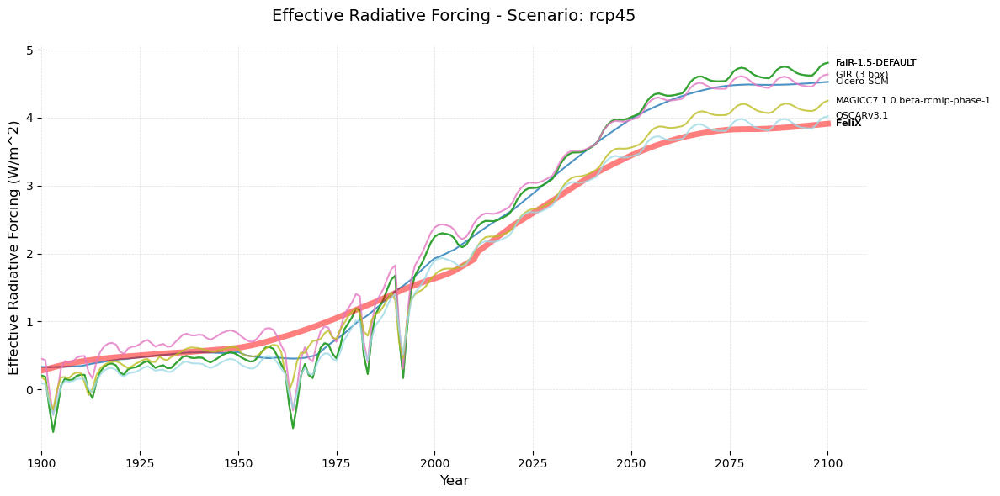

Original data shape: (11371, 1625)
After variable filtering: (1184, 1625)
After scenario filtering: (7, 1625)
After region filtering: (7, 1625)
After year range filtering: (7, 206)
After excluding models: (7, 206)


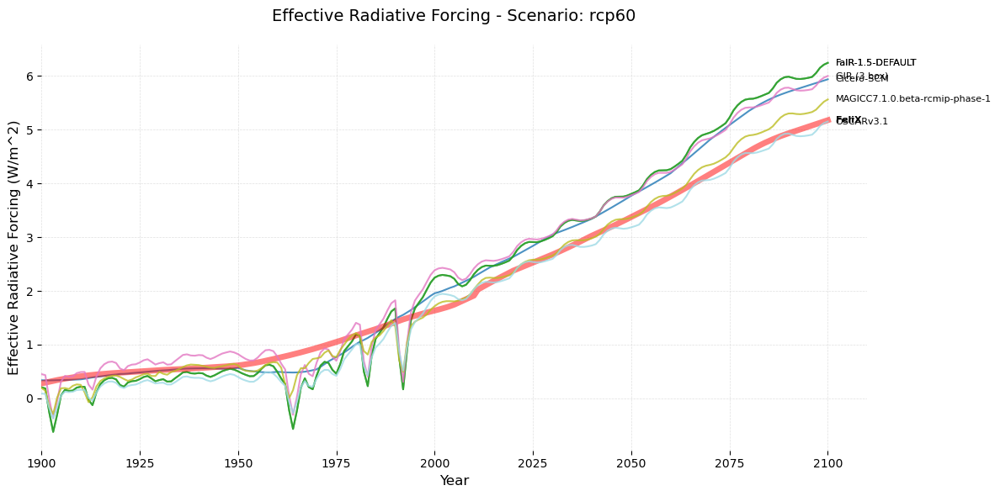

Original data shape: (11371, 1625)
After variable filtering: (1184, 1625)
After scenario filtering: (7, 1625)
After region filtering: (7, 1625)
After year range filtering: (7, 206)
After excluding models: (7, 206)


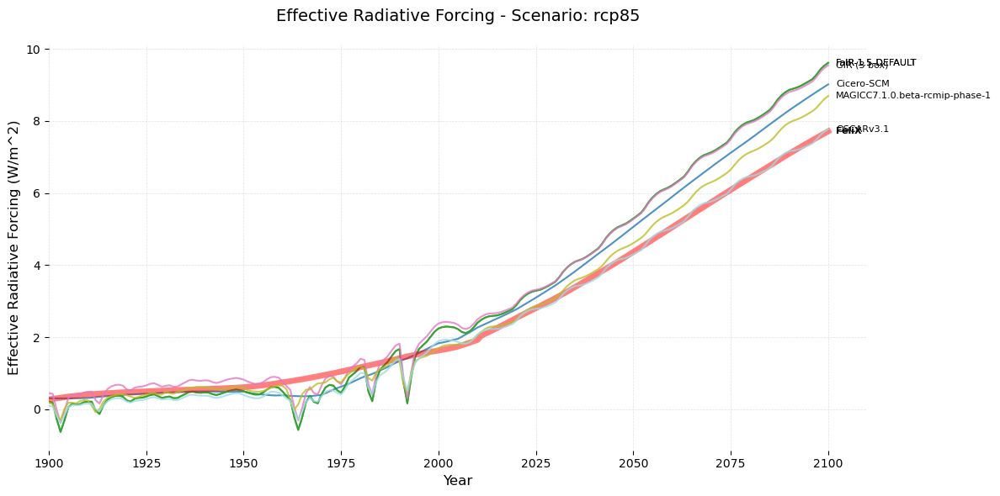

Original data shape: (11371, 1625)
After variable filtering: (1184, 1625)
After scenario filtering: (15, 1625)
After region filtering: (15, 1625)
After year range filtering: (15, 206)
After excluding models: (15, 206)


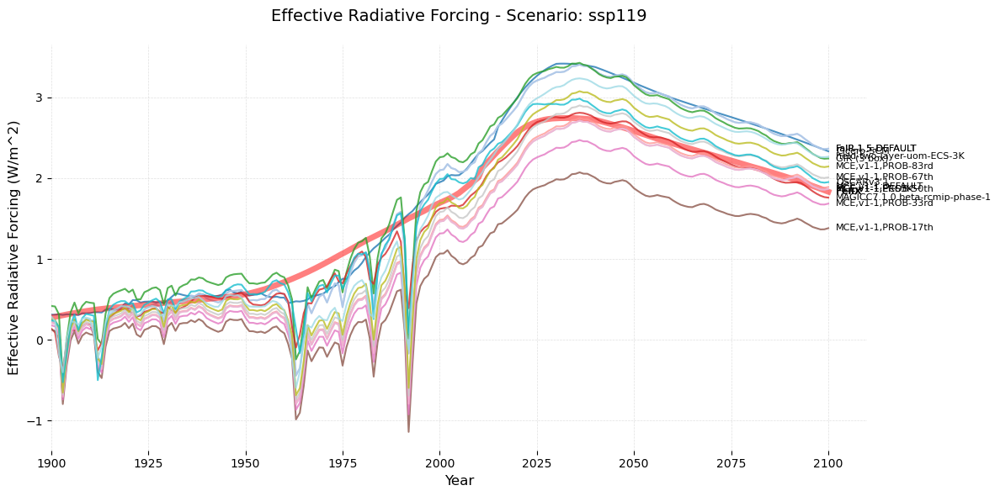

Original data shape: (11371, 1625)
After variable filtering: (1184, 1625)
After scenario filtering: (15, 1625)
After region filtering: (15, 1625)
After year range filtering: (15, 206)
After excluding models: (15, 206)


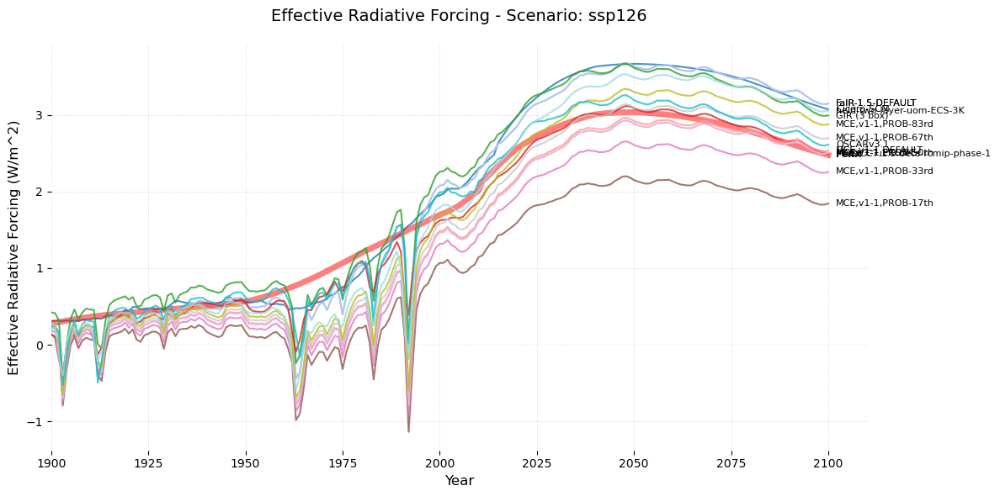

Original data shape: (11371, 1625)
After variable filtering: (1184, 1625)
After scenario filtering: (15, 1625)
After region filtering: (15, 1625)
After year range filtering: (15, 206)
After excluding models: (15, 206)


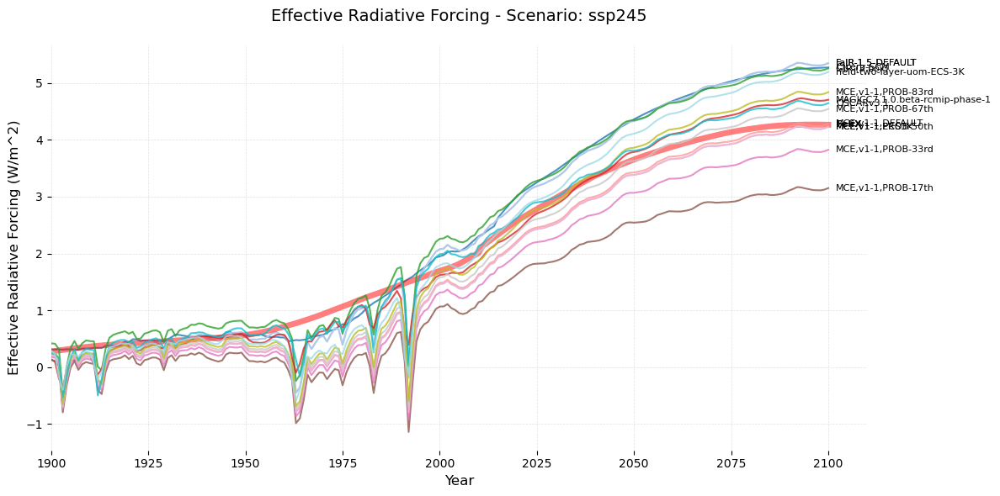

Original data shape: (11371, 1625)
After variable filtering: (1184, 1625)
After scenario filtering: (15, 1625)
After region filtering: (15, 1625)
After year range filtering: (15, 206)
After excluding models: (15, 206)


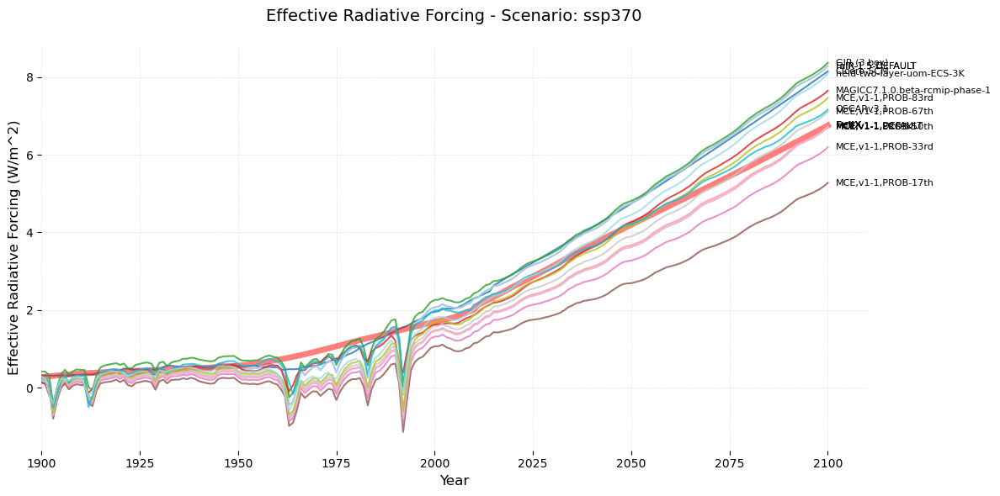

Original data shape: (11371, 1625)
After variable filtering: (1184, 1625)
After scenario filtering: (13, 1625)
After region filtering: (13, 1625)
After year range filtering: (13, 206)
After excluding models: (13, 206)


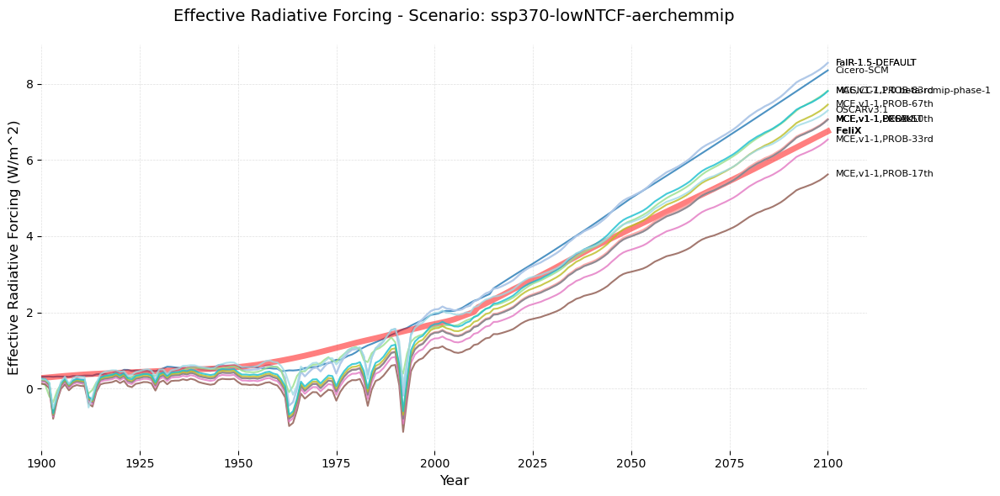

Original data shape: (11371, 1625)
After variable filtering: (1184, 1625)
After scenario filtering: (11, 1625)
After region filtering: (11, 1625)
After year range filtering: (11, 206)
After excluding models: (11, 206)


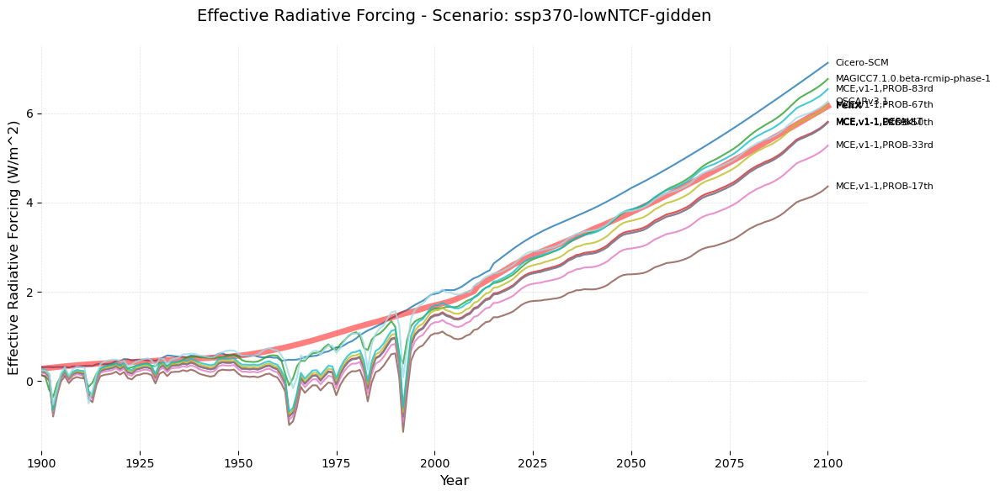

Original data shape: (11371, 1625)
After variable filtering: (1184, 1625)
After scenario filtering: (15, 1625)
After region filtering: (15, 1625)
After year range filtering: (15, 206)
After excluding models: (15, 206)


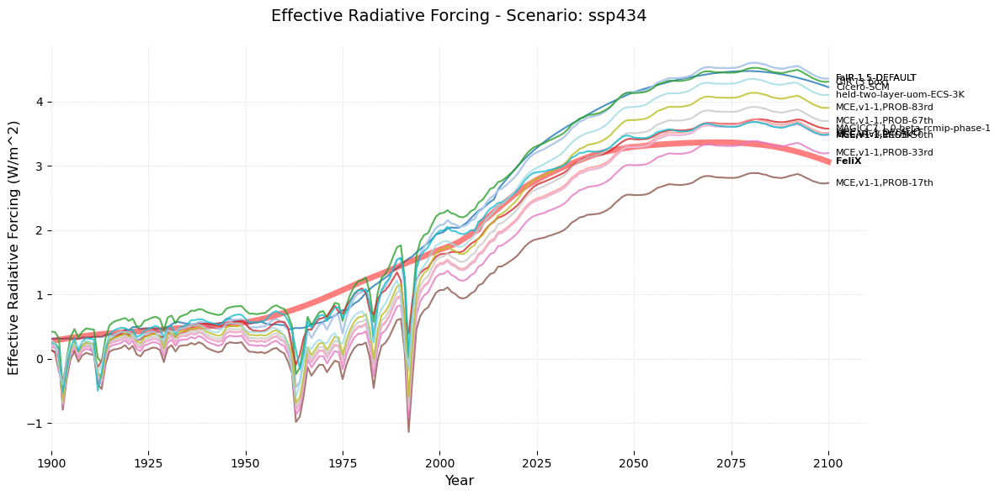

Original data shape: (11371, 1625)
After variable filtering: (1184, 1625)
After scenario filtering: (15, 1625)
After region filtering: (15, 1625)
After year range filtering: (15, 206)
After excluding models: (15, 206)


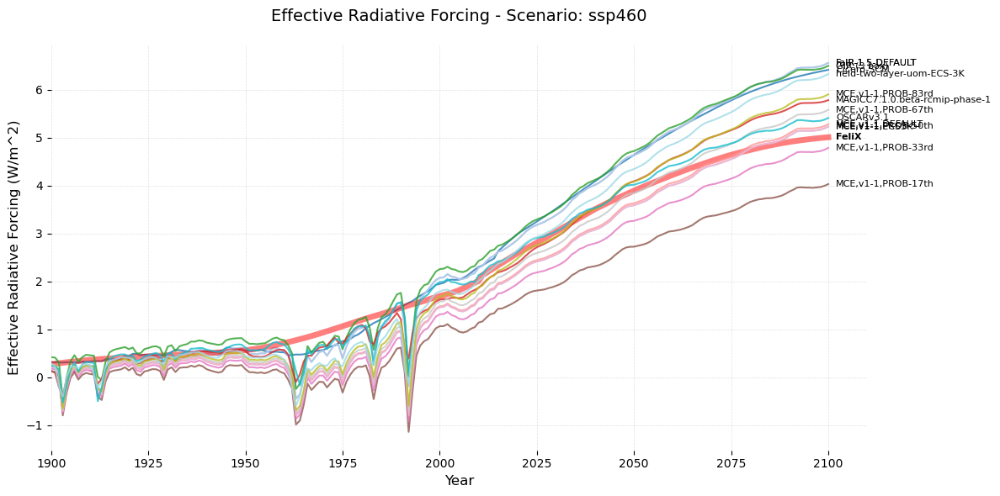

Original data shape: (11371, 1625)
After variable filtering: (1184, 1625)
After scenario filtering: (15, 1625)
After region filtering: (15, 1625)
After year range filtering: (15, 206)
After excluding models: (15, 206)


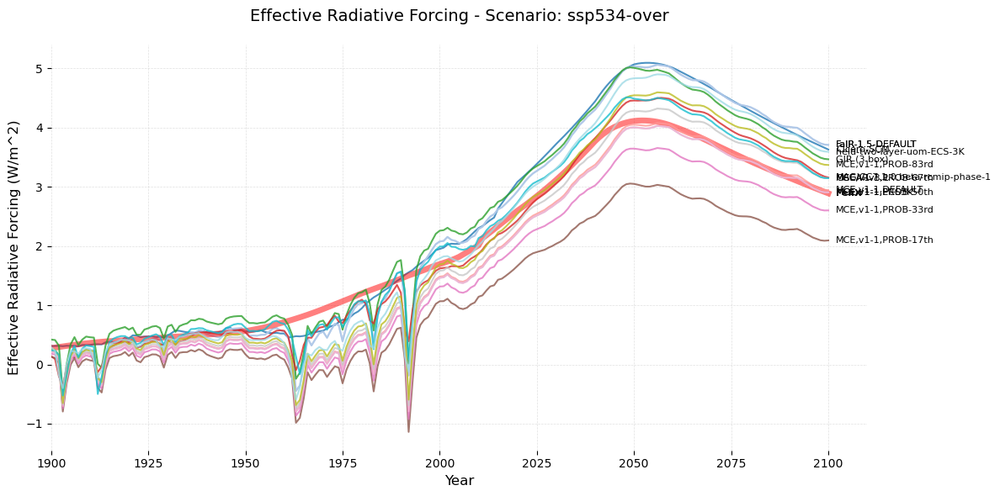

Original data shape: (11371, 1625)
After variable filtering: (1184, 1625)
After scenario filtering: (15, 1625)
After region filtering: (15, 1625)
After year range filtering: (15, 206)
After excluding models: (15, 206)


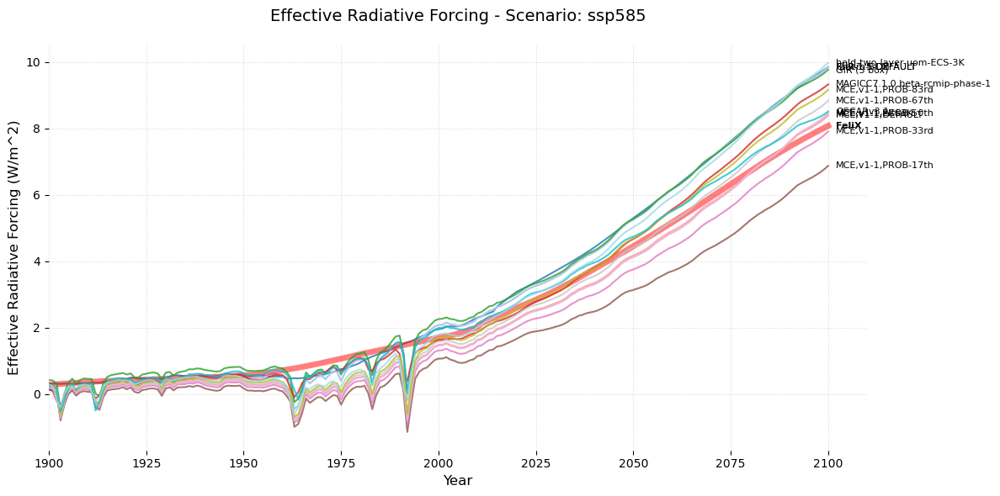

Original data shape: (11371, 1625)
After variable filtering: (1184, 1625)
After scenario filtering: (5, 1625)
After region filtering: (5, 1625)
After year range filtering: (5, 206)
After excluding models: (5, 206)


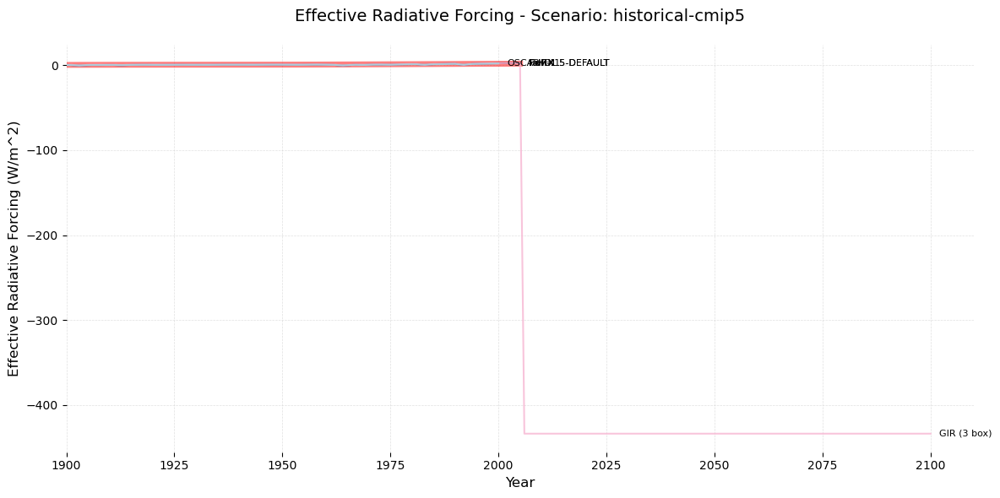

Original data shape: (11371, 1625)
After variable filtering: (345, 1625)
After scenario filtering: (5, 1625)
After region filtering: (5, 1625)
After year range filtering: (5, 206)
After excluding models: (5, 206)


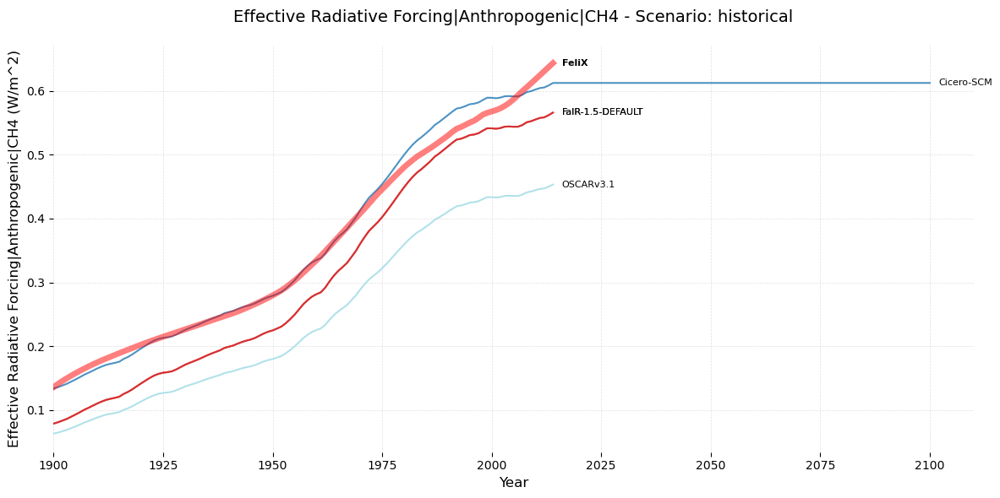

Original data shape: (11371, 1625)
After variable filtering: (345, 1625)
After scenario filtering: (6, 1625)
After region filtering: (6, 1625)
After year range filtering: (6, 206)
After excluding models: (6, 206)


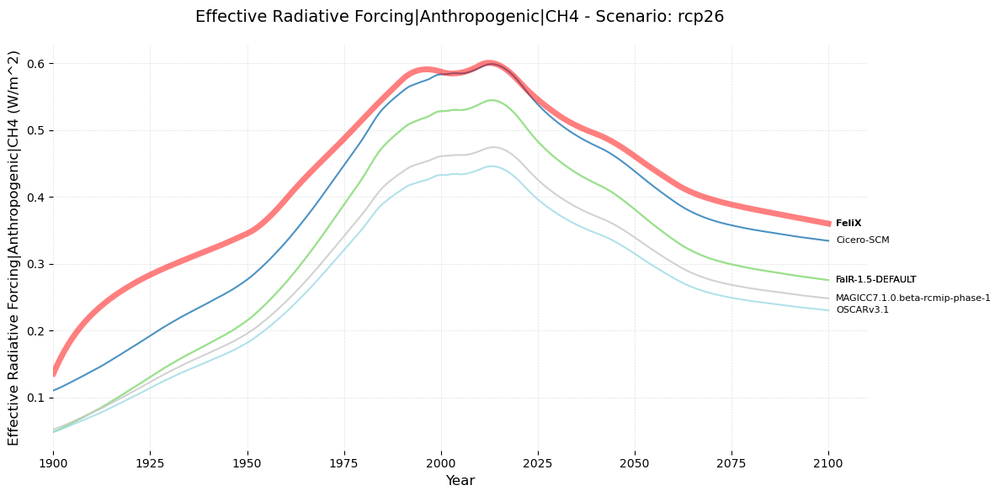

Original data shape: (11371, 1625)
After variable filtering: (345, 1625)
After scenario filtering: (6, 1625)
After region filtering: (6, 1625)
After year range filtering: (6, 206)
After excluding models: (6, 206)


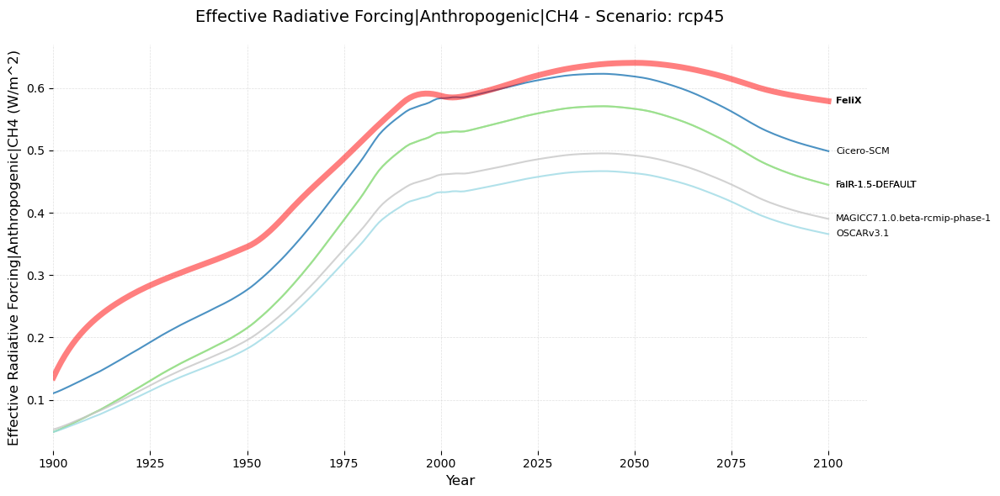

Original data shape: (11371, 1625)
After variable filtering: (345, 1625)
After scenario filtering: (6, 1625)
After region filtering: (6, 1625)
After year range filtering: (6, 206)
After excluding models: (6, 206)


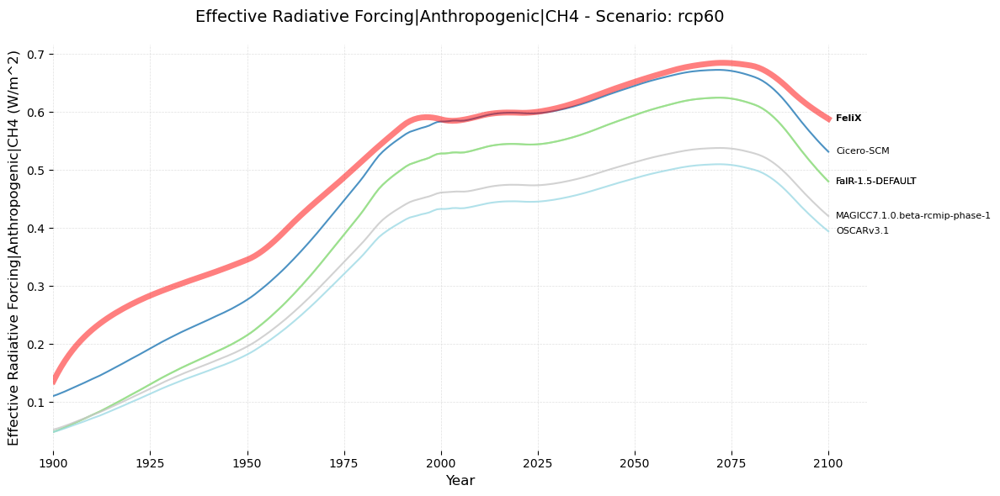

Original data shape: (11371, 1625)
After variable filtering: (345, 1625)
After scenario filtering: (6, 1625)
After region filtering: (6, 1625)
After year range filtering: (6, 206)
After excluding models: (6, 206)


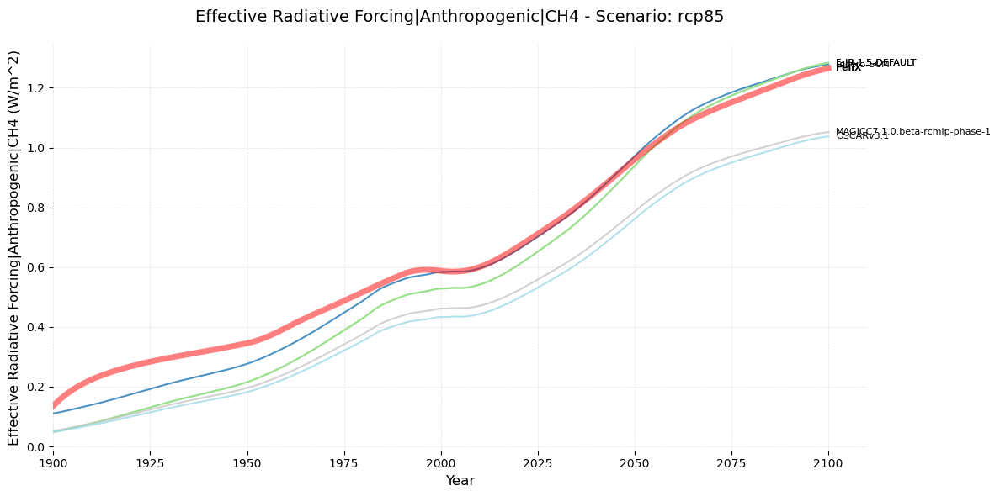

Original data shape: (11371, 1625)
After variable filtering: (345, 1625)
After scenario filtering: (6, 1625)
After region filtering: (6, 1625)
After year range filtering: (6, 206)
After excluding models: (6, 206)


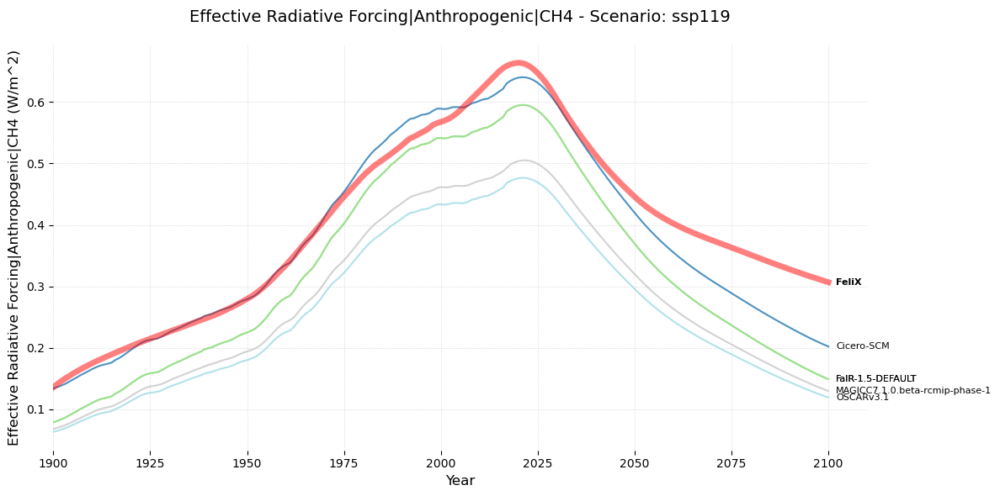

Original data shape: (11371, 1625)
After variable filtering: (345, 1625)
After scenario filtering: (6, 1625)
After region filtering: (6, 1625)
After year range filtering: (6, 206)
After excluding models: (6, 206)


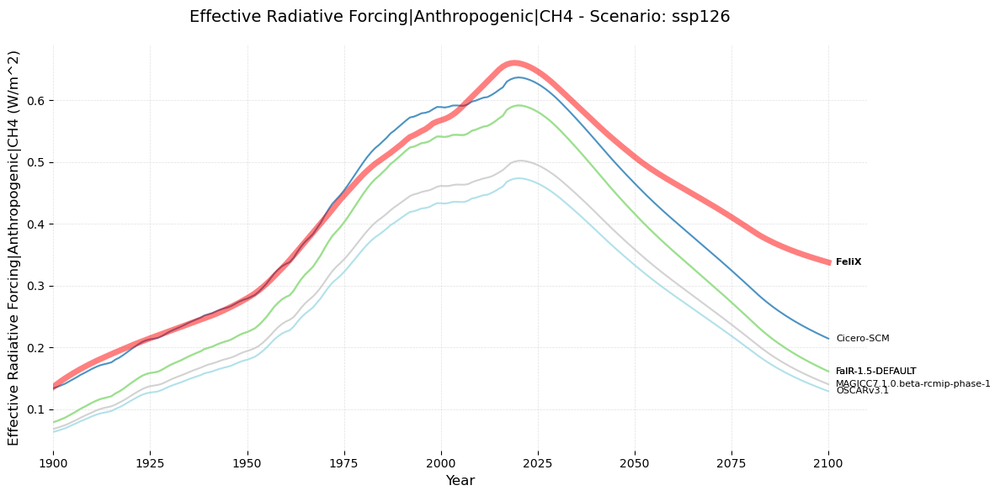

Original data shape: (11371, 1625)
After variable filtering: (345, 1625)
After scenario filtering: (6, 1625)
After region filtering: (6, 1625)
After year range filtering: (6, 206)
After excluding models: (6, 206)


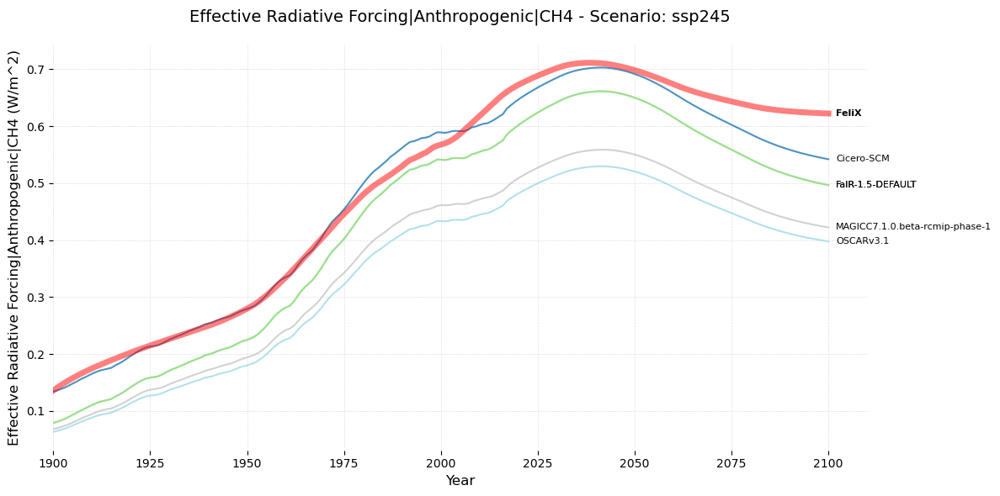

Original data shape: (11371, 1625)
After variable filtering: (345, 1625)
After scenario filtering: (6, 1625)
After region filtering: (6, 1625)
After year range filtering: (6, 206)
After excluding models: (6, 206)


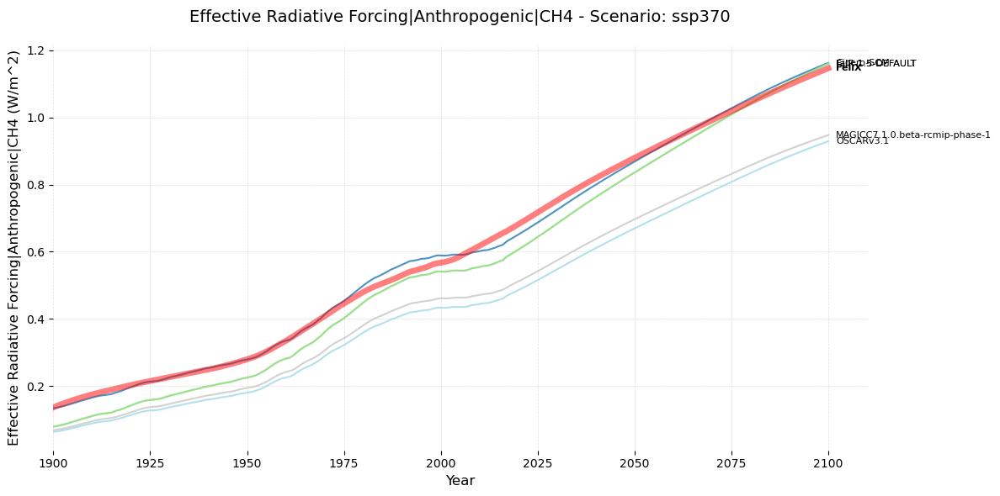

Original data shape: (11371, 1625)
After variable filtering: (345, 1625)
After scenario filtering: (6, 1625)
After region filtering: (6, 1625)
After year range filtering: (6, 206)
After excluding models: (6, 206)


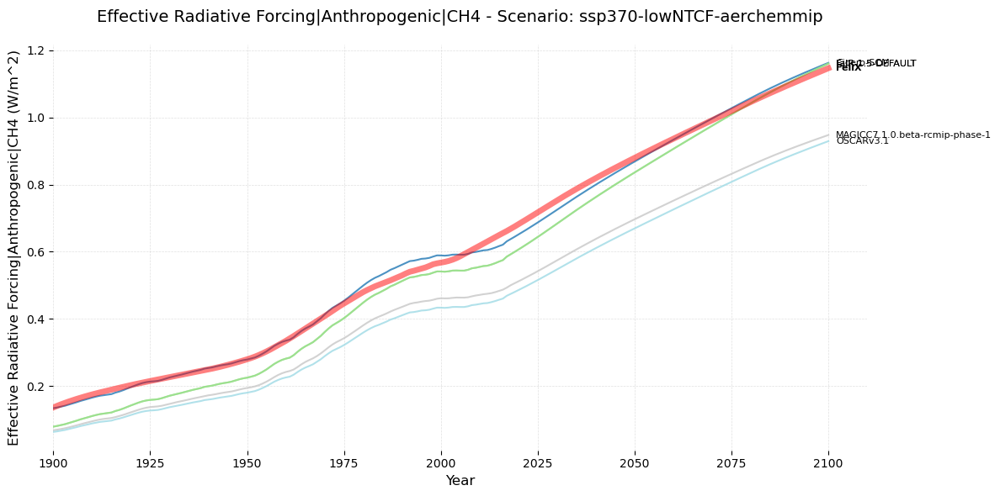

Original data shape: (11371, 1625)
After variable filtering: (345, 1625)
After scenario filtering: (4, 1625)
After region filtering: (4, 1625)
After year range filtering: (4, 206)
After excluding models: (4, 206)


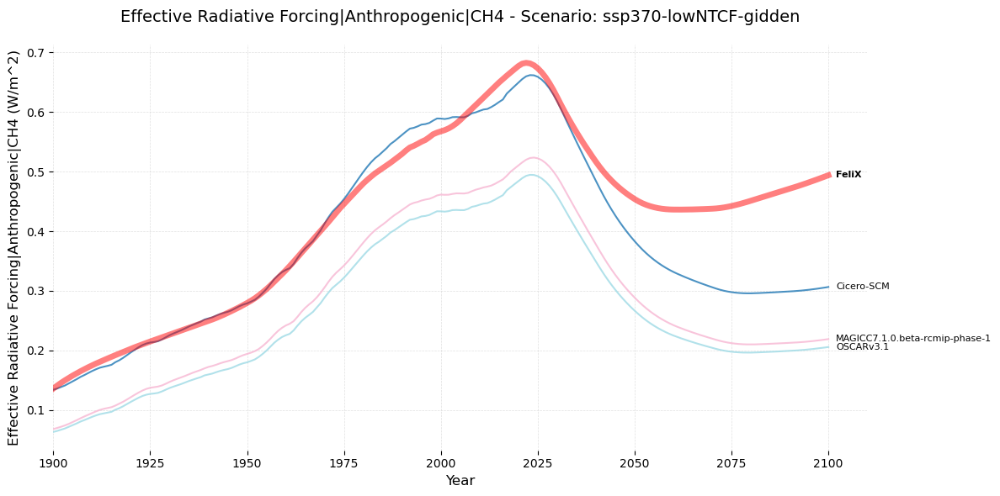

Original data shape: (11371, 1625)
After variable filtering: (345, 1625)
After scenario filtering: (6, 1625)
After region filtering: (6, 1625)
After year range filtering: (6, 206)
After excluding models: (6, 206)


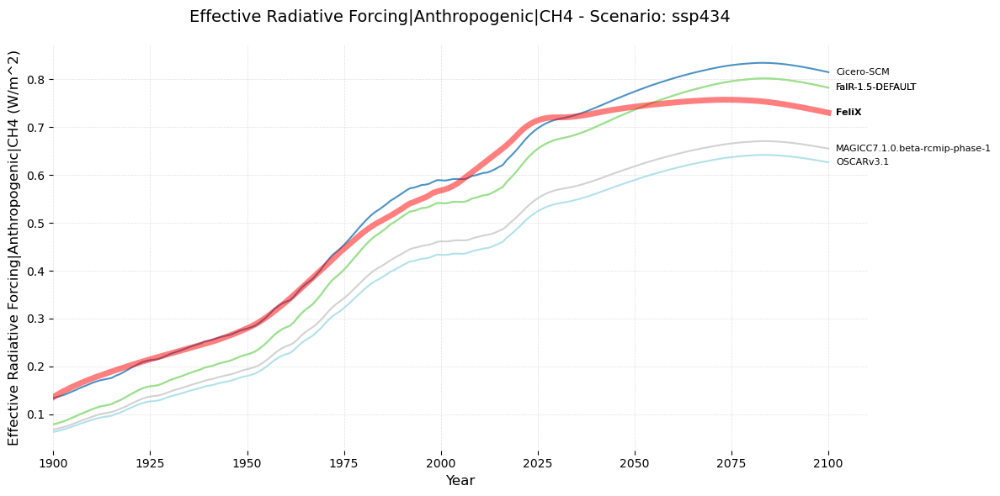

Original data shape: (11371, 1625)
After variable filtering: (345, 1625)
After scenario filtering: (6, 1625)
After region filtering: (6, 1625)
After year range filtering: (6, 206)
After excluding models: (6, 206)


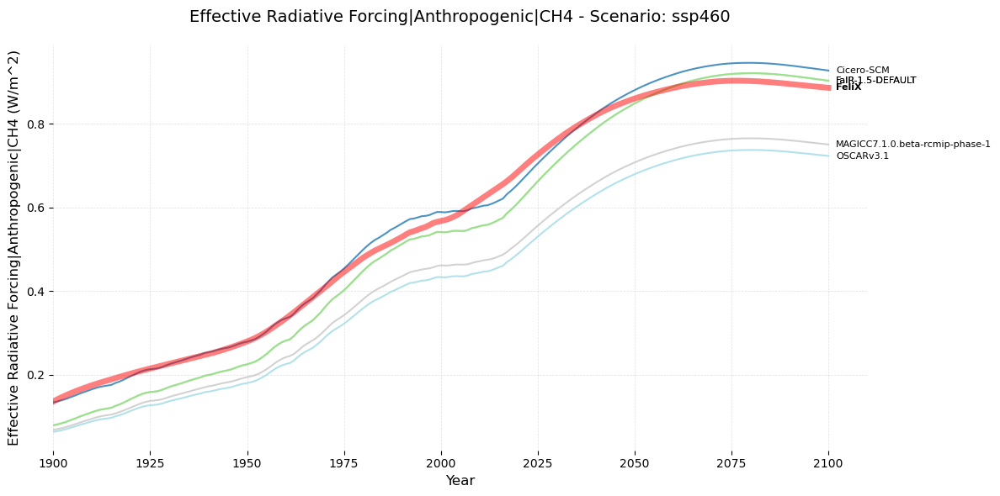

Original data shape: (11371, 1625)
After variable filtering: (345, 1625)
After scenario filtering: (6, 1625)
After region filtering: (6, 1625)
After year range filtering: (6, 206)
After excluding models: (6, 206)


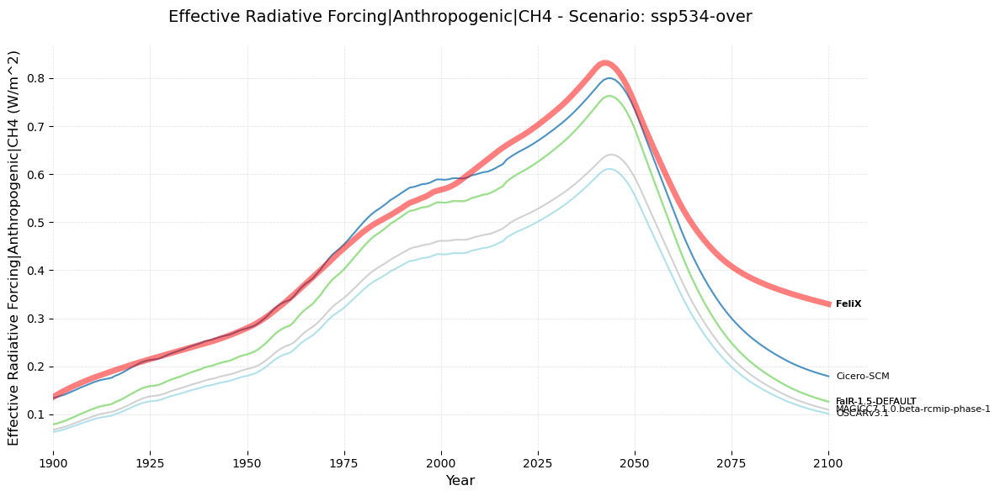

Original data shape: (11371, 1625)
After variable filtering: (345, 1625)
After scenario filtering: (6, 1625)
After region filtering: (6, 1625)
After year range filtering: (6, 206)
After excluding models: (6, 206)


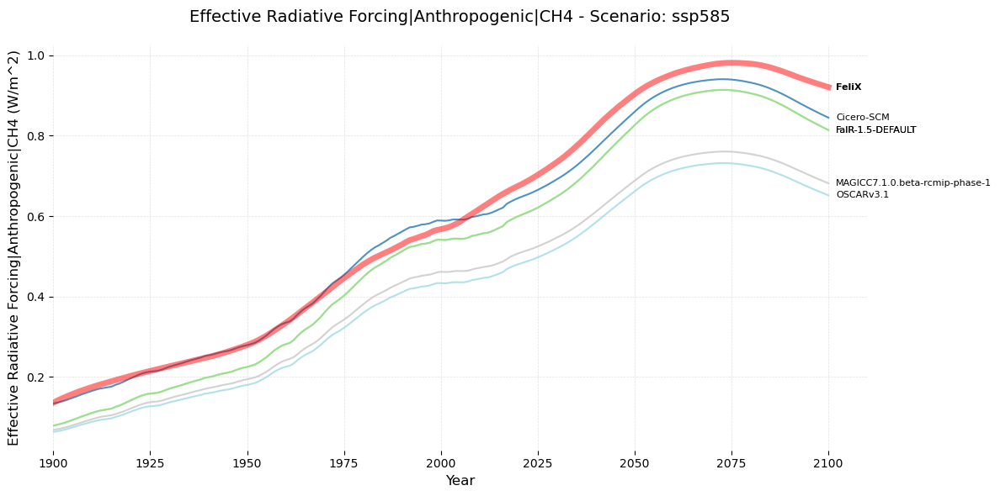

Original data shape: (11371, 1625)
After variable filtering: (345, 1625)
After scenario filtering: (4, 1625)
After region filtering: (4, 1625)
After year range filtering: (4, 206)
After excluding models: (4, 206)


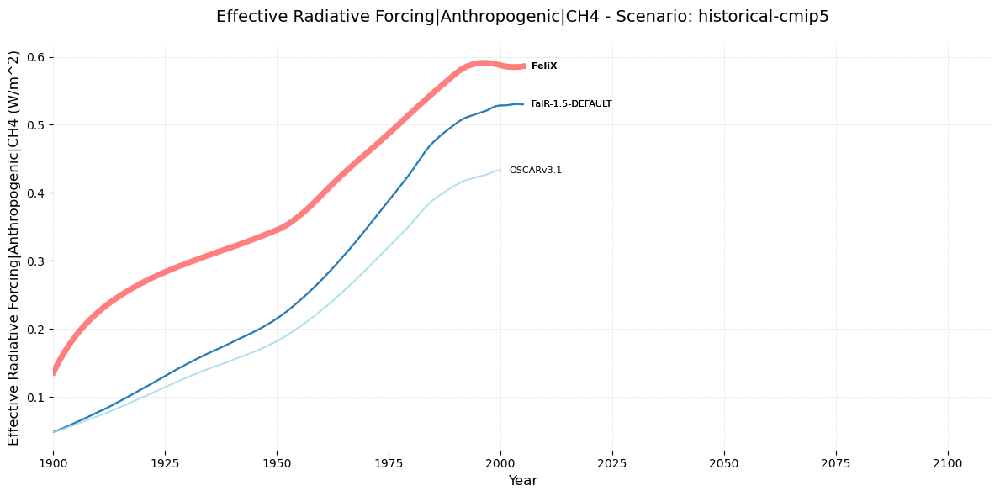

Original data shape: (11371, 1625)
After variable filtering: (627, 1625)
After scenario filtering: (8, 1625)
After region filtering: (8, 1625)
After year range filtering: (8, 206)
After excluding models: (8, 206)


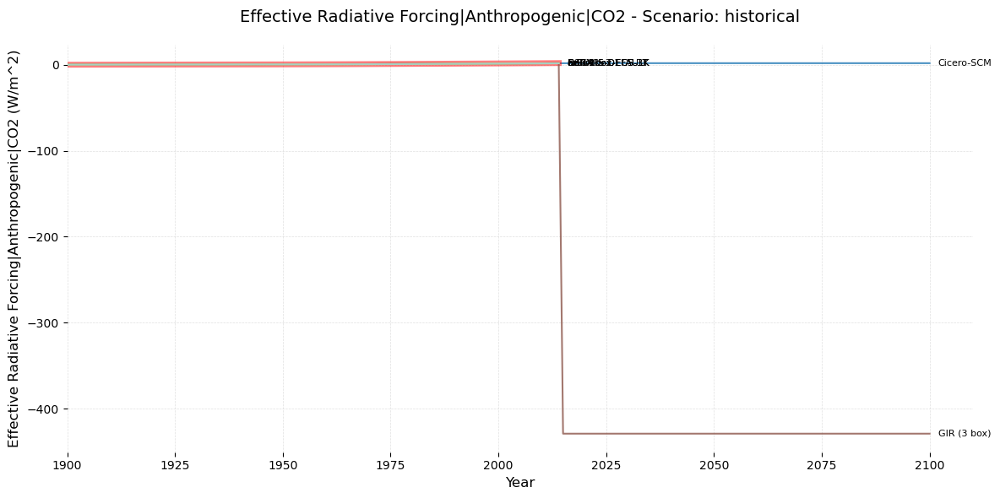

Original data shape: (11371, 1625)
After variable filtering: (627, 1625)
After scenario filtering: (7, 1625)
After region filtering: (7, 1625)
After year range filtering: (7, 206)
After excluding models: (7, 206)


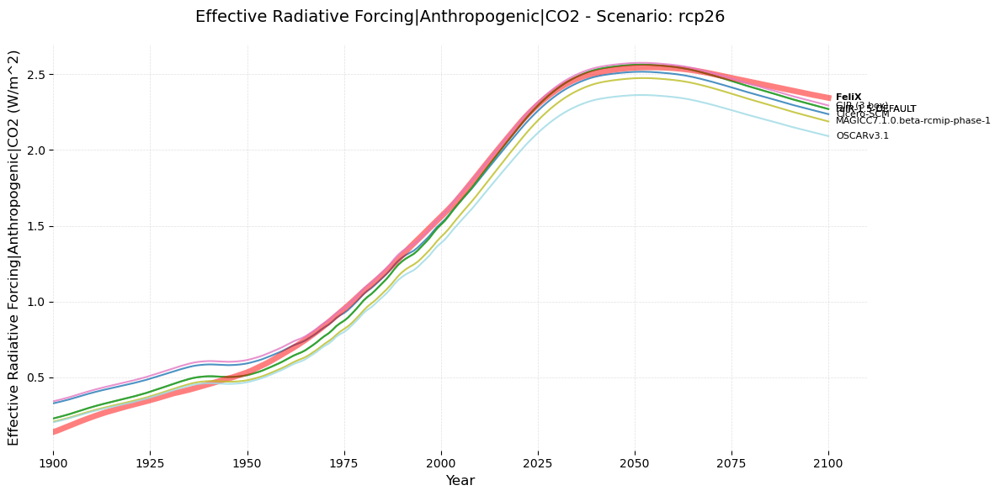

Original data shape: (11371, 1625)
After variable filtering: (627, 1625)
After scenario filtering: (7, 1625)
After region filtering: (7, 1625)
After year range filtering: (7, 206)
After excluding models: (7, 206)


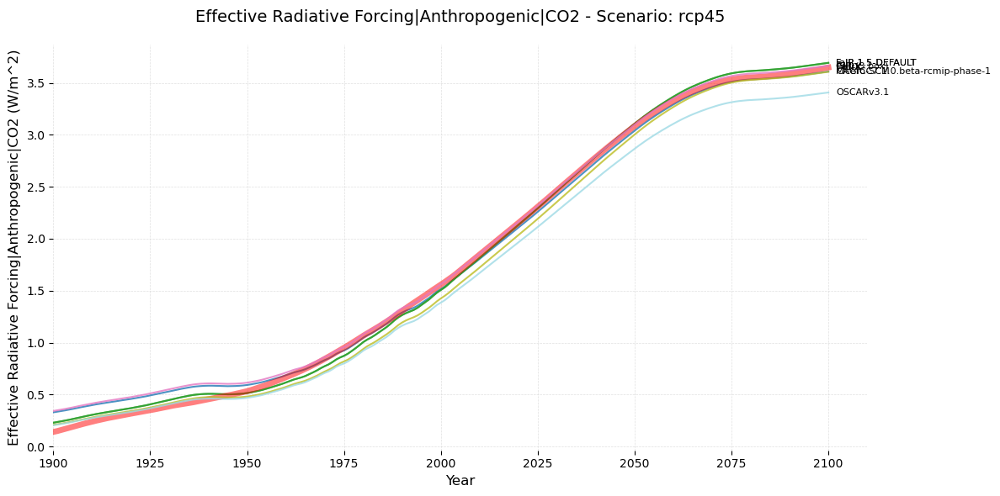

Original data shape: (11371, 1625)
After variable filtering: (627, 1625)
After scenario filtering: (7, 1625)
After region filtering: (7, 1625)
After year range filtering: (7, 206)
After excluding models: (7, 206)


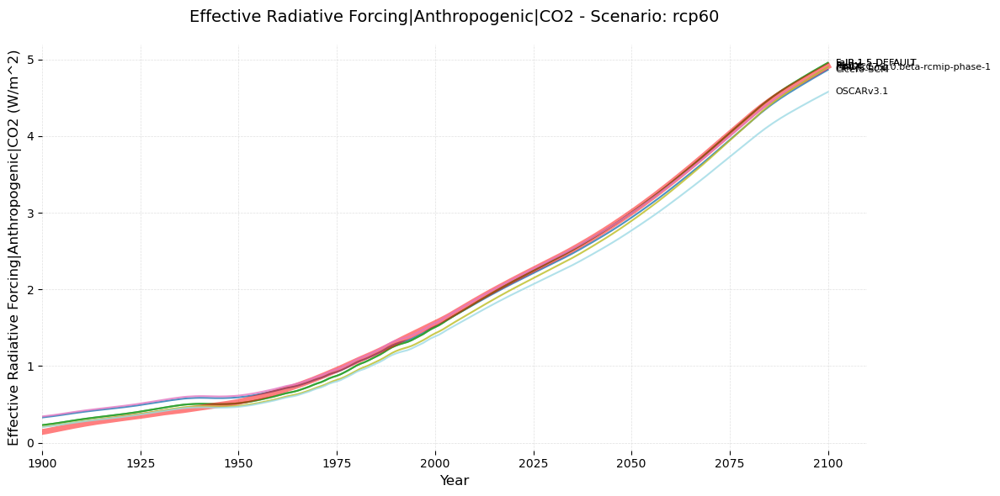

Original data shape: (11371, 1625)
After variable filtering: (627, 1625)
After scenario filtering: (7, 1625)
After region filtering: (7, 1625)
After year range filtering: (7, 206)
After excluding models: (7, 206)


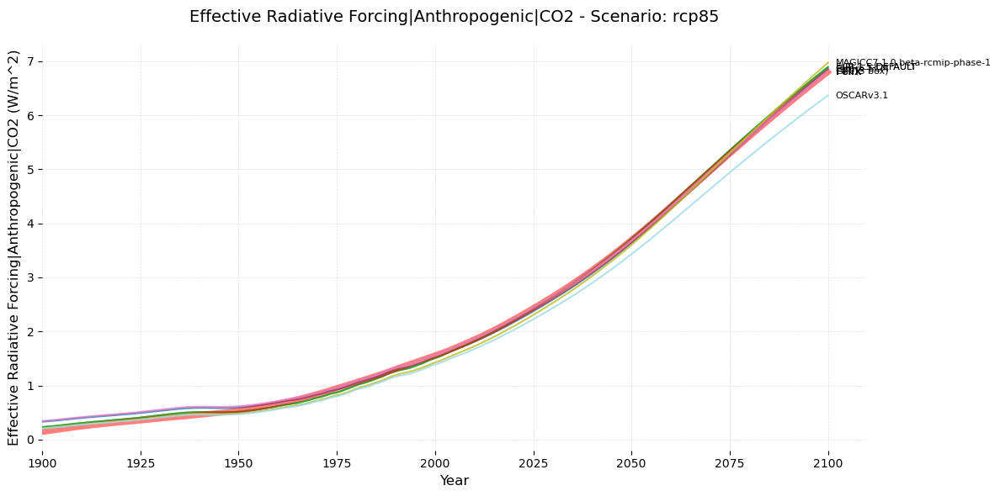

Original data shape: (11371, 1625)
After variable filtering: (627, 1625)
After scenario filtering: (9, 1625)
After region filtering: (9, 1625)
After year range filtering: (9, 206)
After excluding models: (9, 206)


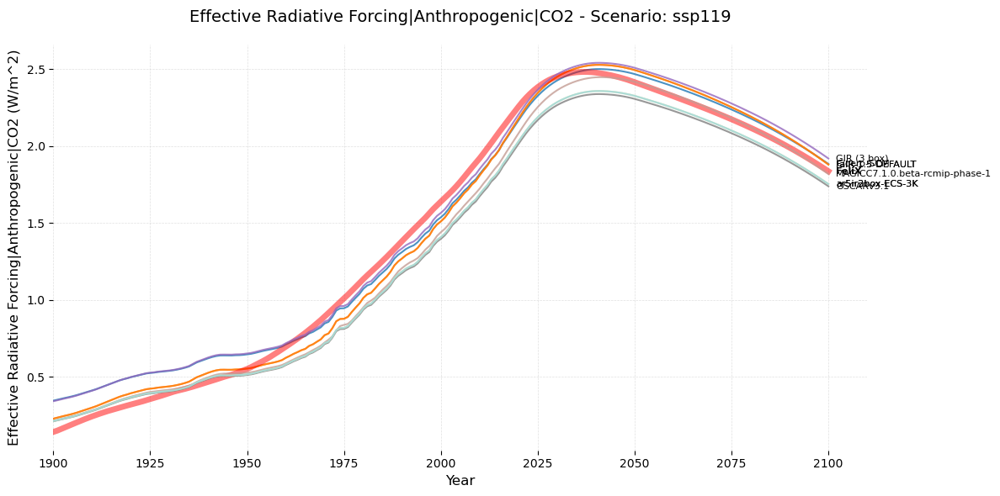

Original data shape: (11371, 1625)
After variable filtering: (627, 1625)
After scenario filtering: (9, 1625)
After region filtering: (9, 1625)
After year range filtering: (9, 206)
After excluding models: (9, 206)


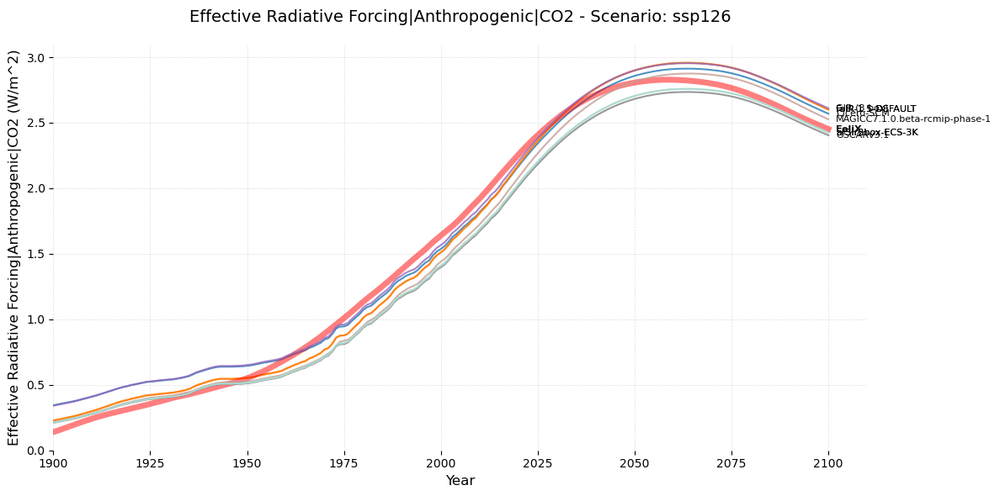

Original data shape: (11371, 1625)
After variable filtering: (627, 1625)
After scenario filtering: (9, 1625)
After region filtering: (9, 1625)
After year range filtering: (9, 206)
After excluding models: (9, 206)


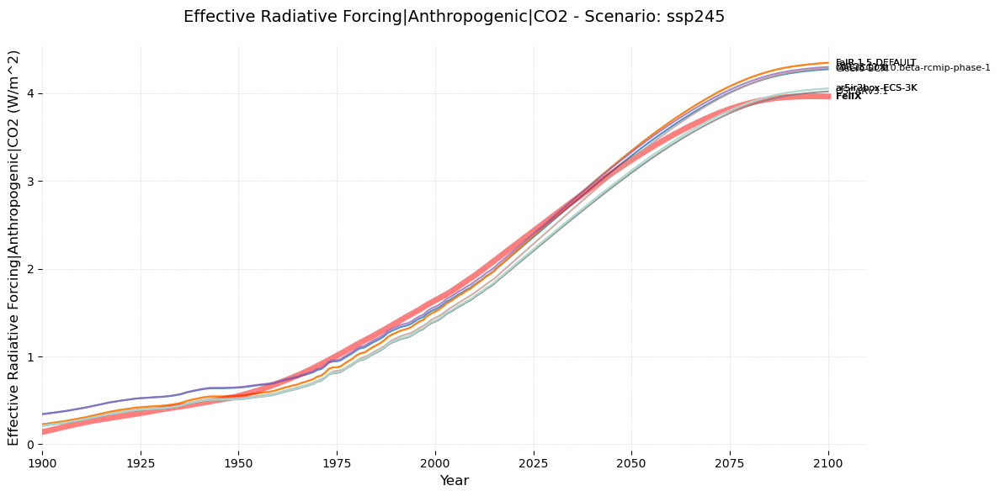

Original data shape: (11371, 1625)
After variable filtering: (627, 1625)
After scenario filtering: (9, 1625)
After region filtering: (9, 1625)
After year range filtering: (9, 206)
After excluding models: (9, 206)


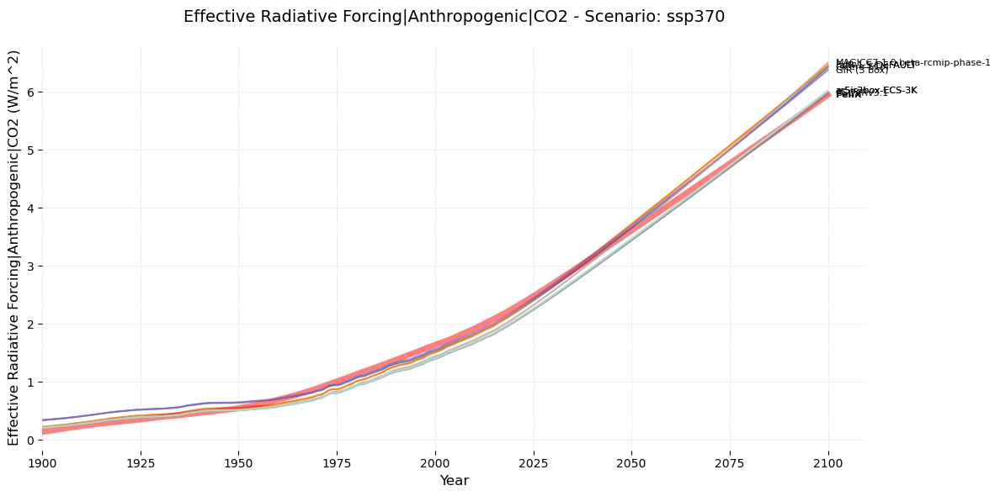

Original data shape: (11371, 1625)
After variable filtering: (627, 1625)
After scenario filtering: (6, 1625)
After region filtering: (6, 1625)
After year range filtering: (6, 206)
After excluding models: (6, 206)


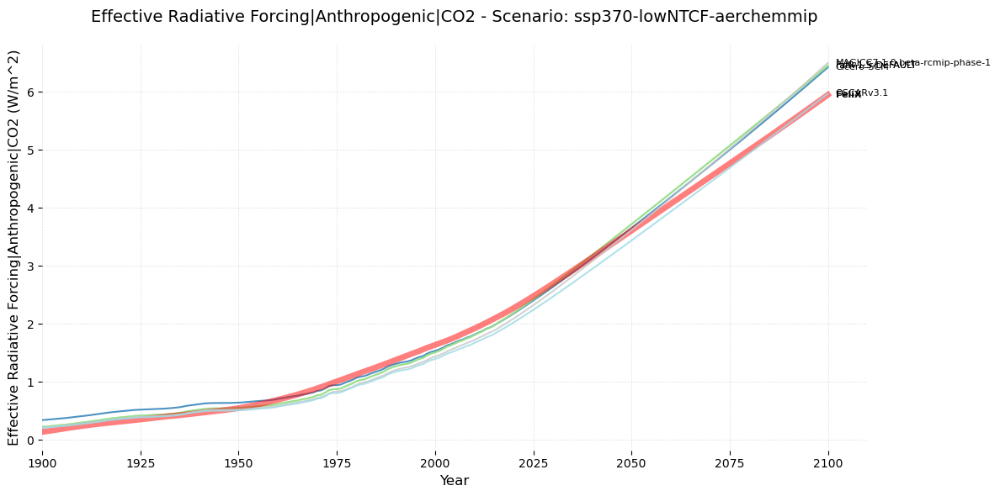

Original data shape: (11371, 1625)
After variable filtering: (627, 1625)
After scenario filtering: (4, 1625)
After region filtering: (4, 1625)
After year range filtering: (4, 206)
After excluding models: (4, 206)


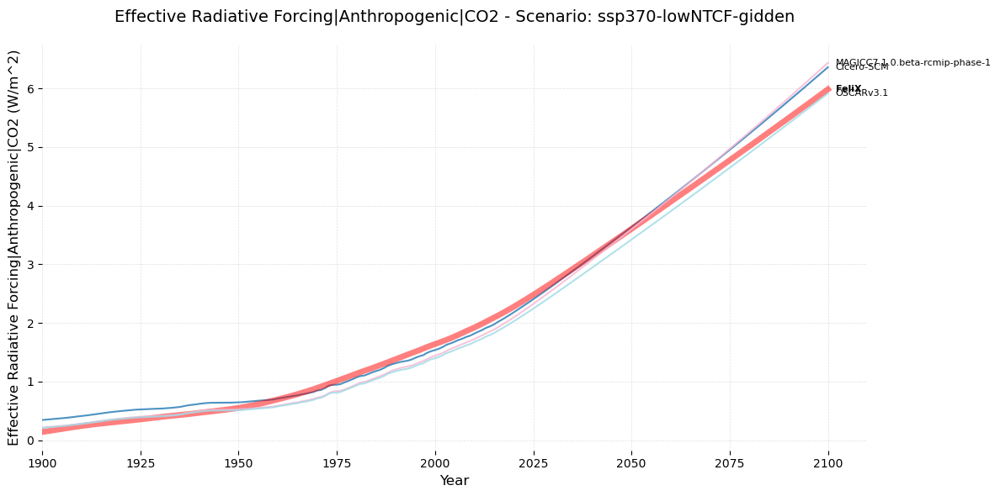

Original data shape: (11371, 1625)
After variable filtering: (627, 1625)
After scenario filtering: (9, 1625)
After region filtering: (9, 1625)
After year range filtering: (9, 206)
After excluding models: (9, 206)


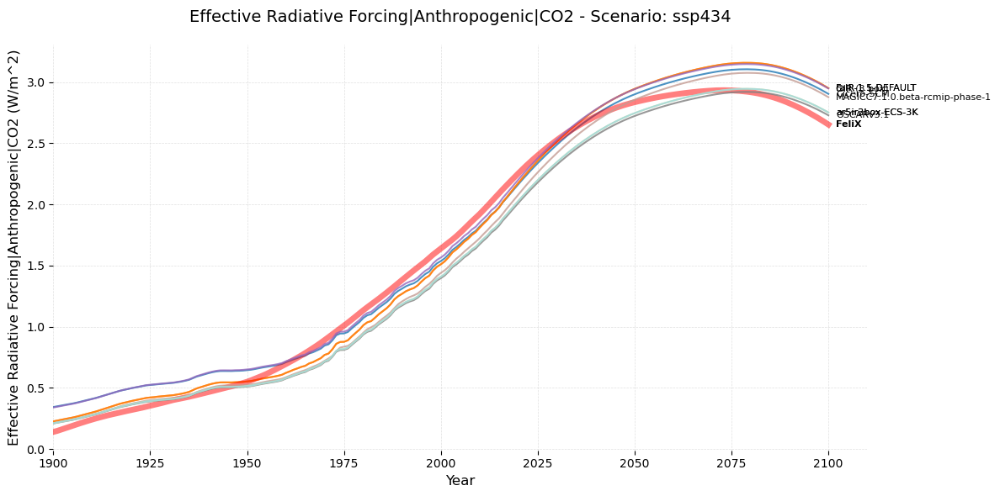

Original data shape: (11371, 1625)
After variable filtering: (627, 1625)
After scenario filtering: (9, 1625)
After region filtering: (9, 1625)
After year range filtering: (9, 206)
After excluding models: (9, 206)


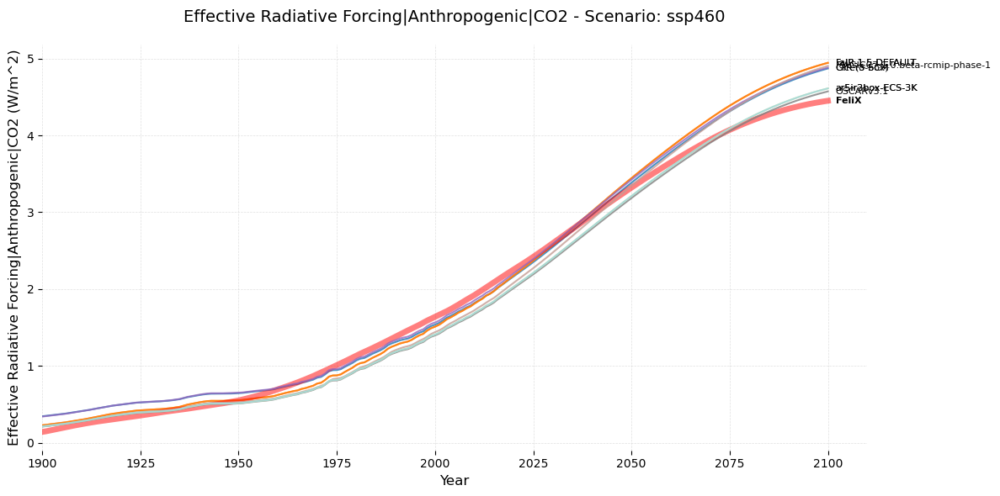

Original data shape: (11371, 1625)
After variable filtering: (627, 1625)
After scenario filtering: (9, 1625)
After region filtering: (9, 1625)
After year range filtering: (9, 206)
After excluding models: (9, 206)


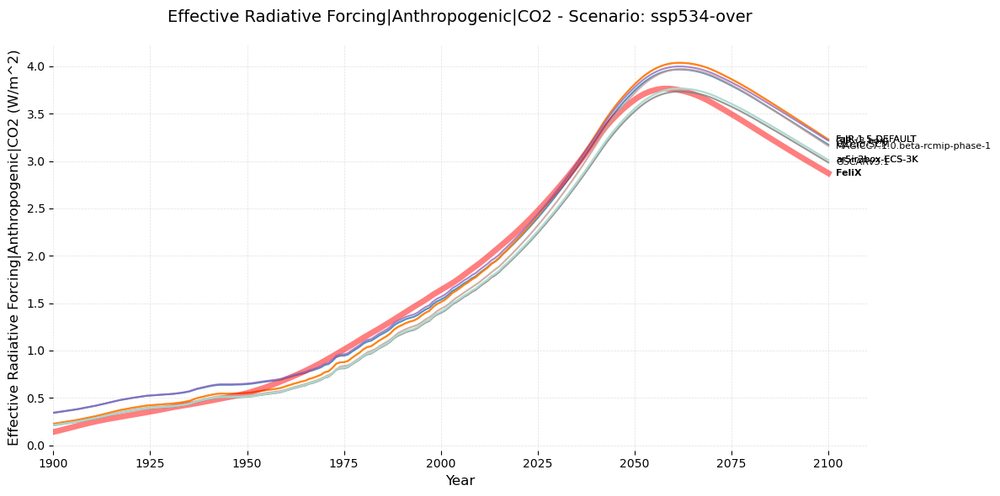

Original data shape: (11371, 1625)
After variable filtering: (627, 1625)
After scenario filtering: (9, 1625)
After region filtering: (9, 1625)
After year range filtering: (9, 206)
After excluding models: (9, 206)


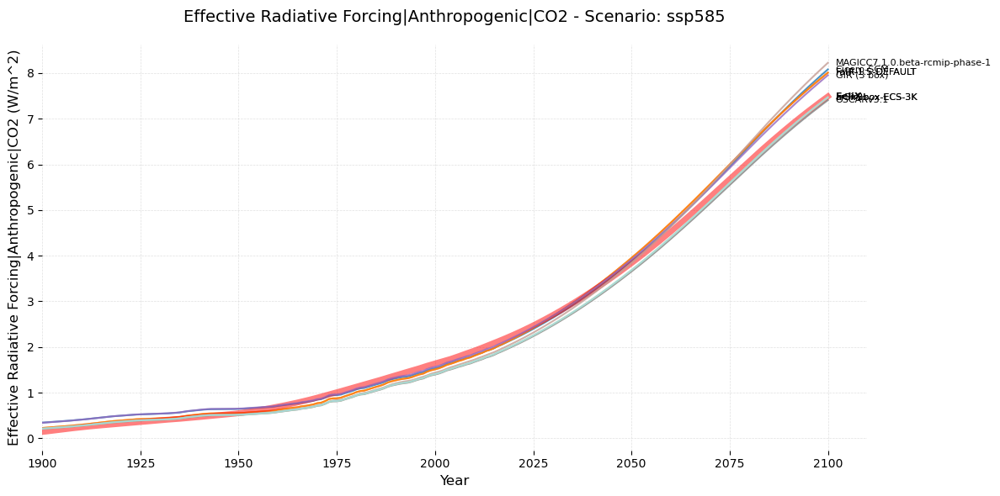

Original data shape: (11371, 1625)
After variable filtering: (627, 1625)
After scenario filtering: (5, 1625)
After region filtering: (5, 1625)
After year range filtering: (5, 206)
After excluding models: (5, 206)


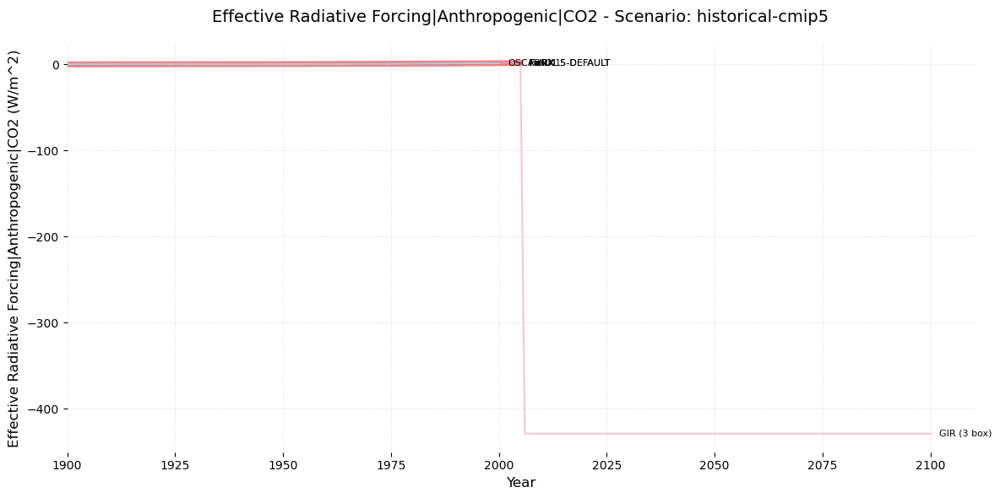

Original data shape: (11371, 1625)
After variable filtering: (352, 1625)
After scenario filtering: (5, 1625)
After region filtering: (5, 1625)
After year range filtering: (5, 206)
After excluding models: (5, 206)


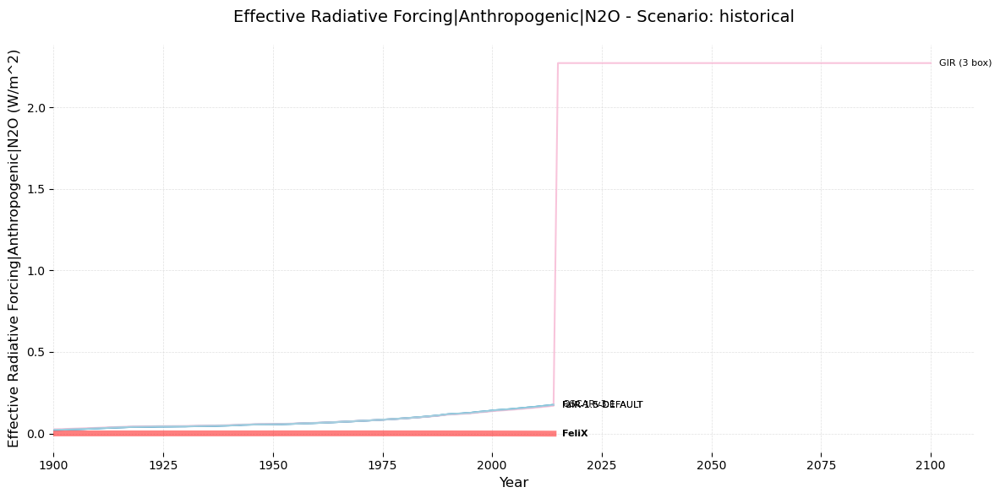

Original data shape: (11371, 1625)
After variable filtering: (352, 1625)
After scenario filtering: (6, 1625)
After region filtering: (6, 1625)
After year range filtering: (6, 206)
After excluding models: (6, 206)


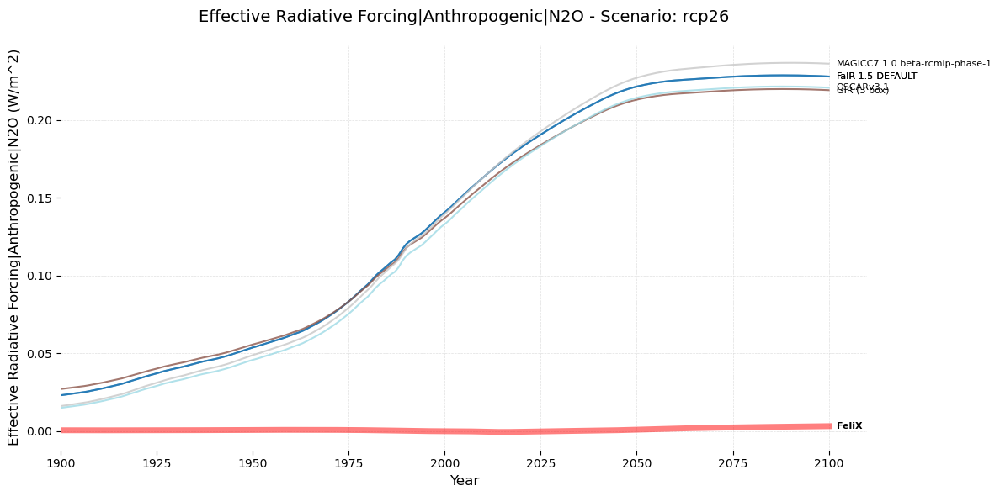

Original data shape: (11371, 1625)
After variable filtering: (352, 1625)
After scenario filtering: (6, 1625)
After region filtering: (6, 1625)
After year range filtering: (6, 206)
After excluding models: (6, 206)


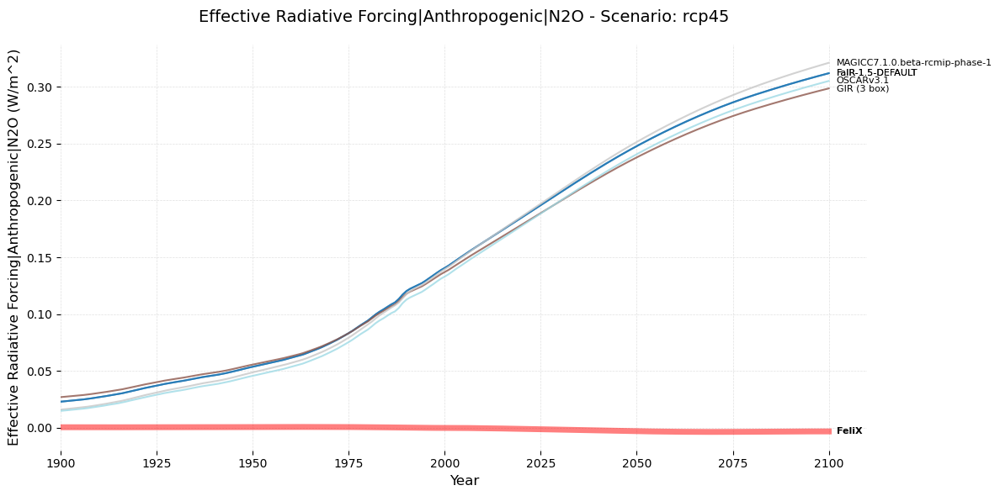

Original data shape: (11371, 1625)
After variable filtering: (352, 1625)
After scenario filtering: (6, 1625)
After region filtering: (6, 1625)
After year range filtering: (6, 206)
After excluding models: (6, 206)


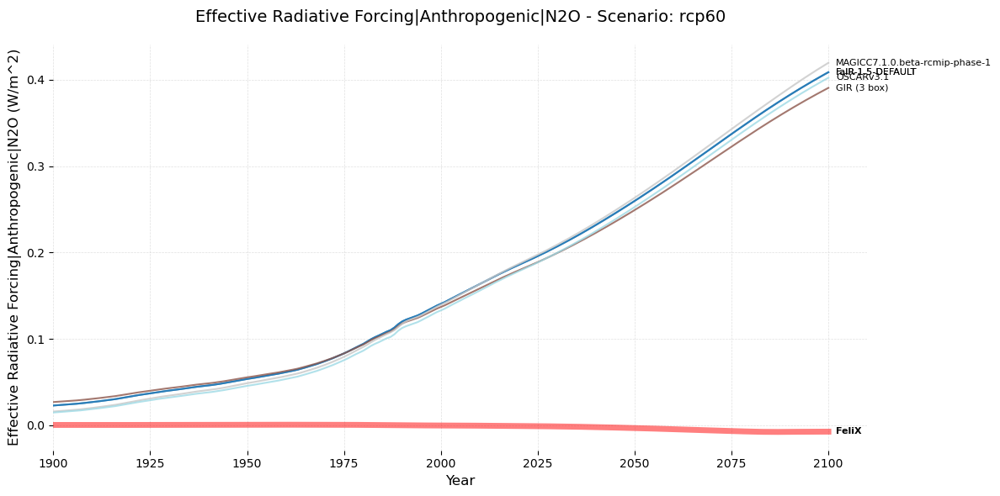

Original data shape: (11371, 1625)
After variable filtering: (352, 1625)
After scenario filtering: (6, 1625)
After region filtering: (6, 1625)
After year range filtering: (6, 206)
After excluding models: (6, 206)


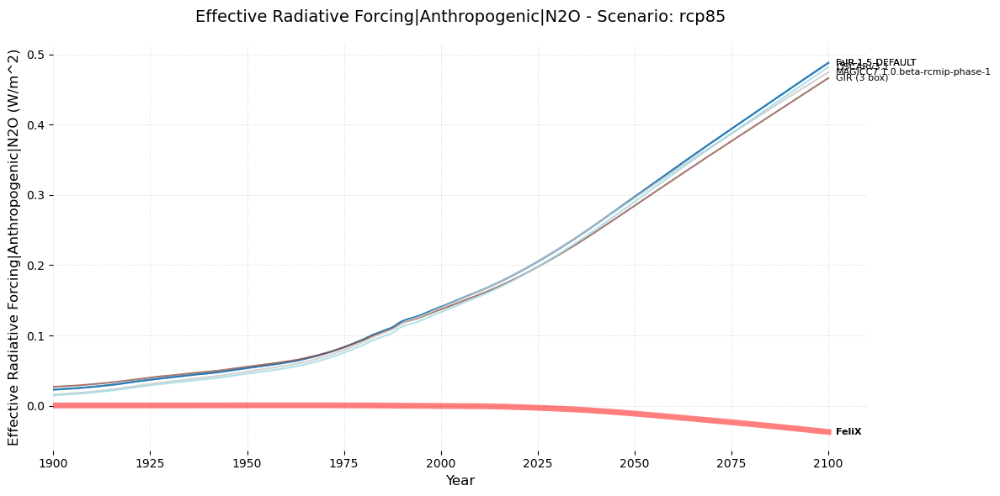

Original data shape: (11371, 1625)
After variable filtering: (352, 1625)
After scenario filtering: (6, 1625)
After region filtering: (6, 1625)
After year range filtering: (6, 206)
After excluding models: (6, 206)


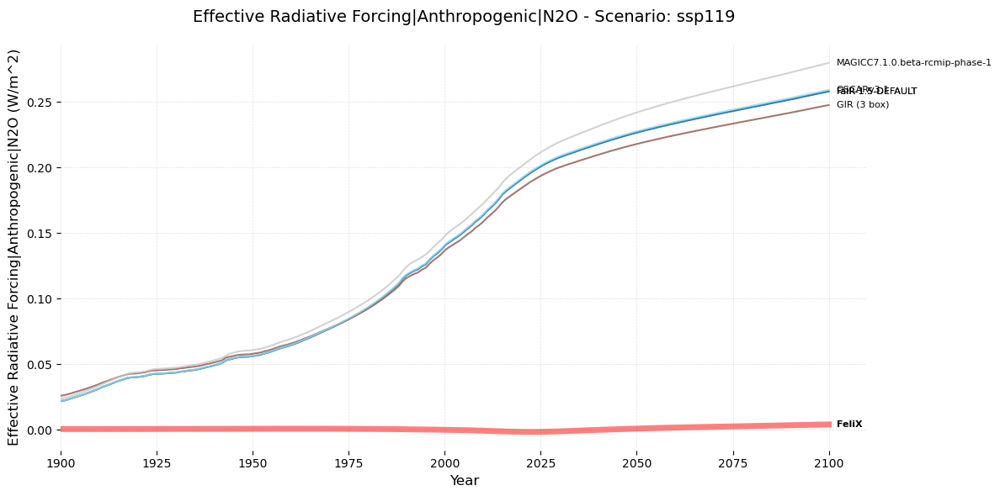

Original data shape: (11371, 1625)
After variable filtering: (352, 1625)
After scenario filtering: (6, 1625)
After region filtering: (6, 1625)
After year range filtering: (6, 206)
After excluding models: (6, 206)


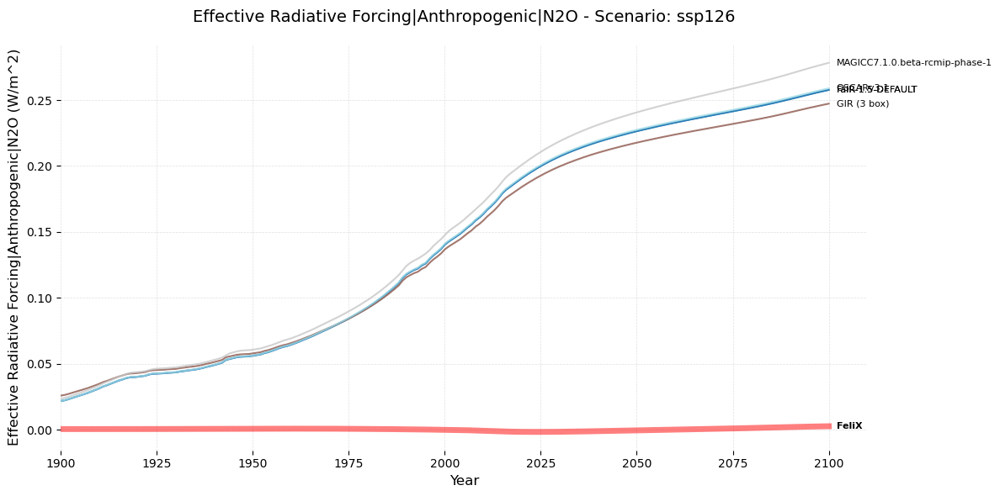

Original data shape: (11371, 1625)
After variable filtering: (352, 1625)
After scenario filtering: (6, 1625)
After region filtering: (6, 1625)
After year range filtering: (6, 206)
After excluding models: (6, 206)


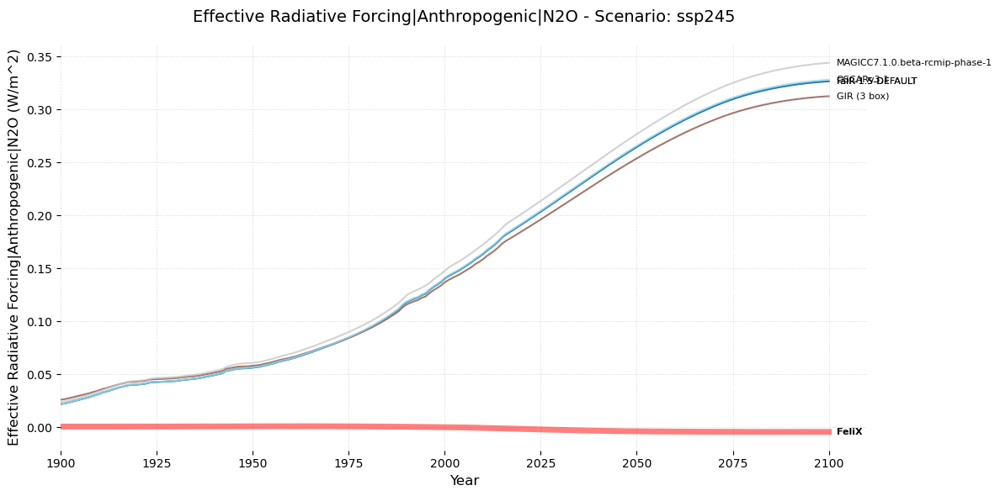

Original data shape: (11371, 1625)
After variable filtering: (352, 1625)
After scenario filtering: (6, 1625)
After region filtering: (6, 1625)
After year range filtering: (6, 206)
After excluding models: (6, 206)


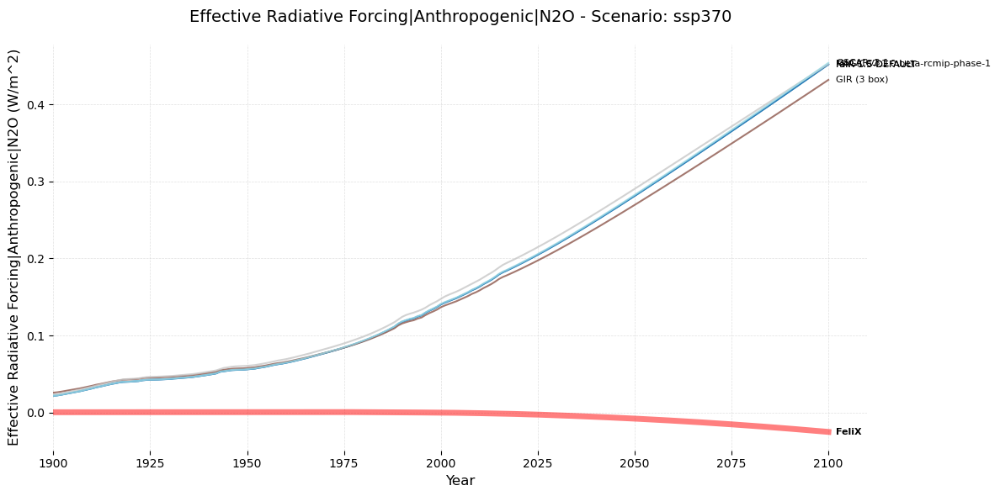

Original data shape: (11371, 1625)
After variable filtering: (352, 1625)
After scenario filtering: (5, 1625)
After region filtering: (5, 1625)
After year range filtering: (5, 206)
After excluding models: (5, 206)


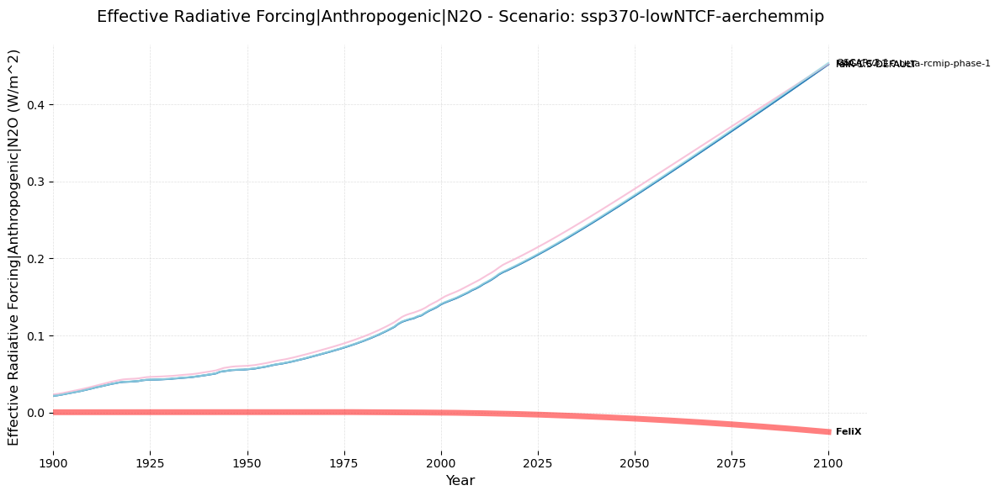

Original data shape: (11371, 1625)
After variable filtering: (352, 1625)
After scenario filtering: (3, 1625)
After region filtering: (3, 1625)
After year range filtering: (3, 206)
After excluding models: (3, 206)


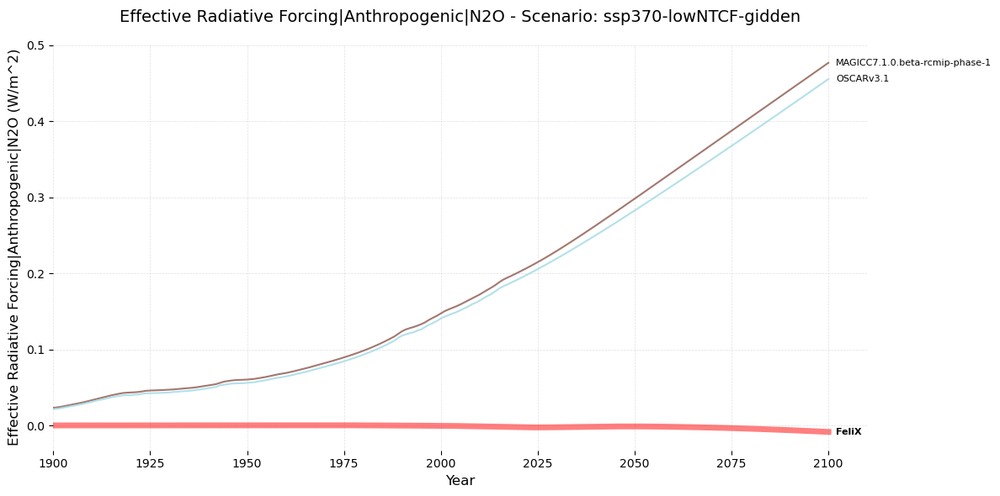

Original data shape: (11371, 1625)
After variable filtering: (352, 1625)
After scenario filtering: (6, 1625)
After region filtering: (6, 1625)
After year range filtering: (6, 206)
After excluding models: (6, 206)


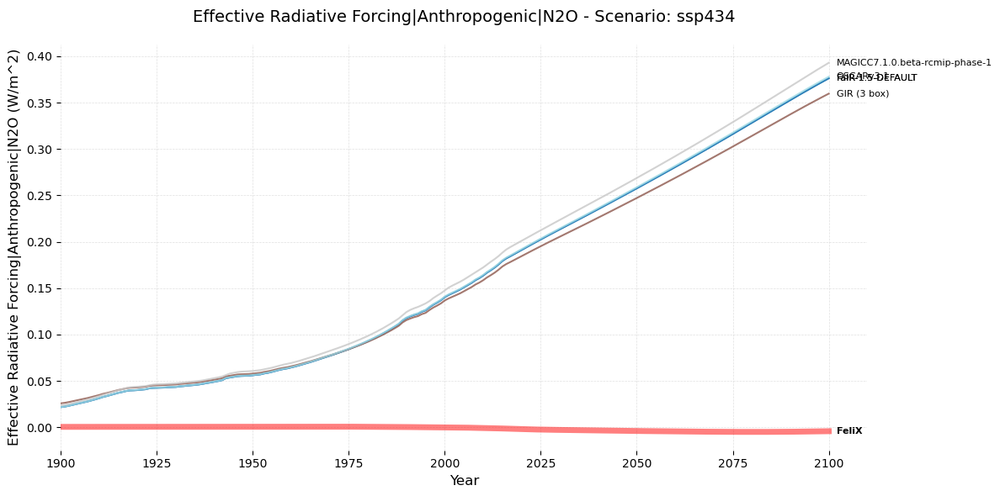

Original data shape: (11371, 1625)
After variable filtering: (352, 1625)
After scenario filtering: (6, 1625)
After region filtering: (6, 1625)
After year range filtering: (6, 206)
After excluding models: (6, 206)


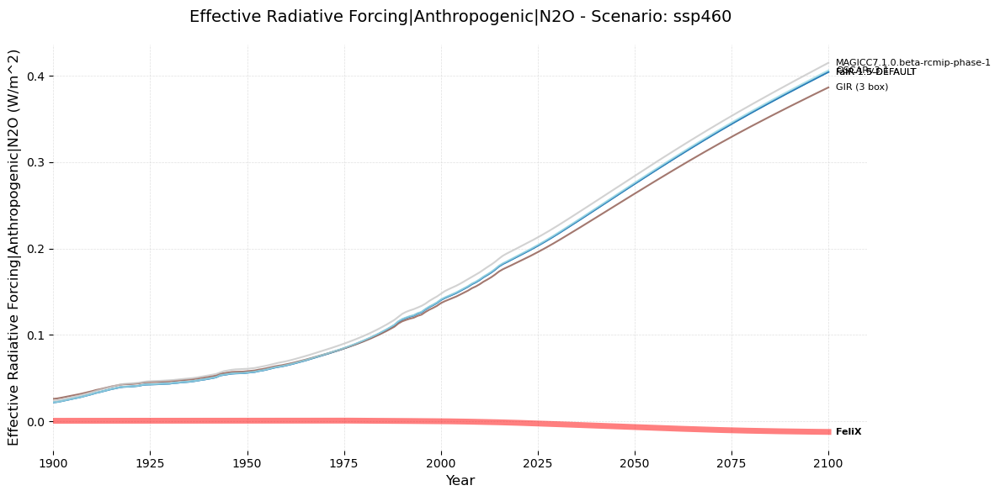

Original data shape: (11371, 1625)
After variable filtering: (352, 1625)
After scenario filtering: (6, 1625)
After region filtering: (6, 1625)
After year range filtering: (6, 206)
After excluding models: (6, 206)


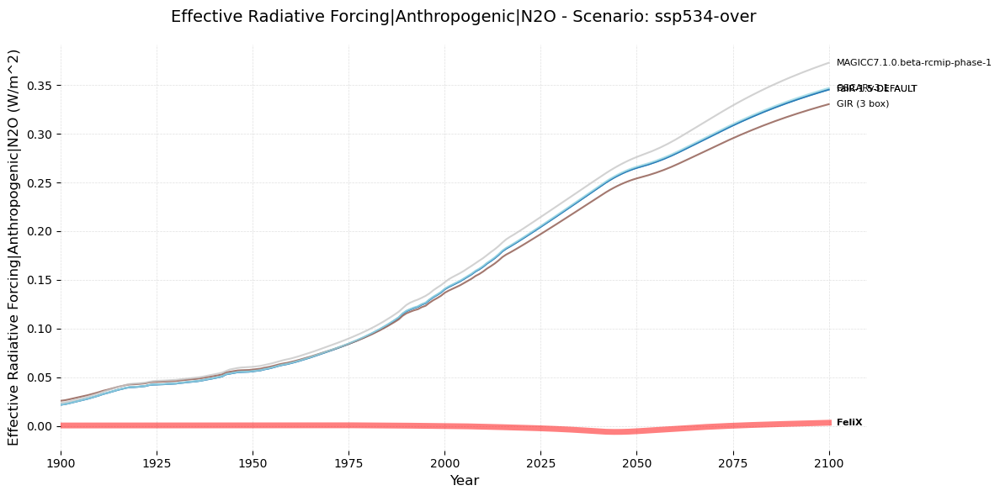

Original data shape: (11371, 1625)
After variable filtering: (352, 1625)
After scenario filtering: (6, 1625)
After region filtering: (6, 1625)
After year range filtering: (6, 206)
After excluding models: (6, 206)


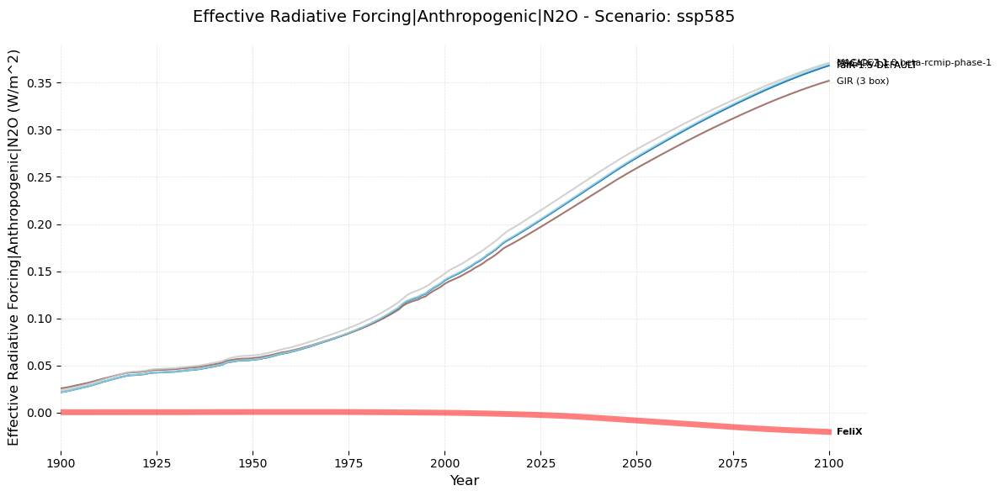

Original data shape: (11371, 1625)
After variable filtering: (352, 1625)
After scenario filtering: (5, 1625)
After region filtering: (5, 1625)
After year range filtering: (5, 206)
After excluding models: (5, 206)


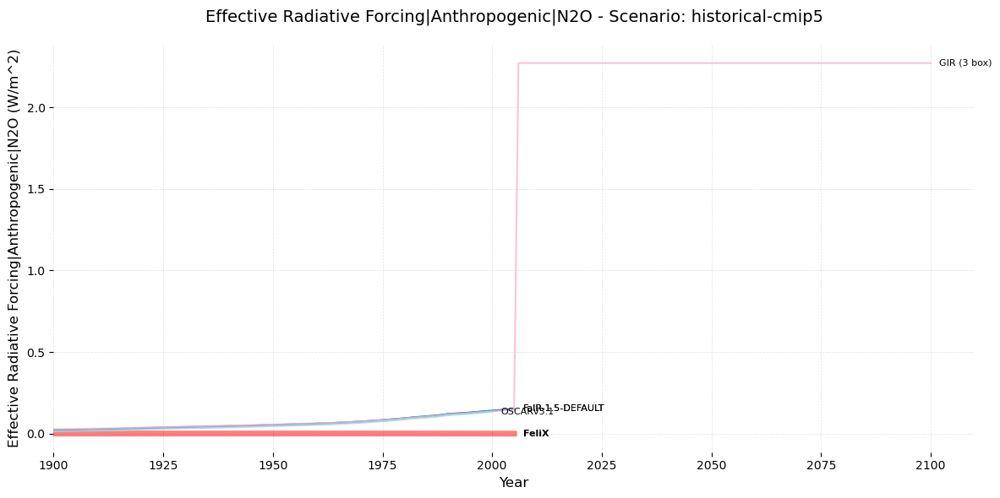

Original data shape: (11371, 1625)
After variable filtering: (91, 1625)
After scenario filtering: (2, 1625)
After region filtering: (2, 1625)
After year range filtering: (2, 206)
After excluding models: (2, 206)


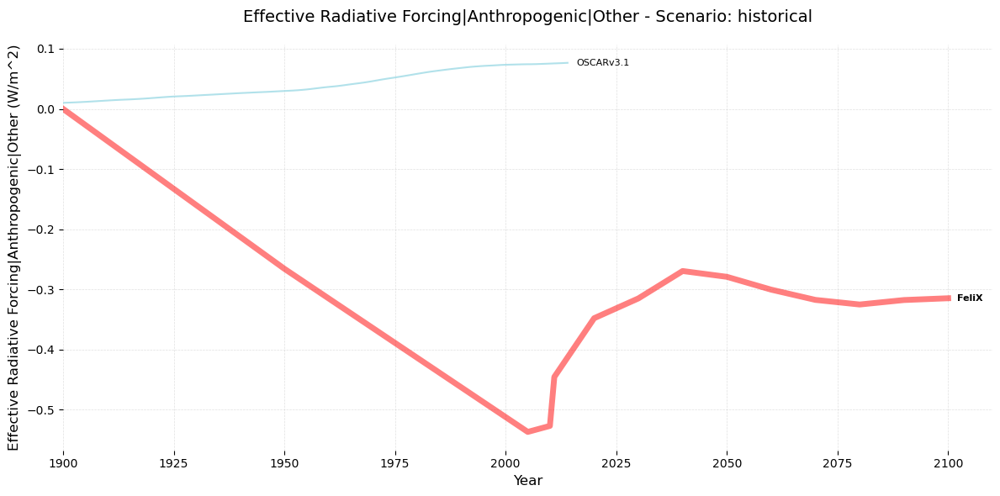

Original data shape: (11371, 1625)
After variable filtering: (91, 1625)
After scenario filtering: (2, 1625)
After region filtering: (2, 1625)
After year range filtering: (2, 206)
After excluding models: (2, 206)


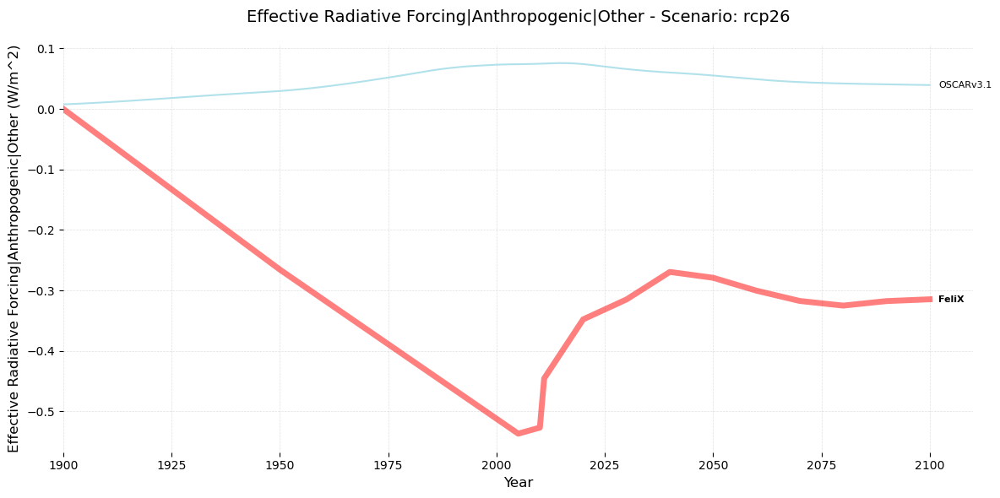

Original data shape: (11371, 1625)
After variable filtering: (91, 1625)
After scenario filtering: (2, 1625)
After region filtering: (2, 1625)
After year range filtering: (2, 206)
After excluding models: (2, 206)


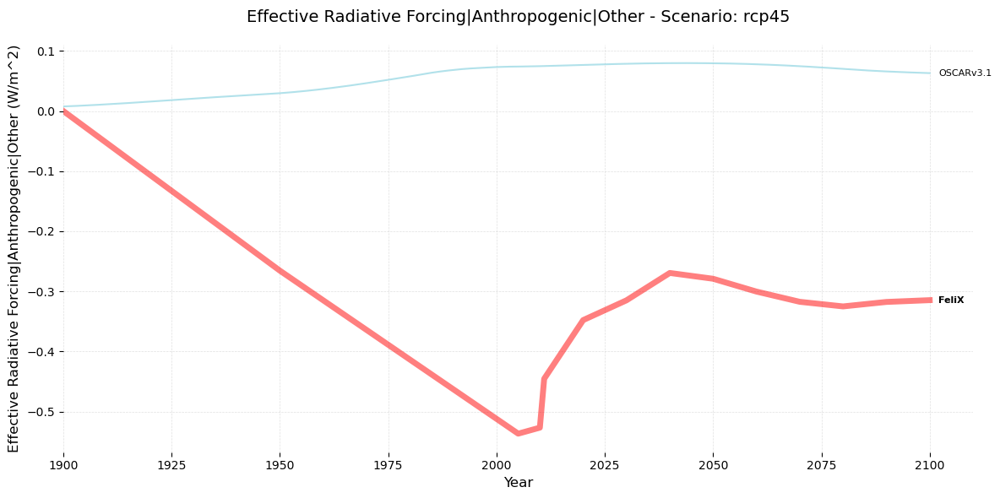

Original data shape: (11371, 1625)
After variable filtering: (91, 1625)
After scenario filtering: (2, 1625)
After region filtering: (2, 1625)
After year range filtering: (2, 206)
After excluding models: (2, 206)


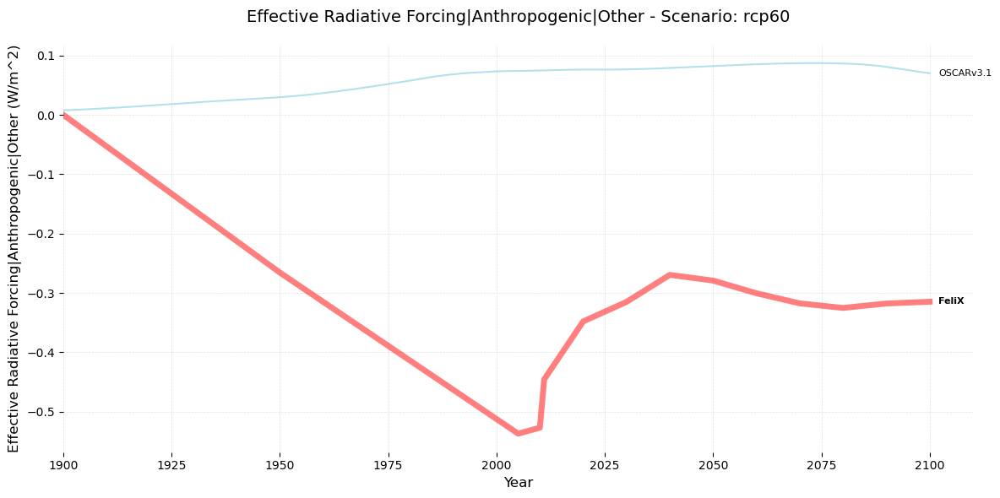

Original data shape: (11371, 1625)
After variable filtering: (91, 1625)
After scenario filtering: (2, 1625)
After region filtering: (2, 1625)
After year range filtering: (2, 206)
After excluding models: (2, 206)


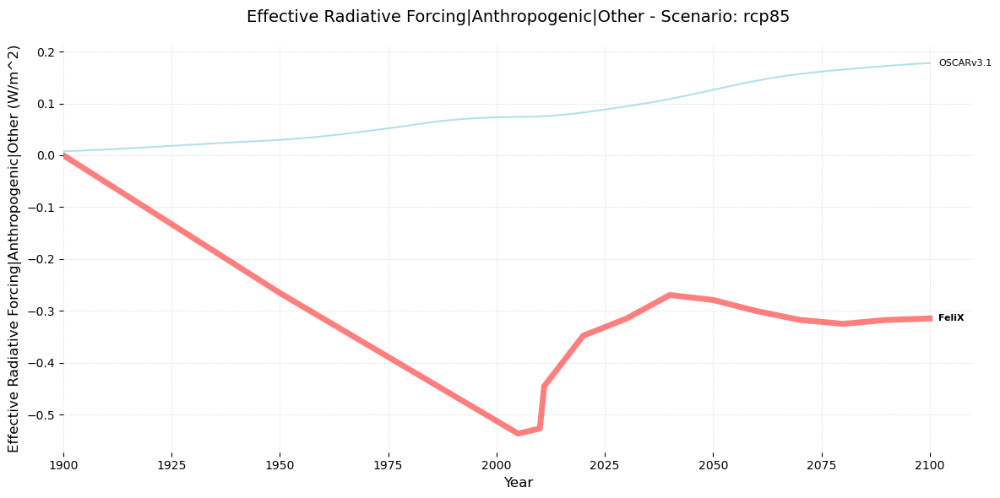

Original data shape: (11371, 1625)
After variable filtering: (91, 1625)
After scenario filtering: (2, 1625)
After region filtering: (2, 1625)
After year range filtering: (2, 206)
After excluding models: (2, 206)


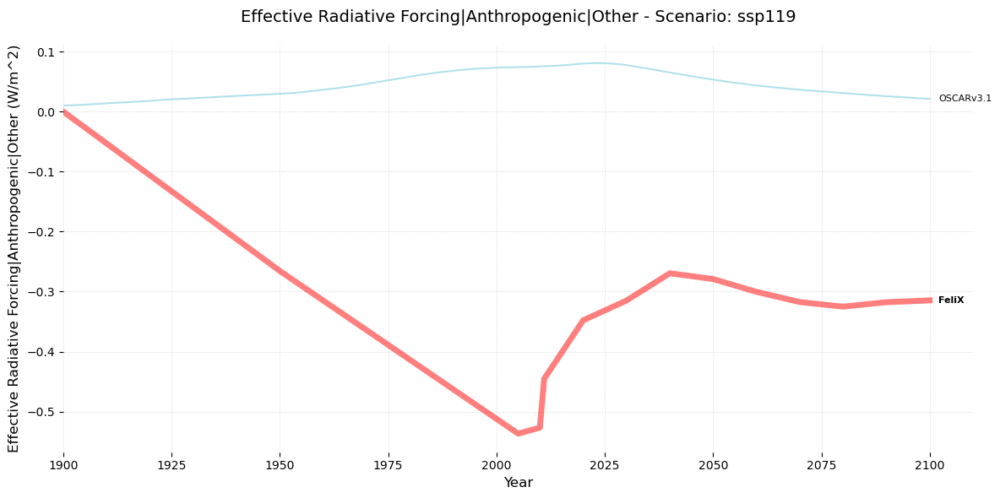

Original data shape: (11371, 1625)
After variable filtering: (91, 1625)
After scenario filtering: (2, 1625)
After region filtering: (2, 1625)
After year range filtering: (2, 206)
After excluding models: (2, 206)


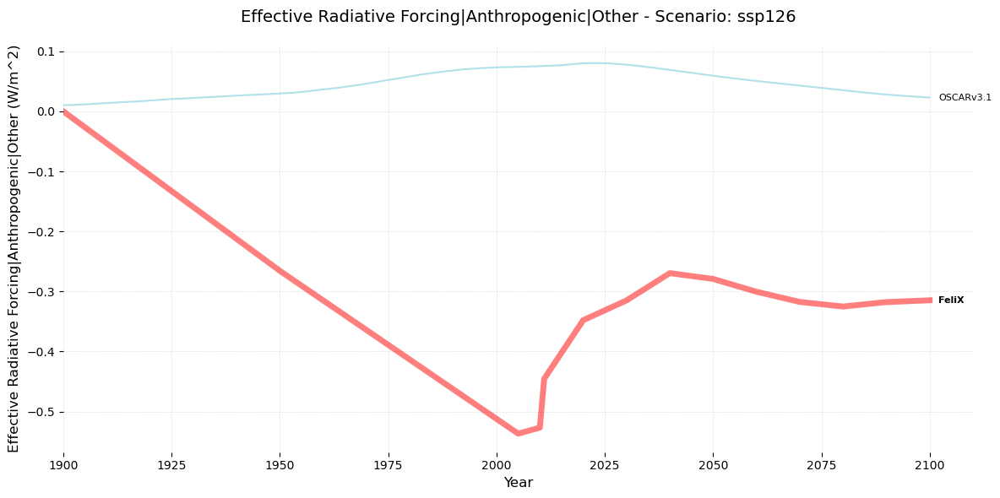

Original data shape: (11371, 1625)
After variable filtering: (91, 1625)
After scenario filtering: (2, 1625)
After region filtering: (2, 1625)
After year range filtering: (2, 206)
After excluding models: (2, 206)


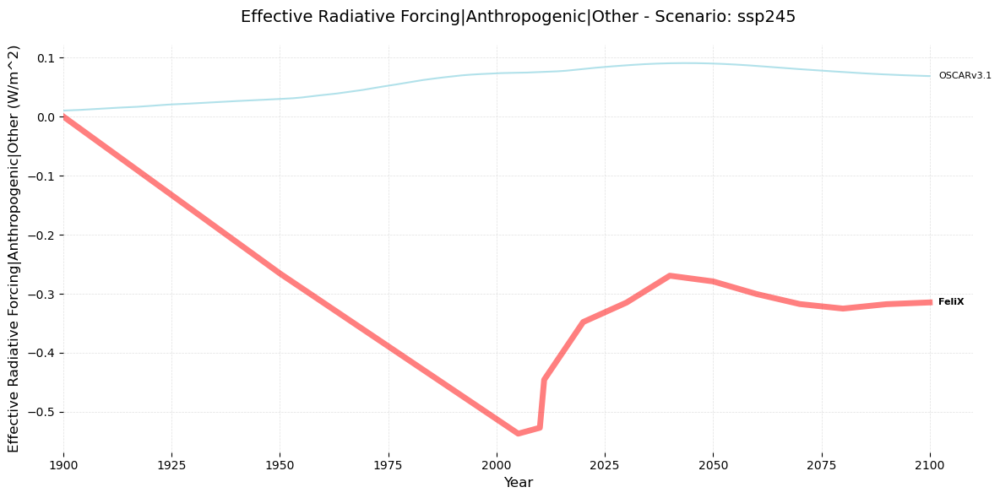

Original data shape: (11371, 1625)
After variable filtering: (91, 1625)
After scenario filtering: (2, 1625)
After region filtering: (2, 1625)
After year range filtering: (2, 206)
After excluding models: (2, 206)


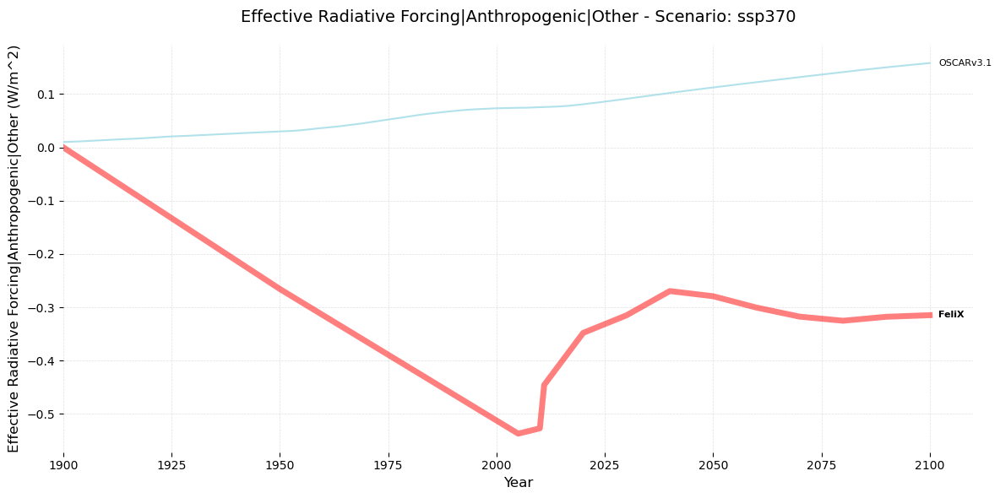

Original data shape: (11371, 1625)
After variable filtering: (91, 1625)
After scenario filtering: (2, 1625)
After region filtering: (2, 1625)
After year range filtering: (2, 206)
After excluding models: (2, 206)


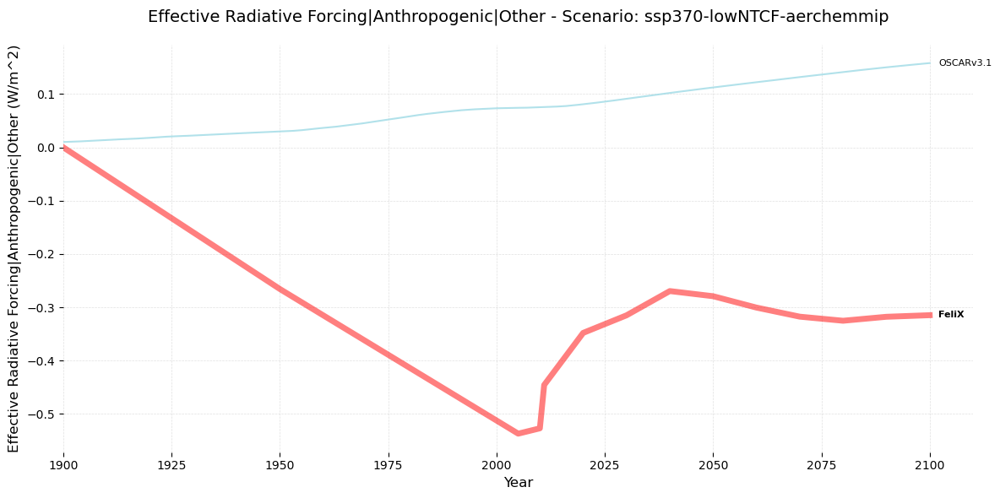

Original data shape: (11371, 1625)
After variable filtering: (91, 1625)
After scenario filtering: (2, 1625)
After region filtering: (2, 1625)
After year range filtering: (2, 206)
After excluding models: (2, 206)


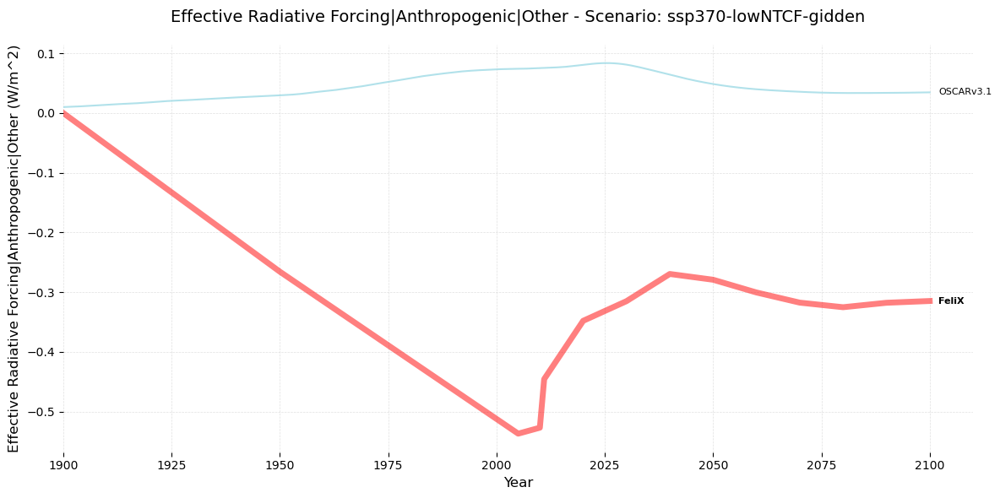

Original data shape: (11371, 1625)
After variable filtering: (91, 1625)
After scenario filtering: (2, 1625)
After region filtering: (2, 1625)
After year range filtering: (2, 206)
After excluding models: (2, 206)


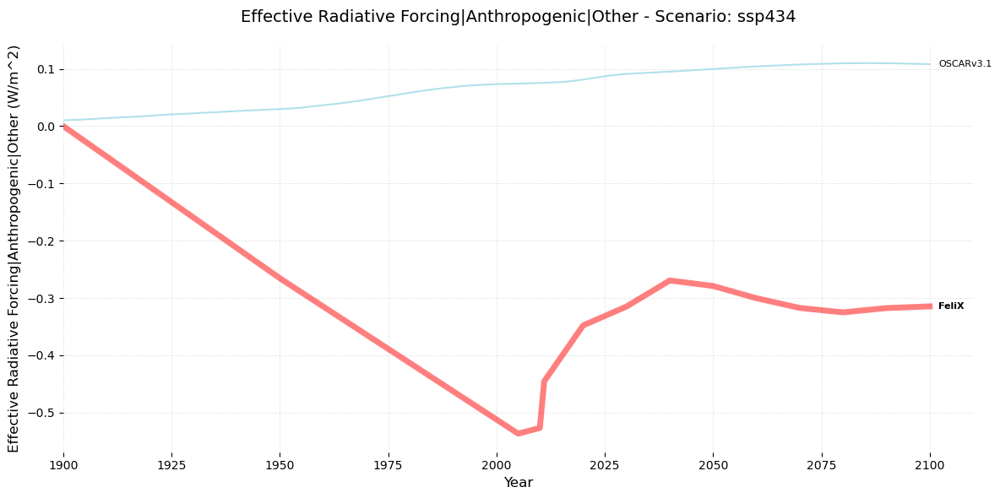

Original data shape: (11371, 1625)
After variable filtering: (91, 1625)
After scenario filtering: (2, 1625)
After region filtering: (2, 1625)
After year range filtering: (2, 206)
After excluding models: (2, 206)


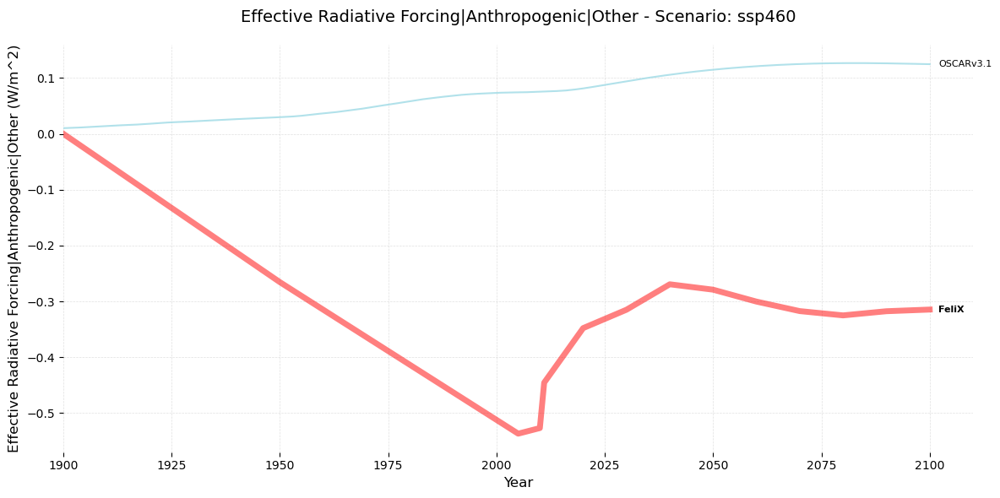

Original data shape: (11371, 1625)
After variable filtering: (91, 1625)
After scenario filtering: (2, 1625)
After region filtering: (2, 1625)
After year range filtering: (2, 206)
After excluding models: (2, 206)


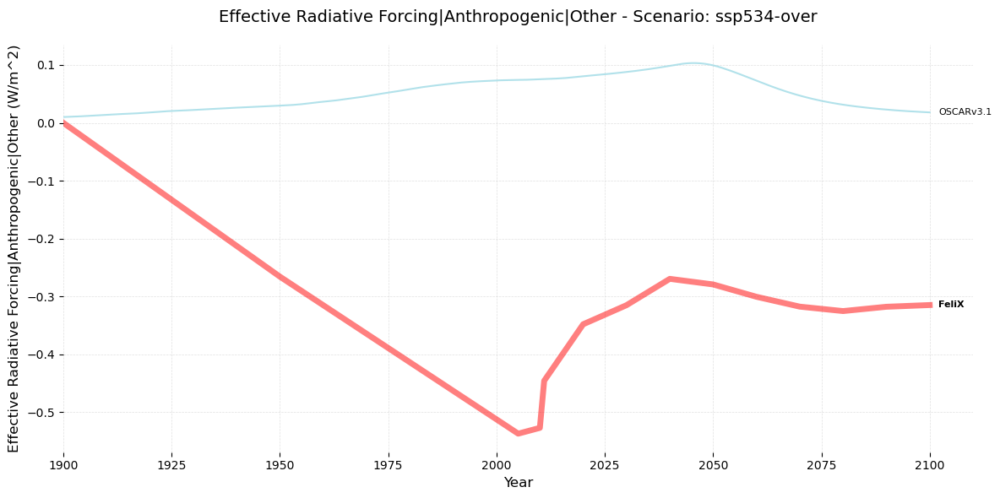

Original data shape: (11371, 1625)
After variable filtering: (91, 1625)
After scenario filtering: (2, 1625)
After region filtering: (2, 1625)
After year range filtering: (2, 206)
After excluding models: (2, 206)


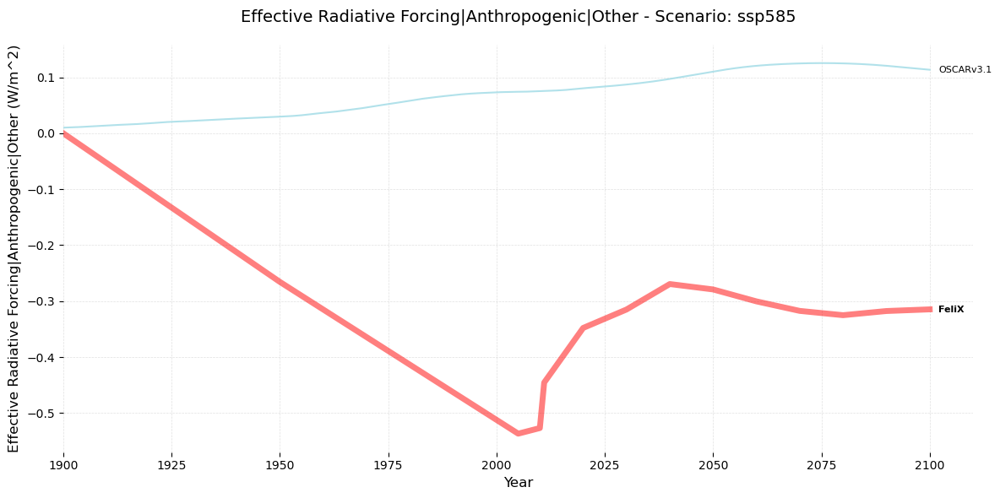

Original data shape: (11371, 1625)
After variable filtering: (91, 1625)
After scenario filtering: (2, 1625)
After region filtering: (2, 1625)
After year range filtering: (2, 206)
After excluding models: (2, 206)


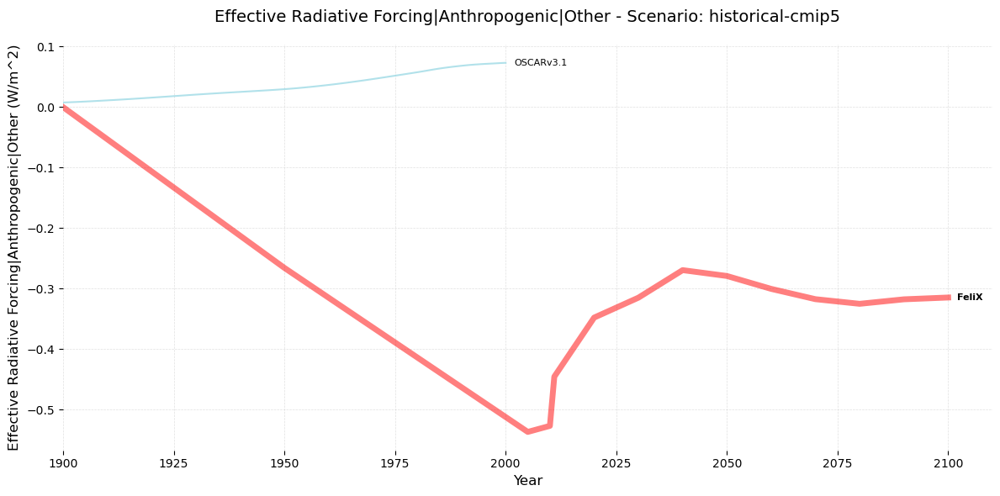

Original data shape: (11371, 1625)
After variable filtering: (149, 1625)
After scenario filtering: (3, 1625)
After region filtering: (3, 1625)
After year range filtering: (3, 206)
After excluding models: (3, 206)


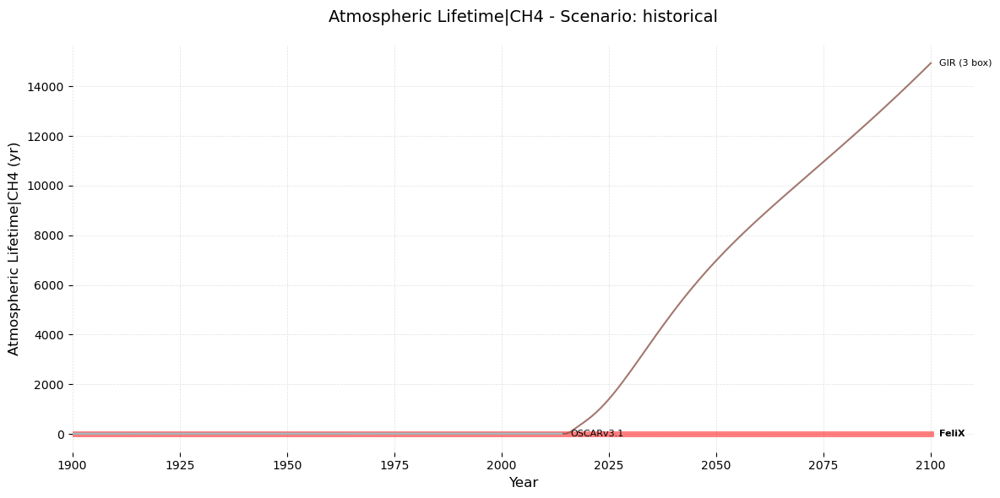

Original data shape: (11371, 1625)
After variable filtering: (149, 1625)
After scenario filtering: (3, 1625)
After region filtering: (3, 1625)
After year range filtering: (3, 206)
After excluding models: (3, 206)


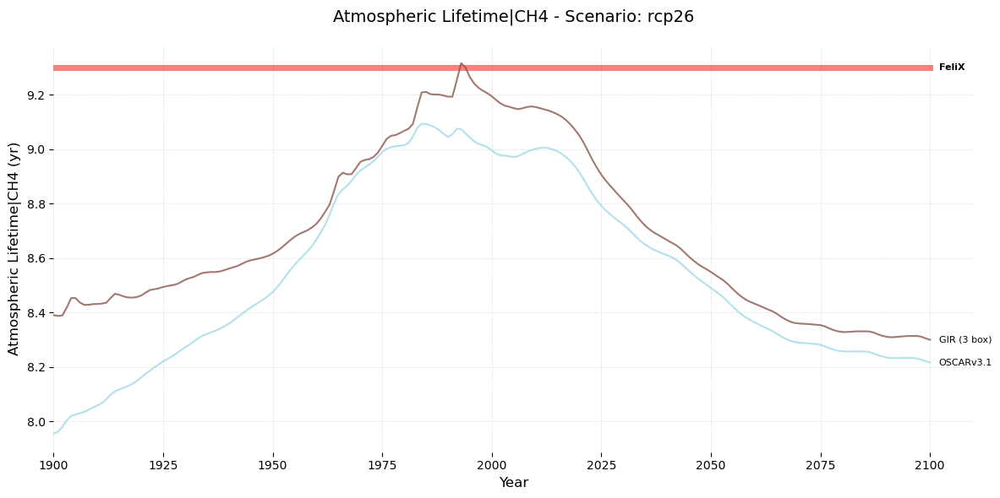

Original data shape: (11371, 1625)
After variable filtering: (149, 1625)
After scenario filtering: (3, 1625)
After region filtering: (3, 1625)
After year range filtering: (3, 206)
After excluding models: (3, 206)


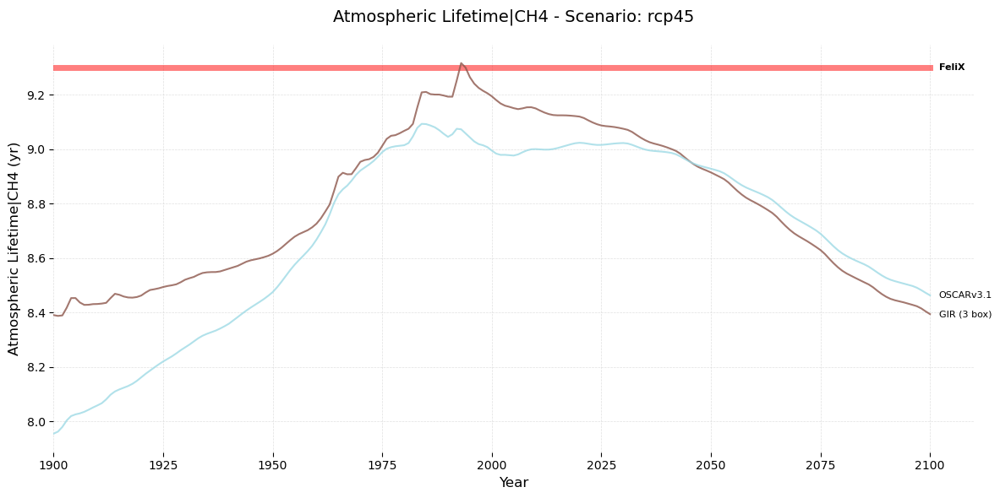

Original data shape: (11371, 1625)
After variable filtering: (149, 1625)
After scenario filtering: (3, 1625)
After region filtering: (3, 1625)
After year range filtering: (3, 206)
After excluding models: (3, 206)


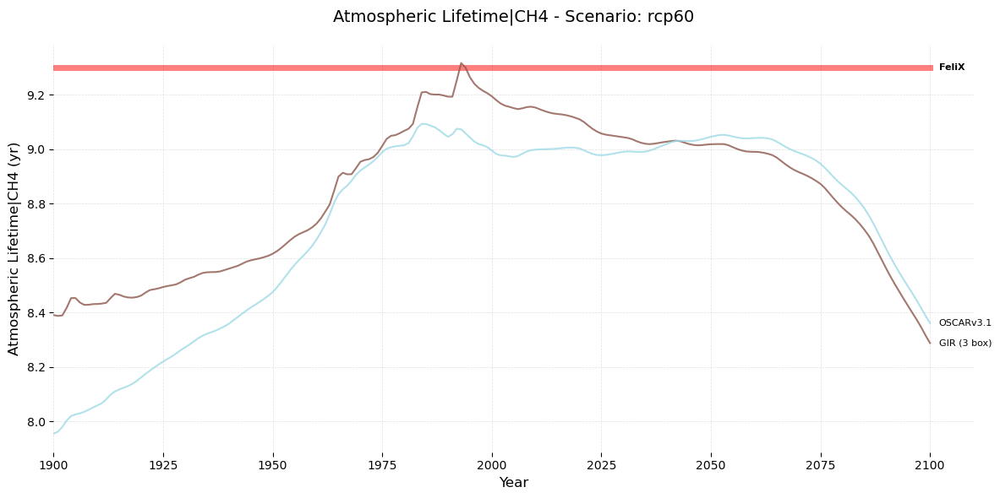

Original data shape: (11371, 1625)
After variable filtering: (149, 1625)
After scenario filtering: (3, 1625)
After region filtering: (3, 1625)
After year range filtering: (3, 206)
After excluding models: (3, 206)


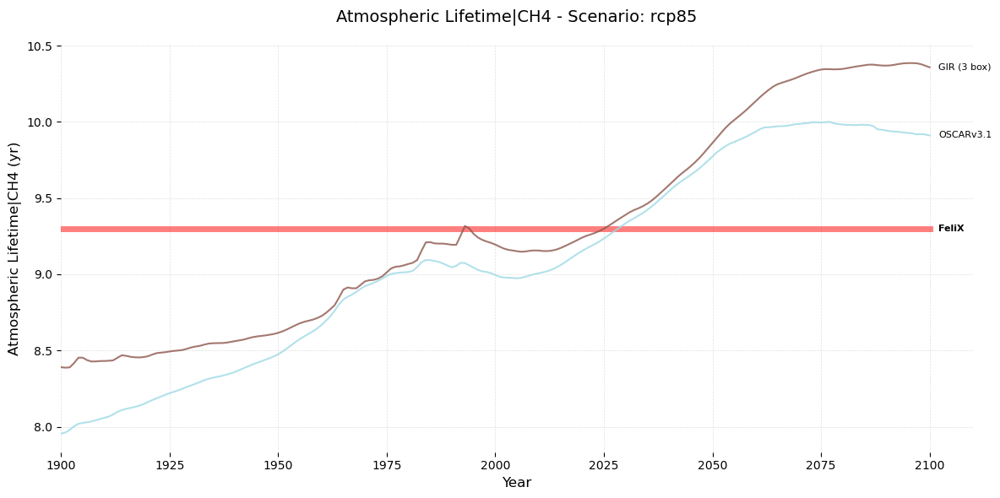

Original data shape: (11371, 1625)
After variable filtering: (149, 1625)
After scenario filtering: (3, 1625)
After region filtering: (3, 1625)
After year range filtering: (3, 206)
After excluding models: (3, 206)


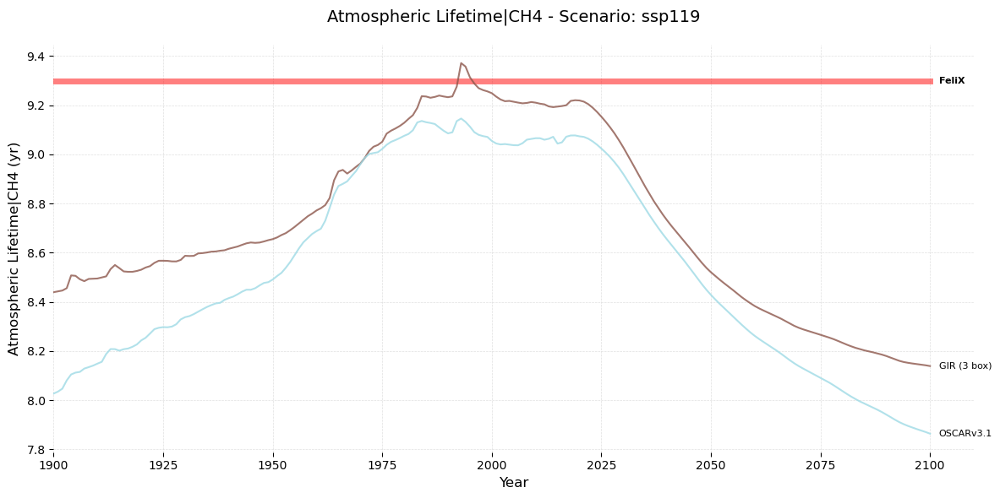

Original data shape: (11371, 1625)
After variable filtering: (149, 1625)
After scenario filtering: (3, 1625)
After region filtering: (3, 1625)
After year range filtering: (3, 206)
After excluding models: (3, 206)


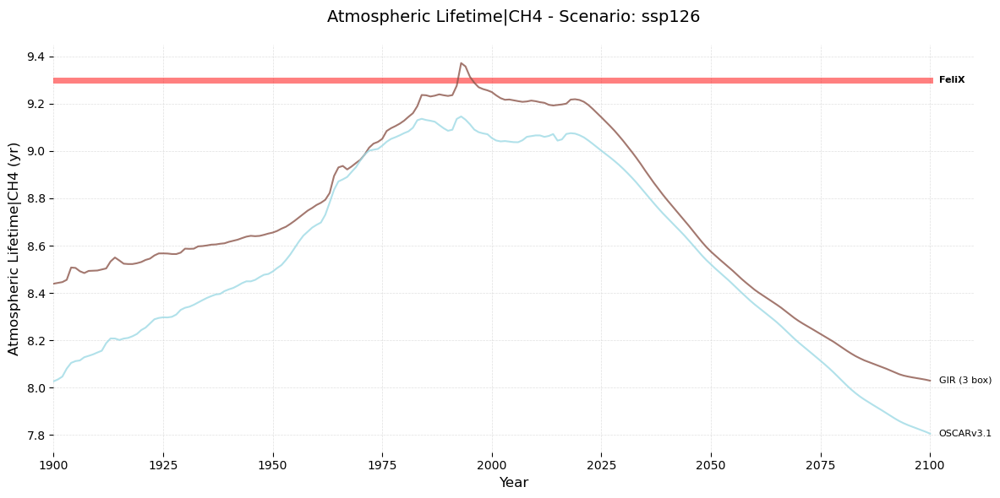

Original data shape: (11371, 1625)
After variable filtering: (149, 1625)
After scenario filtering: (3, 1625)
After region filtering: (3, 1625)
After year range filtering: (3, 206)
After excluding models: (3, 206)


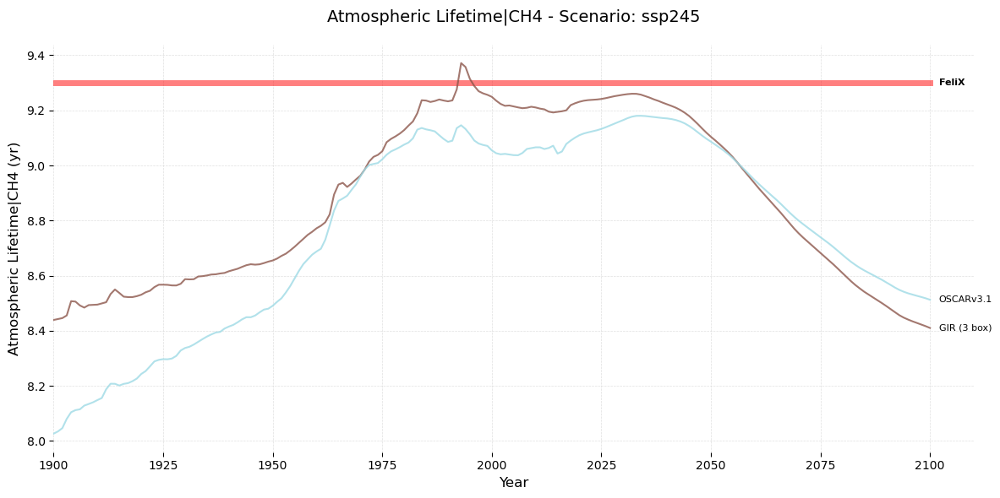

Original data shape: (11371, 1625)
After variable filtering: (149, 1625)
After scenario filtering: (3, 1625)
After region filtering: (3, 1625)
After year range filtering: (3, 206)
After excluding models: (3, 206)


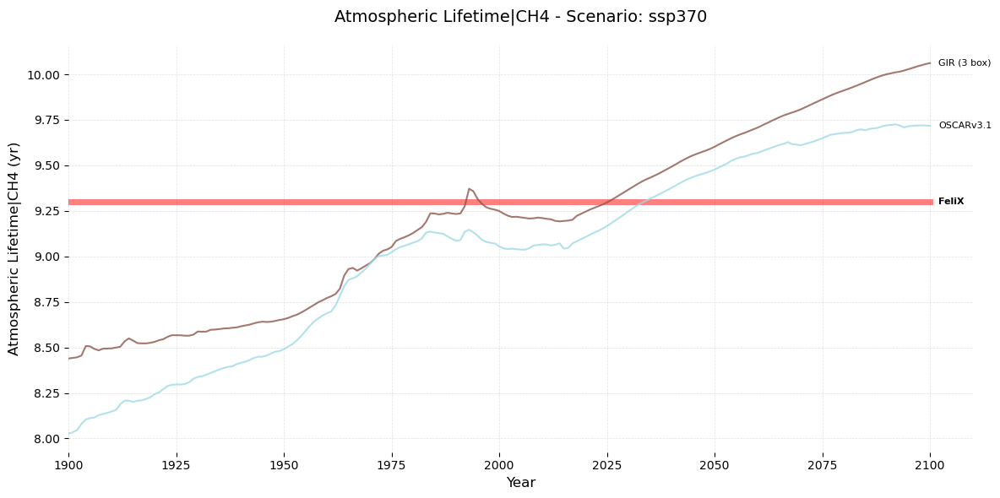

Original data shape: (11371, 1625)
After variable filtering: (149, 1625)
After scenario filtering: (2, 1625)
After region filtering: (2, 1625)
After year range filtering: (2, 206)
After excluding models: (2, 206)


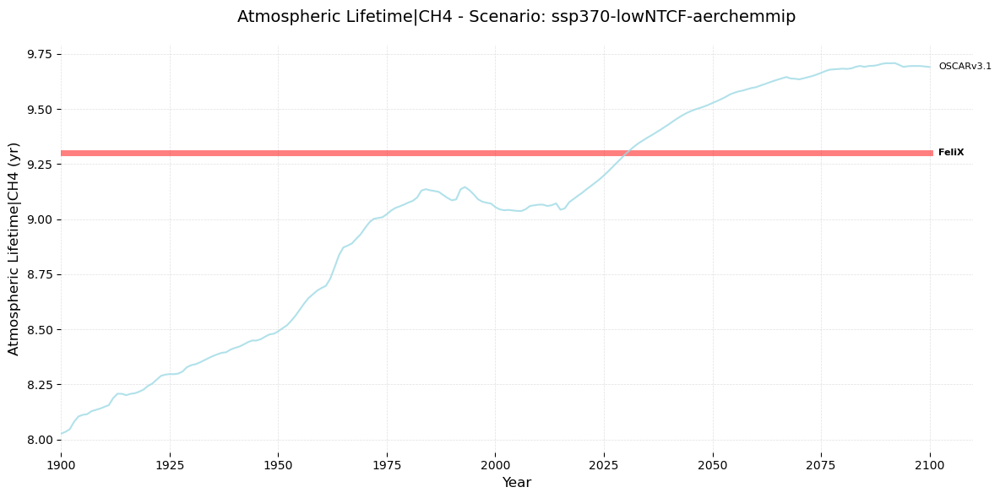

Original data shape: (11371, 1625)
After variable filtering: (149, 1625)
After scenario filtering: (2, 1625)
After region filtering: (2, 1625)
After year range filtering: (2, 206)
After excluding models: (2, 206)


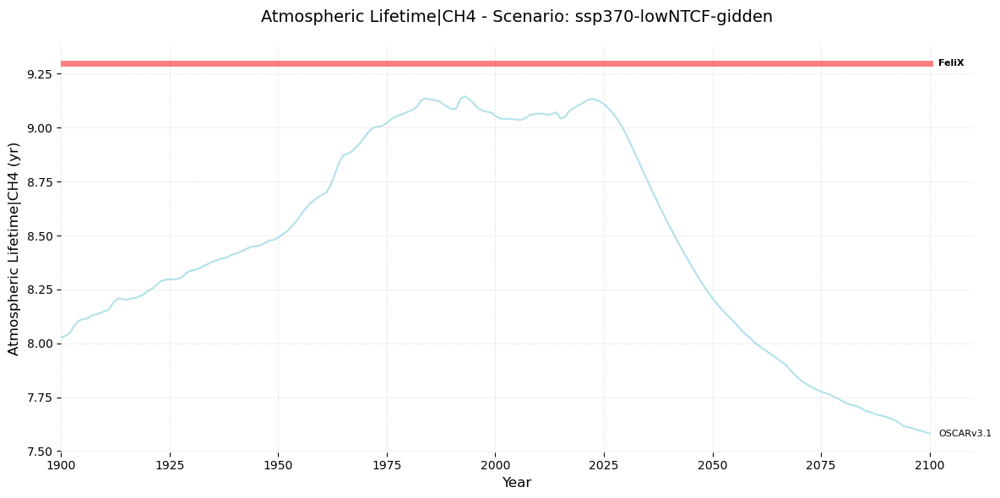

Original data shape: (11371, 1625)
After variable filtering: (149, 1625)
After scenario filtering: (3, 1625)
After region filtering: (3, 1625)
After year range filtering: (3, 206)
After excluding models: (3, 206)


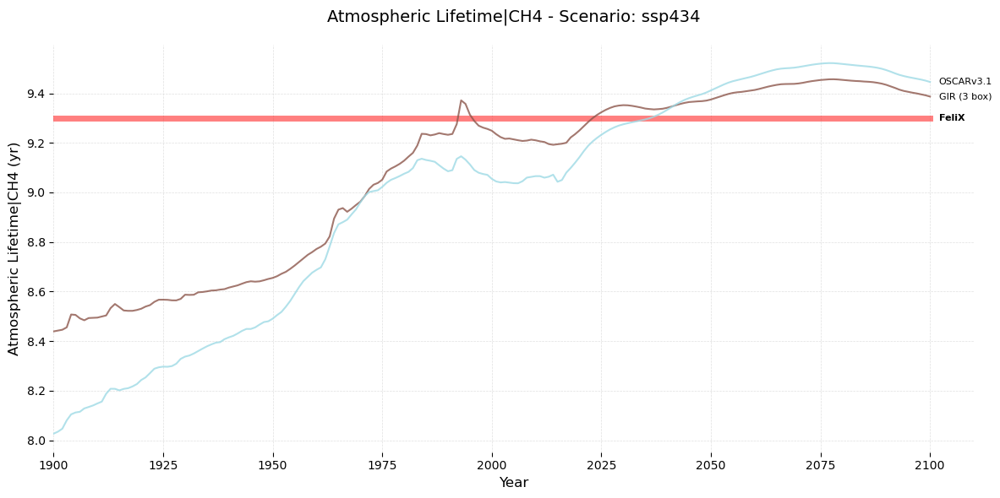

Original data shape: (11371, 1625)
After variable filtering: (149, 1625)
After scenario filtering: (3, 1625)
After region filtering: (3, 1625)
After year range filtering: (3, 206)
After excluding models: (3, 206)


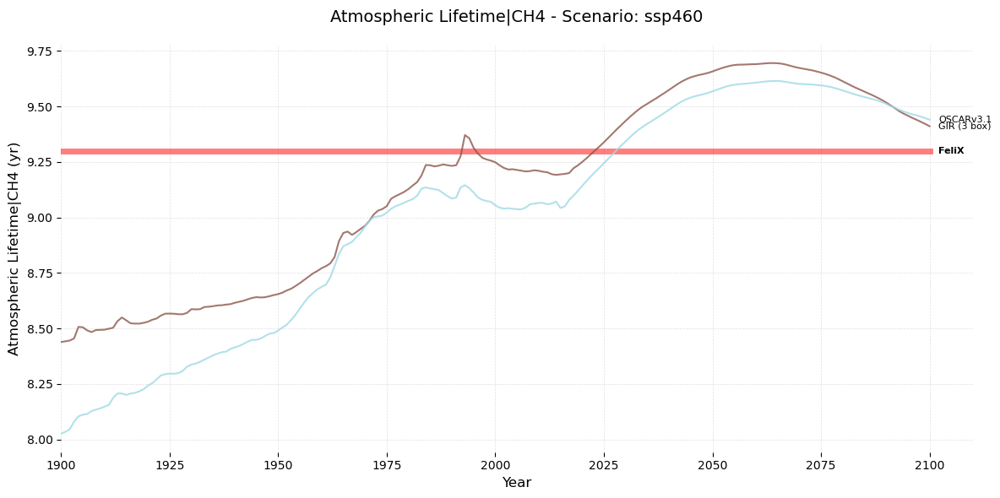

Original data shape: (11371, 1625)
After variable filtering: (149, 1625)
After scenario filtering: (3, 1625)
After region filtering: (3, 1625)
After year range filtering: (3, 206)
After excluding models: (3, 206)


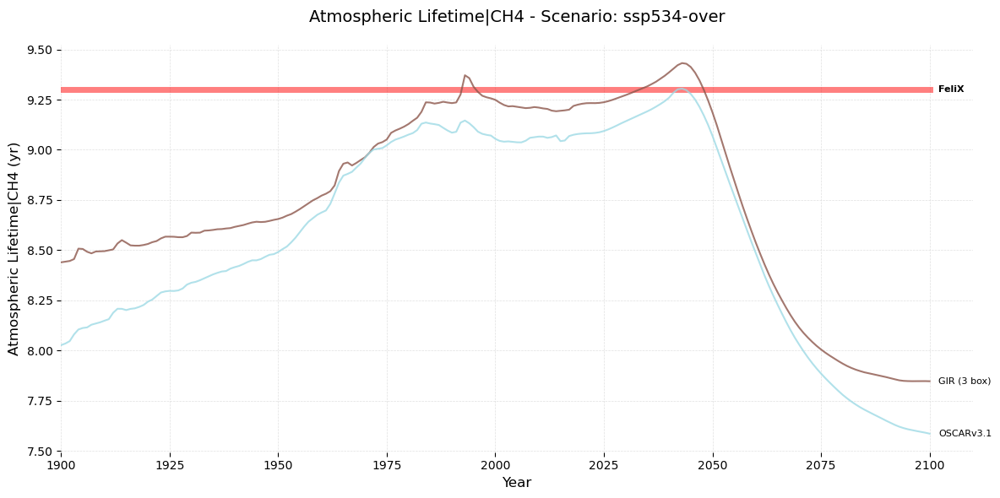

Original data shape: (11371, 1625)
After variable filtering: (149, 1625)
After scenario filtering: (3, 1625)
After region filtering: (3, 1625)
After year range filtering: (3, 206)
After excluding models: (3, 206)


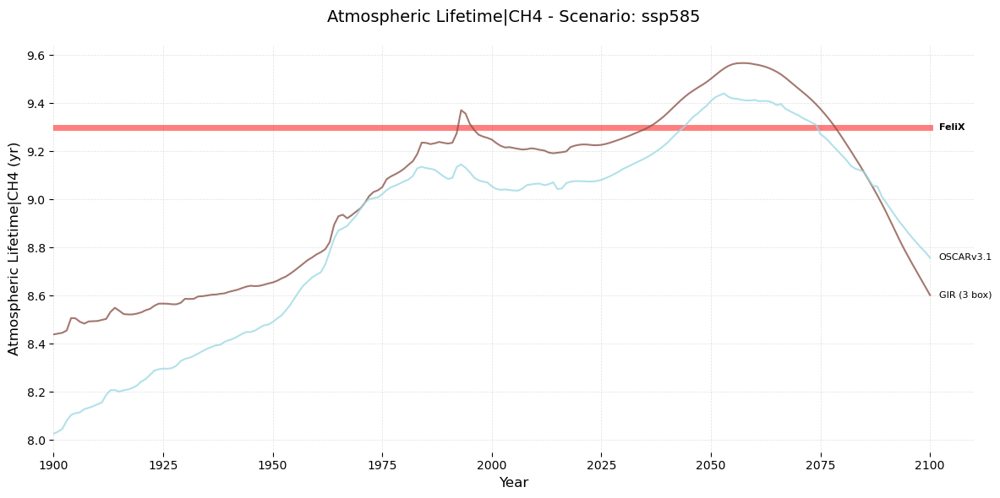

Original data shape: (11371, 1625)
After variable filtering: (149, 1625)
After scenario filtering: (3, 1625)
After region filtering: (3, 1625)
After year range filtering: (3, 206)
After excluding models: (3, 206)


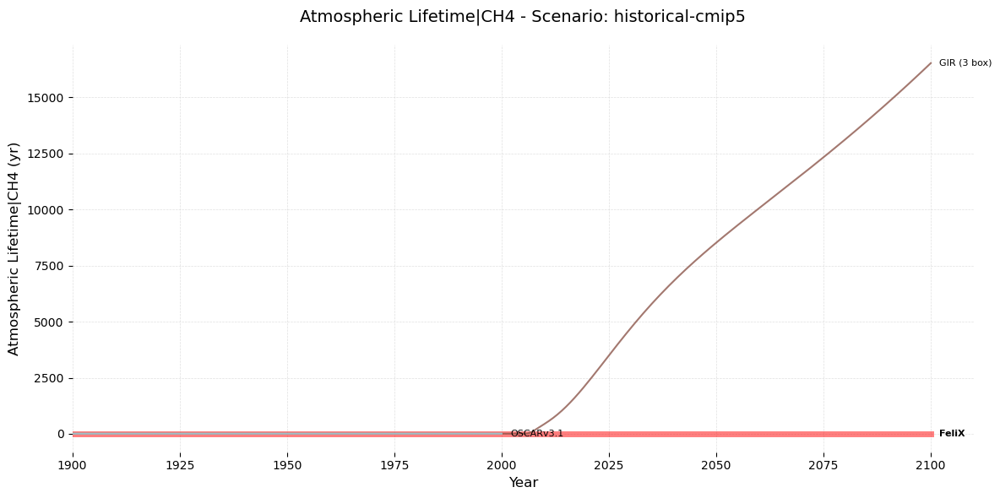

Original data shape: (11371, 1625)
After variable filtering: (149, 1625)
After scenario filtering: (3, 1625)
After region filtering: (3, 1625)
After year range filtering: (3, 206)
After excluding models: (3, 206)


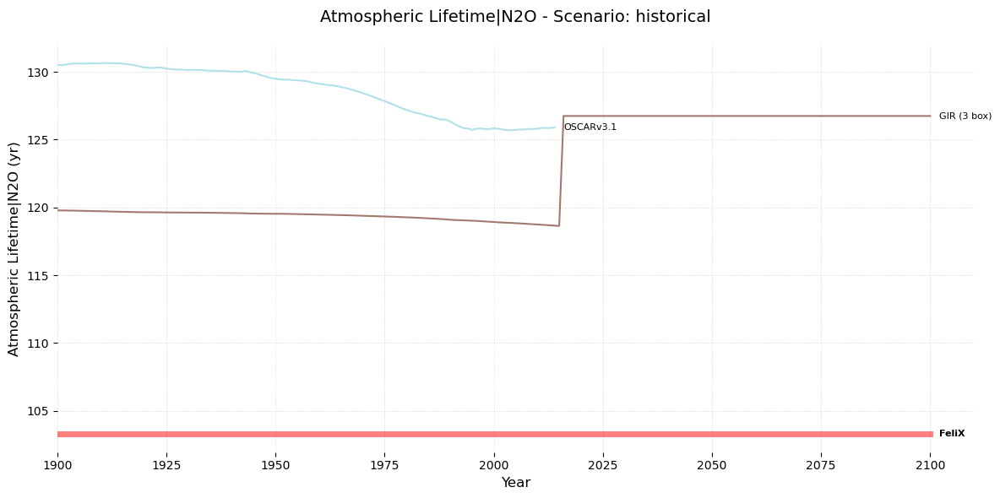

Original data shape: (11371, 1625)
After variable filtering: (149, 1625)
After scenario filtering: (3, 1625)
After region filtering: (3, 1625)
After year range filtering: (3, 206)
After excluding models: (3, 206)


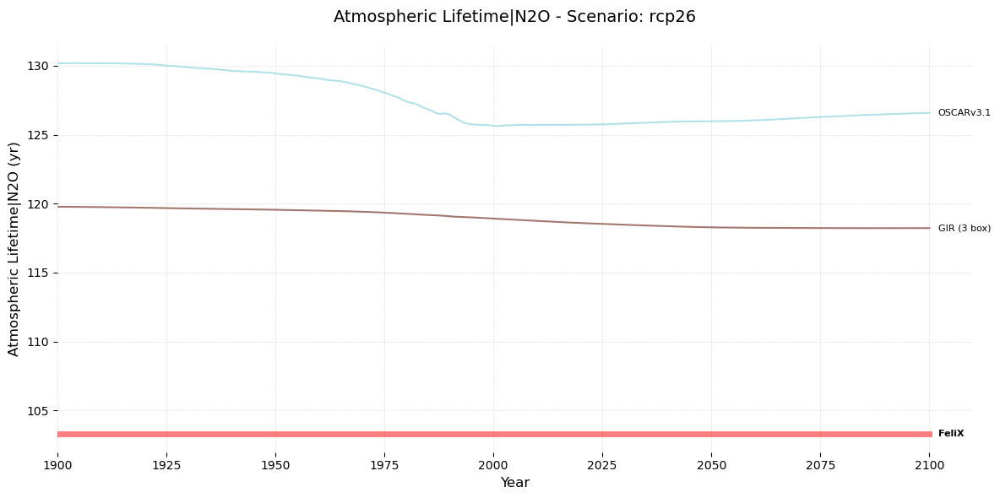

Original data shape: (11371, 1625)
After variable filtering: (149, 1625)
After scenario filtering: (3, 1625)
After region filtering: (3, 1625)
After year range filtering: (3, 206)
After excluding models: (3, 206)


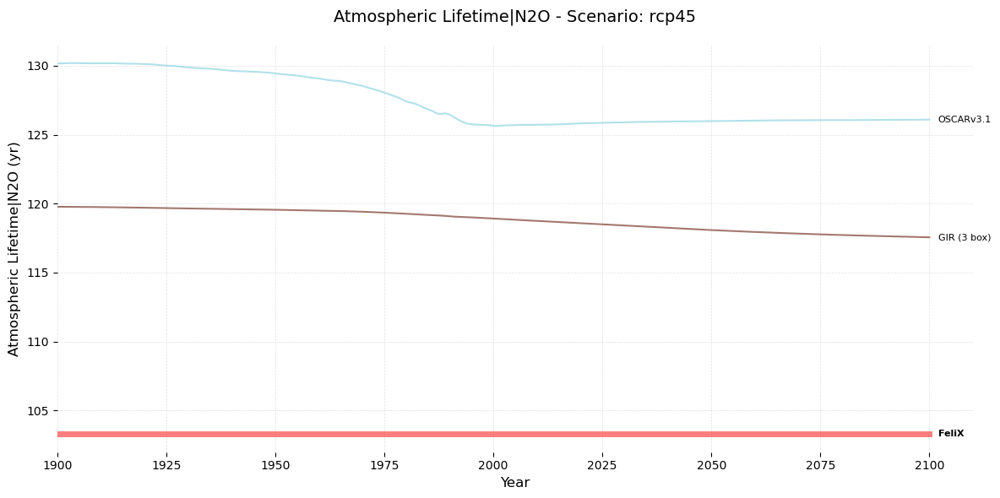

Original data shape: (11371, 1625)
After variable filtering: (149, 1625)
After scenario filtering: (3, 1625)
After region filtering: (3, 1625)
After year range filtering: (3, 206)
After excluding models: (3, 206)


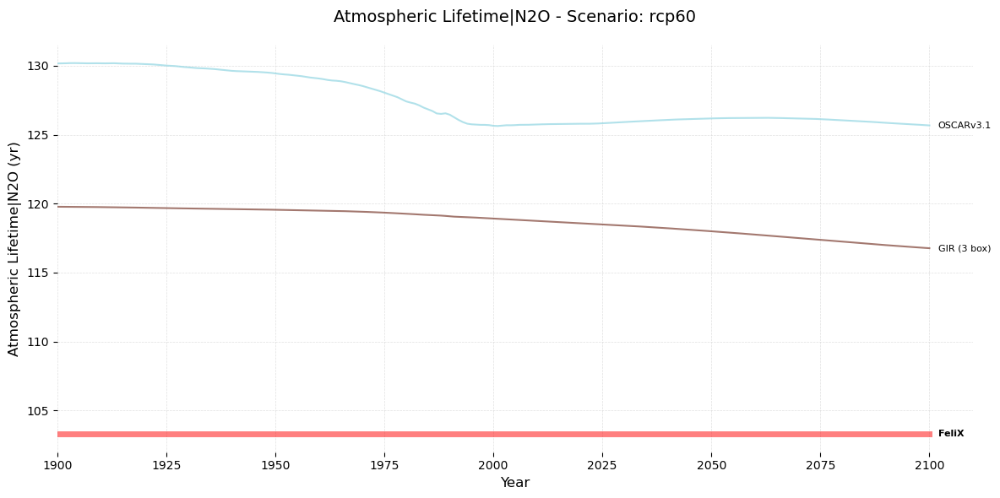

Original data shape: (11371, 1625)
After variable filtering: (149, 1625)
After scenario filtering: (3, 1625)
After region filtering: (3, 1625)
After year range filtering: (3, 206)
After excluding models: (3, 206)


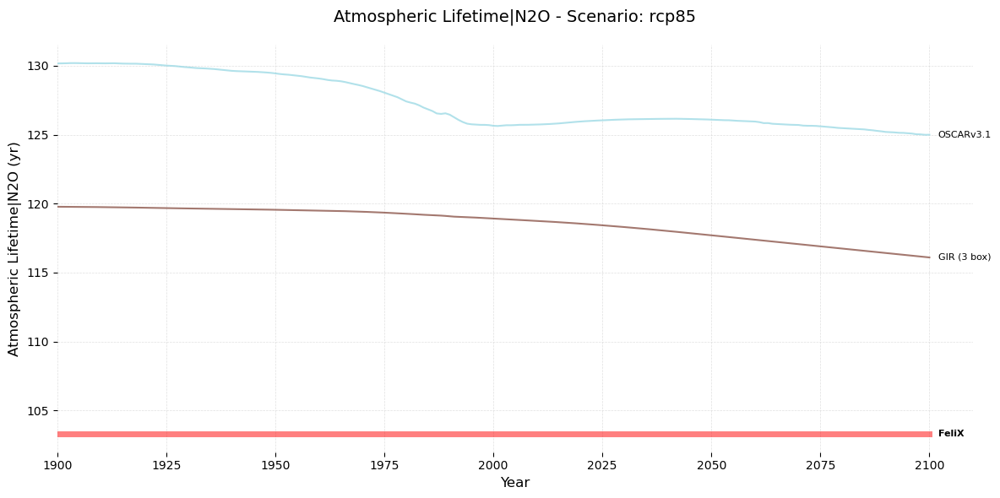

Original data shape: (11371, 1625)
After variable filtering: (149, 1625)
After scenario filtering: (3, 1625)
After region filtering: (3, 1625)
After year range filtering: (3, 206)
After excluding models: (3, 206)


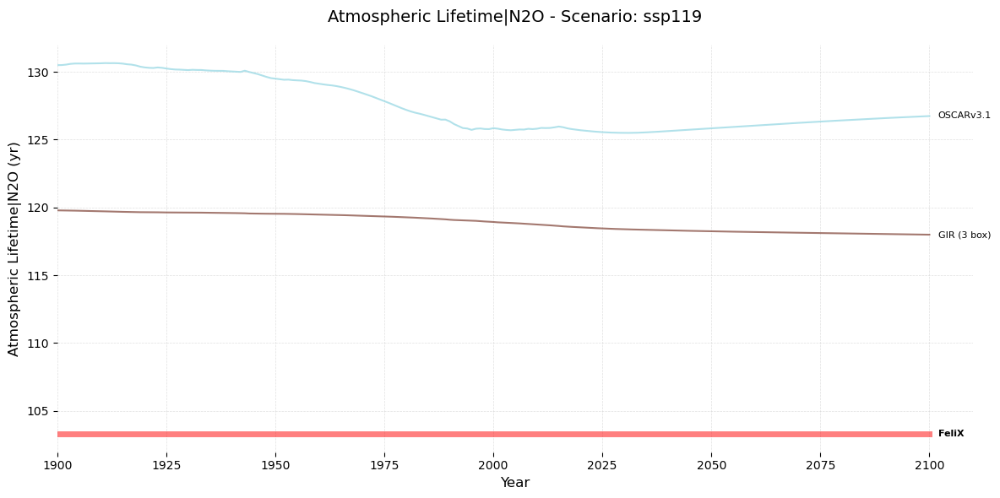

Original data shape: (11371, 1625)
After variable filtering: (149, 1625)
After scenario filtering: (3, 1625)
After region filtering: (3, 1625)
After year range filtering: (3, 206)
After excluding models: (3, 206)


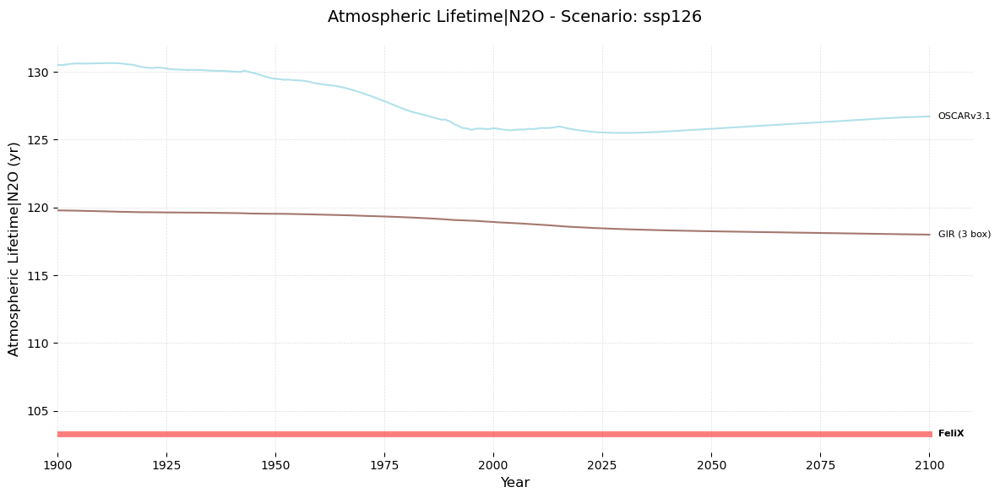

Original data shape: (11371, 1625)
After variable filtering: (149, 1625)
After scenario filtering: (3, 1625)
After region filtering: (3, 1625)
After year range filtering: (3, 206)
After excluding models: (3, 206)


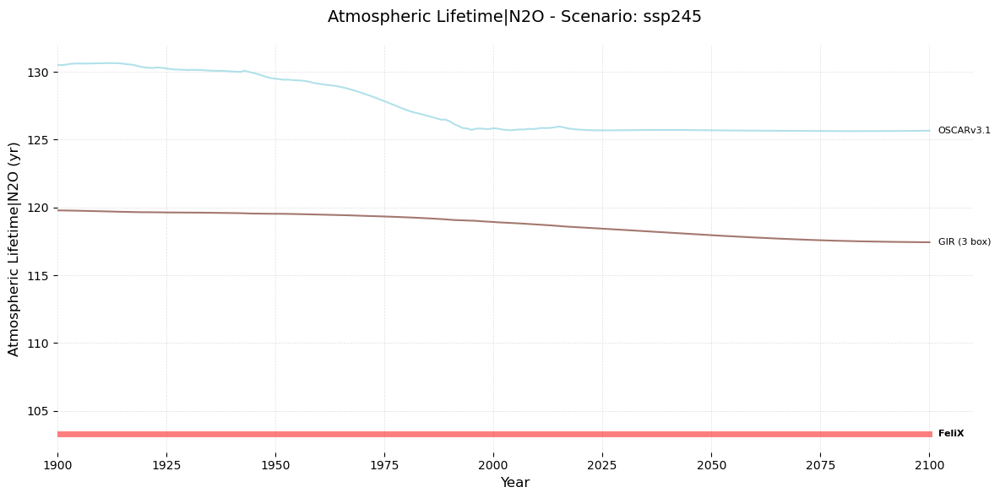

Original data shape: (11371, 1625)
After variable filtering: (149, 1625)
After scenario filtering: (3, 1625)
After region filtering: (3, 1625)
After year range filtering: (3, 206)
After excluding models: (3, 206)


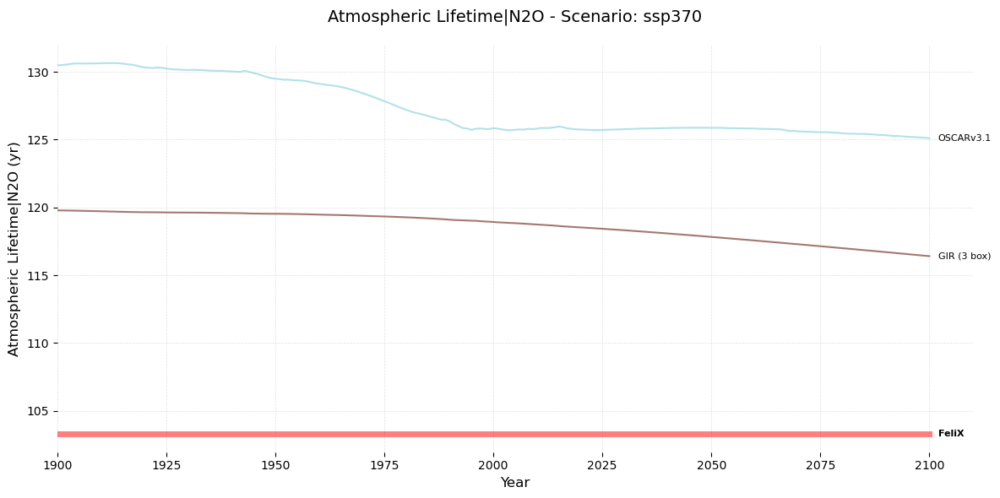

Original data shape: (11371, 1625)
After variable filtering: (149, 1625)
After scenario filtering: (2, 1625)
After region filtering: (2, 1625)
After year range filtering: (2, 206)
After excluding models: (2, 206)


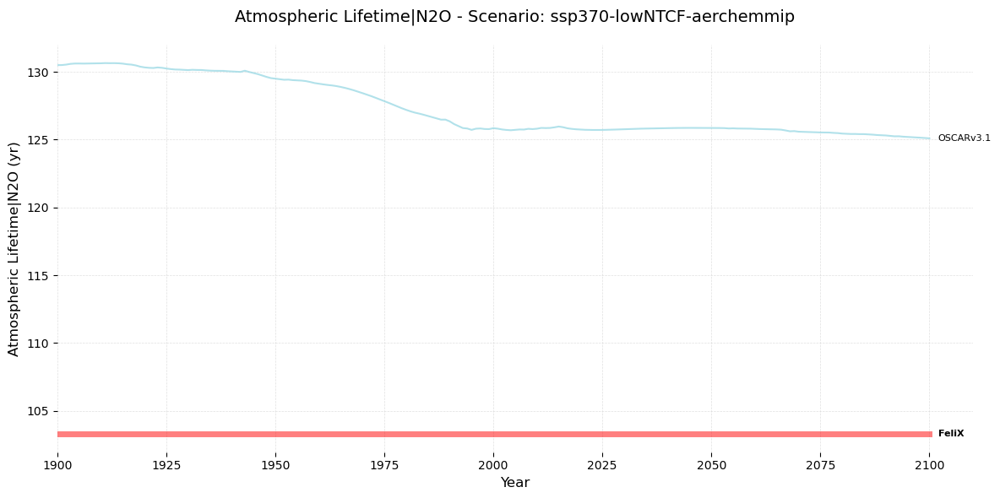

Original data shape: (11371, 1625)
After variable filtering: (149, 1625)
After scenario filtering: (2, 1625)
After region filtering: (2, 1625)
After year range filtering: (2, 206)
After excluding models: (2, 206)


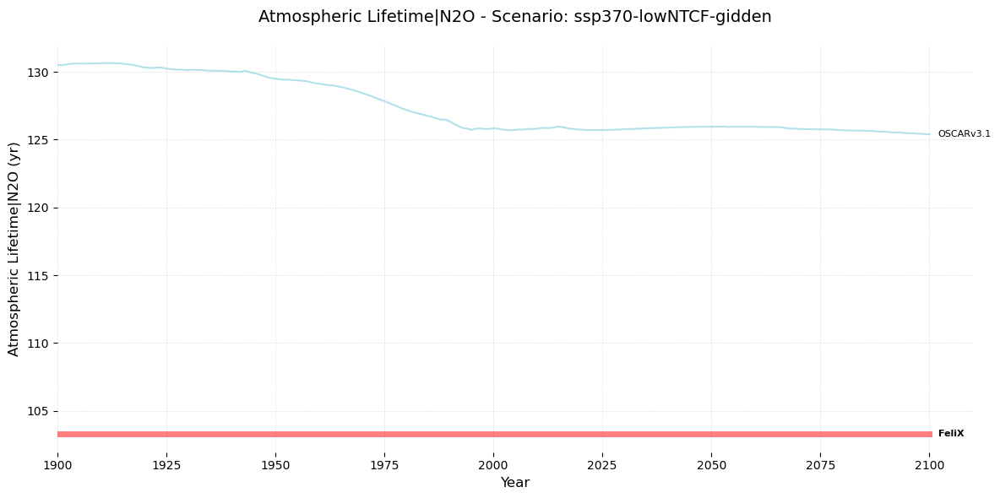

Original data shape: (11371, 1625)
After variable filtering: (149, 1625)
After scenario filtering: (3, 1625)
After region filtering: (3, 1625)
After year range filtering: (3, 206)
After excluding models: (3, 206)


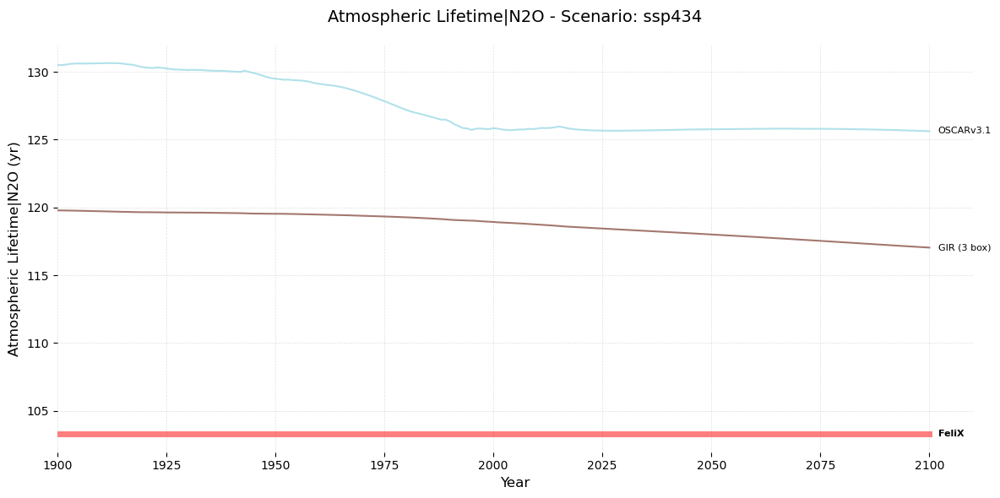

Original data shape: (11371, 1625)
After variable filtering: (149, 1625)
After scenario filtering: (3, 1625)
After region filtering: (3, 1625)
After year range filtering: (3, 206)
After excluding models: (3, 206)


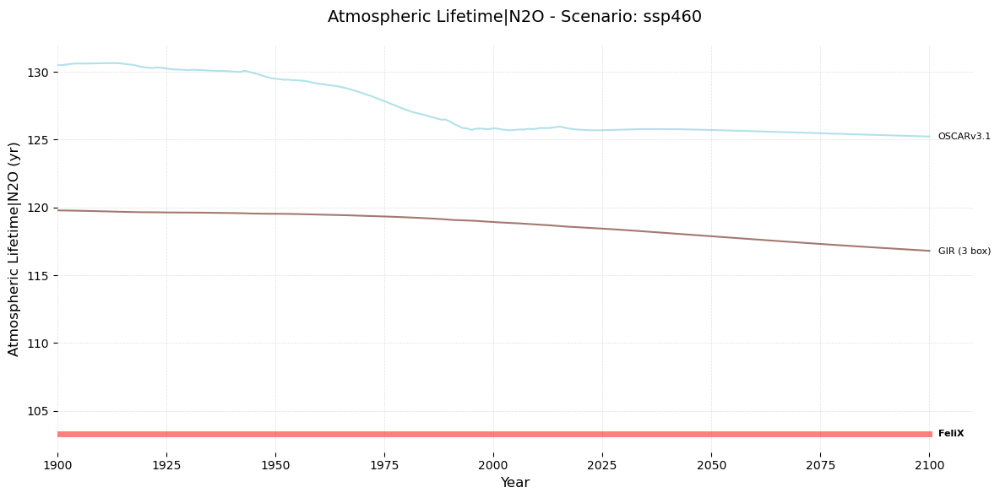

Original data shape: (11371, 1625)
After variable filtering: (149, 1625)
After scenario filtering: (3, 1625)
After region filtering: (3, 1625)
After year range filtering: (3, 206)
After excluding models: (3, 206)


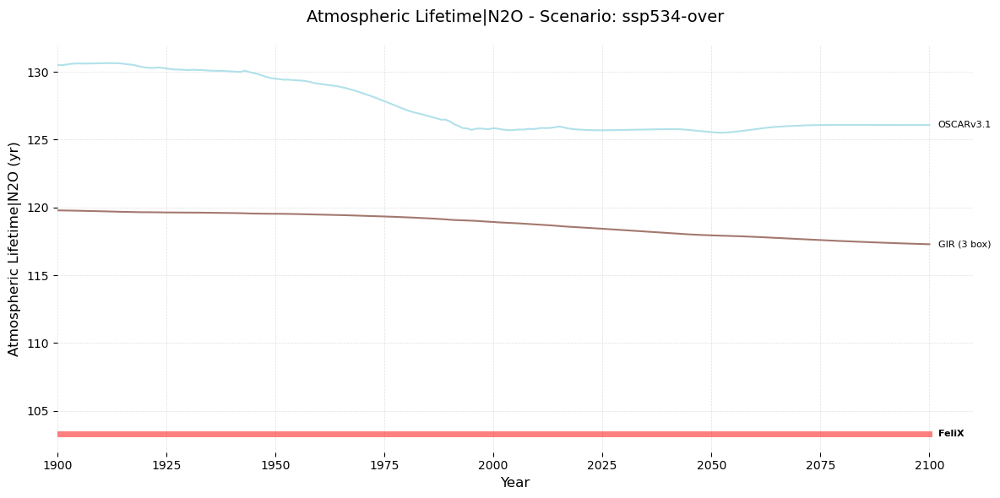

Original data shape: (11371, 1625)
After variable filtering: (149, 1625)
After scenario filtering: (3, 1625)
After region filtering: (3, 1625)
After year range filtering: (3, 206)
After excluding models: (3, 206)


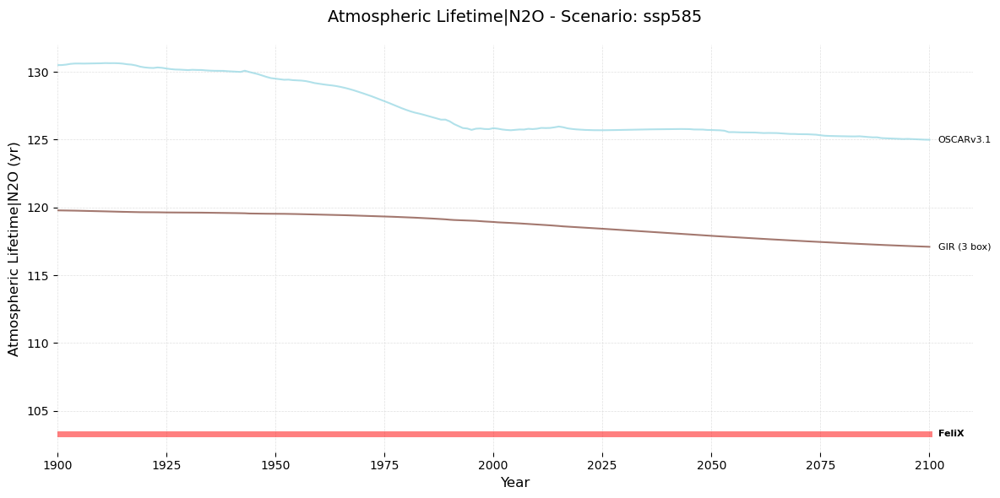

Original data shape: (11371, 1625)
After variable filtering: (149, 1625)
After scenario filtering: (3, 1625)
After region filtering: (3, 1625)
After year range filtering: (3, 206)
After excluding models: (3, 206)


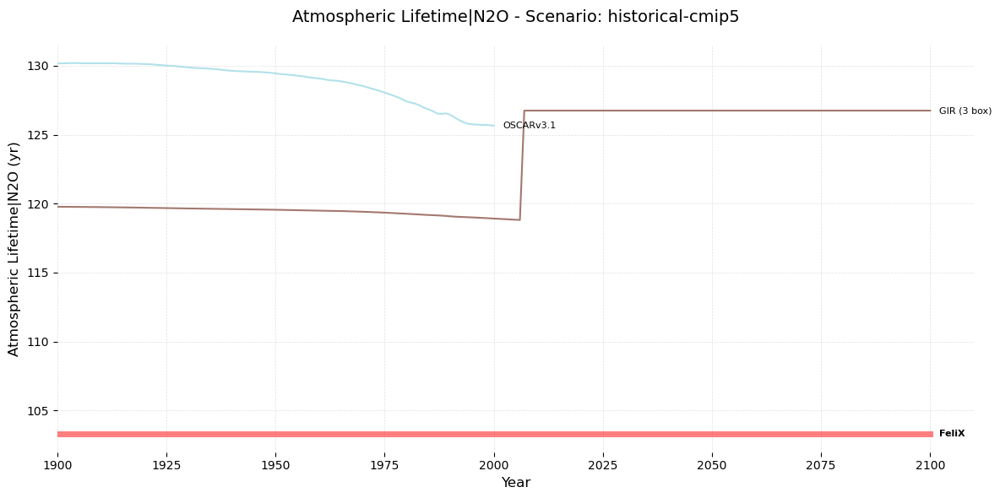

In [24]:
import os

# CHOOSING SCENARIOS
scenario_set = scenario_experiments
exclude_this = ["hector|1d51f|HISTCALIB-SD"]
output_set = all_outputs

# Loop through outputset
for variable_name in output_set:
    for scenario in scenario_set:
        fig, df = visualize_rcmip_data(merged_data,
                                       exclude_models= exclude_this,
                                       variables=[variable_name],
                                       scenarios= scenario,
                                       region= "World",
                                       year_range=(1900, 2100),
                                       compare_by='ClimateModel',
                                       plot_title=f"{variable_name} - Scenario: {scenario}")
        
        # Create directory if it doesn't exist
        output_dir = f"Figures/{variable_name.replace('|', '_')}_OnlyScenarios"
        os.makedirs(output_dir, exist_ok=True)
        
        fig.savefig(f"{output_dir}/{variable_name.replace('|', '_')}_{scenario}.png")